# Business Problem statement


Rossmann is a European drug distributor which operates over 3,000 drug stores across seven European countries. Since a lot of drugs come with a short shelf life, that is, they do not have a long expiry date, it becomes imperative for Rossmann to accurately forecast sales at their individual stores. Currently, the forecasting is taken care of by the store managers who are tasked with forecasting daily sales for the next six weeks. 

 

As expected, store sales are influenced by many factors, including promotional campaigns, competition, state holidays, seasonality, and locality.

 

With thousands of individual managers predicting sales based on their unique circumstances and intuitions, the accuracy of the forecasts is quite varied. 

# Goal

Build a forecasting model to forecast the daily sales for the next six weeks

# Deliverables

 - Data preparation 
 - Exploratory data analysis(EDA)
 - Model Building
 - Model Evaluation 
 - Code readability and conciseness 
 

While attempting to forecast sales, it is advisable to keep the following question in mind.

 

 - Is the sales data non-stationary? If so, how do you find it and correct it?

 - Is the data cointegrated? Which variables are cointegrated and how do you find them?

 - What is the impact of the number of customers on sales?

 - What is the impact of promo and promo2 variables on sales? How do you measure it?

 - Forecast sales for the next 6 weeks? Report the accuracy of the model using MAPE.
 
 
While you are solving the problem, the following steps can be used as a reference. Please note that you can take a different approach as well.

 

-   Find outliers at the 99th percentile and remove them.

-    Standardize the sales and number of customers variables before modelling.

-    Determine if the data is stationary

-    If stationary then apply Vector Autoregression Model.

-    If non-stationary then specify the model in differences

-    Make sales, promo2 and any other variables you think of as dependent variables.

-    Check for cointegration using the Johansen test. 

-    Predict sales for the next 6 weeks.

# Import the Libraries

In [1]:
#import the libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline 
import seaborn as sns
import datetime
import inflection
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.stattools import acf, pacf
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.arima_model import ARIMA
from matplotlib.pylab import rcParams
from sklearn.impute import KNNImputer
import statsmodels.api as sm
# Import Statsmodels
from statsmodels.tsa.api import VAR
from statsmodels.tsa.stattools import adfuller
from statsmodels.tools.eval_measures import rmse, aic
from sklearn.metrics import mean_squared_error
from statsmodels.tsa.vector_ar.vecm import coint_johansen 
import warnings
warnings.filterwarnings('ignore')
sns.set(rc={'figure.figsize':(15.7,6.27)})

# Load the dataset

In [2]:
df_sales_raw=pd.read_csv('train.csv')
df_store_raw=pd.read_csv('store.csv')
#Load the dataset

In [3]:
# Let's merge the dataset
df_raw = pd.merge(df_sales_raw, df_store_raw, how = 'left', on = 'Store' )
df_raw.head()

,Store,DayOfWeek,Date,Sales,Customers,Open,Promo,StateHoliday,SchoolHoliday,StoreType,Assortment,CompetitionDistance,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,PromoInterval
0,1,5,2015-07-31,5263,555,1,1,0,1,c,a,1270.0,9.0,2008.0,0,NaN,NaN,NaN
1,2,5,2015-07-31,6064,625,1,1,0,1,a,a,570.0,11.0,2007.0,1,13.0,2010.0,"Jan,Apr,Jul,Oct"
2,3,5,2015-07-31,8314,821,1,1,0,1,a,a,14130.0,12.0,2006.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
3,4,5,2015-07-31,13995,1498,1,1,0,1,c,c,620.0,9.0,2009.0,0,NaN,NaN,NaN
4,5,5,2015-07-31,4822,559,1,1,0,1,a,a,29910.0,4.0,2015.0,0,NaN,NaN,NaN


# Data preparation & understanding

In [4]:
#Copy dataset
df_new = df_raw.copy()
df_new.columns

Index(['Store', 'DayOfWeek', 'Date', 'Sales', 'Customers', 'Open', 'Promo',
       'StateHoliday', 'SchoolHoliday', 'StoreType', 'Assortment',
       'CompetitionDistance', 'CompetitionOpenSinceMonth',
       'CompetitionOpenSinceYear', 'Promo2', 'Promo2SinceWeek',
       'Promo2SinceYear', 'PromoInterval'],
      dtype='object')

In [5]:
#Let raname the columns
old_columns = ['Store', 'DayOfWeek', 'Date', 'Sales', 'Customers', 'Open', 'Promo',
       'StateHoliday', 'SchoolHoliday', 'StoreType', 'Assortment',
       'CompetitionDistance', 'CompetitionOpenSinceMonth',
       'CompetitionOpenSinceYear', 'Promo2', 'Promo2SinceWeek',
       'Promo2SinceYear', 'PromoInterval']

snakecase = lambda x: inflection.underscore(x)

new_columns = list( map( snakecase, old_columns ) )


#Rename Columns
df_new.columns = new_columns

In [6]:
df_new.columns

Index(['store', 'day_of_week', 'date', 'sales', 'customers', 'open', 'promo',
       'state_holiday', 'school_holiday', 'store_type', 'assortment',
       'competition_distance', 'competition_open_since_month',
       'competition_open_since_year', 'promo2', 'promo2_since_week',
       'promo2_since_year', 'promo_interval'],
      dtype='object')


   
 -  Store - a unique Id for each store
 -  day_of_week
 -  date
 -  Sales - the turnover for any given day (this is what you are predicting)
 -  Customers - the number of customers on a given day
 -  Open - an indicator for whether the store was open: 0 = closed, 1 = open
 -  Promo - indicates whether a store is running a promo on that day
 -  State_Holiday - indicates a state holiday. Normally all stores, with few exceptions, are closed on state holidays. Note that all schools are closed on public holidays and weekends. a = public holiday, b = Easter holiday, c = Christmas, 0 = None
 -  School_Holiday - indicates if the (Store, Date) was affected by the closure of public schools
 -  Store_Type - differentiates between 4 different store models: a, b, c, d
 -  Assortment - describes an assortment level: a = basic, b = extra, c = extended
 -  Competition_Distance - distance in meters to the nearest competitor store
 -  Competition_Open_Since[Month/Year] - gives the approximate year and month of the time the nearest competitor was opened
 -  Promo2_since_week - Promo2 is a continuing and consecutive promotion for some stores: 0 = store is not participating, 1 = store is participating
 -  Promo_2_Since[Year/Week] - describes the year and calendar week when the store started participating in Promo2
 -  Promo_Interval - describes the consecutive intervals Promo2 is started, naming the months the promotion is started anew. E.g. "Feb,May,Aug,Nov" means each round starts in February, May, August, November of any given year for that store



In [7]:
#Let's check the shape of dataset
df_new.shape

(1017209, 18)

Since the company is just embarking on this project, the scope has been kept to nine key stores across Europe. The stores are key for the company keeping in mind the revenue and historical prestige associated with them. These stores are numbered - 1,3,8,9,13,25,29,31 and 46.

In [8]:
#Let's keep the dataset of 9 stores only
df_new_store1=df_new[df_new['store']==1]
df_new_store3=df_new[df_new['store']==3]
df_new_store8=df_new[df_new['store']==8]
df_new_store9=df_new[df_new['store']==9]
df_new_store13=df_new[df_new['store']==13]
df_new_store25=df_new[df_new['store']==25]
df_new_store29=df_new[df_new['store']==29]
df_new_store31=df_new[df_new['store']==31]
df_new_store46=df_new[df_new['store']==46]

# Model- Store-1

In [9]:
# transform datatype of the variable data to datetime
df_new_store1['date'] = pd.to_datetime( df_new_store1['date'])

In [10]:
df_new_store1.info()
#Let's check the info

<class 'pandas.core.frame.DataFrame'>
Int64Index: 942 entries, 0 to 1016095
Data columns (total 18 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   store                         942 non-null    int64         
 1   day_of_week                   942 non-null    int64         
 2   date                          942 non-null    datetime64[ns]
 3   sales                         942 non-null    int64         
 4   customers                     942 non-null    int64         
 5   open                          942 non-null    int64         
 6   promo                         942 non-null    int64         
 7   state_holiday                 942 non-null    object        
 8   school_holiday                942 non-null    int64         
 9   store_type                    942 non-null    object        
 10  assortment                    942 non-null    object        
 11  competition_distance        

In [11]:
# Check NAN values
missing_count = df_new_store1.isnull().sum() # the count of missing values
value_count = df_new_store1.isnull().count() # the count of all values

missing_percentage = round(missing_count/value_count *100, 2) # the percentage of missing values
missing_df = pd.DataFrame({'missing values count': missing_count, 'percentage': missing_percentage})
missing_df

,missing values count,percentage
store,0,0.0
day_of_week,0,0.0
date,0,0.0
sales,0,0.0
customers,0,0.0
open,0,0.0
promo,0,0.0
state_holiday,0,0.0
school_holiday,0,0.0
store_type,0,0.0


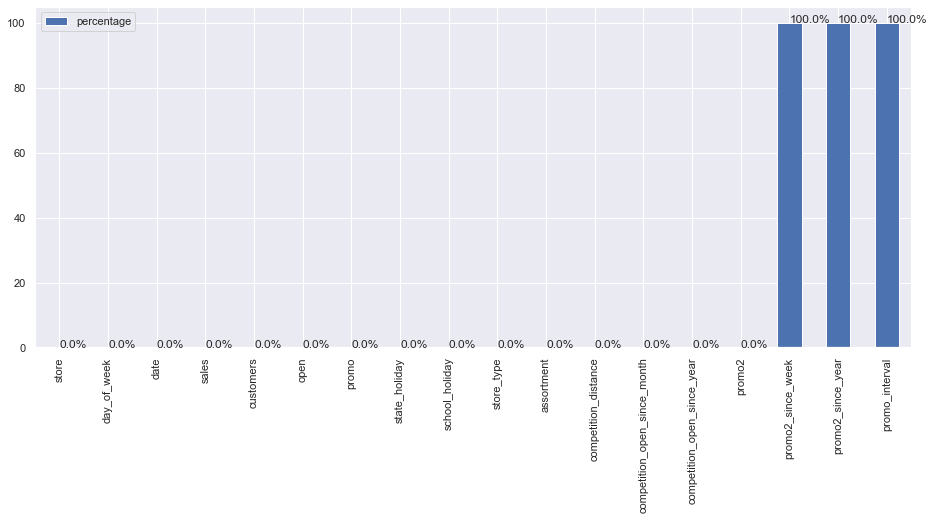

In [12]:
barchart = missing_df.plot.bar(y='percentage')
for index, percentage in enumerate( missing_percentage ):
    barchart.text( index, percentage, str(percentage)+'%')

In [13]:
#Let's drop the promo2_since_year,promo2_since_year,promo_interval
df_new_store1=df_new_store1.drop(['promo2_since_week', 'promo2_since_year','promo_interval'], axis = 1)

In [14]:
df_new_store1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 942 entries, 0 to 1016095
Data columns (total 15 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   store                         942 non-null    int64         
 1   day_of_week                   942 non-null    int64         
 2   date                          942 non-null    datetime64[ns]
 3   sales                         942 non-null    int64         
 4   customers                     942 non-null    int64         
 5   open                          942 non-null    int64         
 6   promo                         942 non-null    int64         
 7   state_holiday                 942 non-null    object        
 8   school_holiday                942 non-null    int64         
 9   store_type                    942 non-null    object        
 10  assortment                    942 non-null    object        
 11  competition_distance        

In [15]:
#Change the datatype
df_new_store1 = df_new_store1.astype({'competition_open_since_month':'int64', 'competition_open_since_year':'int64',})
df_new_store1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 942 entries, 0 to 1016095
Data columns (total 15 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   store                         942 non-null    int64         
 1   day_of_week                   942 non-null    int64         
 2   date                          942 non-null    datetime64[ns]
 3   sales                         942 non-null    int64         
 4   customers                     942 non-null    int64         
 5   open                          942 non-null    int64         
 6   promo                         942 non-null    int64         
 7   state_holiday                 942 non-null    object        
 8   school_holiday                942 non-null    int64         
 9   store_type                    942 non-null    object        
 10  assortment                    942 non-null    object        
 11  competition_distance        

In [16]:
df_new_store1.head()

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year,promo2
0,1,5,2015-07-31,5263,555,1,1,0,1,c,a,1270.0,9,2008,0
1115,1,4,2015-07-30,5020,546,1,1,0,1,c,a,1270.0,9,2008,0
2230,1,3,2015-07-29,4782,523,1,1,0,1,c,a,1270.0,9,2008,0
3345,1,2,2015-07-28,5011,560,1,1,0,1,c,a,1270.0,9,2008,0
4460,1,1,2015-07-27,6102,612,1,1,0,1,c,a,1270.0,9,2008,0


In [17]:
# Let's copy the dataset
df_store1 = df_new_store1.copy()

In [18]:
df_store1.head()

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year,promo2
0,1,5,2015-07-31,5263,555,1,1,0,1,c,a,1270.0,9,2008,0
1115,1,4,2015-07-30,5020,546,1,1,0,1,c,a,1270.0,9,2008,0
2230,1,3,2015-07-29,4782,523,1,1,0,1,c,a,1270.0,9,2008,0
3345,1,2,2015-07-28,5011,560,1,1,0,1,c,a,1270.0,9,2008,0
4460,1,1,2015-07-27,6102,612,1,1,0,1,c,a,1270.0,9,2008,0


**Descriptive Statistics**

In [19]:
#Descriptive
df_store1.describe().T

,count,mean,std,min,25%,50%,75%,max
store,942.0,1.000000,0.000000,1.0,1.00,1.0,1.00,1.0
day_of_week,942.0,3.997877,1.998404,1.0,2.00,4.0,6.00,7.0
sales,942.0,3945.704883,2015.417840,0.0,3588.25,4373.5,5220.00,9528.0
customers,942.0,467.646497,228.930850,0.0,463.00,529.0,598.75,1130.0
open,942.0,0.829087,0.376633,0.0,1.00,1.0,1.00,1.0
promo,942.0,0.382166,0.486175,0.0,0.00,0.0,1.00,1.0
school_holiday,942.0,0.204883,0.403831,0.0,0.00,0.0,0.00,1.0
competition_distance,942.0,1270.000000,0.000000,1270.0,1270.00,1270.0,1270.00,1270.0
competition_open_since_month,942.0,9.000000,0.000000,9.0,9.00,9.0,9.00,9.0
competition_open_since_year,942.0,2008.000000,0.000000,2008.0,2008.00,2008.0,2008.00,2008.0


In [20]:
# separate numerical and categorical attributes
num_attributes = df_store1.select_dtypes( include = 'number')
cate_attributes = df_store1.select_dtypes( include = 'object')

**Numerical Attributes**

In [21]:
# Central Tendency - Mean, median
ct1 = pd.DataFrame( num_attributes.apply( np.mean ) ).T
ct2 = pd.DataFrame( num_attributes.apply( np.median ) ).T

# Dispersion - std, min, max, range, skew, kurtoisis
d1 = pd.DataFrame(num_attributes.apply( np.std )).T
d2 = pd.DataFrame(num_attributes.apply( min )).T
d3 = pd.DataFrame(num_attributes.apply( max )).T
d4 = pd.DataFrame(num_attributes.apply( lambda x: x.max() - x.min() )).T
d5 = pd.DataFrame(num_attributes.apply( lambda x: x.skew() )).T
d6 = pd.DataFrame(num_attributes.apply( lambda x: x.kurtosis() )).T

#concatenate
m = pd.concat( [d2, d3, d4, ct1, ct2, d1, d5, d6] ).T.reset_index()


m.columns = ['attributes', 'min', 'max', 'range', 'mean', 'median', 'std', 'skew', 'kurtosis']
m

,attributes,min,max,range,mean,median,std,skew,kurtosis
0,store,1.0,1.0,0.0,1.000000,1.0,0.000000,0.000000,0.000000
1,day_of_week,1.0,7.0,6.0,3.997877,4.0,1.997343,0.002127,-1.247185
2,sales,0.0,9528.0,9528.0,3945.704883,4373.5,2014.347801,-0.880179,0.147313
3,customers,0.0,1130.0,1130.0,467.646497,529.0,228.809304,-1.148392,0.451971
4,open,0.0,1.0,1.0,0.829087,1.0,0.376433,-1.751240,1.069107
5,promo,0.0,1.0,1.0,0.382166,0.0,0.485917,0.485772,-1.767783
6,school_holiday,0.0,1.0,1.0,0.204883,0.0,0.403616,1.464696,0.145640
7,competition_distance,1270.0,1270.0,0.0,1270.000000,1270.0,0.000000,0.000000,0.000000
8,competition_open_since_month,9.0,9.0,0.0,9.000000,9.0,0.000000,0.000000,0.000000
9,competition_open_since_year,2008.0,2008.0,0.0,2008.000000,2008.0,0.000000,0.000000,0.000000


**Categorical Attributes**


In [22]:
# check unique values of categorical features
cate_attributes.apply( lambda x: x.unique().shape[0])

state_holiday    5
store_type       1
assortment       1
dtype: int64

In [23]:
#Let's check the unique values
print(df_store1['state_holiday'].unique())
print(df_store1['store_type'].unique())
print(df_store1['assortment'].unique())

['0' 'a' 'b' 'c' 0]
['c']
['a']


# **Exploratory data analysis(EDA)**

Let’s perform EDA to gain insights into the given data.

**Univariate Analysis**

*Response Variable (target)*

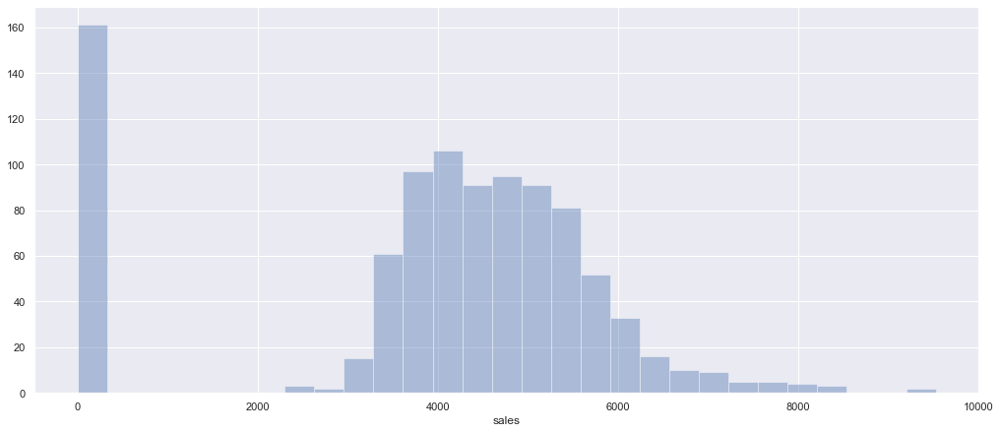

In [24]:
fig = plt.figure( figsize = (14, 6), constrained_layout=True)
sns.distplot(df_store1['sales'], kde = False);
plt.show()

**Numerical Variable**

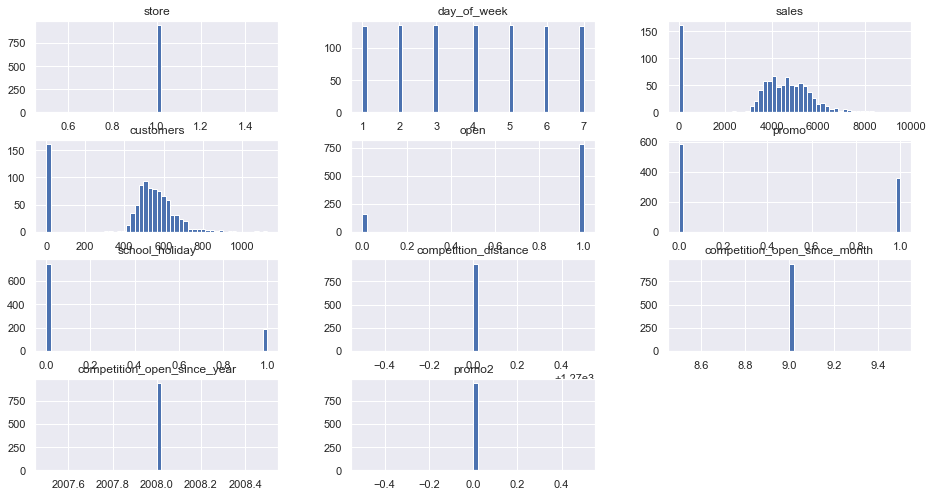

In [25]:
sns.set(rc={'figure.figsize':(15.7,8.27)})
num_attributes.hist(bins = 50);

In [26]:
df_store1['day_of_week'].value_counts()
#day of the week

5    135
4    135
3    135
2    135
7    134
6    134
1    134
Name: day_of_week, dtype: int64

In [27]:
df_store1['open'].value_counts()
# value count of store is open or not

1    781
0    161
Name: open, dtype: int64

In [28]:
df_store1['promo'].value_counts()
# value count of promo

0    582
1    360
Name: promo, dtype: int64

In [29]:
df_store1['state_holiday'].value_counts()
# value count of state_holiday

0    786
0    129
a     17
b      6
c      4
Name: state_holiday, dtype: int64

In [30]:
df_store1['school_holiday'].value_counts()
# value count of state_holiday

0    749
1    193
Name: school_holiday, dtype: int64

In [31]:
df_store1['store_type'].value_counts()
# value count of state_holiday

c    942
Name: store_type, dtype: int64

In [32]:
df_store1['assortment'].value_counts()
# value count of assortment

a    942
Name: assortment, dtype: int64

In [33]:
df_store1['competition_distance'].value_counts()
# value count of competition_distance

1270.0    942
Name: competition_distance, dtype: int64

In [34]:
df_store1['competition_open_since_month'].value_counts()
# value count of competition_open_since_month

9    942
Name: competition_open_since_month, dtype: int64

In [35]:
df_store1['competition_open_since_year'].value_counts()
# value count of competition_open_since_year

2008    942
Name: competition_open_since_year, dtype: int64

In [36]:
df_store1['promo2'].value_counts()
# value count of competition_open_since_year

0    942
Name: promo2, dtype: int64

In [37]:
df_store1.columns

Index(['store', 'day_of_week', 'date', 'sales', 'customers', 'open', 'promo',
       'state_holiday', 'school_holiday', 'store_type', 'assortment',
       'competition_distance', 'competition_open_since_month',
       'competition_open_since_year', 'promo2'],
      dtype='object')

**Categorical Variable**

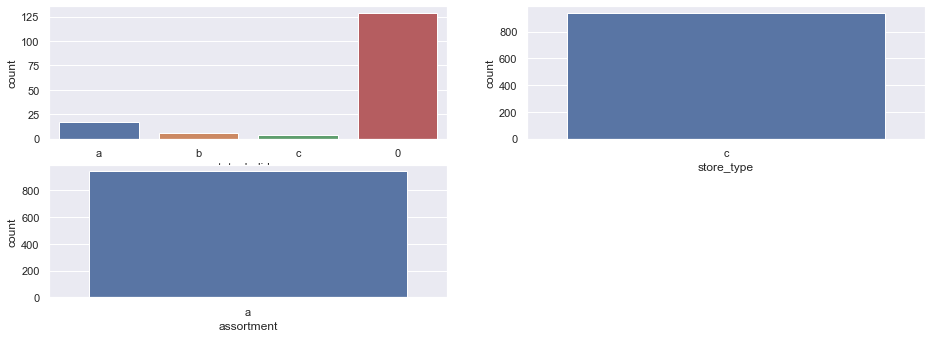

In [38]:
# state_holiday
plt.subplot(3, 2, 1)
a = df_store1[df_store1['state_holiday'] != '0']
sns.countplot(data = a, x = a['state_holiday'])

# store_type
plt.subplot(3, 2, 2)
sns.countplot(data = df_store1, x = df_store1['store_type'])

# assortment
plt.subplot(3, 2, 3)
sns.countplot(data = df_store1, x = df_store1['assortment'])
plt.show()

 - Sale colomns has zero values which has to be imputed 
 - Store is open on 80% of days
 - 80% are regular days
 - All the rows of column-store type belongs to 'c'
 - All the rows of column-assortment belongs to 'a'
 - All the rows of columns-competition_distance to 1270
 - All the competition is opened since month-9
 - All the competition is opened since 2008
 - All the rows of promo2 belogs to 0

**Bivariate Analysis**

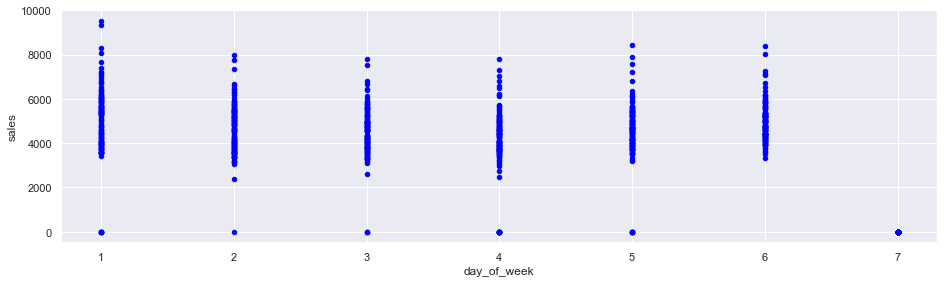

In [39]:
# lets draw a scatter plot between  Sales and day_of_week
sns.set(rc={'figure.figsize':(15.7,4.27)})
df_store1[['sales', 'day_of_week']].plot.scatter(x = 'day_of_week',y='sales',c='blue')
plt.show()

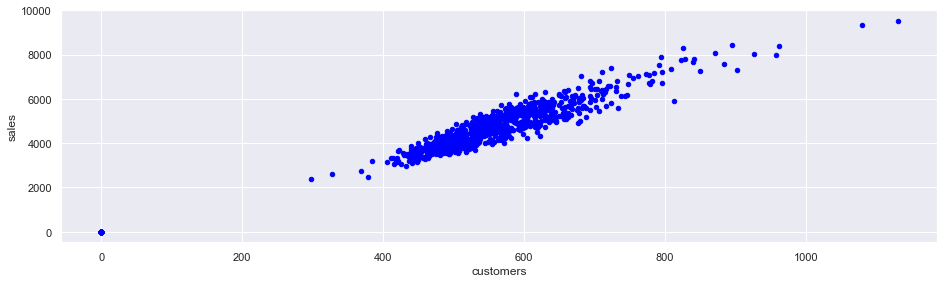

In [40]:
#Let's draw a scatter plot between Sales and Customers
df_store1[['sales', 'customers']].plot.scatter(x = 'customers',y='sales',c='blue')
plt.show()

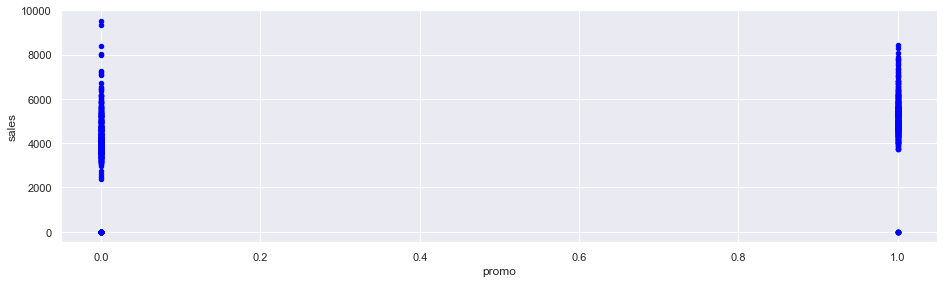

In [41]:
#Let's now draw a scatter plot between Sales and promo
df_store1[['sales', 'promo']].plot.scatter(x = 'promo',y='sales',c='blue')
plt.show()

In [42]:
df_store1.columns

Index(['store', 'day_of_week', 'date', 'sales', 'customers', 'open', 'promo',
       'state_holiday', 'school_holiday', 'store_type', 'assortment',
       'competition_distance', 'competition_open_since_month',
       'competition_open_since_year', 'promo2'],
      dtype='object')

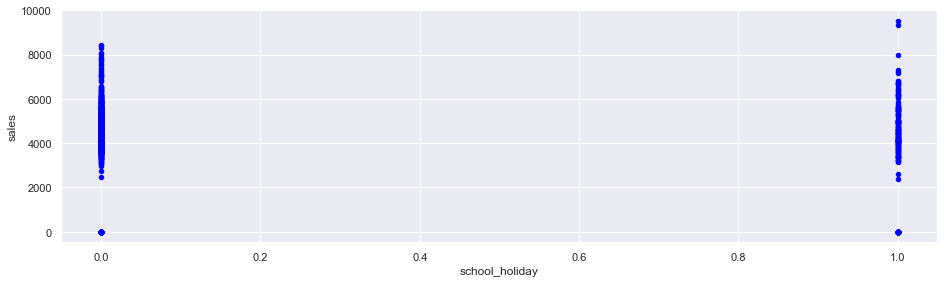

In [43]:
#lets now draw a scatter plot between  Sales and school_holiday
df_store1[['sales', 'school_holiday']].plot.scatter(x = 'school_holiday',y='sales',c='blue')
plt.show()

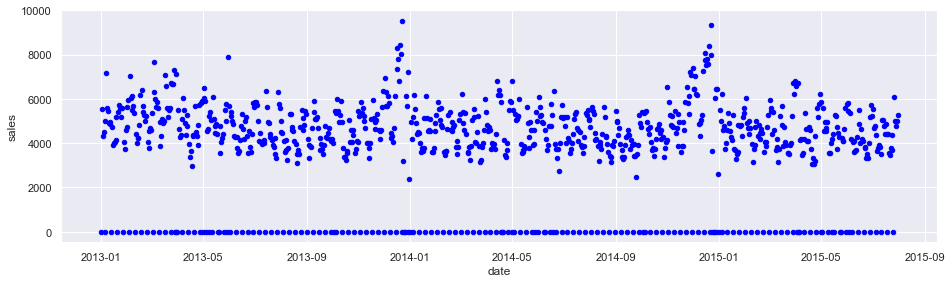

In [44]:
#lets now draw a scatter plot between Sales and date
df_store1[['sales', 'date']].plot.scatter(x = 'date',y='sales',c='blue')
plt.show()

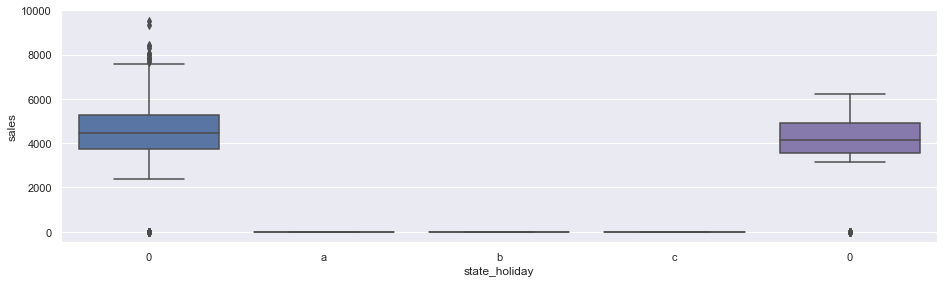

In [45]:
#Let's draw the boxplot between sales and state_holiday
sns.set(rc={'figure.figsize':(15.7,4.27)})
# create grouped boxplot 
sns.boxplot(x = df_store1['state_holiday'],
            y = df_store1['sales'])
plt.show()

**Multivariate Analysis**

**Numerical Attributes**

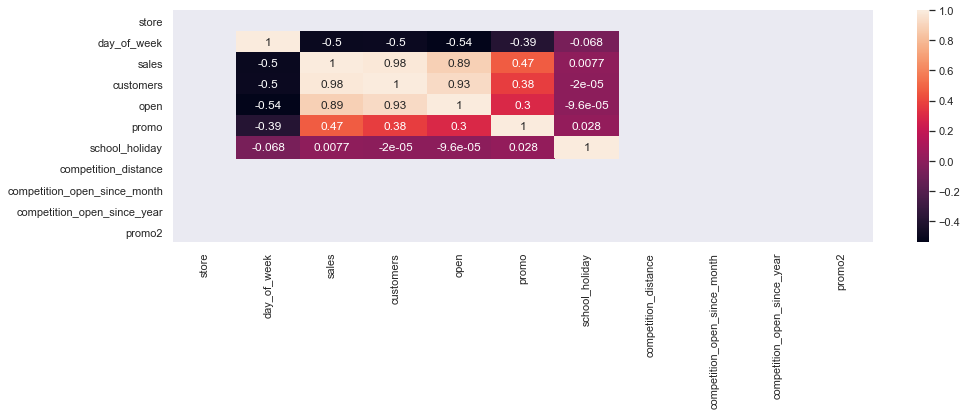

In [46]:
correlation = (num_attributes.corr( method = 'pearson' ))
sns.heatmap( correlation, annot = True );

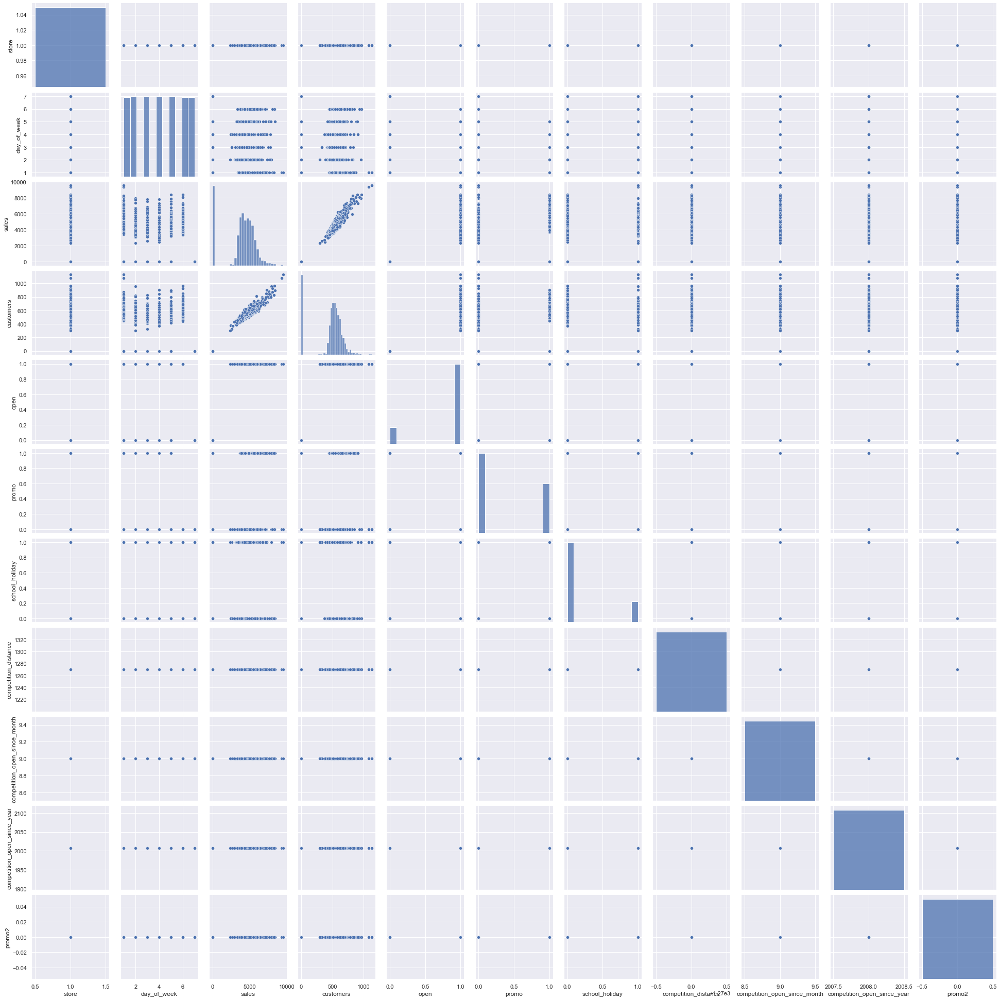

In [47]:
# pairplot with hue sales
sns.pairplot(df_store1)
# to show
plt.show()

**Some insights from EDA**

 - Sales & Customers are directly proportional to each other
 - store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year & promo2 are uncessary columns becuase it doesn't have any effect on sales(target variable)
 - Day1,Day5 and Day6 have higher sales than other days
 - promo is slighly correlated to sales
 - There is no sale on  a = public holiday, b = Easter holiday, c = Christmas
 - There is no effect of school holiday on sales

In [48]:
# We can drop store_type,assortment,competition_distance,competition_open_since_month,
#competition_open_since_year & promo2
df_store1_new=df_store1.drop(['store_type', 'assortment','competition_distance','competition_open_since_month','competition_open_since_year','promo2'], axis = 1)


In [49]:
df_store1_new.head()

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday
0,1,5,2015-07-31,5263,555,1,1,0,1
1115,1,4,2015-07-30,5020,546,1,1,0,1
2230,1,3,2015-07-29,4782,523,1,1,0,1
3345,1,2,2015-07-28,5011,560,1,1,0,1
4460,1,1,2015-07-27,6102,612,1,1,0,1


In [50]:
# saving the dataframe
#df_store1_new.to_csv('cleaned_df_store1.csv')

# Model Building- Model-Store-1

**ARIMA model**

In [51]:
#path = "cleaned_df_store1.csv"
#df_store1_new = pd.read_csv(path)
#df_store1_new.head()
#Let load the data

In [52]:
df_store1_new=df_store1_new[::-1].reset_index()
df_store1_new

,index,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday
0,1016095,1,2,2013-01-01,0,0,0,0,a,1
1,1014980,1,3,2013-01-02,5530,668,1,0,0,1
2,1013865,1,4,2013-01-03,4327,578,1,0,0,1
3,1012750,1,5,2013-01-04,4486,619,1,0,0,1
4,1011635,1,6,2013-01-05,4997,635,1,0,0,1
...,...,...,...,...,...,...,...,...,...,...
937,4460,1,1,2015-07-27,6102,612,1,1,0,1
938,3345,1,2,2015-07-28,5011,560,1,1,0,1
939,2230,1,3,2015-07-29,4782,523,1,1,0,1
940,1115,1,4,2015-07-30,5020,546,1,1,0,1


In [53]:
df_store1_new=df_store1_new.drop(['index'], axis = 1)
df_store1_new.head()
#Let drop the index: 0 column

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday
0,1,2,2013-01-01,0,0,0,0,a,1
1,1,3,2013-01-02,5530,668,1,0,0,1
2,1,4,2013-01-03,4327,578,1,0,0,1
3,1,5,2013-01-04,4486,619,1,0,0,1
4,1,6,2013-01-05,4997,635,1,0,0,1


In [54]:
df_store1_new.info()
#No missing value

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 942 entries, 0 to 941
Data columns (total 9 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   store           942 non-null    int64         
 1   day_of_week     942 non-null    int64         
 2   date            942 non-null    datetime64[ns]
 3   sales           942 non-null    int64         
 4   customers       942 non-null    int64         
 5   open            942 non-null    int64         
 6   promo           942 non-null    int64         
 7   state_holiday   942 non-null    object        
 8   school_holiday  942 non-null    int64         
dtypes: datetime64[ns](1), int64(7), object(1)
memory usage: 66.4+ KB


In [55]:
df_store1_new['date'] = pd.to_datetime(df_store1_new['date'],infer_datetime_format=True)
# convert the string to datetime
df_store1_new.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 942 entries, 0 to 941
Data columns (total 9 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   store           942 non-null    int64         
 1   day_of_week     942 non-null    int64         
 2   date            942 non-null    datetime64[ns]
 3   sales           942 non-null    int64         
 4   customers       942 non-null    int64         
 5   open            942 non-null    int64         
 6   promo           942 non-null    int64         
 7   state_holiday   942 non-null    object        
 8   school_holiday  942 non-null    int64         
dtypes: datetime64[ns](1), int64(7), object(1)
memory usage: 66.4+ KB


In [56]:
indexed_df_store1_new = df_store1_new.set_index(['date'])
indexed_df_store1_new.head(5)
#Let set the date as index column

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday
date,,,,,,,,
2013-01-01,1,2,0,0,0,0,a,1
2013-01-02,1,3,5530,668,1,0,0,1
2013-01-03,1,4,4327,578,1,0,0,1
2013-01-04,1,5,4486,619,1,0,0,1
2013-01-05,1,6,4997,635,1,0,0,1


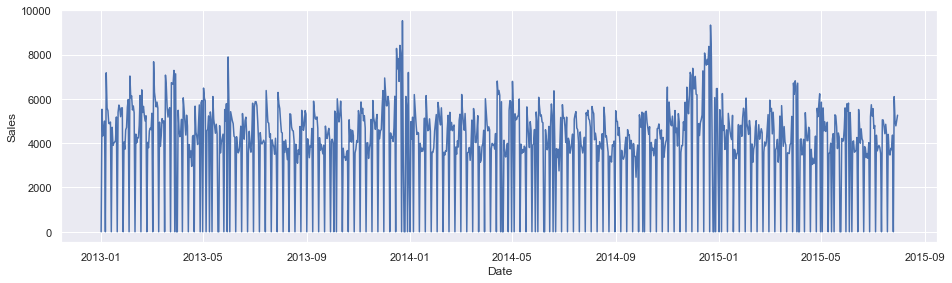

In [57]:
## plot graph
plt.xlabel('Date')
plt.ylabel('Sales')
plt.plot(indexed_df_store1_new['sales'])
plt.show()

In [58]:
#Let impute the zero values
(indexed_df_store1_new['sales']==0).sum()
# There are 161 zero value in sale column

161

In [59]:
indexed_df_store1_new['sales']=indexed_df_store1_new['sales'].replace(0, np.nan)

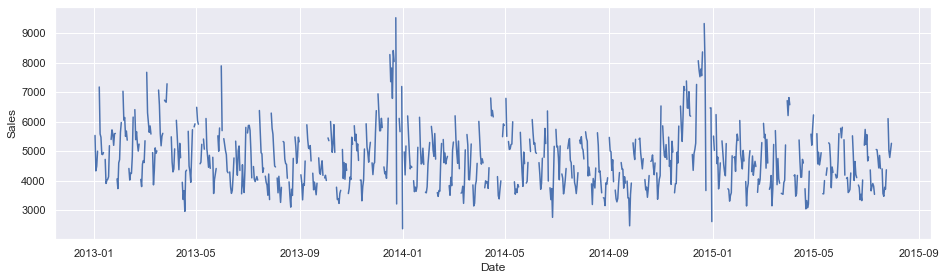

In [60]:
##plot graph
plt.xlabel('Date')
plt.ylabel('Sales')
plt.plot(indexed_df_store1_new['sales'])
plt.show()

In [61]:
#KNN imputer for filling NAN values
imputer = KNNImputer(n_neighbors=2)

In [62]:
indexed_df_store1_new['sales'] = imputer.fit_transform(np.array(indexed_df_store1_new['sales']).reshape(-1, 1))
indexed_df_store1_new['sales']

date
2013-01-01    4759.096031
2013-01-02    5530.000000
2013-01-03    4327.000000
2013-01-04    4486.000000
2013-01-05    4997.000000
                 ...     
2015-07-27    6102.000000
2015-07-28    5011.000000
2015-07-29    4782.000000
2015-07-30    5020.000000
2015-07-31    5263.000000
Name: sales, Length: 942, dtype: float64

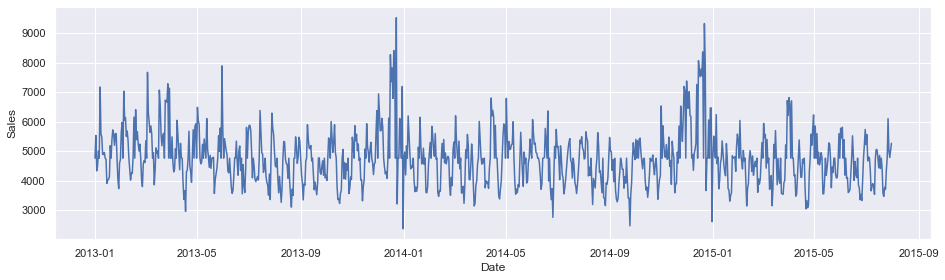

In [63]:
## plot graph
plt.xlabel('Date')
plt.ylabel('Sales')
plt.plot(indexed_df_store1_new['sales'])
plt.show()

In [64]:
(indexed_df_store1_new['sales']==0).sum()
# no missing value

0

**Outlier detection**

Box plot and interquartile range

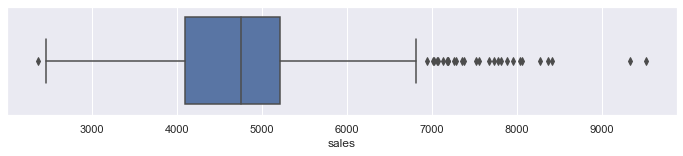

In [65]:
import seaborn as sns
fig = plt.subplots(figsize=(12, 2))
ax = sns.boxplot(x=indexed_df_store1_new['sales'],whis=1.5)
#Let treat the outliers

**Histogram**


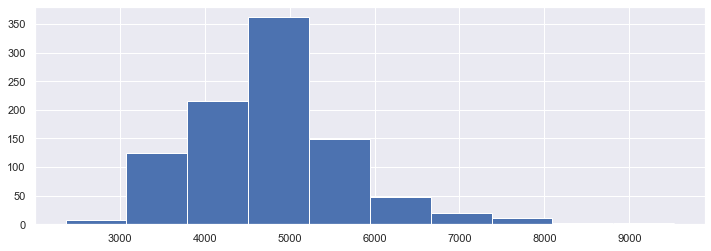

In [66]:
fig = indexed_df_store1_new['sales'].hist(figsize = (12,4))

In [67]:
percentile01 = indexed_df_store1_new['sales'].quantile(0.01)
percentile99 = indexed_df_store1_new['sales'].quantile(0.99)

In [68]:
upper_limit = percentile99
lower_limit = percentile01

In [69]:
upper_limit

7806.240000000001

In [70]:
lower_limit

3138.05

In [71]:
#Let's delete the outlier to 99%
new_df = indexed_df_store1_new[indexed_df_store1_new['sales'] < upper_limit]
new_df.shape

(932, 8)

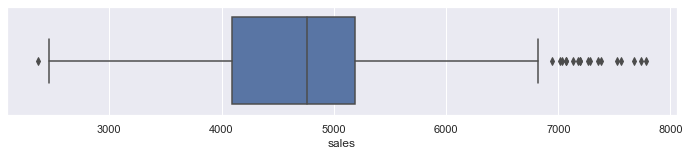

In [72]:
import seaborn as sns
fig = plt.subplots(figsize=(12, 2))
ax = sns.boxplot(x=new_df['sales'],whis=1.5)

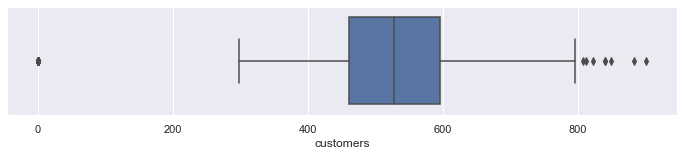

In [73]:
import seaborn as sns
fig = plt.subplots(figsize=(12, 2))
ax = sns.boxplot(x=new_df['customers'],whis=1.5)

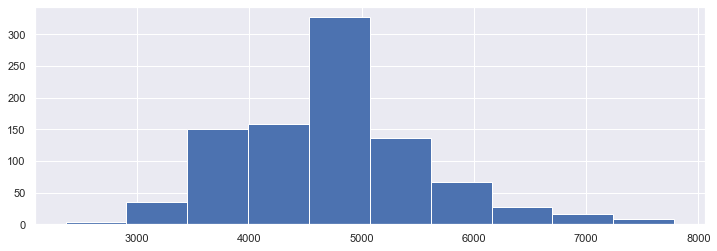

In [74]:
fig = new_df['sales'].hist(figsize = (12,4))

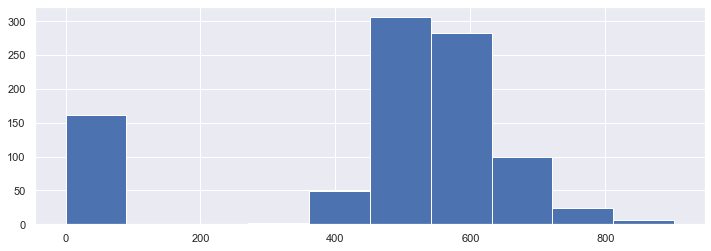

In [75]:
fig = new_df['customers'].hist(figsize = (12,4))

**ADF Stationary test**

In [76]:
def test_stationarity(timeseries):
    
    #Determine rolling statistics
    movingAverage = timeseries.rolling(window=12).mean()
    movingSTD = timeseries.rolling(window=12).std()
    
    #Plot rolling statistics
    orig = plt.plot(timeseries, color='blue', label='Original')
    mean = plt.plot(movingAverage, color='red', label='Rolling Mean')
    std = plt.plot(movingSTD, color='black', label='Rolling Std')
    plt.legend(loc='best')
    plt.title('Rolling Mean & Standard Deviation')
    plt.show(block=False)
    
    #Perform Dickey–Fuller test:
    print('Results of Dickey Fuller Test:')
    dftest = adfuller(indexed_df_store1_new['sales'], autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    for key,value in dftest[4].items():
        dfoutput['Critical Value (%s)'%key] = value
    print(dfoutput)

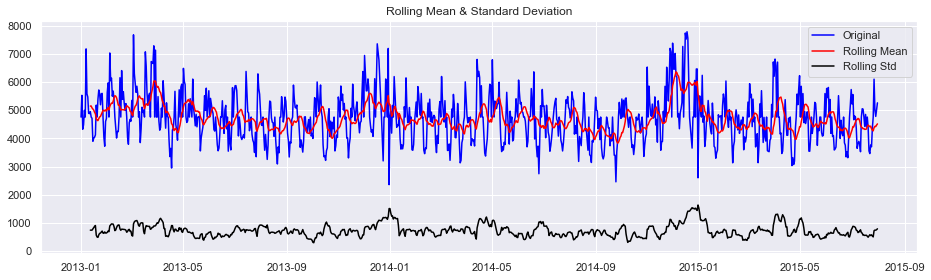

Results of Dickey Fuller Test:
Test Statistic                  -5.533321
p-value                          0.000002
#Lags Used                      16.000000
Number of Observations Used    925.000000
Critical Value (1%)             -3.437439
Critical Value (5%)             -2.864670
Critical Value (10%)            -2.568436
dtype: float64


In [77]:
test_stationarity(new_df['sales'])

- Null: Time Series is not stationary
- Alternate: Time Series is Stationary

**The p-value is less than 0.05 so The series is stationary**

In [78]:
from statsmodels.tsa.stattools import kpss
kpss_test = kpss(new_df['sales'])

print('KPSS Statistic: %f' % kpss_test[0])
print('Critical Values @ 0.05: %.2f' % kpss_test[3]['5%'])
print('p-value: %f' % kpss_test[1])

KPSS Statistic: 0.363547
Critical Values @ 0.05: 0.46
p-value: 0.092868


- Null: Time Series is not stationary
- Alternate: Time Series is Stationary

**The p-value is greater than 0.05 so The series is stationary**

**Log transformation has made mean & variance constant**

In [79]:
#Log Transformation
new_df['sales_log'] = np.log(new_df['sales'])
new_df.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,sales_log
date,,,,,,,,,
2013-01-01,1,2,4759.096031,0,0,0,a,1,8.467813
2013-01-02,1,3,5530.000000,668,1,0,0,1,8.617943
2013-01-03,1,4,4327.000000,578,1,0,0,1,8.372630
2013-01-04,1,5,4486.000000,619,1,0,0,1,8.408717
2013-01-05,1,6,4997.000000,635,1,0,0,1,8.516593


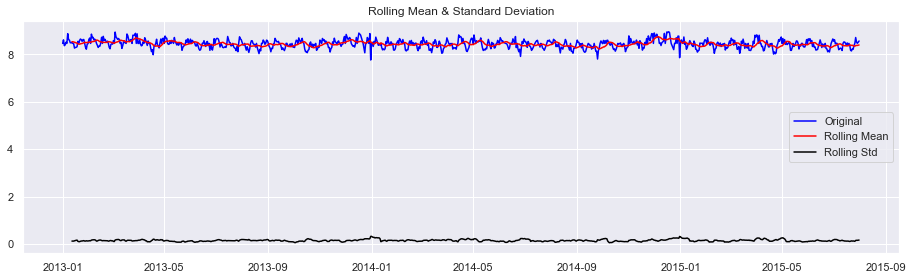

Results of Dickey Fuller Test:
Test Statistic                  -5.533321
p-value                          0.000002
#Lags Used                      16.000000
Number of Observations Used    925.000000
Critical Value (1%)             -3.437439
Critical Value (5%)             -2.864670
Critical Value (10%)            -2.568436
dtype: float64


In [80]:
test_stationarity(new_df['sales_log'])

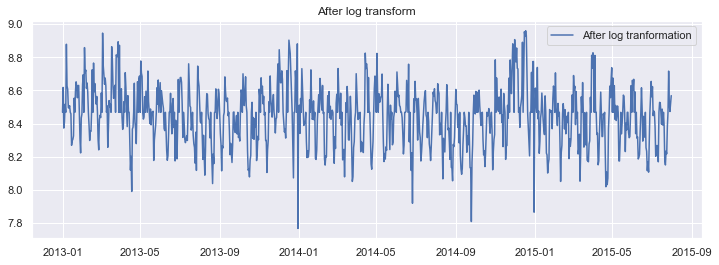

In [81]:
#After Log Transformation
plt.figure(figsize=(12,4))
plt.plot(new_df['sales_log'], label='After log tranformation')
plt.legend(loc='best')
plt.title('After log transform')
plt.show()

**Decompostion of time series**

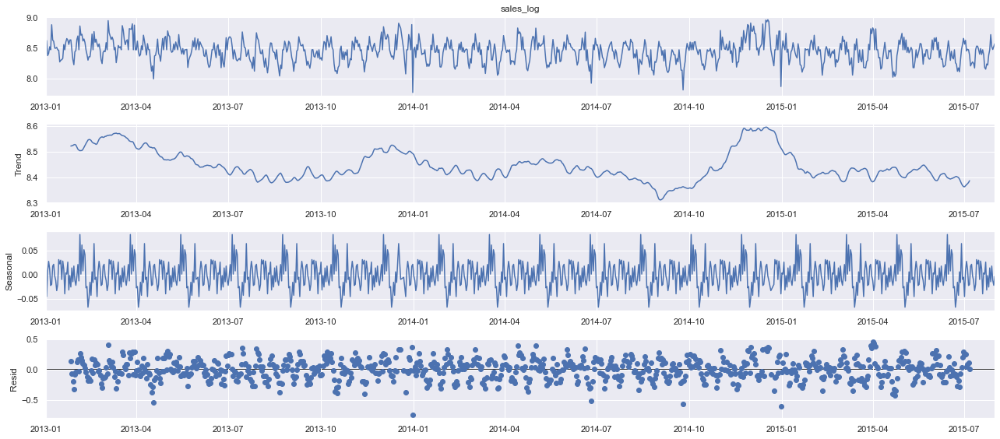

In [82]:
from matplotlib.pyplot import rcParams
rcParams['figure.figsize'] = 18,8
decomposition = sm.tsa.seasonal_decompose(new_df['sales_log'], model = "additive",period=50)
fig = decomposition.plot()

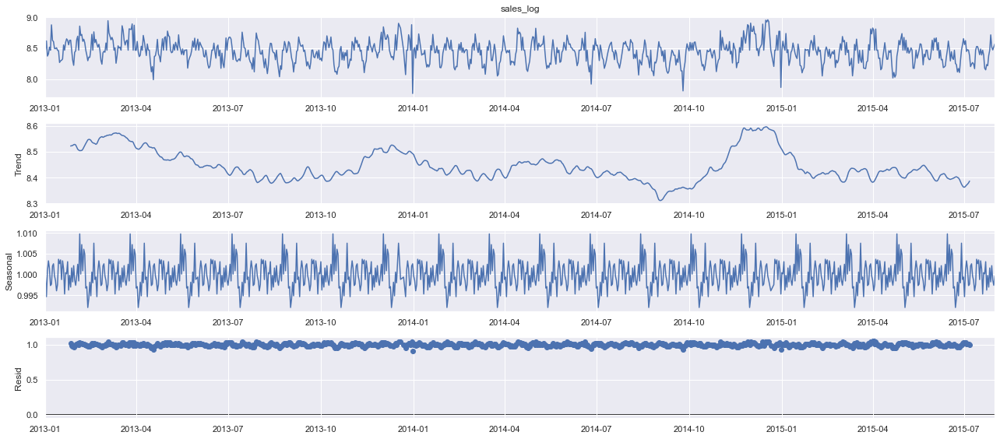

In [83]:
from matplotlib.pyplot import rcParams
rcParams['figure.figsize'] = 18,8
decomposition = sm.tsa.seasonal_decompose(new_df['sales_log'], model = "multiplicative",period=50)
fig = decomposition.plot()

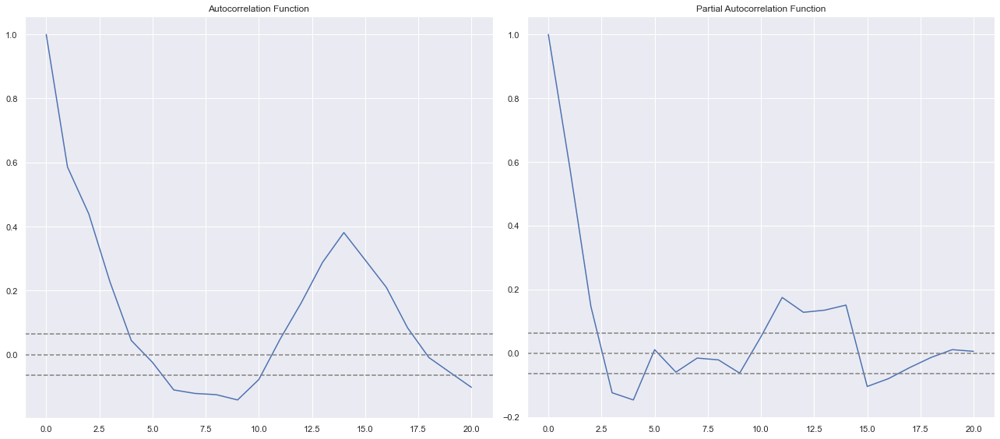

In [84]:
#ACF & PACF plots

lag_acf = acf(new_df['sales_log'], nlags=20) # MA 
lag_pacf = pacf(new_df['sales_log'], nlags=20, method='ols')  # AR 

#Plot ACF:
plt.subplot(121)
plt.plot(lag_acf)
plt.axhline(y=0, linestyle='--', color='gray')
plt.axhline(y=-1.96/np.sqrt(len(new_df['sales_log'])), linestyle='--', color='gray')
plt.axhline(y=1.96/np.sqrt(len(new_df['sales_log'])), linestyle='--', color='gray')
plt.title('Autocorrelation Function')            

#Plot PACF
plt.subplot(122)
plt.plot(lag_pacf)
plt.axhline(y=0, linestyle='--', color='gray')
plt.axhline(y=-1.96/np.sqrt(len(new_df['sales_log'])), linestyle='--', color='gray')
plt.axhline(y=1.96/np.sqrt(len(new_df['sales_log'])), linestyle='--', color='gray')
plt.title('Partial Autocorrelation Function')
            
plt.tight_layout() 

From the ACF graph, we see that curve touches y=0.0 line at x=5. Thus, from theory, Q = 5 From the PACF graph, we see that curve touches y=0.0 line at x=3. Thus, from theory, P = 3

**Build and evaluate time series forecast**

*Split time series data into training and test set*

In [85]:
train_len = 750
train = new_df['sales'][0:train_len] # first 750days as training set
test = new_df['sales'][train_len:] # last 192 days as out-of-time test set

In [86]:
print(train.shape)
print(test.shape)

(750,)
(182,)


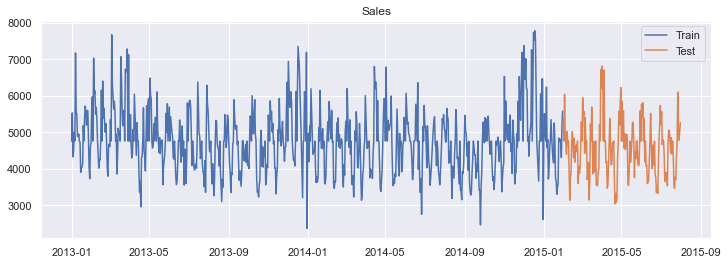

In [87]:
plt.figure(figsize=(12,4))
plt.plot(train, label='Train')
plt.plot(test, label='Test')
plt.legend(loc='best')
plt.title('Sales')
plt.show()

In [88]:
model = ARIMA(new_df['sales_log'], order=(3, 0, 5))
model_fit = model.fit()
print(model_fit.params)

const              8.443995
ar.L1.sales_log    1.407014
ar.L2.sales_log   -0.348628
ar.L3.sales_log   -0.329232
ma.L1.sales_log   -0.950022
ma.L2.sales_log    0.129485
ma.L3.sales_log    0.150803
ma.L4.sales_log    0.020695
ma.L5.sales_log    0.193045
dtype: float64


In [89]:
new_df['ar_forecast_log'] = model_fit.predict(new_df.index.min(), new_df.index.max())
new_df['arima_forecast_new'] = np.exp(new_df['ar_forecast_log'])
new_df['arima_forecast_new'].head()

date
2013-01-01    4647.083039
2013-01-02    4712.027288
2013-01-03    5087.070091
2013-01-04    4624.629560
2013-01-05    4442.490269
Name: arima_forecast_new, dtype: float64

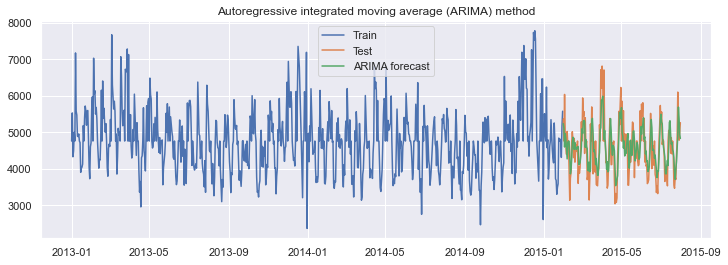

In [90]:
plt.figure(figsize=(12,4))
plt.plot(train, label='Train')
plt.plot(test, label='Test')
plt.plot(new_df['arima_forecast_new'][test.index.min():], label='ARIMA forecast')
plt.legend(loc='best')
plt.title('Autoregressive integrated moving average (ARIMA) method')
plt.show()

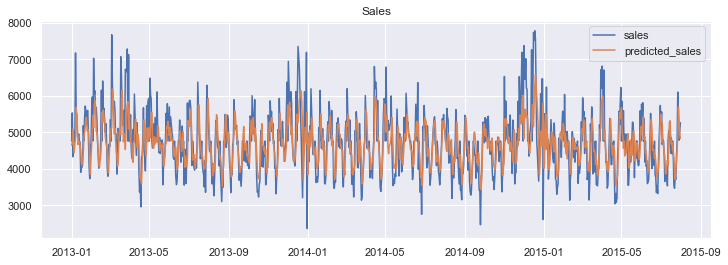

In [91]:
# plot the arima forecasting & Original series
plt.figure(figsize=(12,4))
plt.plot(new_df['sales'], label='sales')
plt.plot(new_df['arima_forecast_new'], label='predicted_sales')
plt.legend(loc='best')
plt.title('Sales')
plt.show()

**Foresting for the next 6 weeks**

In [92]:
#Let's predict the sale for 6 weeks
from pandas.tseries.offsets import DateOffset
future_dates2=[new_df.index[-1]+DateOffset(days=x)for x in range(0,42)]
future_datest_df=pd.DataFrame(index=future_dates2[1:],columns=new_df.columns)

In [93]:
future_datest_df.tail()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,sales_log,ar_forecast_log,arima_forecast_new
2015-09-06,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2015-09-07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2015-09-08,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2015-09-09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2015-09-10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [94]:
future_df=pd.concat([new_df,future_datest_df])
future_df.shape

(973, 11)

In [95]:
new_df.shape

(932, 11)

In [96]:
future_df

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,sales_log,ar_forecast_log,arima_forecast_new
2013-01-01,1,2,4759.096031,0,0,0,a,1,8.467813,8.443995,4647.083039
2013-01-02,1,3,5530.000000,668,1,0,0,1,8.617943,8.457874,4712.027288
2013-01-03,1,4,4327.000000,578,1,0,0,1,8.372630,8.534457,5087.070091
2013-01-04,1,5,4486.000000,619,1,0,0,1,8.408717,8.439152,4624.629560
2013-01-05,1,6,4997.000000,635,1,0,0,1,8.516593,8.398970,4442.490269
...,...,...,...,...,...,...,...,...,...,...,...
2015-09-06,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2015-09-07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2015-09-08,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2015-09-09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [97]:
train_len = 932
train1 = future_df[0:train_len] # first 750days as training set
test1 = future_df[train_len:]

In [98]:
print(future_df.index.min())
print(future_df.index.max())

2013-01-01 00:00:00
2015-09-10 00:00:00


In [99]:
print(new_df.index.min())
print(new_df.index.max())

2013-01-01 00:00:00
2015-07-31 00:00:00


In [100]:
future_df['fore_log']=model_fit.forecast(steps=973)[0]

In [101]:
future_df['arima_fore'] = np.exp(future_df['fore_log'])

In [102]:
future_df['arima_fore']

2013-01-01    5038.740063
2013-01-02    4795.769889
2013-01-03    4489.943906
2013-01-04    4284.405666
2013-01-05    4221.112459
                 ...     
2015-09-06    4647.083039
2015-09-07    4647.083039
2015-09-08    4647.083039
2015-09-09    4647.083039
2015-09-10    4647.083039
Name: arima_fore, Length: 973, dtype: float64

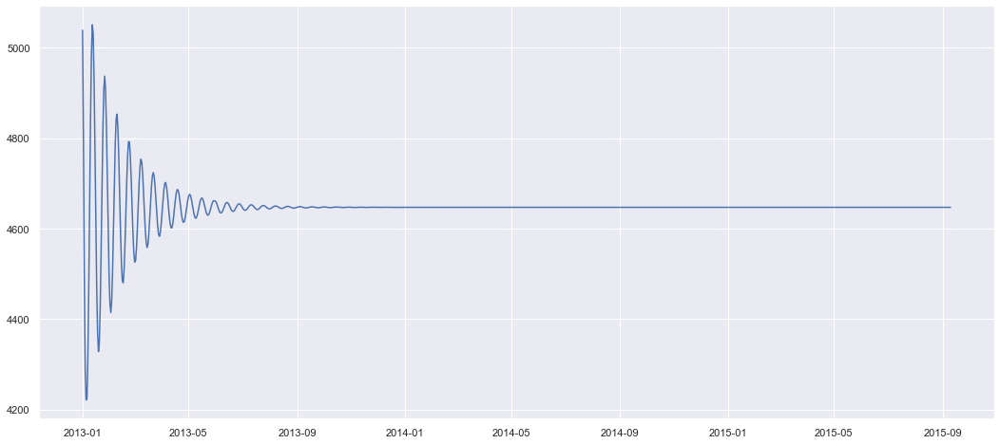

In [103]:
#Let's plot the graph
plt.plot(future_df['arima_fore'], label='Predicted_Sales')
plt.show()

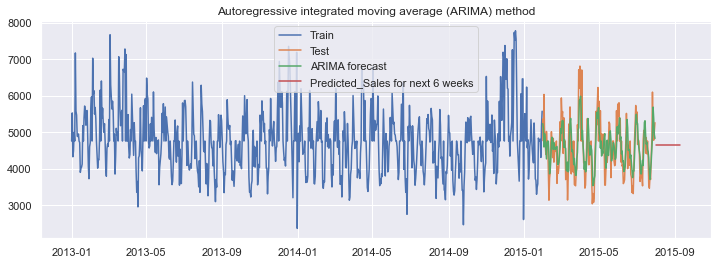

In [104]:
plt.figure(figsize=(12,4))
plt.plot(train, label='Train')
plt.plot(test, label='Test')
plt.plot(new_df['arima_forecast_new'][test.index.min():], label='ARIMA forecast')
plt.plot(future_df['arima_fore'][932:], label='Predicted_Sales for next 6 weeks')
plt.legend(loc='best')
plt.title('Autoregressive integrated moving average (ARIMA) method')
plt.show()

In [105]:
from sklearn.metrics import mean_squared_error
rmse = np.sqrt(mean_squared_error(test, new_df['arima_forecast_new'][test.index.min():])).round(2)
mape = np.round(np.mean(np.abs(test-new_df['arima_forecast_new'][test.index.min():])/test)*100,2)
Results = pd.DataFrame({'Method':['ARIMA'], 'RMSE': [rmse],'MAPE': [mape] })
Results 

,Method,RMSE,MAPE
0,ARIMA,558.95,9.98


**VAR model**

In [106]:
#Load the dataset
new_df.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,sales_log,ar_forecast_log,arima_forecast_new
date,,,,,,,,,,,
2013-01-01,1,2,4759.096031,0,0,0,a,1,8.467813,8.443995,4647.083039
2013-01-02,1,3,5530.000000,668,1,0,0,1,8.617943,8.457874,4712.027288
2013-01-03,1,4,4327.000000,578,1,0,0,1,8.372630,8.534457,5087.070091
2013-01-04,1,5,4486.000000,619,1,0,0,1,8.408717,8.439152,4624.629560
2013-01-05,1,6,4997.000000,635,1,0,0,1,8.516593,8.398970,4442.490269


**Split the dataset to training & testing**

In [107]:
#split the dataset
nobs = 182
train, test = new_df[0:-nobs], new_df[-nobs:]

# Check size
print(train.shape)
print(test.shape)  

(750, 11)
(182, 11)


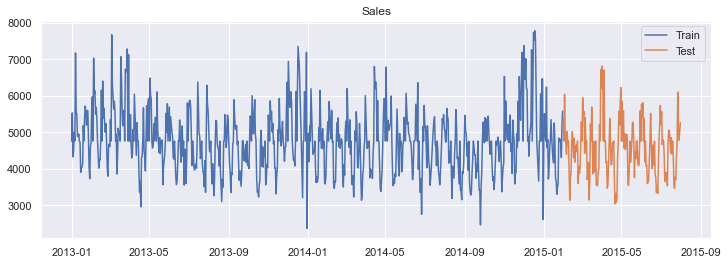

In [108]:
plt.figure(figsize=(12,4))
plt.plot(train['sales'], label='Train')
plt.plot(test['sales'], label='Test')
plt.legend(loc='best')
plt.title('Sales')
plt.show()

**ADF Stationary test**

In [109]:
def test_stationarity(timeseries):
    
    #Determine rolling statistics
    movingAverage = timeseries.rolling(window=12).mean()
    movingSTD = timeseries.rolling(window=12).std()
    
    #Plot rolling statistics
    orig = plt.plot(timeseries, color='blue', label='Original')
    mean = plt.plot(movingAverage, color='red', label='Rolling Mean')
    std = plt.plot(movingSTD, color='black', label='Rolling Std')
    plt.legend(loc='best')
    plt.title('Rolling Mean & Standard Deviation')
    plt.show(block=False)
    
    #Perform Dickey–Fuller test:
    print('Results of Dickey Fuller Test:')
    dftest = adfuller(indexed_df_store1_new['sales'], autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    for key,value in dftest[4].items():
        dfoutput['Critical Value (%s)'%key] = value
    print(dfoutput)

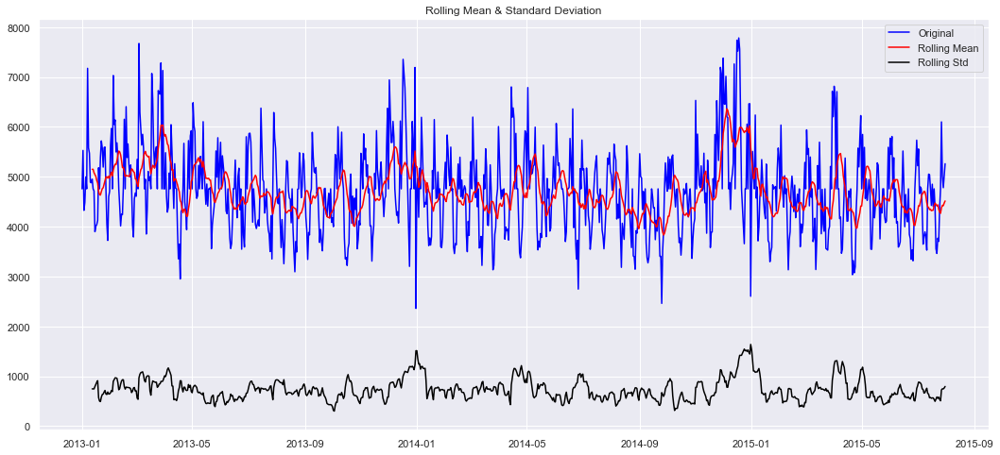

Results of Dickey Fuller Test:
Test Statistic                  -5.533321
p-value                          0.000002
#Lags Used                      16.000000
Number of Observations Used    925.000000
Critical Value (1%)             -3.437439
Critical Value (5%)             -2.864670
Critical Value (10%)            -2.568436
dtype: float64


In [110]:
test_stationarity(new_df['sales'])

- Null: Time Series is not stationary
- Alternate: Time Series is Stationary

**The p-value is less than 0.05 so The series is stationary**

In [111]:
from statsmodels.tsa.stattools import kpss
kpss_test = kpss(new_df['sales'])

print('KPSS Statistic: %f' % kpss_test[0])
print('Critical Values @ 0.05: %.2f' % kpss_test[3]['5%'])
print('p-value: %f' % kpss_test[1])

KPSS Statistic: 0.363547
Critical Values @ 0.05: 0.46
p-value: 0.092868


- Null: Time Series is not stationary
- Alternate: Time Series is Stationary

**The p-value is greater than 0.05 so The series is stationary**


In [112]:
#Load the dataset
new_df.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,sales_log,ar_forecast_log,arima_forecast_new
date,,,,,,,,,,,
2013-01-01,1,2,4759.096031,0,0,0,a,1,8.467813,8.443995,4647.083039
2013-01-02,1,3,5530.000000,668,1,0,0,1,8.617943,8.457874,4712.027288
2013-01-03,1,4,4327.000000,578,1,0,0,1,8.372630,8.534457,5087.070091
2013-01-04,1,5,4486.000000,619,1,0,0,1,8.408717,8.439152,4624.629560
2013-01-05,1,6,4997.000000,635,1,0,0,1,8.516593,8.398970,4442.490269


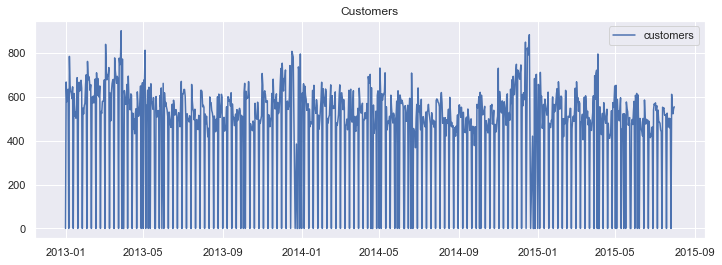

In [113]:
#plot the arima forecasting & Original series
plt.figure(figsize=(12,4))
plt.plot(new_df['customers'],label='customers')
plt.legend(loc='best')
plt.title('Customers')
plt.show()

In [114]:
(new_df['customers']==0).sum()

161

In [115]:
#impute the NAN values
new_df['customers']=new_df['customers'].replace(0, np.nan)

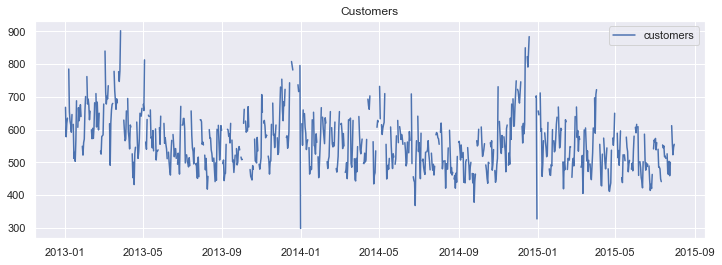

In [116]:
#plot the arima forecasting & Original series
plt.figure(figsize=(12,4))
plt.plot(new_df['customers'],label='customers')
plt.legend(loc='best')
plt.title('Customers')
plt.show()

In [117]:
#KNN imputer for filling NAN values
imputer = KNNImputer(n_neighbors=2)

In [118]:
new_df['customers'] = imputer.fit_transform(np.array(new_df['customers']).reshape(-1, 1))
new_df['customers']

date
2013-01-01    559.342412
2013-01-02    668.000000
2013-01-03    578.000000
2013-01-04    619.000000
2013-01-05    635.000000
                 ...    
2015-07-27    612.000000
2015-07-28    560.000000
2015-07-29    523.000000
2015-07-30    546.000000
2015-07-31    555.000000
Name: customers, Length: 932, dtype: float64

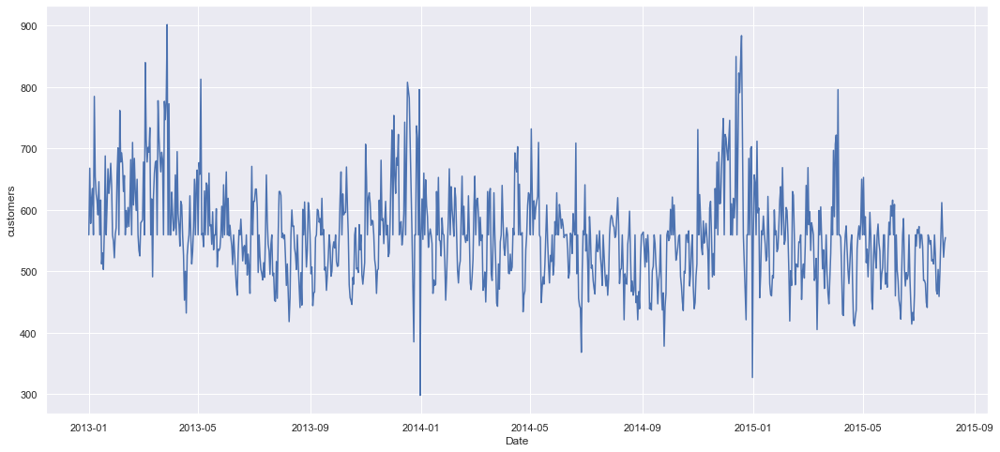

In [119]:
## plot graph
plt.xlabel('Date')
plt.ylabel('customers')
plt.plot(new_df['customers'])
plt.show()

In [120]:
new_df

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,sales_log,ar_forecast_log,arima_forecast_new
date,,,,,,,,,,,
2013-01-01,1,2,4759.096031,559.342412,0,0,a,1,8.467813,8.443995,4647.083039
2013-01-02,1,3,5530.000000,668.000000,1,0,0,1,8.617943,8.457874,4712.027288
2013-01-03,1,4,4327.000000,578.000000,1,0,0,1,8.372630,8.534457,5087.070091
2013-01-04,1,5,4486.000000,619.000000,1,0,0,1,8.408717,8.439152,4624.629560
2013-01-05,1,6,4997.000000,635.000000,1,0,0,1,8.516593,8.398970,4442.490269
...,...,...,...,...,...,...,...,...,...,...,...
2015-07-27,1,1,6102.000000,612.000000,1,1,0,1,8.716372,8.498349,4906.663682
2015-07-28,1,2,5011.000000,560.000000,1,1,0,1,8.519391,8.646584,5690.675574
2015-07-29,1,3,4782.000000,523.000000,1,1,0,1,8.472614,8.590659,5381.159040


In [121]:
train_len = 750
train['sales'] = new_df['sales'][0:train_len] # first 7500days as training set
test['sales'] = new_df['sales'][train_len:] # last 182 days as out-of-time test set

In [122]:
train

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,sales_log,ar_forecast_log,arima_forecast_new
date,,,,,,,,,,,
2013-01-01,1,2,4759.096031,0,0,0,a,1,8.467813,8.443995,4647.083039
2013-01-02,1,3,5530.000000,668,1,0,0,1,8.617943,8.457874,4712.027288
2013-01-03,1,4,4327.000000,578,1,0,0,1,8.372630,8.534457,5087.070091
2013-01-04,1,5,4486.000000,619,1,0,0,1,8.408717,8.439152,4624.629560
2013-01-05,1,6,4997.000000,635,1,0,0,1,8.516593,8.398970,4442.490269
...,...,...,...,...,...,...,...,...,...,...,...
2015-01-26,1,1,4781.000000,566,1,1,0,0,8.472405,8.511856,4973.387295
2015-01-27,1,2,4806.000000,532,1,1,0,0,8.477620,8.518081,5004.443418
2015-01-28,1,3,4310.000000,537,1,1,0,0,8.368693,8.500053,4915.027597


**ADF Test**

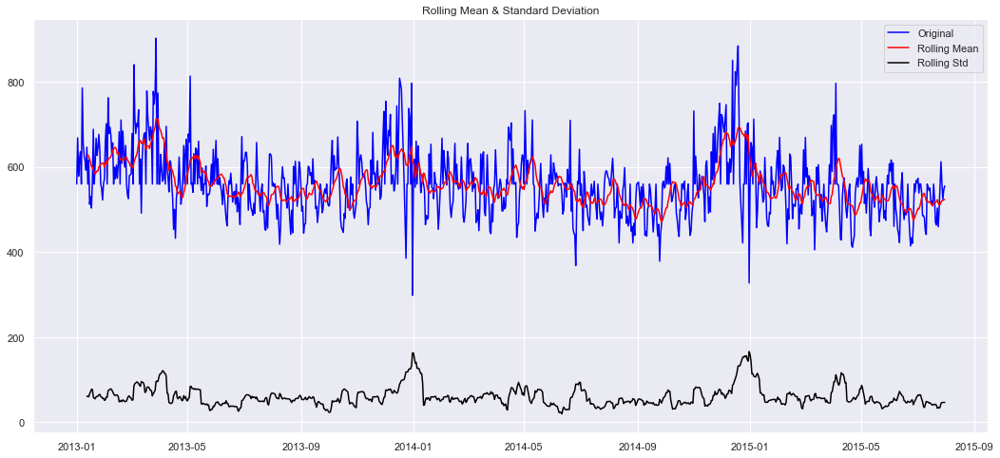

Results of Dickey Fuller Test:
Test Statistic                  -5.533321
p-value                          0.000002
#Lags Used                      16.000000
Number of Observations Used    925.000000
Critical Value (1%)             -3.437439
Critical Value (5%)             -2.864670
Critical Value (10%)            -2.568436
dtype: float64


In [123]:
test_stationarity(new_df['customers'])

- Null: Time Series is not stationary
- Alternate: Time Series is Stationary

**The p-value is less than 0.05 so The series is stationary**

In [124]:
from statsmodels.tsa.stattools import kpss
kpss_test = kpss(new_df['sales'])

print('KPSS Statistic: %f' % kpss_test[0])
print('Critical Values @ 0.05: %.2f' % kpss_test[3]['5%'])
print('p-value: %f' % kpss_test[1])

KPSS Statistic: 0.363547
Critical Values @ 0.05: 0.46
p-value: 0.092868


- Null: Time Series is not stationary
- Alternate: Time Series is Stationary

**The p-value is greater than 0.05 so The series is stationary**

**Sales and Customers are stationary time-series**

**Log transformation has made mean & variance constant**

In [125]:
#Log Transformation
new_df['customers_log'] = np.log(new_df['customers'])
new_df.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,sales_log,ar_forecast_log,arima_forecast_new,customers_log
date,,,,,,,,,,,,
2013-01-01,1,2,4759.096031,559.342412,0,0,a,1,8.467813,8.443995,4647.083039,6.326762
2013-01-02,1,3,5530.000000,668.000000,1,0,0,1,8.617943,8.457874,4712.027288,6.504288
2013-01-03,1,4,4327.000000,578.000000,1,0,0,1,8.372630,8.534457,5087.070091,6.359574
2013-01-04,1,5,4486.000000,619.000000,1,0,0,1,8.408717,8.439152,4624.629560,6.428105
2013-01-05,1,6,4997.000000,635.000000,1,0,0,1,8.516593,8.398970,4442.490269,6.453625


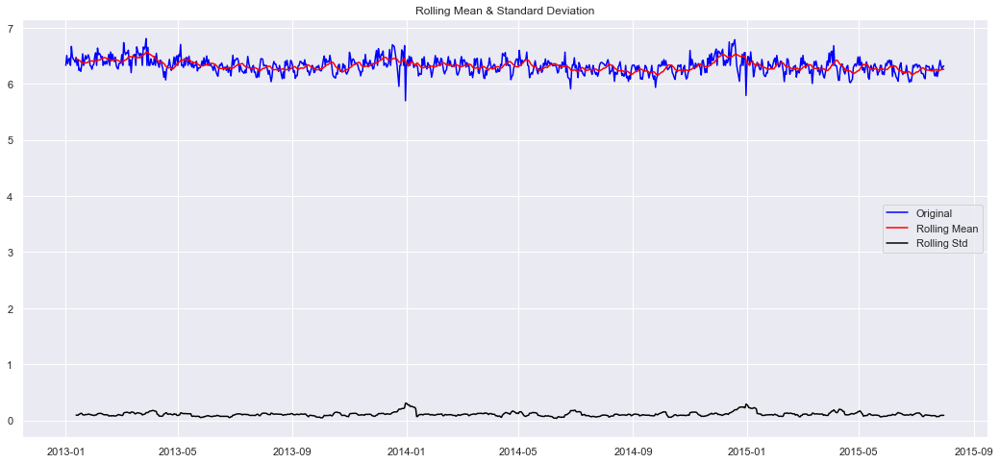

Results of Dickey Fuller Test:
Test Statistic                  -5.533321
p-value                          0.000002
#Lags Used                      16.000000
Number of Observations Used    925.000000
Critical Value (1%)             -3.437439
Critical Value (5%)             -2.864670
Critical Value (10%)            -2.568436
dtype: float64


In [126]:
test_stationarity(new_df['customers_log'])

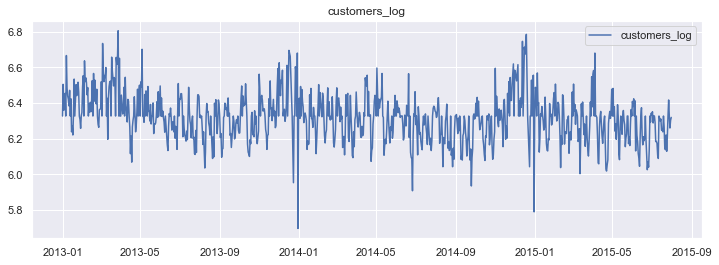

In [127]:
#plot the arima Log series
plt.figure(figsize=(12,4))
plt.plot(new_df['customers_log'],label='customers_log')
plt.legend(loc='best')
plt.title('customers_log')
plt.show()

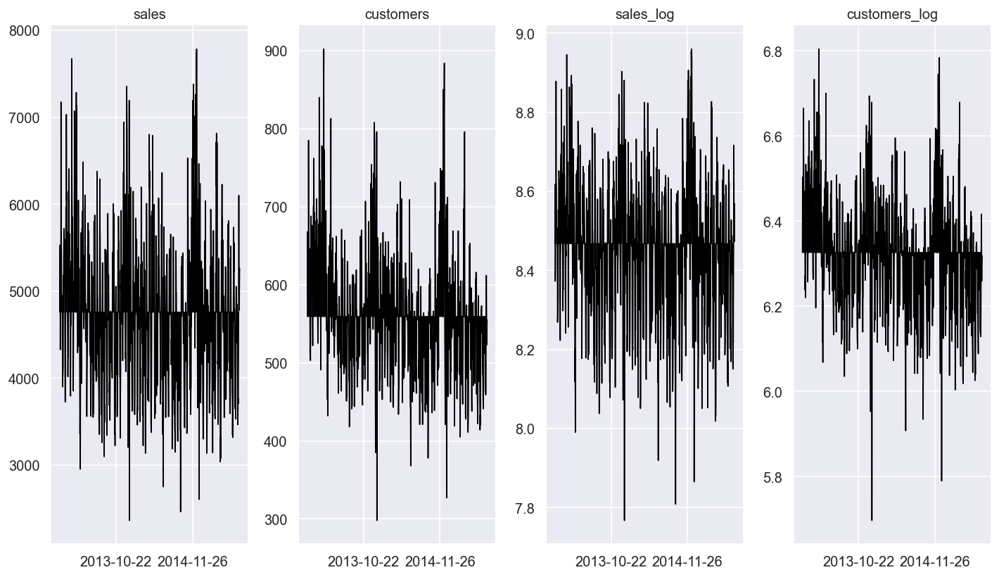

In [128]:
# Plot
ls=['sales','customers','sales_log','customers_log','open','promo','state_holiday',]
df=new_df[ls]
fig, axes = plt.subplots(nrows=1, ncols=4, dpi=120, figsize=(12,7))
for i, ax in enumerate(axes.flatten()):
        ax.plot(df[df.columns[i]], color='black', linewidth=1)
        ax.xaxis.set_major_locator(plt.MaxNLocator(3))
        # Decorations
        ax.set_title(df.columns[i])
        ax.xaxis.set_ticks_position('none')
        ax.yaxis.set_ticks_position('none')
        ax.spines["top"].set_alpha(0)
        ax.tick_params(labelsize=12)

plt.tight_layout();

In [129]:
new_df.columns

Index(['store', 'day_of_week', 'sales', 'customers', 'open', 'promo',
       'state_holiday', 'school_holiday', 'sales_log', 'ar_forecast_log',
       'arima_forecast_new', 'customers_log'],
      dtype='object')

In [130]:
new_df1=new_df[['sales_log', 'customers_log']]
new_df1

,sales_log,customers_log
date,,
2013-01-01,8.467813,6.326762
2013-01-02,8.617943,6.504288
2013-01-03,8.372630,6.359574
2013-01-04,8.408717,6.428105
2013-01-05,8.516593,6.453625
...,...,...
2015-07-27,8.716372,6.416732
2015-07-28,8.519391,6.327937
2015-07-29,8.472614,6.259581


In [131]:
#Let's create a model
model = VAR(new_df1)
for i in [1,2,3,4,5]:
    result = model.fit(i)
    print('Lag Order =', i)
    print('AIC : ', result.aic)
    print('BIC : ', result.bic)
    print('FPE : ', result.fpe)
    print('HQIC: ', result.hqic, '\n')

Lag Order = 1
AIC :  -9.989436860230873
BIC :  -9.958268701623286
FPE :  4.588203941521135e-05
HQIC:  -9.977549762150327 

Lag Order = 2
AIC :  -10.05848121937881
BIC :  -10.006489987269699
FPE :  4.282103893852147e-05
HQIC:  -10.038651467210395 

Lag Order = 3
AIC :  -10.080458668127578
BIC :  -10.007608805540501
FPE :  4.189022307763405e-05
HQIC:  -10.052671876071262 

Lag Order = 4
AIC :  -10.122637318935425
BIC :  -10.028893168946038
FPE :  4.0160119675475125e-05
HQIC:  -10.086879059717619 

Lag Order = 5
AIC :  -10.195205679952629
BIC :  -10.08053148530058
FPE :  3.7349036174328735e-05
HQIC:  -10.151461484662905 



In [132]:
x = model.select_order(maxlags=5)
x.summary()

,AIC,BIC,FPE,HQIC
0,-9.405,-9.395,8.230e-05,-9.401
1,-9.994,-9.963,4.568e-05,-9.982
2,-10.06,-10.01,4.271e-05,-10.04
3,-10.08,-10.01,4.183e-05,-10.05
4,-10.12,-10.03,4.020e-05,-10.09
5,-10.20*,-10.08*,3.735e-05*,-10.15*


In [133]:
#Let's fit the model
model_fitted = model.fit()
model_fitted.summary()

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Mon, 17, Jan, 2022
Time:                     15:45:57
--------------------------------------------------------------------
No. of Equations:         2.00000    BIC:                   -9.95827
Nobs:                     931.000    HQIC:                  -9.97755
Log likelihood:           2014.02    FPE:                4.58820e-05
AIC:                     -9.98944    Det(Omega_mle):     4.55878e-05
--------------------------------------------------------------------
Results for equation sales_log
                      coefficient       std. error           t-stat            prob
-----------------------------------------------------------------------------------
const                    3.555934         0.228387           15.570           0.000
L1.sales_log             0.680813         0.069305            9.823           0.000
L1.customers_log        -0.136231         0.

In [134]:
# Get the lag order
lag_order = model_fitted.k_ar
print(lag_order)  #> 4

1


In [135]:
# Input data for forecasting
forecast_input = new_df1.values[-lag_order:]
forecast_input

array([[8.56845649, 6.31896811]])

In [136]:
# Forecast
fc = model_fitted.forecast(y=forecast_input, steps=282)
df_forecast = pd.DataFrame(fc, index=future_df.index[-282:], columns=new_df1.columns + '_2d')
df_forecast

,sales_log_2d,customers_log_2d
2014-11-29,8.528608,6.341029
2014-11-30,8.498474,6.340457
2014-12-01,8.478035,6.334751
2014-12-02,8.464898,6.329257
2014-12-03,8.456703,6.325166
...,...,...
2015-09-06,8.444084,6.317865
2015-09-07,8.444084,6.317865
2015-09-08,8.444084,6.317865
2015-09-09,8.444084,6.317865


In [137]:
df_forecast['VAR_forecast_Sales'] = np.exp(df_forecast['sales_log_2d'])
df_forecast['VAR_forecast_customers'] = np.exp(df_forecast['customers_log_2d'])
df_forecast

,sales_log_2d,customers_log_2d,VAR_forecast_Sales,VAR_forecast_customers
2014-11-29,8.528608,6.341029,5057.401916,567.379879
2014-11-30,8.498474,6.340457,4907.272491,567.055422
2014-12-01,8.478035,6.334751,4807.995171,563.829234
2014-12-02,8.464898,6.329257,4745.244520,560.739641
2014-12-03,8.456703,6.325166,4706.514078,558.450729
...,...,...,...,...
2015-09-06,8.444084,6.317865,4647.498000,554.388163
2015-09-07,8.444084,6.317865,4647.498000,554.388163
2015-09-08,8.444084,6.317865,4647.498000,554.388163
2015-09-09,8.444084,6.317865,4647.498000,554.388163


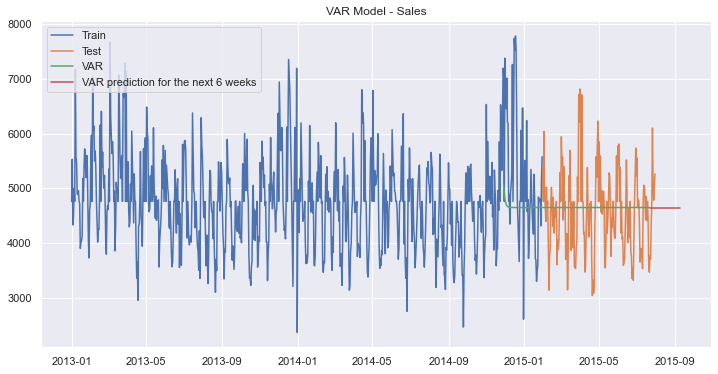

In [138]:
plt.figure(figsize=(12,6)) 
plt.plot(train['sales'], label='Train')
plt.plot(test['sales'], label='Test')
plt.plot(df_forecast['VAR_forecast_Sales'][:232], label='VAR')
plt.plot(df_forecast['VAR_forecast_Sales'][232:], label='VAR prediction for the next 6 weeks')
plt.legend(loc='best')
plt.title('VAR Model - Sales')
plt.show()

In [139]:
train_len = 750
train['customers'] = new_df['customers'][0:train_len] # first 750days as training set
test['customers'] = new_df['customers'][train_len:] # last 42 days as out-of-time test set

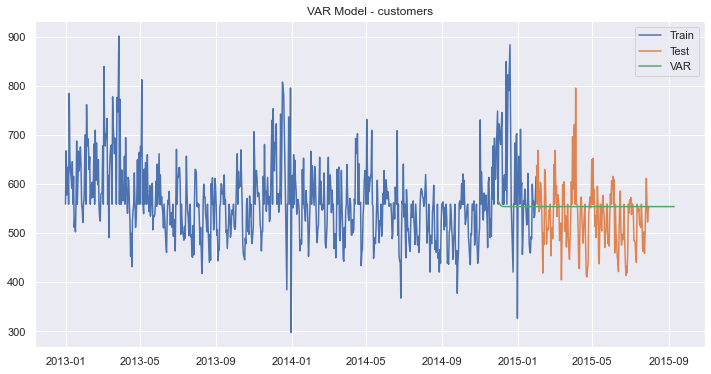

In [140]:
plt.figure(figsize=(12,6)) 
plt.plot(train['customers'], label='Train')
plt.plot(test['customers'], label='Test')
plt.plot(df_forecast['VAR_forecast_customers'], label='VAR')
plt.legend(loc='best')
plt.title('VAR Model - customers')
plt.show()

In [141]:
# Let's calculate the rmse and MAPE
rmse = np.sqrt(mean_squared_error(test['sales'], df_forecast['VAR_forecast_Sales'][:182])).round(2)
mape = np.round(np.mean(np.abs(test['sales']-df_forecast['VAR_forecast_Sales'][:182])/test['sales'])*100,2)
tempResults = pd.DataFrame({'Method':['VAR'], 'RMSE': [rmse],'MAPE': [mape] })

In [142]:
tempResults

,Method,RMSE,MAPE
0,VAR,758.81,13.54


In [143]:
results = pd.concat([Results , tempResults])
results = results[['Method', 'RMSE', 'MAPE']]
results

,Method,RMSE,MAPE
0,ARIMA,558.95,9.98
0,VAR,758.81,13.54


**Johansen-Impulse**

In [144]:
joh_model1 = coint_johansen(new_df[['sales','customers']],-1,1)

In [145]:
joh_model1

In [146]:
joh_model1.lr2 #Max Eign Value Stats

array([159.21364297,   1.67043269])

In [147]:
joh_model1.lr1 #Trace Stats

array([160.88407566,   1.67043269])

In [148]:
new_df[['sales','customers']].shape #Shape of Data

(932, 2)

In [149]:
def joh_output(res):
    output = pd.DataFrame([res.lr2,res.lr1],
                          index=['max_eig_stat',"trace_stat"])
    print(output.T,'\n')
    print("Critical values(90%, 95%, 99%) of max_eig_stat\n",res.cvm,'\n')
    print("Critical values(90%, 95%, 99%) of trace_stat\n",res.cvt,'\n')

In [150]:
joh_output(joh_model1)

   max_eig_stat  trace_stat
0    159.213643  160.884076
1      1.670433    1.670433 

Critical values(90%, 95%, 99%) of max_eig_stat
 [[ 9.4748 11.2246 15.0923]
 [ 2.9762  4.1296  6.9406]] 

Critical values(90%, 95%, 99%) of trace_stat
 [[10.4741 12.3212 16.364 ]
 [ 2.9762  4.1296  6.9406]] 



In [151]:
from statsmodels.tsa.vector_ar.vecm import select_coint_rank

In [152]:
rank=select_coint_rank(new_df[['sales','customers']],-1,1)
print(rank.rank)

1


**Rank is one**

In [153]:
from statsmodels.tsa.stattools import coint

In [154]:
coint(new_df['sales'],new_df['customers'])#null hypothesis-There is not coint

(-4.383312619898611,
 0.0018921042636345958,
 array([-3.90824227, -3.34270081, -3.04900867]))

0.0018921042636345958<.05

We can reject the null hypothesis

**Sales and customers are cointegration to each other**

**VARMAX MODEL**

In [155]:
# create dymmy variables
new_df1=pd.get_dummies(new_df)
new_df1.head()

,store,day_of_week,sales,customers,open,promo,school_holiday,sales_log,ar_forecast_log,arima_forecast_new,customers_log,state_holiday_0,state_holiday_0,state_holiday_a,state_holiday_b,state_holiday_c
date,,,,,,,,,,,,,,,,
2013-01-01,1,2,4759.096031,559.342412,0,0,1,8.467813,8.443995,4647.083039,6.326762,0,0,1,0,0
2013-01-02,1,3,5530.000000,668.000000,1,0,1,8.617943,8.457874,4712.027288,6.504288,0,1,0,0,0
2013-01-03,1,4,4327.000000,578.000000,1,0,1,8.372630,8.534457,5087.070091,6.359574,0,1,0,0,0
2013-01-04,1,5,4486.000000,619.000000,1,0,1,8.408717,8.439152,4624.629560,6.428105,0,1,0,0,0
2013-01-05,1,6,4997.000000,635.000000,1,0,1,8.516593,8.398970,4442.490269,6.453625,0,1,0,0,0


In [156]:
new_df1.head()

,store,day_of_week,sales,customers,open,promo,school_holiday,sales_log,ar_forecast_log,arima_forecast_new,customers_log,state_holiday_0,state_holiday_0,state_holiday_a,state_holiday_b,state_holiday_c
date,,,,,,,,,,,,,,,,
2013-01-01,1,2,4759.096031,559.342412,0,0,1,8.467813,8.443995,4647.083039,6.326762,0,0,1,0,0
2013-01-02,1,3,5530.000000,668.000000,1,0,1,8.617943,8.457874,4712.027288,6.504288,0,1,0,0,0
2013-01-03,1,4,4327.000000,578.000000,1,0,1,8.372630,8.534457,5087.070091,6.359574,0,1,0,0,0
2013-01-04,1,5,4486.000000,619.000000,1,0,1,8.408717,8.439152,4624.629560,6.428105,0,1,0,0,0
2013-01-05,1,6,4997.000000,635.000000,1,0,1,8.516593,8.398970,4442.490269,6.453625,0,1,0,0,0


In [157]:
future_df.columns

Index(['store', 'day_of_week', 'sales', 'customers', 'open', 'promo',
       'state_holiday', 'school_holiday', 'sales_log', 'ar_forecast_log',
       'arima_forecast_new', 'fore_log', 'arima_fore'],
      dtype='object')

In [158]:
#Let's fill random values for future forecasting
future_df['open'][932:]=future_df['open'][891:932]
future_df['promo'][932:]=future_df['promo'][891:932]
future_df['school_holiday'][932:]=future_df['school_holiday'][891:932]
future_df['state_holiday'][932:]=future_df['state_holiday'][891:932]

In [159]:
future_df.tail()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,sales_log,ar_forecast_log,arima_forecast_new,fore_log,arima_fore
2015-09-06,NaN,NaN,NaN,NaN,1,1,0,1,NaN,NaN,NaN,8.443995,4647.083039
2015-09-07,NaN,NaN,NaN,NaN,1,1,0,1,NaN,NaN,NaN,8.443995,4647.083039
2015-09-08,NaN,NaN,NaN,NaN,1,1,0,1,NaN,NaN,NaN,8.443995,4647.083039
2015-09-09,NaN,NaN,NaN,NaN,1,1,0,1,NaN,NaN,NaN,8.443995,4647.083039
2015-09-10,NaN,NaN,NaN,NaN,1,1,0,1,NaN,NaN,NaN,8.443995,4647.083039


In [160]:
future_df['state_holiday'].unique()

array(['a', '0', 'b', 'c', 0], dtype=object)

In [161]:
# create dymmy variables
future_df1=pd.get_dummies(future_df)
future_df1.head()

,sales,sales_log,ar_forecast_log,arima_forecast_new,fore_log,arima_fore,store_1,day_of_week_1,day_of_week_2,day_of_week_3,...,open_1,promo_0,promo_1,state_holiday_0,state_holiday_0,state_holiday_a,state_holiday_b,state_holiday_c,school_holiday_0,school_holiday_1
2013-01-01,4759.096031,8.467813,8.443995,4647.083039,8.524911,5038.740063,1,0,1,0,...,0,1,0,0,0,1,0,0,0,1
2013-01-02,5530.000000,8.617943,8.457874,4712.027288,8.475490,4795.769889,1,0,0,1,...,1,1,0,0,1,0,0,0,0,1
2013-01-03,4327.000000,8.372630,8.534457,5087.070091,8.409595,4489.943906,1,0,0,0,...,1,1,0,0,1,0,0,0,0,1
2013-01-04,4486.000000,8.408717,8.439152,4624.629560,8.362737,4284.405666,1,0,0,0,...,1,1,0,0,1,0,0,0,0,1
2013-01-05,4997.000000,8.516593,8.398970,4442.490269,8.347854,4221.112459,1,0,0,0,...,1,1,0,0,1,0,0,0,0,1


In [162]:
future_df.tail()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,sales_log,ar_forecast_log,arima_forecast_new,fore_log,arima_fore
2015-09-06,NaN,NaN,NaN,NaN,1,1,0,1,NaN,NaN,NaN,8.443995,4647.083039
2015-09-07,NaN,NaN,NaN,NaN,1,1,0,1,NaN,NaN,NaN,8.443995,4647.083039
2015-09-08,NaN,NaN,NaN,NaN,1,1,0,1,NaN,NaN,NaN,8.443995,4647.083039
2015-09-09,NaN,NaN,NaN,NaN,1,1,0,1,NaN,NaN,NaN,8.443995,4647.083039
2015-09-10,NaN,NaN,NaN,NaN,1,1,0,1,NaN,NaN,NaN,8.443995,4647.083039


In [163]:
exog = new_df1[['open','promo','school_holiday','state_holiday_0','state_holiday_a','state_holiday_b','state_holiday_c']]
mod = sm.tsa.VARMAX(new_df1[['sales_log', 'customers_log']], order=(1,1), trend='n', exog=exog)
res = mod.fit(maxiter=1000, disp=False)
print(res.summary())

                                 Statespace Model Results                                 
Dep. Variable:     ['sales_log', 'customers_log']   No. Observations:                  932
Model:                                VARMAX(1,1)   Log Likelihood                2176.111
Date:                            Mon, 17 Jan 2022   AIC                          -4298.222
Time:                                    15:47:49   BIC                          -4167.614
Sample:                                         0   HQIC                         -4248.412
                                            - 932                                         
Covariance Type:                              opg                                         
Ljung-Box (L1) (Q):             0.02, 1.45   Jarque-Bera (JB):         196.75, 7.03
Prob(Q):                        0.90, 0.23   Prob(JB):                   0.00, 0.03
Heteroskedasticity (H):         1.40, 1.02   Skew:                       0.11, 0.03
Prob(H) (two-sided):

In [164]:
start_index = test.index.min()
end_index = test.index.max()

In [165]:
print(start_index)
print(start_index)

2015-01-31 00:00:00
2015-01-31 00:00:00


In [166]:
predictions = mod.fit().predict(start=start_index, end=start_index, exog=test['promo'])

In [167]:
predictions1 = mod.fit().predict(new_df1.index.min(),new_df1.index.max(),exog=new_df1[['open','promo','school_holiday','state_holiday_0','state_holiday_a','state_holiday_b','state_holiday_c']])

In [168]:
predictions1

,sales_log,customers_log
date,,
2013-01-01,8.345930,6.269453
2013-01-02,8.378699,6.287885
2013-01-03,8.435389,6.352964
2013-01-04,8.370154,6.309346
2013-01-05,8.385269,6.333584
...,...,...
2015-07-27,8.530077,6.351869
2015-07-28,8.597351,6.382836
2015-07-29,8.546037,6.354381


In [169]:
#inverse of log
predictions1['VARMAX_forecast_Sales'] = np.exp(predictions1['sales_log'])
predictions1['VARMAX_forecast_customers'] = np.exp(predictions1['customers_log'])
predictions1 

,sales_log,customers_log,VARMAX_forecast_Sales,VARMAX_forecast_customers
date,,,,
2013-01-01,8.345930,6.269453,4212.998540,528.188490
2013-01-02,8.378699,6.287885,4353.343161,538.014478
2013-01-03,8.435389,6.352964,4607.263098,574.191966
2013-01-04,8.370154,6.309346,4316.302768,549.685275
2013-01-05,8.385269,6.333584,4382.038039,563.171378
...,...,...,...,...
2015-07-27,8.530077,6.351869,5064.833613,573.563968
2015-07-28,8.597351,6.382836,5417.288703,591.603261
2015-07-29,8.546037,6.354381,5146.318148,575.006051


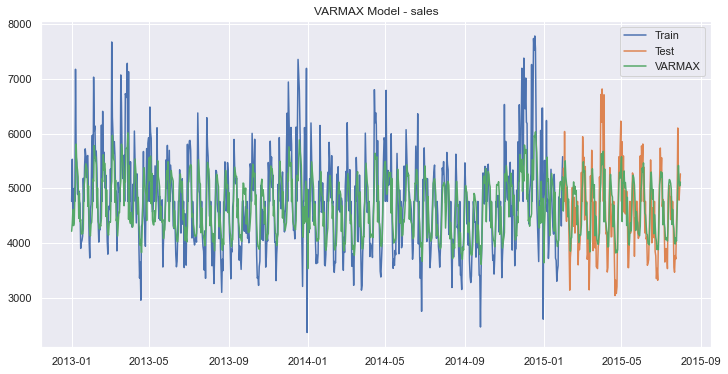

In [170]:
plt.figure(figsize=(12,6)) 
plt.plot(train['sales'], label='Train')
plt.plot(test['sales'], label='Test')
plt.plot(predictions1 ['VARMAX_forecast_Sales'], label='VARMAX')
plt.legend(loc='best')
plt.title('VARMAX Model - sales')
plt.show()

In [171]:
train_len = 750
train['customers'] = new_df['customers'][0:train_len] # first 890days as training set
test['customers'] = new_df['customers'][train_len:] # last 42 days as out-of-time test set

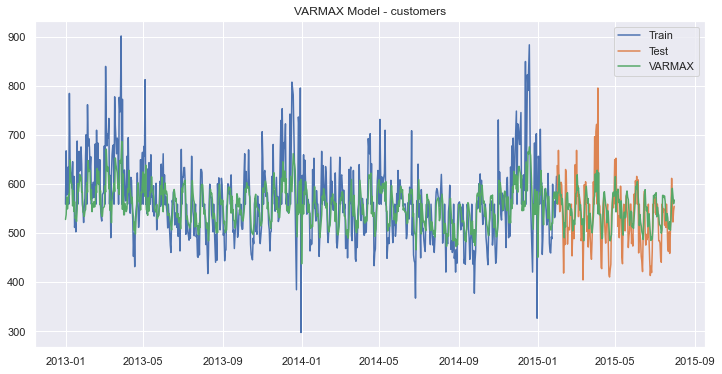

In [172]:
plt.figure(figsize=(12,6)) 
plt.plot(train['customers'], label='Train')
plt.plot(test['customers'], label='Test')
plt.plot(predictions1['VARMAX_forecast_customers'], label='VARMAX')
plt.legend(loc='best')
plt.title('VARMAX Model - customers')
plt.show()

In [173]:
# Let's calculate the rmse and MAPE
rmse = np.sqrt(mean_squared_error(test['sales'], predictions1['VARMAX_forecast_Sales'][750:])).round(2)
mape = np.round(np.mean(np.abs(test['sales']-predictions1['VARMAX_forecast_Sales'][750:])/test['sales'])*100,2)
tempResults = pd.DataFrame({'Method':['VARMAX'], 'RMSE': [rmse],'MAPE': [mape] })

In [174]:
results = pd.concat([results  , tempResults])
results = results[['Method', 'RMSE', 'MAPE']]
results

,Method,RMSE,MAPE
0,ARIMA,558.95,9.98
0,VAR,758.81,13.54
0,VARMAX,571.22,9.82


**VARMAX is the best model**

# Model-Store-3

In [175]:
#Store_3
df_new_store3=df_new[df_new['store']==3]

In [176]:
# transform datatype of the variable data to datetime
df_new_store3['date'] = pd.to_datetime( df_new_store3['date'])

In [177]:
df_new_store3.info()
#Let's check the info

<class 'pandas.core.frame.DataFrame'>
Int64Index: 942 entries, 2 to 1016097
Data columns (total 18 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   store                         942 non-null    int64         
 1   day_of_week                   942 non-null    int64         
 2   date                          942 non-null    datetime64[ns]
 3   sales                         942 non-null    int64         
 4   customers                     942 non-null    int64         
 5   open                          942 non-null    int64         
 6   promo                         942 non-null    int64         
 7   state_holiday                 942 non-null    object        
 8   school_holiday                942 non-null    int64         
 9   store_type                    942 non-null    object        
 10  assortment                    942 non-null    object        
 11  competition_distance        

In [178]:
# Check NAN values
missing_count = df_new_store3.isnull().sum() # the count of missing values
value_count = df_new_store3.isnull().count() # the count of all values

missing_percentage = round(missing_count/value_count *100, 2) # the percentage of missing values
missing_df = pd.DataFrame({'missing values count': missing_count, 'percentage': missing_percentage})
missing_df

,missing values count,percentage
store,0,0.0
day_of_week,0,0.0
date,0,0.0
sales,0,0.0
customers,0,0.0
open,0,0.0
promo,0,0.0
state_holiday,0,0.0
school_holiday,0,0.0
store_type,0,0.0


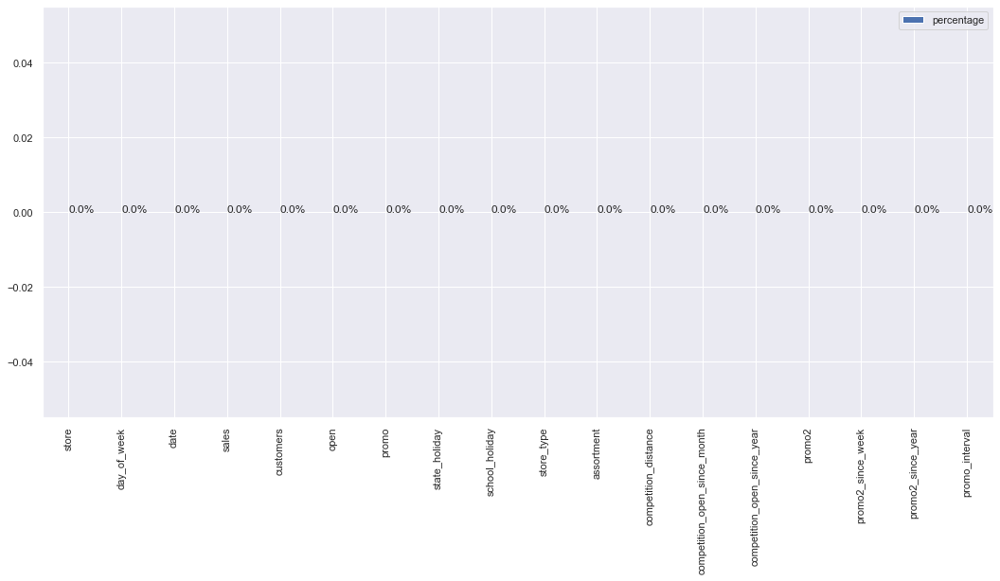

In [179]:
barchart = missing_df.plot.bar(y='percentage')
for index, percentage in enumerate( missing_percentage ):
    barchart.text( index, percentage, str(percentage)+'%')

In [180]:
df_new_store3.head()

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year,promo2,promo2_since_week,promo2_since_year,promo_interval
2,3,5,2015-07-31,8314,821,1,1,0,1,a,a,14130.0,12.0,2006.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
1117,3,4,2015-07-30,8977,823,1,1,0,1,a,a,14130.0,12.0,2006.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
2232,3,3,2015-07-29,7610,716,1,1,0,1,a,a,14130.0,12.0,2006.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
3347,3,2,2015-07-28,8864,818,1,1,0,1,a,a,14130.0,12.0,2006.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
4462,3,1,2015-07-27,8107,768,1,1,0,1,a,a,14130.0,12.0,2006.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"


In [181]:
# Let's check the info
df_new_store3.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 942 entries, 2 to 1016097
Data columns (total 18 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   store                         942 non-null    int64         
 1   day_of_week                   942 non-null    int64         
 2   date                          942 non-null    datetime64[ns]
 3   sales                         942 non-null    int64         
 4   customers                     942 non-null    int64         
 5   open                          942 non-null    int64         
 6   promo                         942 non-null    int64         
 7   state_holiday                 942 non-null    object        
 8   school_holiday                942 non-null    int64         
 9   store_type                    942 non-null    object        
 10  assortment                    942 non-null    object        
 11  competition_distance        

In [182]:
# Change datatype
df_new_store3 = df_new_store3.astype({'competition_open_since_month':'int64', 'competition_open_since_year':'int64',})
df_new_store3.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 942 entries, 2 to 1016097
Data columns (total 18 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   store                         942 non-null    int64         
 1   day_of_week                   942 non-null    int64         
 2   date                          942 non-null    datetime64[ns]
 3   sales                         942 non-null    int64         
 4   customers                     942 non-null    int64         
 5   open                          942 non-null    int64         
 6   promo                         942 non-null    int64         
 7   state_holiday                 942 non-null    object        
 8   school_holiday                942 non-null    int64         
 9   store_type                    942 non-null    object        
 10  assortment                    942 non-null    object        
 11  competition_distance        

In [183]:
# Let's copy the dataset
df_store3 = df_new_store3.copy()

In [184]:
df_store3.head()

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year,promo2,promo2_since_week,promo2_since_year,promo_interval
2,3,5,2015-07-31,8314,821,1,1,0,1,a,a,14130.0,12,2006,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
1117,3,4,2015-07-30,8977,823,1,1,0,1,a,a,14130.0,12,2006,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
2232,3,3,2015-07-29,7610,716,1,1,0,1,a,a,14130.0,12,2006,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
3347,3,2,2015-07-28,8864,818,1,1,0,1,a,a,14130.0,12,2006,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
4462,3,1,2015-07-27,8107,768,1,1,0,1,a,a,14130.0,12,2006,1,14.0,2011.0,"Jan,Apr,Jul,Oct"


**Descriptive Statistics**

In [185]:
df_store3.describe().T

,count,mean,std,min,25%,50%,75%,max
store,942.0,3.000000,0.000000,3.0,3.0,3.0,3.00,3.0
day_of_week,942.0,3.997877,1.998404,1.0,2.0,4.0,6.00,7.0
sales,942.0,5741.253715,3298.782559,0.0,4247.5,5892.0,8152.75,15689.0
customers,942.0,620.286624,323.366048,0.0,475.0,705.0,834.75,1579.0
open,942.0,0.826964,0.378479,0.0,1.0,1.0,1.00,1.0
promo,942.0,0.382166,0.486175,0.0,0.0,0.0,1.00,1.0
school_holiday,942.0,0.180467,0.384780,0.0,0.0,0.0,0.00,1.0
competition_distance,942.0,14130.000000,0.000000,14130.0,14130.0,14130.0,14130.00,14130.0
competition_open_since_month,942.0,12.000000,0.000000,12.0,12.0,12.0,12.00,12.0
competition_open_since_year,942.0,2006.000000,0.000000,2006.0,2006.0,2006.0,2006.00,2006.0


In [186]:
# separate numerical and categorical attributes
num_attributes = df_store3.select_dtypes( include = 'number')
cate_attributes = df_store3.select_dtypes( include = 'object')

**Numerical Attributes**

In [187]:
# Central Tendency - Mean, median
ct1 = pd.DataFrame( num_attributes.apply( np.mean ) ).T
ct2 = pd.DataFrame( num_attributes.apply( np.median ) ).T

# Dispersion - std, min, max, range, skew, kurtoisis
d1 = pd.DataFrame(num_attributes.apply( np.std )).T
d2 = pd.DataFrame(num_attributes.apply( min )).T
d3 = pd.DataFrame(num_attributes.apply( max )).T
d4 = pd.DataFrame(num_attributes.apply( lambda x: x.max() - x.min() )).T
d5 = pd.DataFrame(num_attributes.apply( lambda x: x.skew() )).T
d6 = pd.DataFrame(num_attributes.apply( lambda x: x.kurtosis() )).T

#concatenate
m = pd.concat( [d2, d3, d4, ct1, ct2, d1, d5, d6] ).T.reset_index()


m.columns = ['attributes', 'min', 'max', 'range', 'mean', 'median', 'std', 'skew', 'kurtosis']
m

,attributes,min,max,range,mean,median,std,skew,kurtosis
0,store,3.0,3.0,0.0,3.000000,3.0,0.000000,0.000000,0.000000
1,day_of_week,1.0,7.0,6.0,3.997877,4.0,1.997343,0.002127,-1.247185
2,sales,0.0,15689.0,15689.0,5741.253715,5892.0,3297.031148,-0.329182,-0.388584
3,customers,0.0,1579.0,1579.0,620.286624,705.0,323.194365,-0.877069,-0.140779
4,open,0.0,1.0,1.0,0.826964,1.0,0.378278,-1.731453,1.000047
5,promo,0.0,1.0,1.0,0.382166,0.0,0.485917,0.485772,-1.767783
6,school_holiday,0.0,1.0,1.0,0.180467,0.0,0.384576,1.664393,0.771837
7,competition_distance,14130.0,14130.0,0.0,14130.000000,14130.0,0.000000,0.000000,0.000000
8,competition_open_since_month,12.0,12.0,0.0,12.000000,12.0,0.000000,0.000000,0.000000
9,competition_open_since_year,2006.0,2006.0,0.0,2006.000000,2006.0,0.000000,0.000000,0.000000


**Categorical Attributes**

In [188]:
# check unique values of categorical features
cate_attributes.apply( lambda x: x.unique().shape[0])

state_holiday     5
store_type        1
assortment        1
promo_interval    1
dtype: int64

In [189]:
#Let's check the unique values
print(df_store3['state_holiday'].unique())
print(df_store3['store_type'].unique())
print(df_store3['assortment'].unique())
print(df_store3['promo_interval'].unique())

['0' 'a' 'b' 'c' 0]
['a']
['a']
['Jan,Apr,Jul,Oct']


# Exploratory data analysis(EDA)

Let’s perform EDA to gain insights into the given data.

**Univariate Analysis**

Response Variable (target)

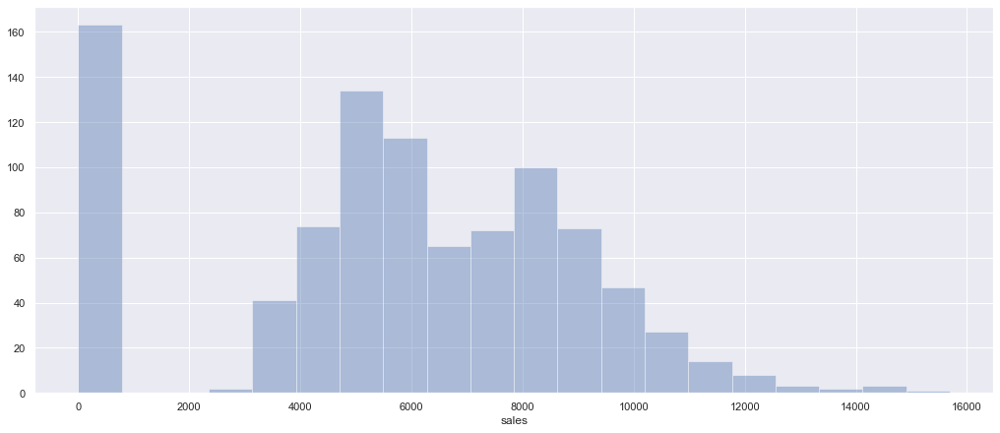

In [190]:
fig = plt.figure( figsize = (14, 6), constrained_layout=True)
sns.distplot(df_store3['sales'], kde = False);
plt.show()

**Numerical Variable**

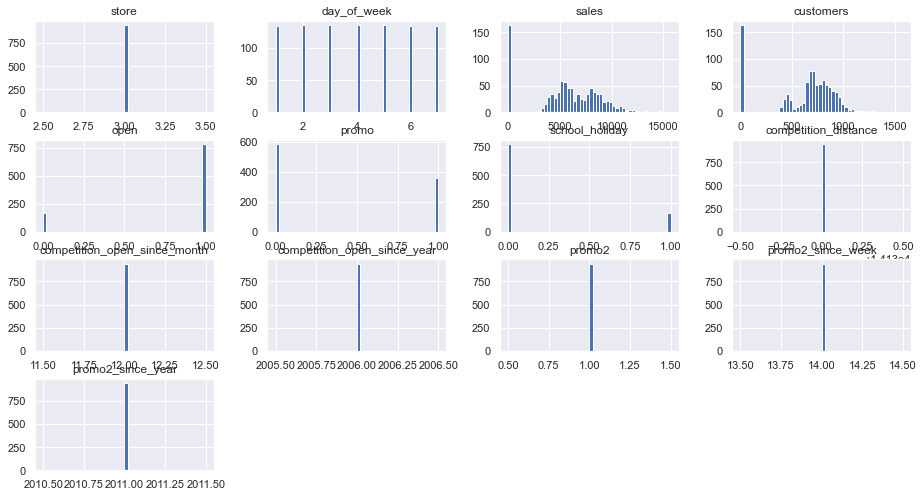

In [191]:
sns.set(rc={'figure.figsize':(15.7,8.27)})
num_attributes.hist(bins = 50);

In [192]:
df_store3['day_of_week'].value_counts()
#day of the week

5    135
4    135
3    135
2    135
7    134
6    134
1    134
Name: day_of_week, dtype: int64

In [193]:
df_store3['open'].value_counts()
# value count of store is open or not

1    779
0    163
Name: open, dtype: int64

In [194]:
df_store3['promo'].value_counts()
# value count of promo

0    582
1    360
Name: promo, dtype: int64

In [195]:
df_store3['state_holiday'].value_counts()
# value count of state_holiday

0    784
0    129
a     19
b      6
c      4
Name: state_holiday, dtype: int64

In [196]:
df_store3['school_holiday'].value_counts()
# value count of state_holiday

0    772
1    170
Name: school_holiday, dtype: int64

In [197]:
df_store3['store_type'].value_counts()
# value count of state_holiday

a    942
Name: store_type, dtype: int64

In [198]:
df_store3['competition_distance'].value_counts()
# value count of competition_distance

14130.0    942
Name: competition_distance, dtype: int64

In [199]:
df_store3['competition_open_since_month'].value_counts()
# value count of competition_open_since_month

12    942
Name: competition_open_since_month, dtype: int64

In [200]:
df_store3['competition_open_since_year'].value_counts()
# value count of competition_open_since_year

2006    942
Name: competition_open_since_year, dtype: int64

In [201]:
df_store3['promo2'].value_counts()
# value count of competition_open_since_year

1    942
Name: promo2, dtype: int64

In [202]:
df_store3['promo2_since_week'].value_counts()
 #value count of promo2_since_week

14.0    942
Name: promo2_since_week, dtype: int64

In [203]:
df_store3['promo2_since_year'].value_counts()
 #value count of promo2_since_year

2011.0    942
Name: promo2_since_year, dtype: int64

**Categorical Variable**

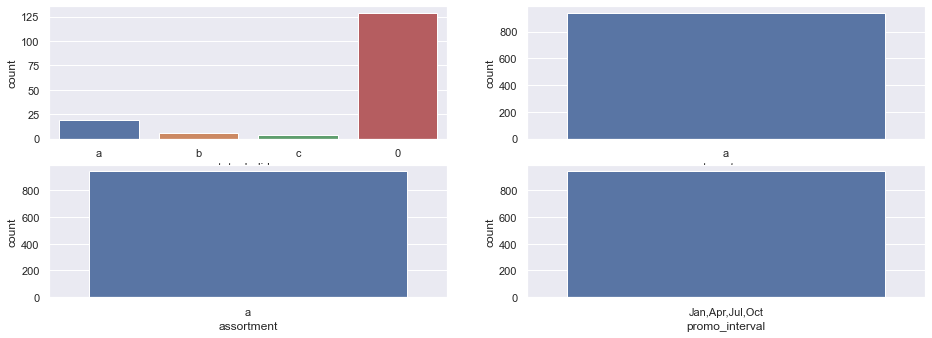

In [204]:
# state_holiday
plt.subplot(3, 2, 1)
a = df_store3[df_store3['state_holiday'] != '0']
sns.countplot(data = a, x = a['state_holiday'])

# store_type
plt.subplot(3, 2, 2)
sns.countplot(data = df_store3, x = df_store3['store_type'])

# assortment
plt.subplot(3, 2, 3)
sns.countplot(data = df_store3, x = df_store3['assortment'])

# promo_interval
plt.subplot(3, 2, 4)
sns.countplot(data = df_store3, x = df_store3['promo_interval'])
plt.show()

In [205]:
df_store3[df_store3['sales']==0]

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year,promo2,promo2_since_week,promo2_since_year,promo_interval
5577,3,7,2015-07-26,0,0,0,0,0,0,a,a,14130.0,12,2006,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
13382,3,7,2015-07-19,0,0,0,0,0,0,a,a,14130.0,12,2006,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
21187,3,7,2015-07-12,0,0,0,0,0,0,a,a,14130.0,12,2006,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
28992,3,7,2015-07-05,0,0,0,0,0,0,a,a,14130.0,12,2006,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
36797,3,7,2015-06-28,0,0,0,0,0,0,a,a,14130.0,12,2006,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
987107,3,7,2013-01-27,0,0,0,0,0,0,a,a,14130.0,12,2006,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
994912,3,7,2013-01-20,0,0,0,0,0,0,a,a,14130.0,12,2006,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
1002717,3,7,2013-01-13,0,0,0,0,0,0,a,a,14130.0,12,2006,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
1010522,3,7,2013-01-06,0,0,0,0,0,0,a,a,14130.0,12,2006,1,14.0,2011.0,"Jan,Apr,Jul,Oct"


In [206]:
df_store3.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 942 entries, 2 to 1016097
Data columns (total 18 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   store                         942 non-null    int64         
 1   day_of_week                   942 non-null    int64         
 2   date                          942 non-null    datetime64[ns]
 3   sales                         942 non-null    int64         
 4   customers                     942 non-null    int64         
 5   open                          942 non-null    int64         
 6   promo                         942 non-null    int64         
 7   state_holiday                 942 non-null    object        
 8   school_holiday                942 non-null    int64         
 9   store_type                    942 non-null    object        
 10  assortment                    942 non-null    object        
 11  competition_distance        


-    Sale  and customer colomns has zero values which has to be imputed

-    Store is open on 80% of days

-    80% are regular days

-    All the rows of column-store type belongs to 'a'

-    All the rows of column-assortment belongs to 'a'

-    All the rows of columns-competition_distance to 14130

-    All the competition is opened since month-12

-    All the competition is opened since 2006

-    All the rows of promo2 belogs to 1


**Bivariate Analysis**

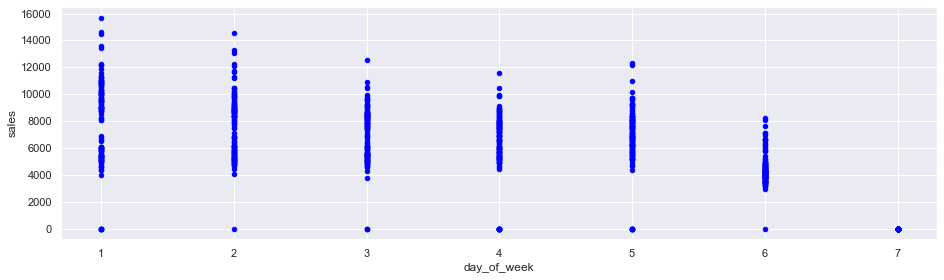

In [207]:
# lets draw a scatter plot between  Sales and day_of_week
sns.set(rc={'figure.figsize':(15.7,4.27)})
df_store3[['sales', 'day_of_week']].plot.scatter(x = 'day_of_week',y='sales',c='blue')
plt.show()

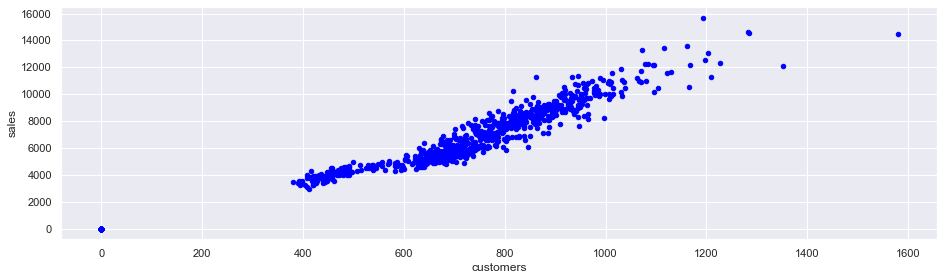

In [208]:
#Let's draw a scatter plot between Sales and Customers
df_store3[['sales', 'customers']].plot.scatter(x = 'customers',y='sales',c='blue')
plt.show()

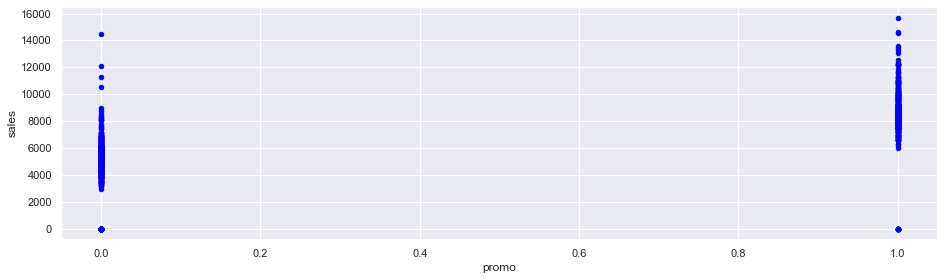

In [209]:
#Let's now draw a scatter plot between Sales and promo
df_store3[['sales', 'promo']].plot.scatter(x = 'promo',y='sales',c='blue')
plt.show()

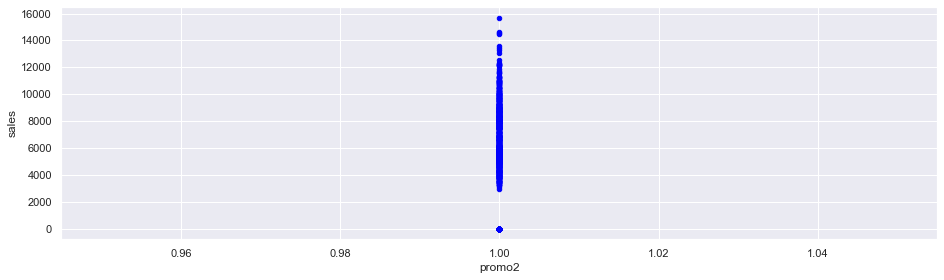

In [210]:
#Let's now draw a scatter plot between Sales and promo
df_store3[['sales', 'promo2']].plot.scatter(x = 'promo2',y='sales',c='blue')
plt.show()

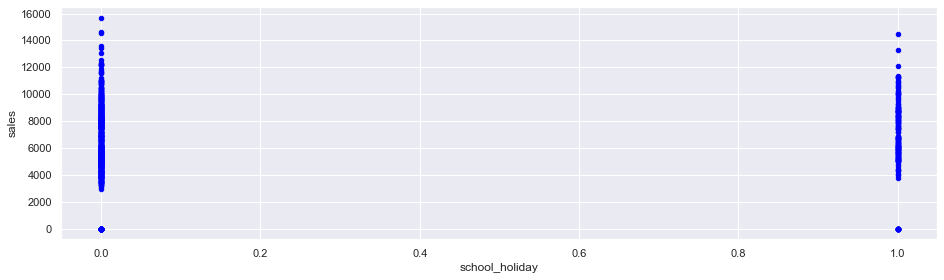

In [211]:
#lets now draw a scatter plot between  Sales and school_holiday
df_store3[['sales', 'school_holiday']].plot.scatter(x = 'school_holiday',y='sales',c='blue')
plt.show()

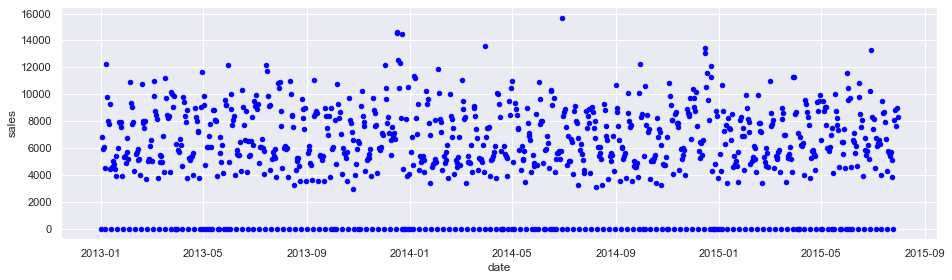

In [212]:
#lets now draw a scatter plot between Sales and date
df_store3[['sales', 'date']].plot.scatter(x = 'date',y='sales',c='blue')
plt.show()

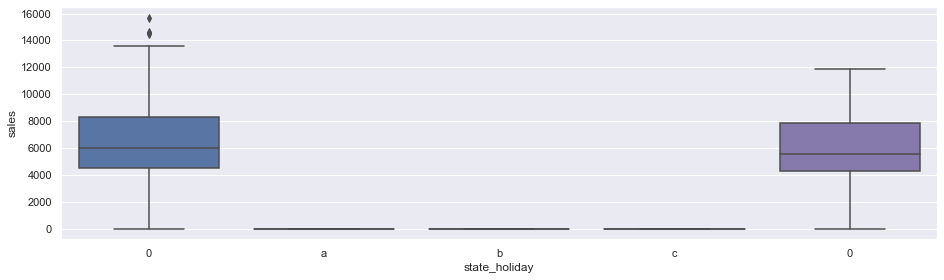

In [213]:
#Let's draw the boxplot between sales and state_holiday
sns.set(rc={'figure.figsize':(15.7,4.27)})
# create grouped boxplot 
sns.boxplot(x = df_store3['state_holiday'],
            y = df_store3['sales'])
plt.show()

**Multivariate Analysis**

**Numerical Attributes**

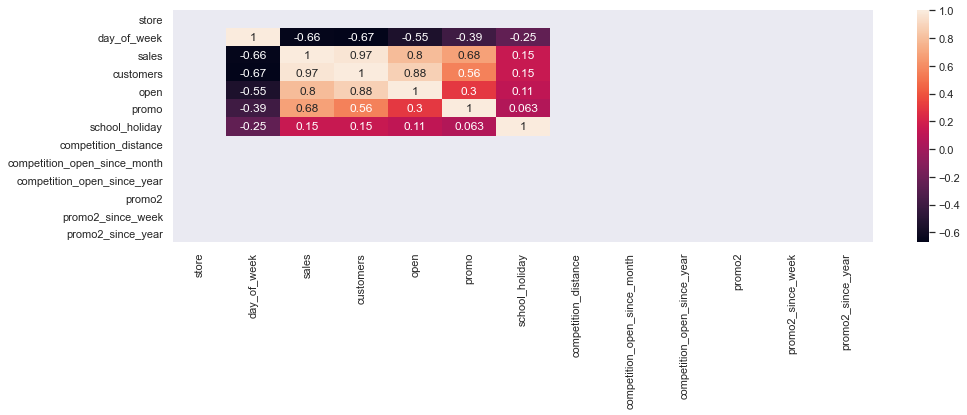

In [214]:
correlation = (num_attributes.corr( method = 'pearson' ))
sns.heatmap( correlation, annot = True );

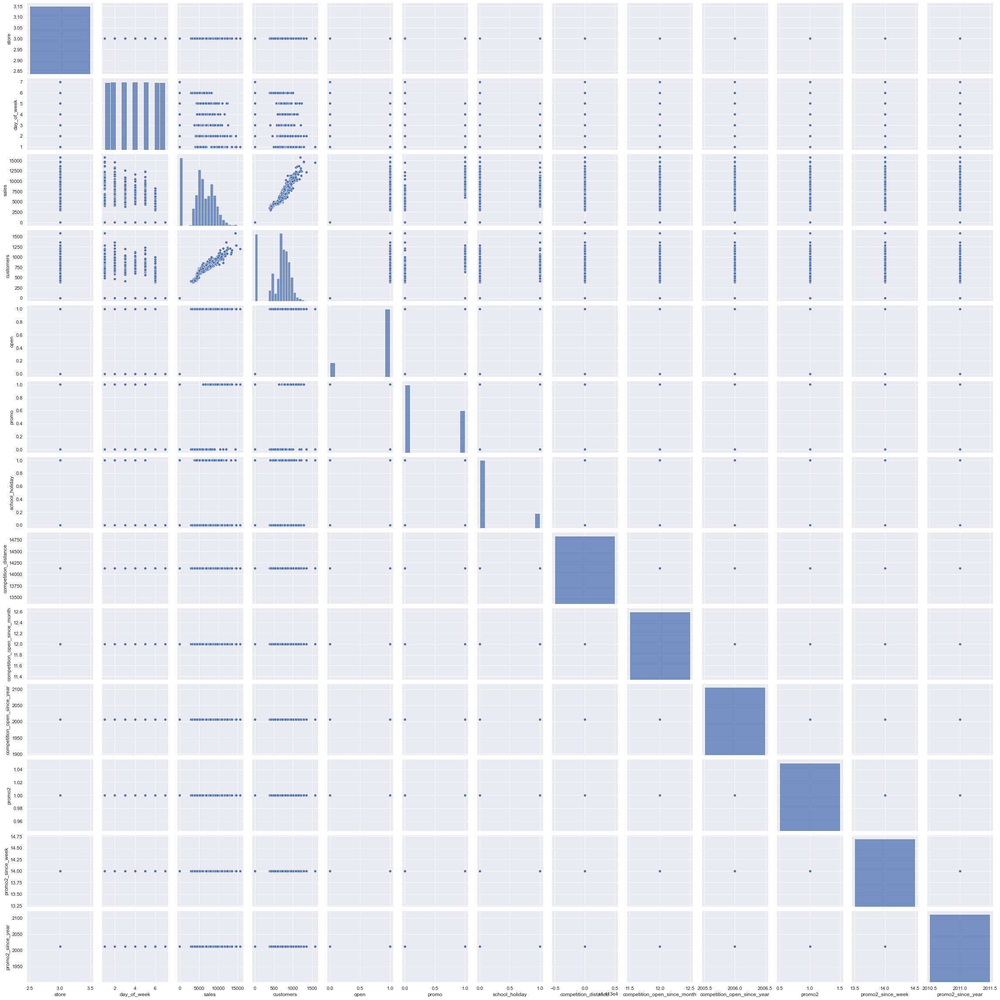

In [215]:
# pairplot with hue sales
sns.pairplot(df_store3)
# to show
plt.show()

**Some insights from EDA**

-   Sales & Customers are directly proportional to each other

-   store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year,Promo2SinceWeek,Promo2SinceYear,PromoInterval are uncessary columns

    
-    Day1,Day2 and Day5 have higher sales than other days
    
-    promo is correlated to sales

-    Promo2 doesn't have any effect on sales becuase it's value is equal to 1
    
-    There is no sale on a = public holiday, b = Easter holiday, c = Christmas
    
-    There is some effect of school holiday on sales

In [216]:
# We can drop store_type,assortment,competition_distance,competition_open_since_month,promo2_since_week,promo2_since_year,promo_interval
#competition_open_since_year & promo2
df_store3_new=df_store3.drop(['store_type', 'assortment','competition_distance','competition_open_since_month','competition_open_since_year','promo2_since_week','promo2_since_year','promo_interval'], axis = 1)

In [217]:
df_store3_new.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 942 entries, 2 to 1016097
Data columns (total 10 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   store           942 non-null    int64         
 1   day_of_week     942 non-null    int64         
 2   date            942 non-null    datetime64[ns]
 3   sales           942 non-null    int64         
 4   customers       942 non-null    int64         
 5   open            942 non-null    int64         
 6   promo           942 non-null    int64         
 7   state_holiday   942 non-null    object        
 8   school_holiday  942 non-null    int64         
 9   promo2          942 non-null    int64         
dtypes: datetime64[ns](1), int64(8), object(1)
memory usage: 121.0+ KB


In [218]:
df_store3_new.head()

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,promo2
2,3,5,2015-07-31,8314,821,1,1,0,1,1
1117,3,4,2015-07-30,8977,823,1,1,0,1,1
2232,3,3,2015-07-29,7610,716,1,1,0,1,1
3347,3,2,2015-07-28,8864,818,1,1,0,1,1
4462,3,1,2015-07-27,8107,768,1,1,0,1,1


# Model Building

**ARIMA model**

In [219]:
df_store3_new

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,promo2
2,3,5,2015-07-31,8314,821,1,1,0,1,1
1117,3,4,2015-07-30,8977,823,1,1,0,1,1
2232,3,3,2015-07-29,7610,716,1,1,0,1,1
3347,3,2,2015-07-28,8864,818,1,1,0,1,1
4462,3,1,2015-07-27,8107,768,1,1,0,1,1
...,...,...,...,...,...,...,...,...,...,...
1011637,3,6,2013-01-05,4523,525,1,0,0,0,1
1012752,3,5,2013-01-04,6069,690,1,0,0,1,1
1013867,3,4,2013-01-03,5902,721,1,0,0,1,1
1014982,3,3,2013-01-02,6823,805,1,0,0,1,1


In [220]:
#rearrange the index
df_store3_new=df_store3_new[::-1].reset_index()
df_store3_new

,index,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,promo2
0,1016097,3,2,2013-01-01,0,0,0,0,a,1,1
1,1014982,3,3,2013-01-02,6823,805,1,0,0,1,1
2,1013867,3,4,2013-01-03,5902,721,1,0,0,1,1
3,1012752,3,5,2013-01-04,6069,690,1,0,0,1,1
4,1011637,3,6,2013-01-05,4523,525,1,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...
937,4462,3,1,2015-07-27,8107,768,1,1,0,1,1
938,3347,3,2,2015-07-28,8864,818,1,1,0,1,1
939,2232,3,3,2015-07-29,7610,716,1,1,0,1,1
940,1117,3,4,2015-07-30,8977,823,1,1,0,1,1


In [221]:
df_store3_new=df_store3_new.drop(['index'], axis = 1)
df_store3_new.head()
#Let drop the index column

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,promo2
0,3,2,2013-01-01,0,0,0,0,a,1,1
1,3,3,2013-01-02,6823,805,1,0,0,1,1
2,3,4,2013-01-03,5902,721,1,0,0,1,1
3,3,5,2013-01-04,6069,690,1,0,0,1,1
4,3,6,2013-01-05,4523,525,1,0,0,0,1


In [222]:
df_store3_new.info()
#No missing value

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 942 entries, 0 to 941
Data columns (total 10 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   store           942 non-null    int64         
 1   day_of_week     942 non-null    int64         
 2   date            942 non-null    datetime64[ns]
 3   sales           942 non-null    int64         
 4   customers       942 non-null    int64         
 5   open            942 non-null    int64         
 6   promo           942 non-null    int64         
 7   state_holiday   942 non-null    object        
 8   school_holiday  942 non-null    int64         
 9   promo2          942 non-null    int64         
dtypes: datetime64[ns](1), int64(8), object(1)
memory usage: 73.7+ KB


In [223]:
indexed_df_store3_new = df_store3_new.set_index(['date'])
indexed_df_store3_new.head(5)
#Let set the date as index column

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2
date,,,,,,,,,
2013-01-01,3,2,0,0,0,0,a,1,1
2013-01-02,3,3,6823,805,1,0,0,1,1
2013-01-03,3,4,5902,721,1,0,0,1,1
2013-01-04,3,5,6069,690,1,0,0,1,1
2013-01-05,3,6,4523,525,1,0,0,0,1


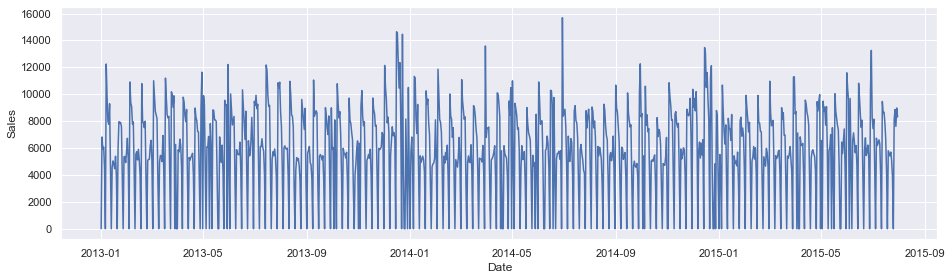

In [224]:
## plot graph
plt.xlabel('Date')
plt.ylabel('Sales')
plt.plot(indexed_df_store3_new['sales'])
plt.show()

In [225]:
#Let impute the zero values
(indexed_df_store3_new['sales']==0).sum()
# There are 163 zero value in sale column

163

In [226]:
#Lat's fill the zero with NAN value
indexed_df_store3_new['sales']=indexed_df_store3_new['sales'].replace(0, np.nan)

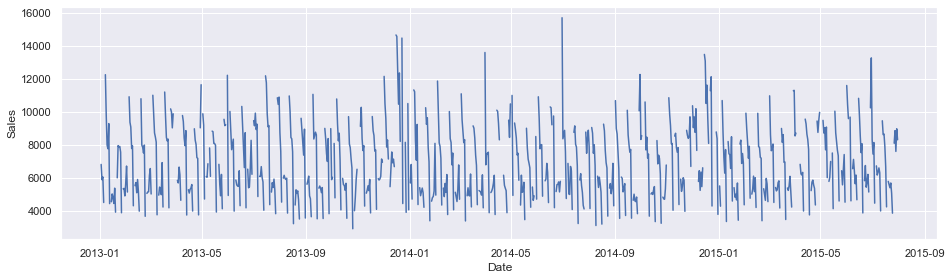

In [227]:
##plot graph
plt.xlabel('Date')
plt.ylabel('Sales')
plt.plot(indexed_df_store3_new['sales'])
plt.show()

In [228]:
#KNN imputer for filling NAN values
imputer = KNNImputer(n_neighbors=2)

In [229]:
indexed_df_store3_new['sales'] = imputer.fit_transform(np.array(indexed_df_store3_new['sales']).reshape(-1, 1))
indexed_df_store3_new['sales']

date
2013-01-01    6942.568678
2013-01-02    6823.000000
2013-01-03    5902.000000
2013-01-04    6069.000000
2013-01-05    4523.000000
                 ...     
2015-07-27    8107.000000
2015-07-28    8864.000000
2015-07-29    7610.000000
2015-07-30    8977.000000
2015-07-31    8314.000000
Name: sales, Length: 942, dtype: float64

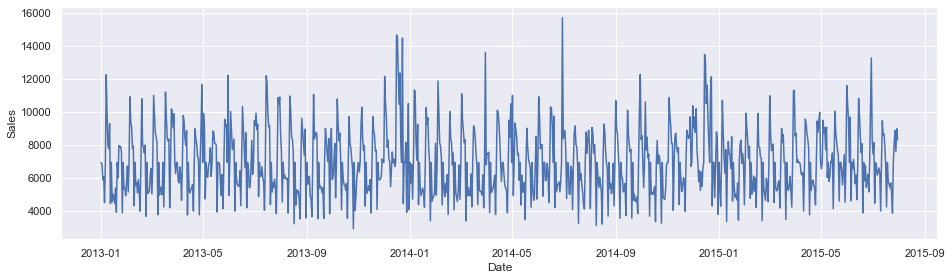

In [230]:
## plot graph
plt.xlabel('Date')
plt.ylabel('Sales')
plt.plot(indexed_df_store3_new['sales'])
plt.show()

In [231]:
(indexed_df_store3_new['sales']==0).sum()
# no missing value

0

**Outlier detection**

Box plot and interquartile range

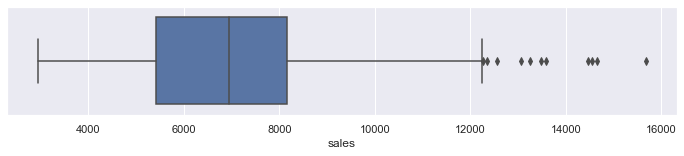

In [232]:
import seaborn as sns
fig = plt.subplots(figsize=(12, 2))
ax = sns.boxplot(x=indexed_df_store3_new['sales'],whis=1.5)
#Let treat the outliers

**Histogram**


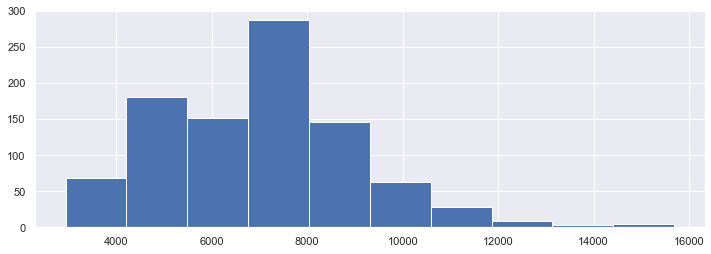

In [233]:
fig = indexed_df_store3_new['sales'].hist(figsize = (12,4))

In [234]:
percentile01 = indexed_df_store3_new['sales'].quantile(0.01)
percentile99 = indexed_df_store3_new['sales'].quantile(0.99)

In [235]:
upper_limit = percentile99
lower_limit = percentile01

In [236]:
upper_limit

12314.280000000002

In [237]:
lower_limit

3417.23

In [238]:
#let's remove the outlier
new_df = indexed_df_store3_new[indexed_df_store3_new['sales'] < upper_limit]
new_df.shape

(932, 9)

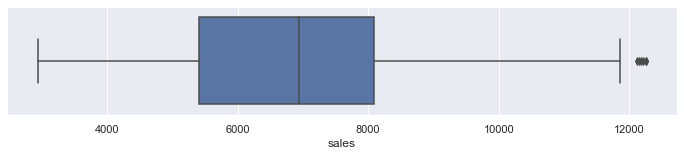

In [239]:
import seaborn as sns
fig = plt.subplots(figsize=(12, 2))
ax = sns.boxplot(x=new_df['sales'],whis=1.5)

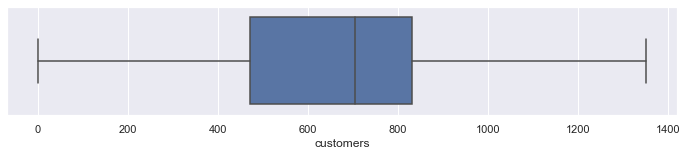

In [240]:
import seaborn as sns
fig = plt.subplots(figsize=(12, 2))
ax = sns.boxplot(x=new_df['customers'],whis=1.5)

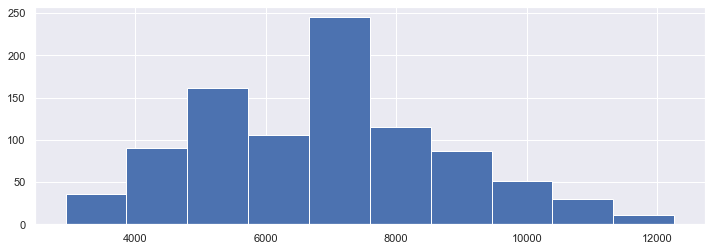

In [241]:
fig = new_df['sales'].hist(figsize = (12,4))

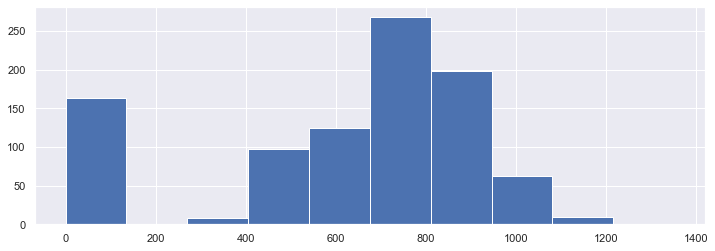

In [242]:
fig = new_df['customers'].hist(figsize = (12,4))

**ADF Stationary test**

In [243]:
def test_stationarity(timeseries):
    
    #Determine rolling statistics
    movingAverage = timeseries.rolling(window=12).mean()
    movingSTD = timeseries.rolling(window=12).std()
    
    #Plot rolling statistics
    orig = plt.plot(timeseries, color='blue', label='Original')
    mean = plt.plot(movingAverage, color='red', label='Rolling Mean')
    std = plt.plot(movingSTD, color='black', label='Rolling Std')
    plt.legend(loc='best')
    plt.title('Rolling Mean & Standard Deviation')
    plt.show(block=False)
    
    #Perform Dickey–Fuller test:
    print('Results of Dickey Fuller Test:')
    dftest = adfuller(indexed_df_store3_new['sales'], autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    for key,value in dftest[4].items():
        dfoutput['Critical Value (%s)'%key] = value
    print(dfoutput)

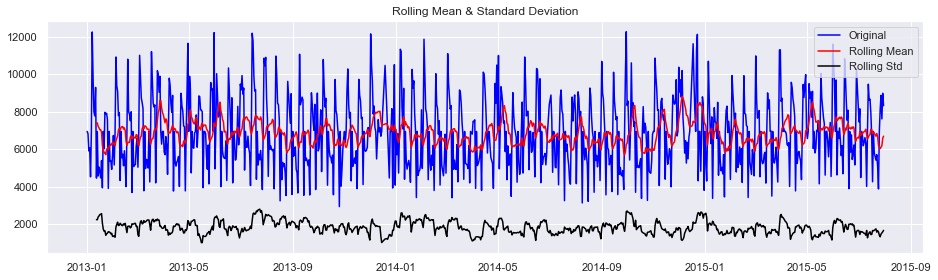

Results of Dickey Fuller Test:
Test Statistic                -5.935634e+00
p-value                        2.324597e-07
#Lags Used                     2.200000e+01
Number of Observations Used    9.190000e+02
Critical Value (1%)           -3.437486e+00
Critical Value (5%)           -2.864690e+00
Critical Value (10%)          -2.568447e+00
dtype: float64


In [244]:
test_stationarity(new_df['sales'])

- Null: Time Series is not stationary
- Alternate: Time Series is Stationary

**The p-value is less than 0.05 so The series is stationary**

In [245]:
from statsmodels.tsa.stattools import kpss
kpss_test = kpss(new_df['sales'])

print('KPSS Statistic: %f' % kpss_test[0])
print('Critical Values @ 0.05: %.2f' % kpss_test[3]['5%'])
print('p-value: %f' % kpss_test[1])

KPSS Statistic: 0.080625
Critical Values @ 0.05: 0.46
p-value: 0.100000


- Null: Time Series is not stationary
- Alternate: Time Series is Stationary
    
**The p-value is greater than 0.05 so The series is stationary**

# Let's take the log of sales to Standardize the sales values

In [246]:
new_df.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2
date,,,,,,,,,
2013-01-01,3,2,6942.568678,0,0,0,a,1,1
2013-01-02,3,3,6823.000000,805,1,0,0,1,1
2013-01-03,3,4,5902.000000,721,1,0,0,1,1
2013-01-04,3,5,6069.000000,690,1,0,0,1,1
2013-01-05,3,6,4523.000000,525,1,0,0,0,1


In [247]:
#Log Transformation
new_df['sales_log'] = np.log(new_df['sales'])
new_df.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log
date,,,,,,,,,,
2013-01-01,3,2,6942.568678,0,0,0,a,1,1,8.845427
2013-01-02,3,3,6823.000000,805,1,0,0,1,1,8.828055
2013-01-03,3,4,5902.000000,721,1,0,0,1,1,8.683047
2013-01-04,3,5,6069.000000,690,1,0,0,1,1,8.710949
2013-01-05,3,6,4523.000000,525,1,0,0,0,1,8.416931


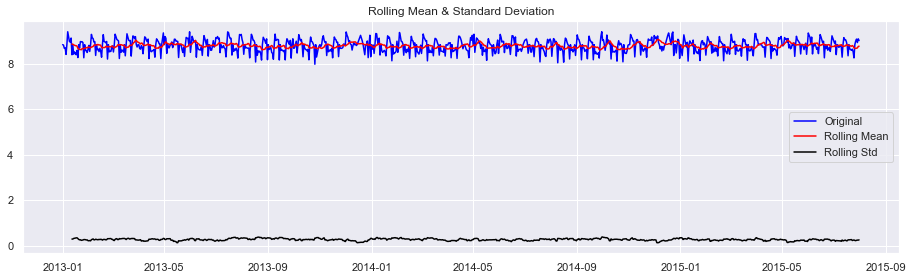

Results of Dickey Fuller Test:
Test Statistic                -5.935634e+00
p-value                        2.324597e-07
#Lags Used                     2.200000e+01
Number of Observations Used    9.190000e+02
Critical Value (1%)           -3.437486e+00
Critical Value (5%)           -2.864690e+00
Critical Value (10%)          -2.568447e+00
dtype: float64


In [248]:
test_stationarity(new_df['sales_log'])

In [249]:
from statsmodels.tsa.stattools import kpss
kpss_test = kpss(new_df['sales_log'])

print('KPSS Statistic: %f' % kpss_test[0])
print('Critical Values @ 0.05: %.2f' % kpss_test[3]['5%'])
print('p-value: %f' % kpss_test[1])

KPSS Statistic: 0.090802
Critical Values @ 0.05: 0.46
p-value: 0.100000


**Log transformation has made mean & variance constant**

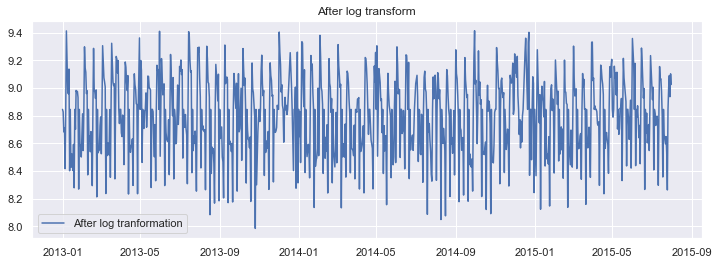

In [250]:
#After Log Transformation
plt.figure(figsize=(12,4))
plt.plot(new_df['sales_log'], label='After log tranformation')
plt.legend(loc='best')
plt.title('After log transform')
plt.show()

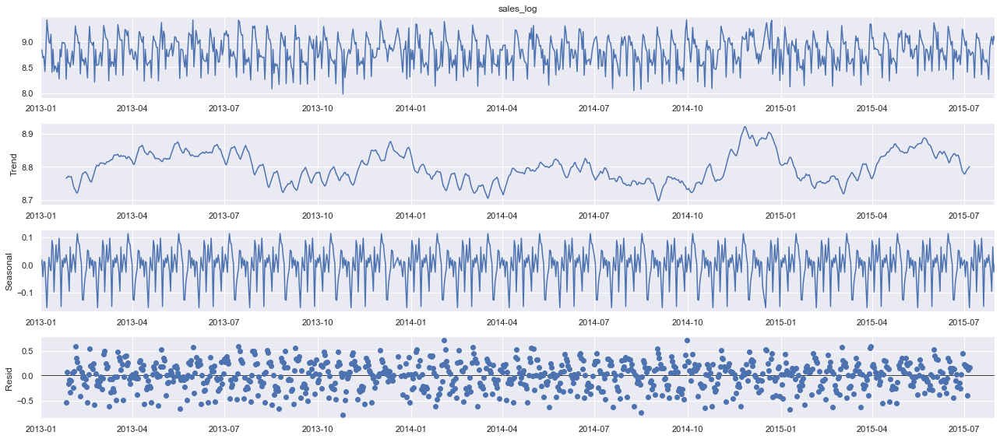

In [251]:
from matplotlib.pyplot import rcParams
rcParams['figure.figsize'] = 18,8
decomposition = sm.tsa.seasonal_decompose(new_df['sales_log'], model = "additive",period=50)
fig = decomposition.plot()

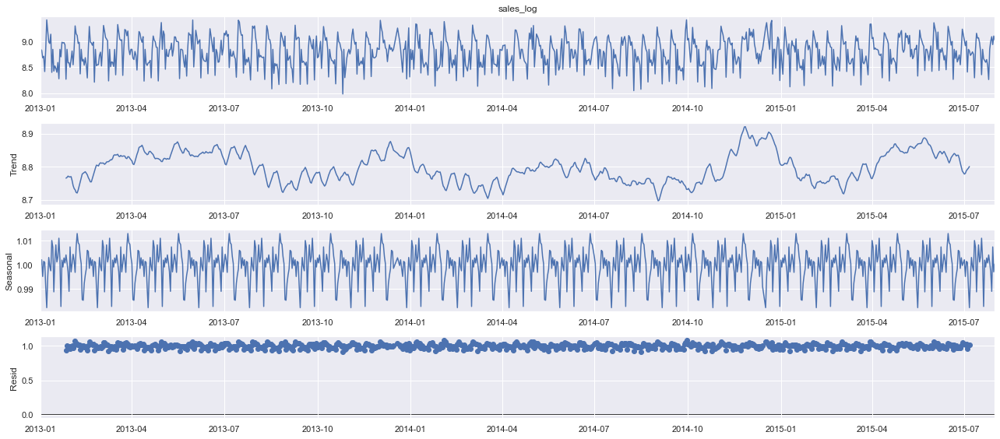

In [252]:
from matplotlib.pyplot import rcParams
rcParams['figure.figsize'] = 18,8
decomposition = sm.tsa.seasonal_decompose(new_df['sales_log'], model = "multiplicative",period=50)
fig = decomposition.plot()

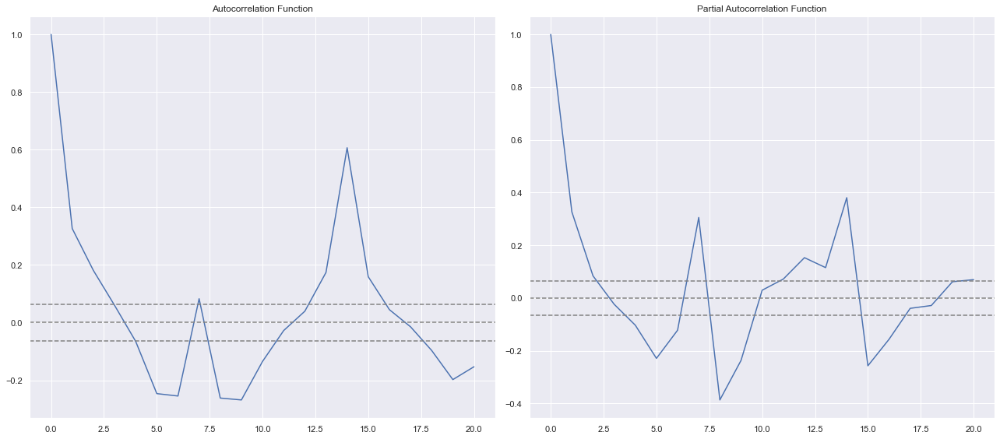

In [253]:
#ACF & PACF plots

lag_acf = acf(new_df['sales_log'], nlags=20) # MA 
lag_pacf = pacf(new_df['sales_log'], nlags=20, method='ols')  # AR 

#Plot ACF:
plt.subplot(121)
plt.plot(lag_acf)
plt.axhline(y=0, linestyle='--', color='gray')
plt.axhline(y=-1.96/np.sqrt(len(new_df['sales_log'])), linestyle='--', color='gray')
plt.axhline(y=1.96/np.sqrt(len(new_df['sales_log'])), linestyle='--', color='gray')
plt.title('Autocorrelation Function')            

#Plot PACF
plt.subplot(122)
plt.plot(lag_pacf)
plt.axhline(y=0, linestyle='--', color='gray')
plt.axhline(y=-1.96/np.sqrt(len(new_df['sales_log'])), linestyle='--', color='gray')
plt.axhline(y=1.96/np.sqrt(len(new_df['sales_log'])), linestyle='--', color='gray')
plt.title('Partial Autocorrelation Function')
            
plt.tight_layout() 

From the ACF graph, we see that curve touches y=0.0 line at x=4. Thus, from theory, Q = 4 From the PACF graph, we see that curve touches y=0.0 line at x=3. Thus, from theory, P = 3

**Build and evaluate time series forecast**

Split time series data into training and test set


In [254]:
train_len = 750
train = new_df['sales'][0:train_len] # first 750days as training set
test = new_df['sales'][train_len:] # last 182 days as out-of-time test set

In [255]:
print(train.shape)
print(test.shape)

(750,)
(182,)


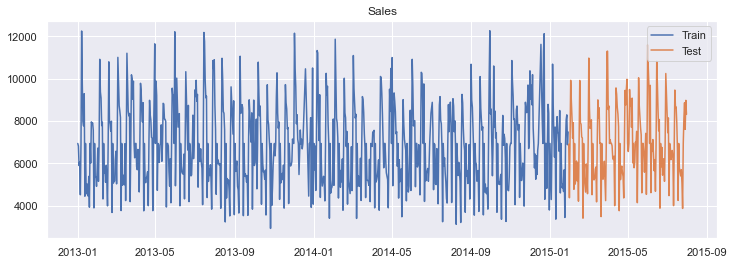

In [256]:
plt.figure(figsize=(12,4))
plt.plot(train, label='Train')
plt.plot(test, label='Test')
plt.legend(loc='best')
plt.title('Sales')
plt.show()

In [257]:
model = ARIMA(new_df['sales_log'], order=(3, 0, 4))
model_fit = model.fit()
print(model_fit.params)

const              8.796791
ar.L1.sales_log    0.349763
ar.L2.sales_log    0.015565
ar.L3.sales_log   -0.670448
ma.L1.sales_log   -0.107128
ma.L2.sales_log    0.101547
ma.L3.sales_log    0.786016
ma.L4.sales_log    0.041574
dtype: float64


In [258]:
new_df['ar_forecast_Log'] = model_fit.predict(new_df.index.min(), new_df.index.max())
new_df['arima_forecast'] = np.exp(new_df['ar_forecast_Log'])
new_df['arima_forecast']

date
2013-01-01    6612.987317
2013-01-02    6717.449950
2013-01-03    6692.139306
2013-01-04    6378.091686
2013-01-05    6328.607872
                 ...     
2015-07-27    6916.820318
2015-07-28    8011.036766
2015-07-29    8366.109651
2015-07-30    7101.661732
2015-07-31    6379.617670
Name: arima_forecast, Length: 932, dtype: float64

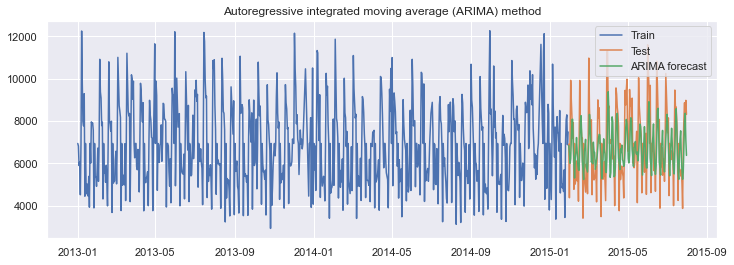

In [259]:
plt.figure(figsize=(12,4))
plt.plot(train, label='Train')
plt.plot(test, label='Test')
plt.plot(new_df['arima_forecast'][test.index.min():], label='ARIMA forecast')
plt.legend(loc='best')
plt.title('Autoregressive integrated moving average (ARIMA) method')
plt.show()

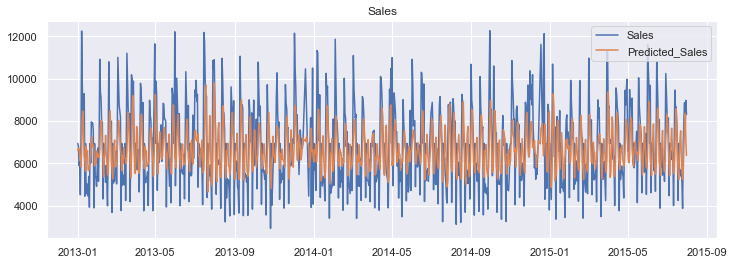

In [260]:
# plot the arima forecasting & Original series
plt.figure(figsize=(12,4))
plt.plot(new_df['sales'], label='Sales')
plt.plot(new_df['arima_forecast'], label='Predicted_Sales')
plt.legend(loc='best')
plt.title('Sales')
plt.show()

In [261]:
from sklearn.metrics import mean_squared_error
rmse = np.sqrt(mean_squared_error(test, new_df['arima_forecast'][test.index.min():])).round(2)
mape = np.round(np.mean(np.abs(test-new_df['arima_forecast'][test.index.min():])/test)*100,2)
Results = pd.DataFrame({'Method':['ARIMA'], 'RMSE': [rmse],'MAPE': [mape] })
Results 

,Method,RMSE,MAPE
0,ARIMA,1519.86,18.4


**VAR model**

In [262]:
#Load the dataset
new_df.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast
date,,,,,,,,,,,,
2013-01-01,3,2,6942.568678,0,0,0,a,1,1,8.845427,8.796791,6612.987317
2013-01-02,3,3,6823.000000,805,1,0,0,1,1,8.828055,8.812464,6717.449950
2013-01-03,3,4,5902.000000,721,1,0,0,1,1,8.683047,8.808689,6692.139306
2013-01-04,3,5,6069.000000,690,1,0,0,1,1,8.710949,8.760624,6378.091686
2013-01-05,3,6,4523.000000,525,1,0,0,0,1,8.416931,8.752836,6328.607872


**Split the dataset to training & testing**

In [263]:
#split the dataset
nobs = 182
train, test = new_df[0:-nobs], new_df[-nobs:]

# Check size
print(train.shape)
print(test.shape)  

(750, 12)
(182, 12)


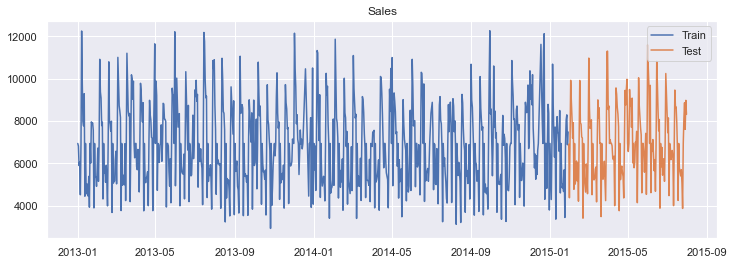

In [264]:
plt.figure(figsize=(12,4))
plt.plot(train['sales'], label='Train')
plt.plot(test['sales'], label='Test')
plt.legend(loc='best')
plt.title('Sales')
plt.show()

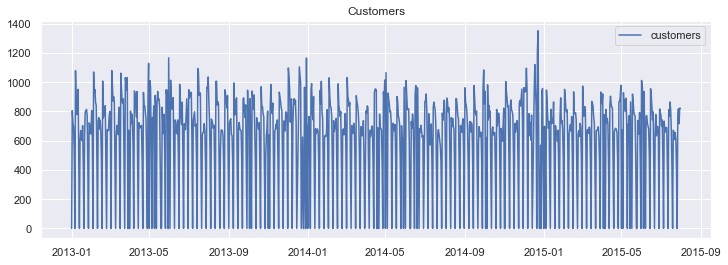

In [265]:
#plot the arima forecasting & Original series
plt.figure(figsize=(12,4))
plt.plot(new_df['customers'],label='customers')
plt.legend(loc='best')
plt.title('Customers')
plt.show()

In [266]:
(new_df['customers']==0).sum()

163

In [267]:
#impute the NAN values
new_df['customers']=new_df['customers'].replace(0, np.nan)

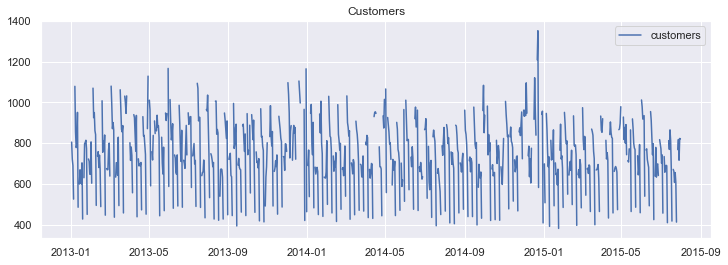

In [268]:
#plot the arima forecasting & Original series
plt.figure(figsize=(12,4))
plt.plot(new_df['customers'],label='customers')
plt.legend(loc='best')
plt.title('Customers')
plt.show()

In [269]:
#KNN imputer for filling NAN values
imputer = KNNImputer(n_neighbors=2)

In [270]:
new_df['customers'] = imputer.fit_transform(np.array(new_df['customers']).reshape(-1, 1))
new_df['customers']

date
2013-01-01    743.816645
2013-01-02    805.000000
2013-01-03    721.000000
2013-01-04    690.000000
2013-01-05    525.000000
                 ...    
2015-07-27    768.000000
2015-07-28    818.000000
2015-07-29    716.000000
2015-07-30    823.000000
2015-07-31    821.000000
Name: customers, Length: 932, dtype: float64

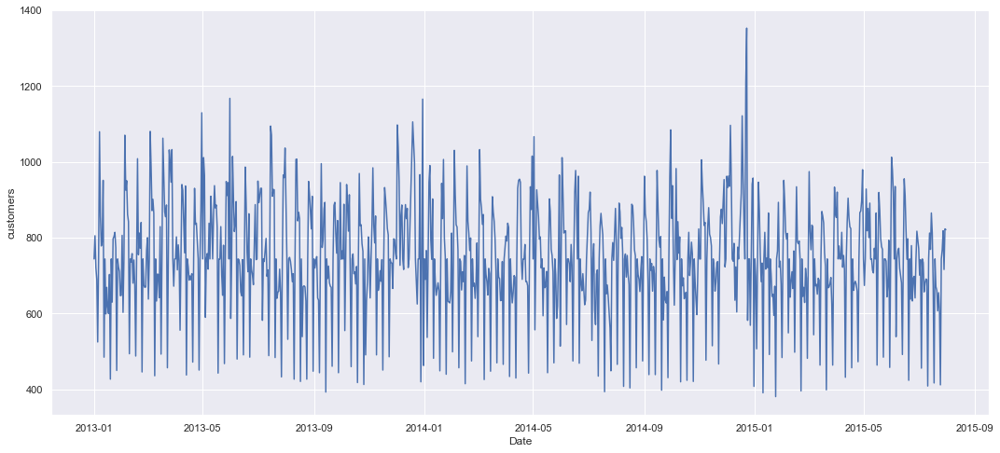

In [271]:
## plot graph
plt.xlabel('Date')
plt.ylabel('customers')
plt.plot(new_df['customers'])
plt.show()

In [272]:
new_df.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast
date,,,,,,,,,,,,
2013-01-01,3,2,6942.568678,743.816645,0,0,a,1,1,8.845427,8.796791,6612.987317
2013-01-02,3,3,6823.000000,805.000000,1,0,0,1,1,8.828055,8.812464,6717.449950
2013-01-03,3,4,5902.000000,721.000000,1,0,0,1,1,8.683047,8.808689,6692.139306
2013-01-04,3,5,6069.000000,690.000000,1,0,0,1,1,8.710949,8.760624,6378.091686
2013-01-05,3,6,4523.000000,525.000000,1,0,0,0,1,8.416931,8.752836,6328.607872


**ADF Test**

In [273]:
def test_stationarity(timeseries):
    
    #Determine rolling statistics
    movingAverage = timeseries.rolling(window=12).mean()
    movingSTD = timeseries.rolling(window=12).std()
    
    #Plot rolling statistics
    orig = plt.plot(timeseries, color='blue', label='Original')
    mean = plt.plot(movingAverage, color='red', label='Rolling Mean')
    std = plt.plot(movingSTD, color='black', label='Rolling Std')
    plt.legend(loc='best')
    plt.title('Rolling Mean & Standard Deviation')
    plt.show(block=False)
    
    #Perform Dickey–Fuller test:
    print('Results of Dickey Fuller Test:')
    dftest = adfuller(new_df['customers'], autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    for key,value in dftest[4].items():
        dfoutput['Critical Value (%s)'%key] = value
    print(dfoutput)

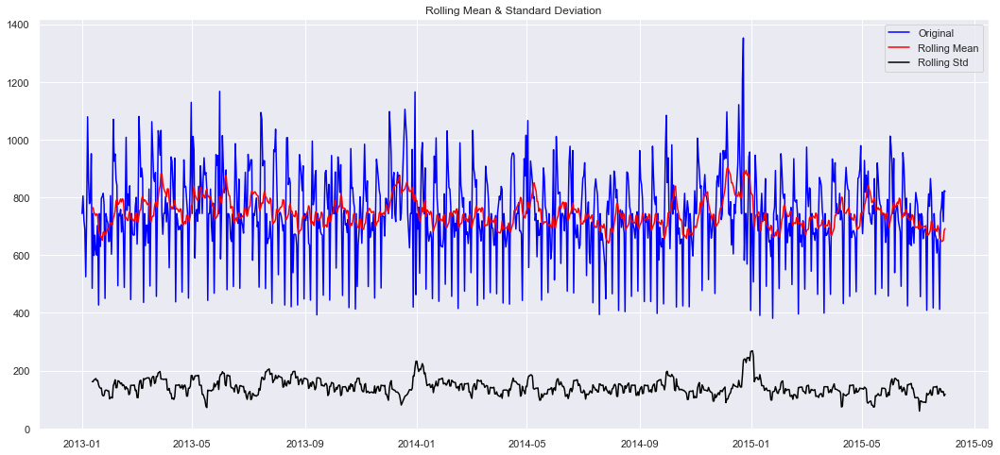

Results of Dickey Fuller Test:
Test Statistic                  -5.406938
p-value                          0.000003
#Lags Used                      21.000000
Number of Observations Used    910.000000
Critical Value (1%)             -3.437556
Critical Value (5%)             -2.864721
Critical Value (10%)            -2.568464
dtype: float64


In [274]:
test_stationarity(new_df['customers'])

- Null: Time Series is not stationary
- Alternate: Time Series is Stationary

**The p-value is less than 0.05 so The series is stationary**

In [275]:
from statsmodels.tsa.stattools import kpss
kpss_test = kpss(new_df['customers'])

print('KPSS Statistic: %f' % kpss_test[0])
print('Critical Values @ 0.05: %.2f' % kpss_test[3]['5%'])
print('p-value: %f' % kpss_test[1])

KPSS Statistic: 0.344871
Critical Values @ 0.05: 0.46
p-value: 0.100000


- Null: Time Series is not stationary
- Alternate: Time Series is Stationary

**The p-value is greater than 0.05 so The series is stationary**

In [276]:
#Log Transformation
new_df['customers_log'] = np.log(new_df['customers'])
new_df

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast,customers_log
date,,,,,,,,,,,,,
2013-01-01,3,2,6942.568678,743.816645,0,0,a,1,1,8.845427,8.796791,6612.987317,6.611795
2013-01-02,3,3,6823.000000,805.000000,1,0,0,1,1,8.828055,8.812464,6717.449950,6.690842
2013-01-03,3,4,5902.000000,721.000000,1,0,0,1,1,8.683047,8.808689,6692.139306,6.580639
2013-01-04,3,5,6069.000000,690.000000,1,0,0,1,1,8.710949,8.760624,6378.091686,6.536692
2013-01-05,3,6,4523.000000,525.000000,1,0,0,0,1,8.416931,8.752836,6328.607872,6.263398
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2015-07-27,3,1,8107.000000,768.000000,1,1,0,1,1,9.000483,8.841711,6916.820318,6.643790
2015-07-28,3,2,8864.000000,818.000000,1,1,0,1,1,9.089753,8.988575,8011.036766,6.706862
2015-07-29,3,3,7610.000000,716.000000,1,1,0,1,1,8.937218,9.031944,8366.109651,6.573680


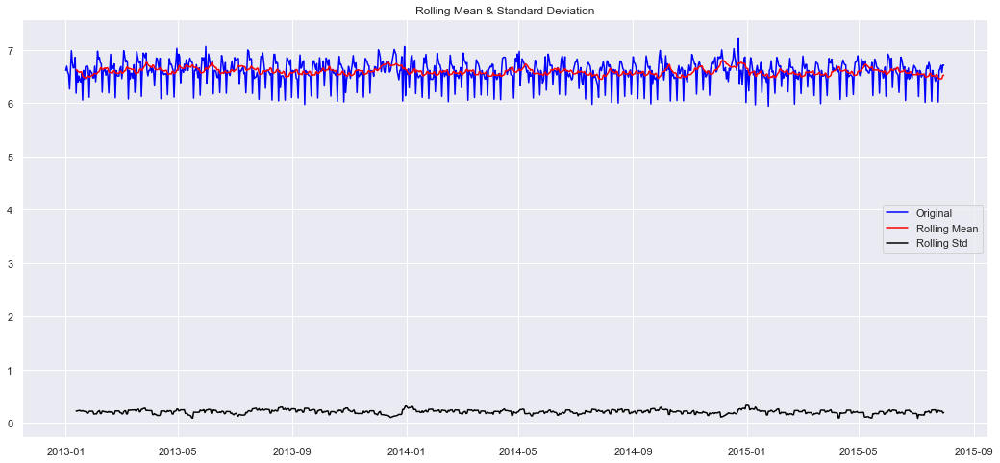

Results of Dickey Fuller Test:
Test Statistic                  -5.406938
p-value                          0.000003
#Lags Used                      21.000000
Number of Observations Used    910.000000
Critical Value (1%)             -3.437556
Critical Value (5%)             -2.864721
Critical Value (10%)            -2.568464
dtype: float64


In [277]:
test_stationarity(new_df['customers_log'])

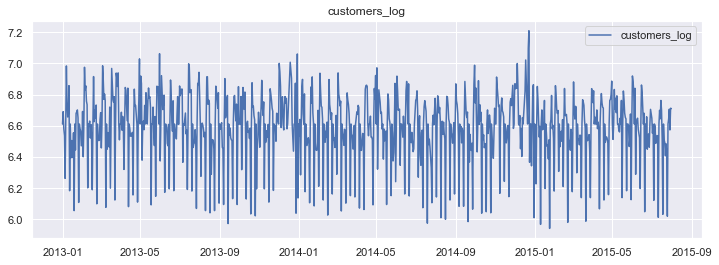

In [278]:
#plot the arima Log series
plt.figure(figsize=(12,4))
plt.plot(new_df['customers_log'],label='customers_log')
plt.legend(loc='best')
plt.title('customers_log')
plt.show()

In [279]:
#Let's check the info
new_df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 932 entries, 2013-01-01 to 2015-07-31
Data columns (total 13 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   store            932 non-null    int64  
 1   day_of_week      932 non-null    int64  
 2   sales            932 non-null    float64
 3   customers        932 non-null    float64
 4   open             932 non-null    int64  
 5   promo            932 non-null    int64  
 6   state_holiday    932 non-null    object 
 7   school_holiday   932 non-null    int64  
 8   promo2           932 non-null    int64  
 9   sales_log        932 non-null    float64
 10  ar_forecast_Log  932 non-null    float64
 11  arima_forecast   932 non-null    float64
 12  customers_log    932 non-null    float64
dtypes: float64(6), int64(6), object(1)
memory usage: 141.9+ KB


**Log transformation has made mean & variance constant**

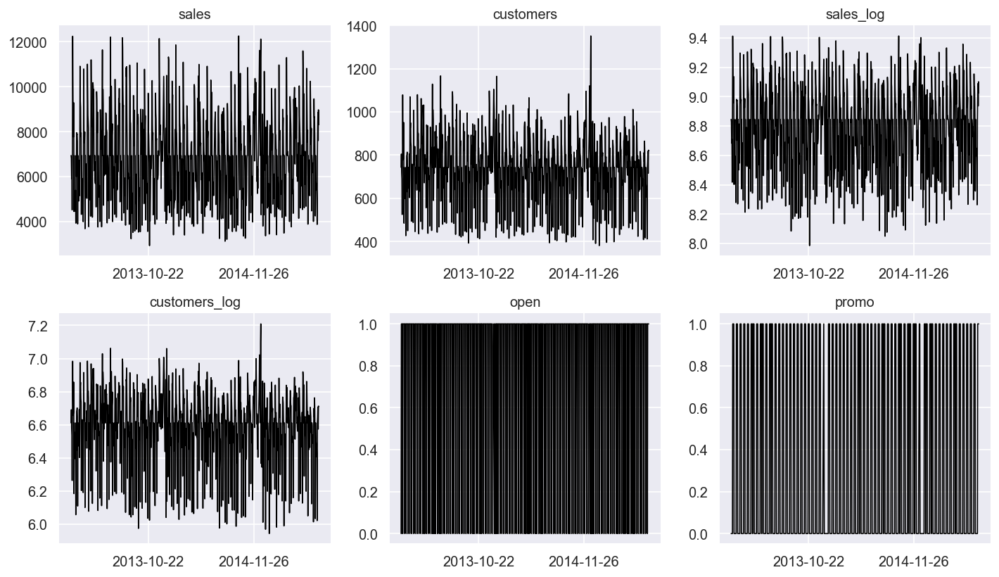

In [280]:
# Plot
ls=['sales','customers','sales_log','customers_log','open','promo','state_holiday','promo2','school_holiday']
df=new_df[ls]
fig, axes = plt.subplots(nrows=2, ncols=3, dpi=120, figsize=(12,7))
for i, ax in enumerate(axes.flatten()):
        ax.plot(df[df.columns[i]], color='black', linewidth=1)
        ax.xaxis.set_major_locator(plt.MaxNLocator(3))
        # Decorations
        ax.set_title(df.columns[i])
        ax.xaxis.set_ticks_position('none')
        ax.yaxis.set_ticks_position('none')
        ax.spines["top"].set_alpha(0)
        ax.tick_params(labelsize=12)

plt.tight_layout();

In [281]:
new_df.columns

Index(['store', 'day_of_week', 'sales', 'customers', 'open', 'promo',
       'state_holiday', 'school_holiday', 'promo2', 'sales_log',
       'ar_forecast_Log', 'arima_forecast', 'customers_log'],
      dtype='object')

In [282]:
new_df1=new_df[['sales_log', 'customers_log']]
new_df1

,sales_log,customers_log
date,,
2013-01-01,8.845427,6.611795
2013-01-02,8.828055,6.690842
2013-01-03,8.683047,6.580639
2013-01-04,8.710949,6.536692
2013-01-05,8.416931,6.263398
...,...,...
2015-07-27,9.000483,6.643790
2015-07-28,9.089753,6.706862
2015-07-29,8.937218,6.573680


In [283]:
#Let's create a model
model = VAR(new_df1)
for i in [1,2,3,4,5]:
    result = model.fit(i)
    print('Lag Order =', i)
    print('AIC : ', result.aic)
    print('BIC : ', result.bic)
    print('FPE : ', result.fpe)
    print('HQIC: ', result.hqic, '\n')

Lag Order = 1
AIC :  -8.32516970434931
BIC :  -8.294001545741724
FPE :  0.00024233980598850106
HQIC:  -8.313282606268764 

Lag Order = 2
AIC :  -8.343798026043075
BIC :  -8.291806793933963
FPE :  0.00023786724861577763
HQIC:  -8.323968273874659 

Lag Order = 3
AIC :  -8.372356702944204
BIC :  -8.299506840357127
FPE :  0.0002311702438507642
HQIC:  -8.344569910887888 

Lag Order = 4
AIC :  -8.438561372896219
BIC :  -8.344817222906832
FPE :  0.00021636145272857174
HQIC:  -8.402803113678413 

Lag Order = 5
AIC :  -8.531438065755092
BIC :  -8.416763871103043
FPE :  0.00019717166006528582
HQIC:  -8.487693870465367 



In [284]:
x = model.select_order(maxlags=5)
x.summary()

,AIC,BIC,FPE,HQIC
0,-7.826,-7.816,0.0003992,-7.822
1,-8.322,-8.291,0.0002432,-8.310
2,-8.340,-8.288,0.0002387,-8.321
3,-8.371,-8.298,0.0002315,-8.343
4,-8.439,-8.345,0.0002164,-8.403
5,-8.531*,-8.417*,0.0001972*,-8.488*


In [285]:
#Let's fit the model
model_fitted = model.fit()
model_fitted.summary()

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Mon, 17, Jan, 2022
Time:                     15:53:04
--------------------------------------------------------------------
No. of Equations:         2.00000    BIC:                   -8.29400
Nobs:                     931.000    HQIC:                  -8.31328
Log likelihood:           1239.30    FPE:                0.000242340
AIC:                     -8.32517    Det(Omega_mle):     0.000240786
--------------------------------------------------------------------
Results for equation sales_log
                      coefficient       std. error           t-stat            prob
-----------------------------------------------------------------------------------
const                    6.347709         0.253876           25.003           0.000
L1.sales_log             1.366464         0.085893           15.909           0.000
L1.customers_log        -1.452291         0.

In [286]:
# Get the lag order
lag_order = model_fitted.k_ar
print(lag_order)  #> 4

1


In [287]:
# Input data for forecasting
forecast_input = new_df1.values[-lag_order:]
forecast_input

array([[9.02569612, 6.71052311]])

In [288]:
# Forecast
fc = model_fitted.forecast(y=forecast_input, steps=182)
df_forecast = pd.DataFrame(fc, index=new_df.index[-182:], columns=new_df1.columns + '_2d')
df_forecast

,sales_log_2d,customers_log_2d
date,,
2015-01-30,8.935365,6.663511
2015-01-31,8.880206,6.634493
2015-02-01,8.846976,6.616989
2015-02-02,8.826988,6.606459
2015-02-03,8.814969,6.600127
...,...,...
2015-07-27,8.796838,6.590575
2015-07-28,8.796838,6.590575
2015-07-29,8.796838,6.590575


In [289]:
df_forecast['VAR_forecast_Sales'] = np.exp(df_forecast['sales_log_2d'])
df_forecast['VAR_forecast_customers'] = np.exp(df_forecast['customers_log_2d'])
df_forecast

,sales_log_2d,customers_log_2d,VAR_forecast_Sales,VAR_forecast_customers
date,,,,
2015-01-30,8.935365,6.663511,7595.906086,783.295913
2015-01-31,8.880206,6.634493,7188.271521,760.893231
2015-02-01,8.846976,6.616989,6953.326963,747.690431
2015-02-02,8.826988,6.606459,6815.728112,739.858649
2015-02-03,8.814969,6.600127,6734.296562,735.188415
...,...,...,...,...
2015-07-27,8.796838,6.590575,6613.300845,728.199458
2015-07-28,8.796838,6.590575,6613.300845,728.199458
2015-07-29,8.796838,6.590575,6613.300845,728.199458


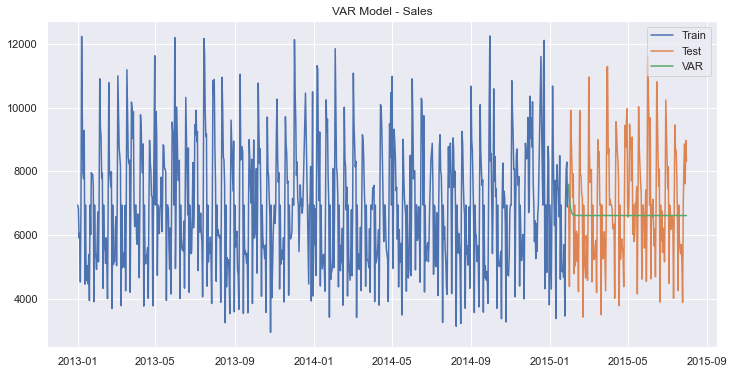

In [290]:
plt.figure(figsize=(12,6)) 
plt.plot(train['sales'], label='Train')
plt.plot(test['sales'], label='Test')
plt.plot(df_forecast['VAR_forecast_Sales'], label='VAR')
plt.legend(loc='best')
plt.title('VAR Model - Sales')
plt.show()

In [291]:
train_len = 750
train1 = new_df[0:train_len] # first 750days as training set
test1 = new_df[train_len:] # last 182 days as out-of-time test set

In [292]:
train1

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast,customers_log
date,,,,,,,,,,,,,
2013-01-01,3,2,6942.568678,743.816645,0,0,a,1,1,8.845427,8.796791,6612.987317,6.611795
2013-01-02,3,3,6823.000000,805.000000,1,0,0,1,1,8.828055,8.812464,6717.449950,6.690842
2013-01-03,3,4,5902.000000,721.000000,1,0,0,1,1,8.683047,8.808689,6692.139306,6.580639
2013-01-04,3,5,6069.000000,690.000000,1,0,0,1,1,8.710949,8.760624,6378.091686,6.536692
2013-01-05,3,6,4523.000000,525.000000,1,0,0,0,1,8.416931,8.752836,6328.607872,6.263398
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2015-01-25,3,7,6942.568678,743.816645,0,0,0,0,1,8.845427,8.767606,6422.775277,6.611795
2015-01-26,3,1,8055.000000,765.000000,1,1,0,0,1,8.994048,8.869292,7110.245653,6.639876
2015-01-27,3,2,8292.000000,893.000000,1,1,0,0,1,9.023046,8.829087,6830.046331,6.794587


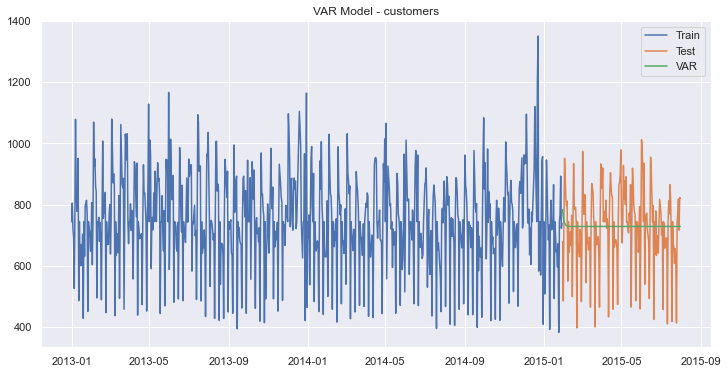

In [293]:
plt.figure(figsize=(12,6)) 
plt.plot(train1['customers'], label='Train')
plt.plot(test1['customers'], label='Test')
plt.plot(df_forecast['VAR_forecast_customers'], label='VAR')
plt.legend(loc='best')
plt.title('VAR Model - customers')
plt.show()

In [294]:
# Let's calculate the rmse and MAPE
rmse = np.sqrt(mean_squared_error(test['sales'], df_forecast['VAR_forecast_Sales'])).round(2)
mape = np.round(np.mean(np.abs(test['sales']-df_forecast['VAR_forecast_Sales'])/test['sales'])*100,2)
tempResults = pd.DataFrame({'Method':['VAR'], 'RMSE': [rmse],'MAPE': [mape] })

In [295]:
tempResults

,Method,RMSE,MAPE
0,VAR,1756.6,21.02


In [296]:
results = pd.concat([Results , tempResults])
results = results[['Method', 'RMSE', 'MAPE']]
results

,Method,RMSE,MAPE
0,ARIMA,1519.86,18.40
0,VAR,1756.60,21.02


**Johansen-Impulse**

In [297]:
joh_model1 = coint_johansen(new_df[['sales','customers']],-1,1)

In [298]:
joh_model1

In [299]:
joh_model1.lr2

array([157.55130451,   5.01440149])

In [300]:
joh_model1.lr1

array([162.56570601,   5.01440149])

In [301]:
new_df[['sales','customers']].shape

(932, 2)

In [302]:
def joh_output(res):
    output = pd.DataFrame([res.lr2,res.lr1],
                          index=['max_eig_stat',"trace_stat"])
    print(output.T,'\n')
    print("Critical values(90%, 95%, 99%) of max_eig_stat\n",res.cvm,'\n')
    print("Critical values(90%, 95%, 99%) of trace_stat\n",res.cvt,'\n')

In [303]:
joh_output(joh_model1)

   max_eig_stat  trace_stat
0    157.551305  162.565706
1      5.014401    5.014401 

Critical values(90%, 95%, 99%) of max_eig_stat
 [[ 9.4748 11.2246 15.0923]
 [ 2.9762  4.1296  6.9406]] 

Critical values(90%, 95%, 99%) of trace_stat
 [[10.4741 12.3212 16.364 ]
 [ 2.9762  4.1296  6.9406]] 



In [304]:
from statsmodels.tsa.vector_ar.vecm import select_coint_rank

In [305]:
rank=select_coint_rank(new_df[['sales','customers']],-1,1)
print(rank.rank)

2


**Rank is two**

In [306]:
from statsmodels.tsa.stattools import coint

In [307]:
coint(new_df['sales'],new_df['customers'])#null hypothesis-There is not coint

(-4.446660412686737,
 0.0014965352567214445,
 array([-3.90824227, -3.34270081, -3.04900867]))

0.0014965352567214445<.05

We can reject the null hypothesis

**Sales and customers are cointegration to each other**

**VARMAX MODEL**

In [308]:
#create dymmy variables
new_df=pd.get_dummies(new_df)
new_df.head()

,store,day_of_week,sales,customers,open,promo,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast,customers_log,state_holiday_0,state_holiday_0,state_holiday_a,state_holiday_b,state_holiday_c
date,,,,,,,,,,,,,,,,,
2013-01-01,3,2,6942.568678,743.816645,0,0,1,1,8.845427,8.796791,6612.987317,6.611795,0,0,1,0,0
2013-01-02,3,3,6823.000000,805.000000,1,0,1,1,8.828055,8.812464,6717.449950,6.690842,0,1,0,0,0
2013-01-03,3,4,5902.000000,721.000000,1,0,1,1,8.683047,8.808689,6692.139306,6.580639,0,1,0,0,0
2013-01-04,3,5,6069.000000,690.000000,1,0,1,1,8.710949,8.760624,6378.091686,6.536692,0,1,0,0,0
2013-01-05,3,6,4523.000000,525.000000,1,0,0,1,8.416931,8.752836,6328.607872,6.263398,0,1,0,0,0


In [309]:
# training of model
exog = new_df[['open','promo','school_holiday','promo2','state_holiday_0','state_holiday_a','state_holiday_b','state_holiday_c']]
mod = sm.tsa.VARMAX(new_df[['sales_log', 'customers_log']], order=(1,1), trend='n', exog=exog)
res = mod.fit(maxiter=1000, disp=False)
print(res.summary())

                                 Statespace Model Results                                 
Dep. Variable:     ['sales_log', 'customers_log']   No. Observations:                  932
Model:                                VARMAX(1,1)   Log Likelihood                1681.963
Date:                            Mon, 17 Jan 2022   AIC                          -3305.925
Time:                                    15:59:19   BIC                          -3165.643
Sample:                                         0   HQIC                         -3252.426
                                            - 932                                         
Covariance Type:                              opg                                         
Ljung-Box (L1) (Q):             4.98, 0.19   Jarque-Bera (JB):         43.38, 26.47
Prob(Q):                        0.03, 0.66   Prob(JB):                   0.00, 0.00
Heteroskedasticity (H):         1.10, 1.24   Skew:                     -0.01, -0.36
Prob(H) (two-sided):

In [310]:
train_len = 750
train = new_df[0:train_len] # first 750days as training set
test = new_df[train_len:] 

start_index = test.index.min()
end_index = test.index.max()

In [311]:
print(start_index)
print(end_index)

2015-01-30 00:00:00
2015-07-31 00:00:00


In [312]:
test.head()

,store,day_of_week,sales,customers,open,promo,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast,customers_log,state_holiday_0,state_holiday_0,state_holiday_a,state_holiday_b,state_holiday_c
date,,,,,,,,,,,,,,,,,
2015-01-30,3,5,6911.000000,678.000000,1,1,0,1,8.840870,8.830685,6840.969472,6.519147,0,1,0,0,0
2015-01-31,3,6,4382.000000,484.000000,1,0,0,1,8.385261,8.776113,6477.646524,6.182085,0,1,0,0,0
2015-02-01,3,7,6942.568678,743.816645,0,0,0,1,8.845427,8.701087,6009.440053,6.611795,0,1,0,0,0
2015-02-02,3,1,9922.000000,951.000000,1,1,0,1,9.202510,8.735418,6219.331051,6.857514,0,1,0,0,0
2015-02-03,3,2,8950.000000,895.000000,1,1,0,1,9.099409,8.873189,7138.008890,6.796824,0,1,0,0,0


In [313]:
predictions = mod.fit().predict(start=start_index, end=end_index, exog=test[['open','promo','school_holiday','promo2','state_holiday_0','state_holiday_a','state_holiday_b','state_holiday_c']])

In [314]:
predictions

,sales_log,customers_log
date,,
2015-01-30,9.025164,6.720068
2015-01-31,8.629805,6.458239
2015-02-01,8.857687,6.611057
2015-02-02,8.991001,6.711418
2015-02-03,9.080953,6.762351
...,...,...
2015-07-27,9.056682,6.768625
2015-07-28,9.113662,6.786741
2015-07-29,9.138525,6.802992


In [315]:
predictions['VARMAX_forecast_Sales'] = np.exp(predictions['sales_log'])
predictions['VARMAX_forecast_customers'] = np.exp(predictions['customers_log'])
predictions

,sales_log,customers_log,VARMAX_forecast_Sales,VARMAX_forecast_customers
date,,,,
2015-01-30,9.025164,6.720068,8309.574734,828.874127
2015-01-31,8.629805,6.458239,5595.986573,637.936705
2015-02-01,8.857687,6.611057,7028.205178,743.267956
2015-02-02,8.991001,6.711418,8030.494297,821.734802
2015-02-03,9.080953,6.762351,8786.337110,864.672965
...,...,...,...,...
2015-07-27,9.056682,6.768625,8575.651827,870.114944
2015-07-28,9.113662,6.786741,9078.480806,886.021712
2015-07-29,9.138525,6.802992,9307.031455,900.537402


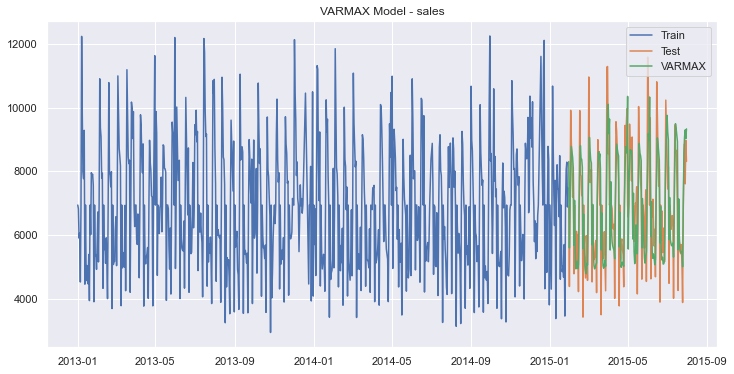

In [316]:
plt.figure(figsize=(12,6)) 
plt.plot(train['sales'], label='Train')
plt.plot(test['sales'], label='Test')
plt.plot(predictions['VARMAX_forecast_Sales'], label='VARMAX')
plt.legend(loc='best')
plt.title('VARMAX Model - sales')
plt.show()

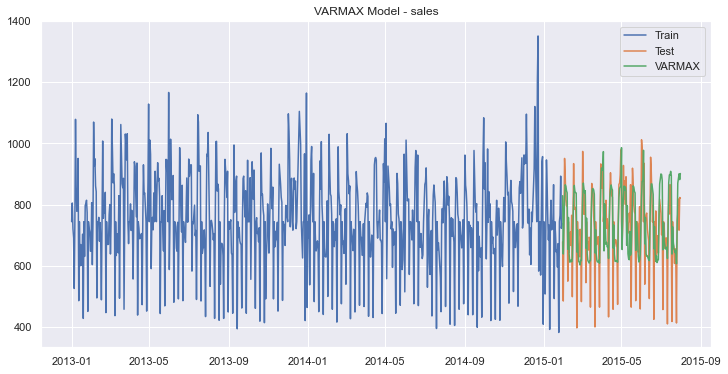

In [317]:
plt.figure(figsize=(12,6)) 
plt.plot(train['customers'], label='Train')
plt.plot(test['customers'], label='Test')
plt.plot(predictions['VARMAX_forecast_customers'], label='VARMAX')
plt.legend(loc='best')
plt.title('VARMAX Model - sales')
plt.show()

# Model Evalution

In [318]:
# Let's calculate the rmse and MAPE
rmse = np.sqrt(mean_squared_error(test['sales'], predictions['VARMAX_forecast_Sales'])).round(2)
mape = np.round(np.mean(np.abs(test['sales']-predictions['VARMAX_forecast_Sales'])/test['sales'])*100,2)
tempResults = pd.DataFrame({'Method':['VARMAX'], 'RMSE': [rmse],'MAPE': [mape] })

In [319]:
results = pd.concat([results  , tempResults])
results = results[['Method', 'RMSE', 'MAPE']]
results

,Method,RMSE,MAPE
0,ARIMA,1519.86,18.40
0,VAR,1756.60,21.02
0,VARMAX,1100.05,12.62


**VARMAX is the best model**

# Model-Store-8

In [320]:
df_new[df_new['store']==8].head()

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year,promo2,promo2_since_week,promo2_since_year,promo_interval
7,8,5,2015-07-31,8492,833,1,1,0,1,a,a,7520.0,10.0,2014.0,0,NaN,NaN,NaN
1122,8,4,2015-07-30,8420,882,1,1,0,1,a,a,7520.0,10.0,2014.0,0,NaN,NaN,NaN
2237,8,3,2015-07-29,7029,698,1,1,0,1,a,a,7520.0,10.0,2014.0,0,NaN,NaN,NaN
3352,8,2,2015-07-28,6717,695,1,1,0,1,a,a,7520.0,10.0,2014.0,0,NaN,NaN,NaN
4467,8,1,2015-07-27,8739,841,1,1,0,1,a,a,7520.0,10.0,2014.0,0,NaN,NaN,NaN


In [321]:
#Store_8
df_new_store8=df_new[df_new['store']==8]

In [322]:
# transform datatype of the variable data to datetime
df_new_store8['date'] = pd.to_datetime( df_new_store8['date'])

In [323]:
df_new_store8.info()
#Let's check the info

<class 'pandas.core.frame.DataFrame'>
Int64Index: 942 entries, 7 to 1016102
Data columns (total 18 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   store                         942 non-null    int64         
 1   day_of_week                   942 non-null    int64         
 2   date                          942 non-null    datetime64[ns]
 3   sales                         942 non-null    int64         
 4   customers                     942 non-null    int64         
 5   open                          942 non-null    int64         
 6   promo                         942 non-null    int64         
 7   state_holiday                 942 non-null    object        
 8   school_holiday                942 non-null    int64         
 9   store_type                    942 non-null    object        
 10  assortment                    942 non-null    object        
 11  competition_distance        

In [324]:
# Check NAN values
missing_count = df_new_store8.isnull().sum() # the count of missing values
value_count = df_new_store8.isnull().count() # the count of all values

missing_percentage = round(missing_count/value_count *100, 2) # the percentage of missing values
missing_df = pd.DataFrame({'missing values count': missing_count, 'percentage': missing_percentage})
missing_df

,missing values count,percentage
store,0,0.0
day_of_week,0,0.0
date,0,0.0
sales,0,0.0
customers,0,0.0
open,0,0.0
promo,0,0.0
state_holiday,0,0.0
school_holiday,0,0.0
store_type,0,0.0


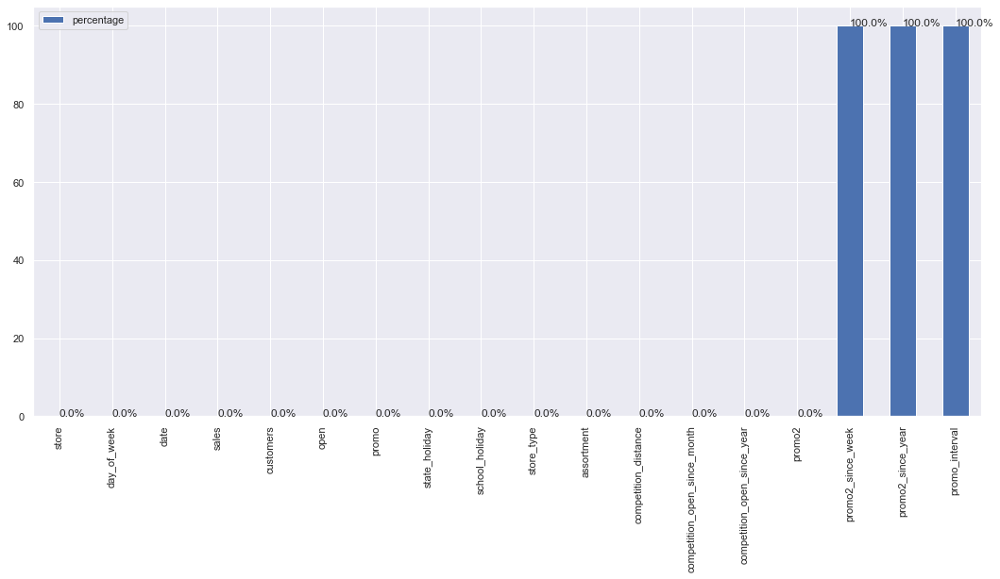

In [325]:
barchart = missing_df.plot.bar(y='percentage')
for index, percentage in enumerate( missing_percentage ):
    barchart.text( index, percentage, str(percentage)+'%')

In [326]:
#Let's drop the promo2_since_year,promo2_since_year,promo_interval
df_new_store8=df_new_store8.drop(['promo2_since_week', 'promo2_since_year','promo_interval'], axis = 1)

In [327]:
df_new_store8.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 942 entries, 7 to 1016102
Data columns (total 15 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   store                         942 non-null    int64         
 1   day_of_week                   942 non-null    int64         
 2   date                          942 non-null    datetime64[ns]
 3   sales                         942 non-null    int64         
 4   customers                     942 non-null    int64         
 5   open                          942 non-null    int64         
 6   promo                         942 non-null    int64         
 7   state_holiday                 942 non-null    object        
 8   school_holiday                942 non-null    int64         
 9   store_type                    942 non-null    object        
 10  assortment                    942 non-null    object        
 11  competition_distance        

In [328]:
#Change the datatype
df_new_store8 = df_new_store8.astype({'competition_open_since_month':'int64', 'competition_open_since_year':'int64',})
df_new_store8.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 942 entries, 7 to 1016102
Data columns (total 15 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   store                         942 non-null    int64         
 1   day_of_week                   942 non-null    int64         
 2   date                          942 non-null    datetime64[ns]
 3   sales                         942 non-null    int64         
 4   customers                     942 non-null    int64         
 5   open                          942 non-null    int64         
 6   promo                         942 non-null    int64         
 7   state_holiday                 942 non-null    object        
 8   school_holiday                942 non-null    int64         
 9   store_type                    942 non-null    object        
 10  assortment                    942 non-null    object        
 11  competition_distance        

In [329]:
# Let's copy the dataset
df_store8 = df_new_store8.copy()

In [330]:
df_store8.head()

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year,promo2
7,8,5,2015-07-31,8492,833,1,1,0,1,a,a,7520.0,10,2014,0
1122,8,4,2015-07-30,8420,882,1,1,0,1,a,a,7520.0,10,2014,0
2237,8,3,2015-07-29,7029,698,1,1,0,1,a,a,7520.0,10,2014,0
3352,8,2,2015-07-28,6717,695,1,1,0,1,a,a,7520.0,10,2014,0
4467,8,1,2015-07-27,8739,841,1,1,0,1,a,a,7520.0,10,2014,0


**Descriptive Statistics**

In [331]:
df_store8.describe().T

,count,mean,std,min,25%,50%,75%,max
store,942.0,8.000000,0.000000,8.0,8.00,8.0,8.00,8.0
day_of_week,942.0,3.997877,1.998404,1.0,2.00,4.0,6.00,7.0
sales,942.0,4610.251592,2696.883772,0.0,2916.75,4919.0,6558.00,10971.0
customers,942.0,547.799363,293.404732,0.0,374.25,630.5,759.75,1133.0
open,942.0,0.832272,0.373823,0.0,1.00,1.0,1.00,1.0
promo,942.0,0.382166,0.486175,0.0,0.00,0.0,1.00,1.0
school_holiday,942.0,0.168790,0.374765,0.0,0.00,0.0,0.00,1.0
competition_distance,942.0,7520.000000,0.000000,7520.0,7520.00,7520.0,7520.00,7520.0
competition_open_since_month,942.0,10.000000,0.000000,10.0,10.00,10.0,10.00,10.0
competition_open_since_year,942.0,2014.000000,0.000000,2014.0,2014.00,2014.0,2014.00,2014.0


In [332]:
# separate numerical and categorical attributes
num_attributes = df_store8.select_dtypes( include = 'number')
cate_attributes = df_store8.select_dtypes( include = 'object')

**Numerical Attributes**


In [333]:
# Central Tendency - Mean, median
ct1 = pd.DataFrame( num_attributes.apply( np.mean ) ).T
ct2 = pd.DataFrame( num_attributes.apply( np.median ) ).T

# Dispersion - std, min, max, range, skew, kurtoisis
d1 = pd.DataFrame(num_attributes.apply( np.std )).T
d2 = pd.DataFrame(num_attributes.apply( min )).T
d3 = pd.DataFrame(num_attributes.apply( max )).T
d4 = pd.DataFrame(num_attributes.apply( lambda x: x.max() - x.min() )).T
d5 = pd.DataFrame(num_attributes.apply( lambda x: x.skew() )).T
d6 = pd.DataFrame(num_attributes.apply( lambda x: x.kurtosis() )).T

#concatenate
m = pd.concat( [d2, d3, d4, ct1, ct2, d1, d5, d6] ).T.reset_index()


m.columns = ['attributes', 'min', 'max', 'range', 'mean', 'median', 'std', 'skew', 'kurtosis']
m

,attributes,min,max,range,mean,median,std,skew,kurtosis
0,store,8.0,8.0,0.0,8.000000,8.0,0.000000,0.000000,0.000000
1,day_of_week,1.0,7.0,6.0,3.997877,4.0,1.997343,0.002127,-1.247185
2,sales,0.0,10971.0,10971.0,4610.251592,4919.0,2695.451925,-0.294658,-0.621236
3,customers,0.0,1133.0,1133.0,547.799363,630.5,293.248956,-0.770085,-0.496317
4,open,0.0,1.0,1.0,0.832272,1.0,0.373625,-1.781477,1.176152
5,promo,0.0,1.0,1.0,0.382166,0.0,0.485917,0.485772,-1.767783
6,school_holiday,0.0,1.0,1.0,0.168790,0.0,0.374566,1.771322,1.139998
7,competition_distance,7520.0,7520.0,0.0,7520.000000,7520.0,0.000000,0.000000,0.000000
8,competition_open_since_month,10.0,10.0,0.0,10.000000,10.0,0.000000,0.000000,0.000000
9,competition_open_since_year,2014.0,2014.0,0.0,2014.000000,2014.0,0.000000,0.000000,0.000000


**Categorical Attributes**


In [334]:
# check unique values of categorical features
cate_attributes.apply( lambda x: x.unique().shape[0])

state_holiday    5
store_type       1
assortment       1
dtype: int64

In [335]:
#Let's check the unique values
print(df_store8['state_holiday'].unique())
print(df_store8['store_type'].unique())
print(df_store8['assortment'].unique())

['0' 'a' 'b' 'c' 0]
['a']
['a']


# Exploratory data analysis(EDA)

Let’s perform EDA to gain insights into the given data.

**Univariate Analysis**

Response Variable (target)

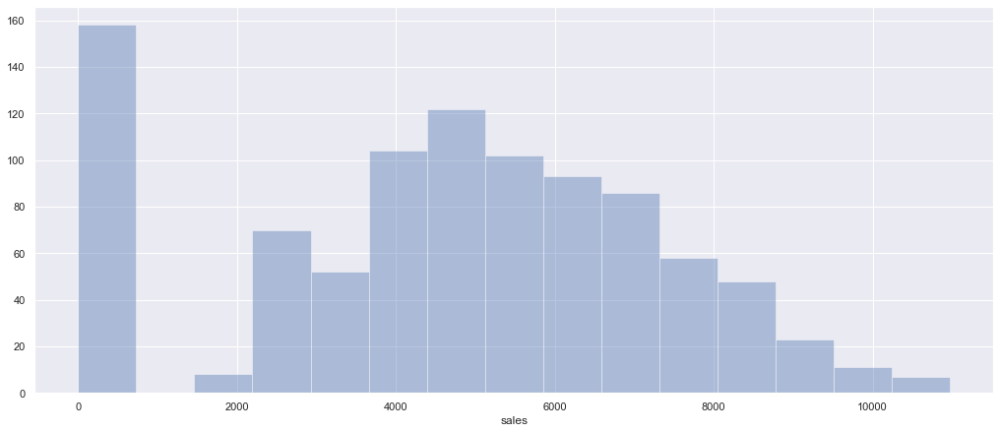

In [336]:
fig = plt.figure( figsize = (14, 6), constrained_layout=True)
sns.distplot(df_store8['sales'], kde = False);
plt.show()

**Numerical Variable**

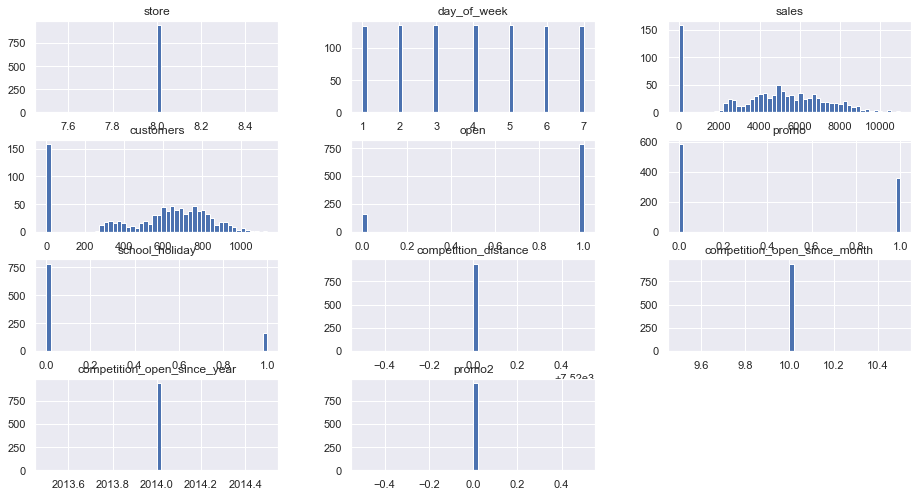

In [337]:
sns.set(rc={'figure.figsize':(15.7,8.27)})
num_attributes.hist(bins = 50);

In [338]:
df_store8['day_of_week'].value_counts()
#day of the week

5    135
4    135
3    135
2    135
7    134
6    134
1    134
Name: day_of_week, dtype: int64

In [339]:
df_store8['open'].value_counts()
# value count of store is open or not

1    784
0    158
Name: open, dtype: int64

In [340]:
df_store8['promo'].value_counts()
# value count of promo

0    582
1    360
Name: promo, dtype: int64

In [341]:
df_store8['state_holiday'].value_counts()
# value count of state_holiday

0    789
0    129
a     14
b      6
c      4
Name: state_holiday, dtype: int64

In [342]:
df_store8['school_holiday'].value_counts()
# value count of state_holiday

0    783
1    159
Name: school_holiday, dtype: int64

In [343]:
df_store8['store_type'].value_counts()
# value count of store_type

a    942
Name: store_type, dtype: int64

In [344]:
df_store8['assortment'].value_counts()
# value count of assortment

a    942
Name: assortment, dtype: int64

In [345]:
df_store8['competition_distance'].value_counts()
# value count of competition_distance

7520.0    942
Name: competition_distance, dtype: int64

In [346]:
df_store8['competition_open_since_month'].value_counts()
# value count of competiton_open_since_month

10    942
Name: competition_open_since_month, dtype: int64

In [347]:
df_store8['competition_open_since_year'].value_counts()
# value count of competition_open_since_year

2014    942
Name: competition_open_since_year, dtype: int64

In [348]:
df_store8['promo2'].value_counts()
# value count of promo2

0    942
Name: promo2, dtype: int64

**Categorical Variable**

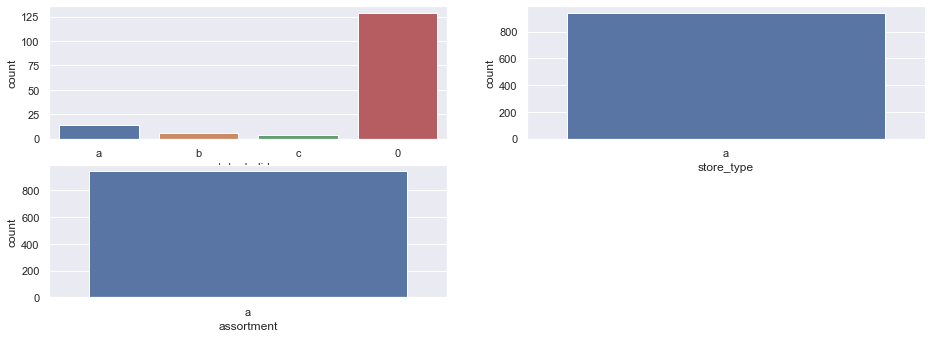

In [349]:
# state_holiday
plt.subplot(3, 2, 1)
a = df_store8[df_store8['state_holiday'] != '0']
sns.countplot(data = a, x = a['state_holiday'])

# store_type
plt.subplot(3, 2, 2)
sns.countplot(data = df_store8, x = df_store8['store_type'])

# assortment
plt.subplot(3, 2, 3)
sns.countplot(data = df_store8, x = df_store8['assortment'])

plt.show()

In [350]:
df_store8[df_store8['sales']==0]

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year,promo2
5582,8,7,2015-07-26,0,0,0,0,0,0,a,a,7520.0,10,2014,0
13387,8,7,2015-07-19,0,0,0,0,0,0,a,a,7520.0,10,2014,0
21192,8,7,2015-07-12,0,0,0,0,0,0,a,a,7520.0,10,2014,0
28997,8,7,2015-07-05,0,0,0,0,0,0,a,a,7520.0,10,2014,0
36802,8,7,2015-06-28,0,0,0,0,0,0,a,a,7520.0,10,2014,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
987112,8,7,2013-01-27,0,0,0,0,0,0,a,a,7520.0,10,2014,0
994917,8,7,2013-01-20,0,0,0,0,0,0,a,a,7520.0,10,2014,0
1002722,8,7,2013-01-13,0,0,0,0,0,0,a,a,7520.0,10,2014,0
1010527,8,7,2013-01-06,0,0,0,0,0,0,a,a,7520.0,10,2014,0


In [351]:
df_store8.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 942 entries, 7 to 1016102
Data columns (total 15 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   store                         942 non-null    int64         
 1   day_of_week                   942 non-null    int64         
 2   date                          942 non-null    datetime64[ns]
 3   sales                         942 non-null    int64         
 4   customers                     942 non-null    int64         
 5   open                          942 non-null    int64         
 6   promo                         942 non-null    int64         
 7   state_holiday                 942 non-null    object        
 8   school_holiday                942 non-null    int64         
 9   store_type                    942 non-null    object        
 10  assortment                    942 non-null    object        
 11  competition_distance        


-    Sale  and customer colomns has zero values which has to be imputed

-    Store is open on 80% of days

-    80% are regular days

-    All the rows of column-store type belongs to 'a'

-    All the rows of column-assortment belongs to 'a'

-    All the rows of columns-competition_distance to 7520

-    All the competition is opened since month-10

-    All the competition is opened since 2014

-    All the rows of promo2 belogs to 0


**Bivariate Analysis**

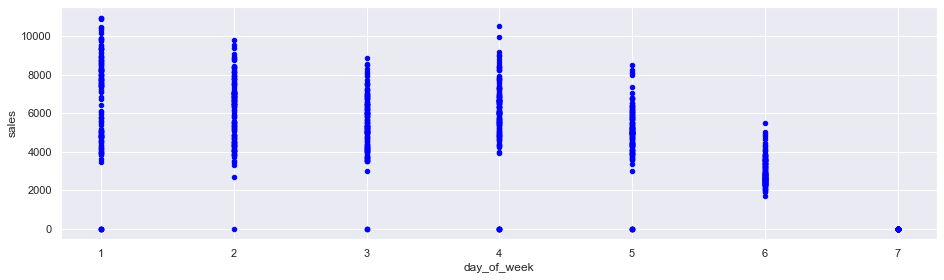

In [352]:
# lets draw a scatter plot between  Sales and day_of_week
sns.set(rc={'figure.figsize':(15.7,4.27)})
df_store8[['sales', 'day_of_week']].plot.scatter(x = 'day_of_week',y='sales',c='blue')
plt.show()

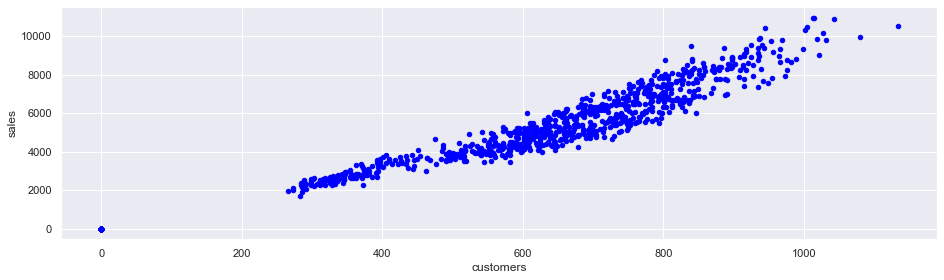

In [353]:
#Let's draw a scatter plot between Sales and Customers
df_store8[['sales', 'customers']].plot.scatter(x = 'customers',y='sales',c='blue')
plt.show()

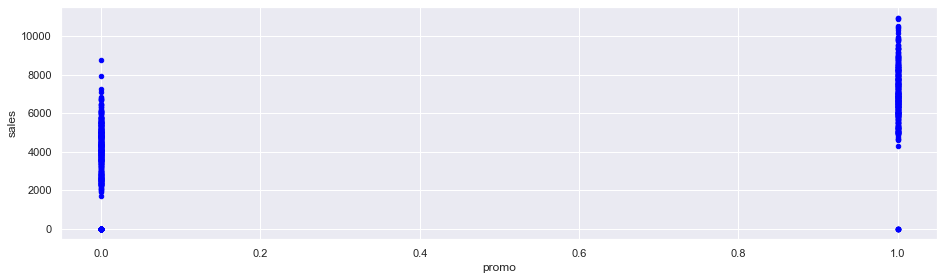

In [354]:
#Let's now draw a scatter plot between Sales and promo
df_store8[['sales', 'promo']].plot.scatter(x = 'promo',y='sales',c='blue')
plt.show()

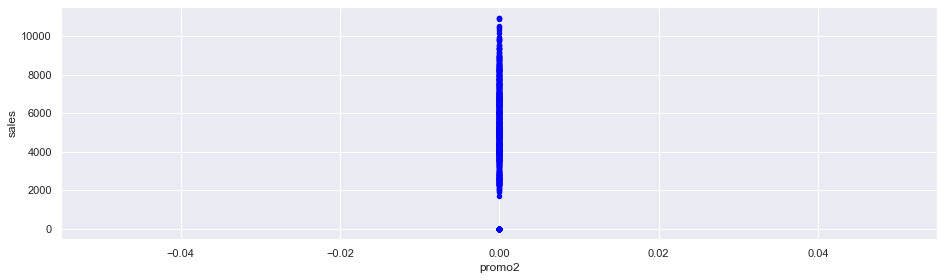

In [355]:
#Let's now draw a scatter plot between Sales and promo
df_store8[['sales', 'promo2']].plot.scatter(x = 'promo2',y='sales',c='blue')
plt.show()

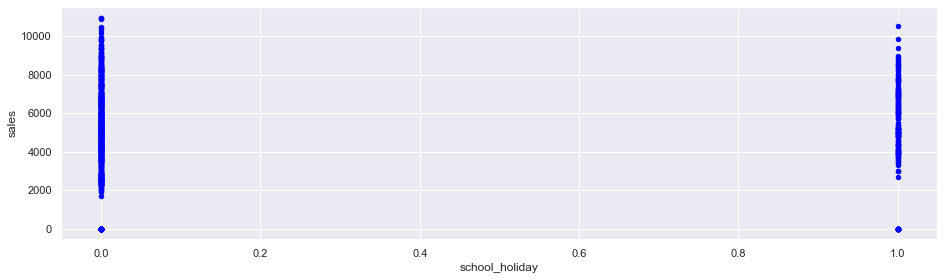

In [356]:
#lets now draw a scatter plot between  Sales and school_holiday
df_store8[['sales', 'school_holiday']].plot.scatter(x = 'school_holiday',y='sales',c='blue')
plt.show()

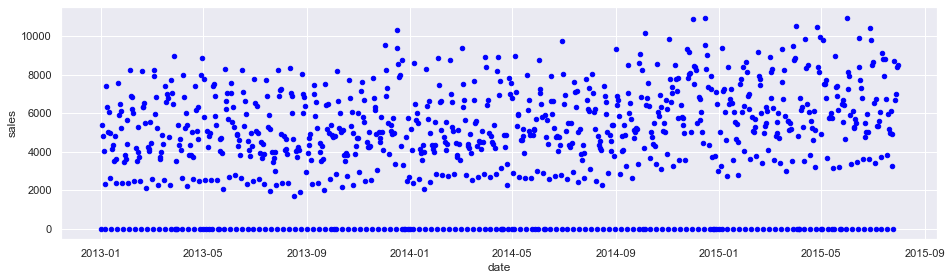

In [357]:
#lets now draw a scatter plot between Sales and date
df_store8[['sales', 'date']].plot.scatter(x = 'date',y='sales',c='blue')
plt.show()

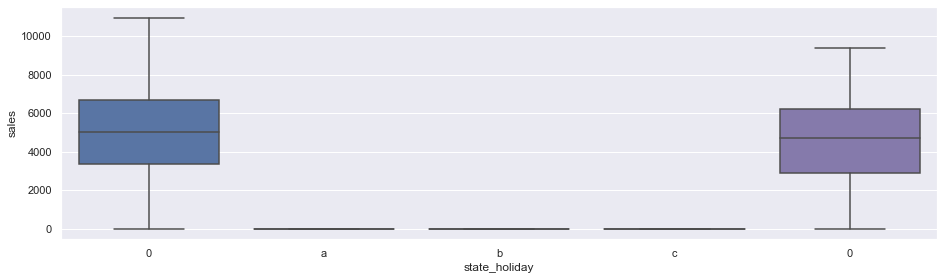

In [358]:
#Let's draw the boxplot between sales and state_holiday
sns.set(rc={'figure.figsize':(15.7,4.27)})
# create grouped boxplot 
sns.boxplot(x = df_store8['state_holiday'],
            y = df_store8['sales'])
plt.show()

**Multivariate Analysis**


**Numerical Attributes**


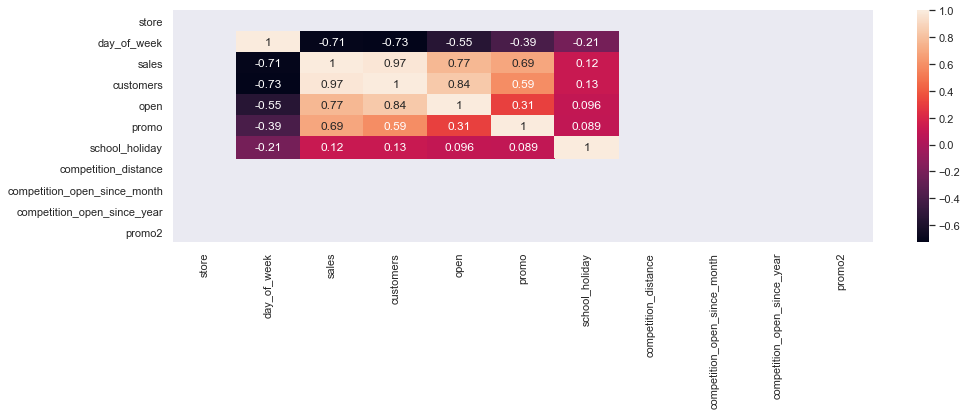

In [359]:
correlation = (num_attributes.corr( method = 'pearson' ))
sns.heatmap( correlation, annot = True );

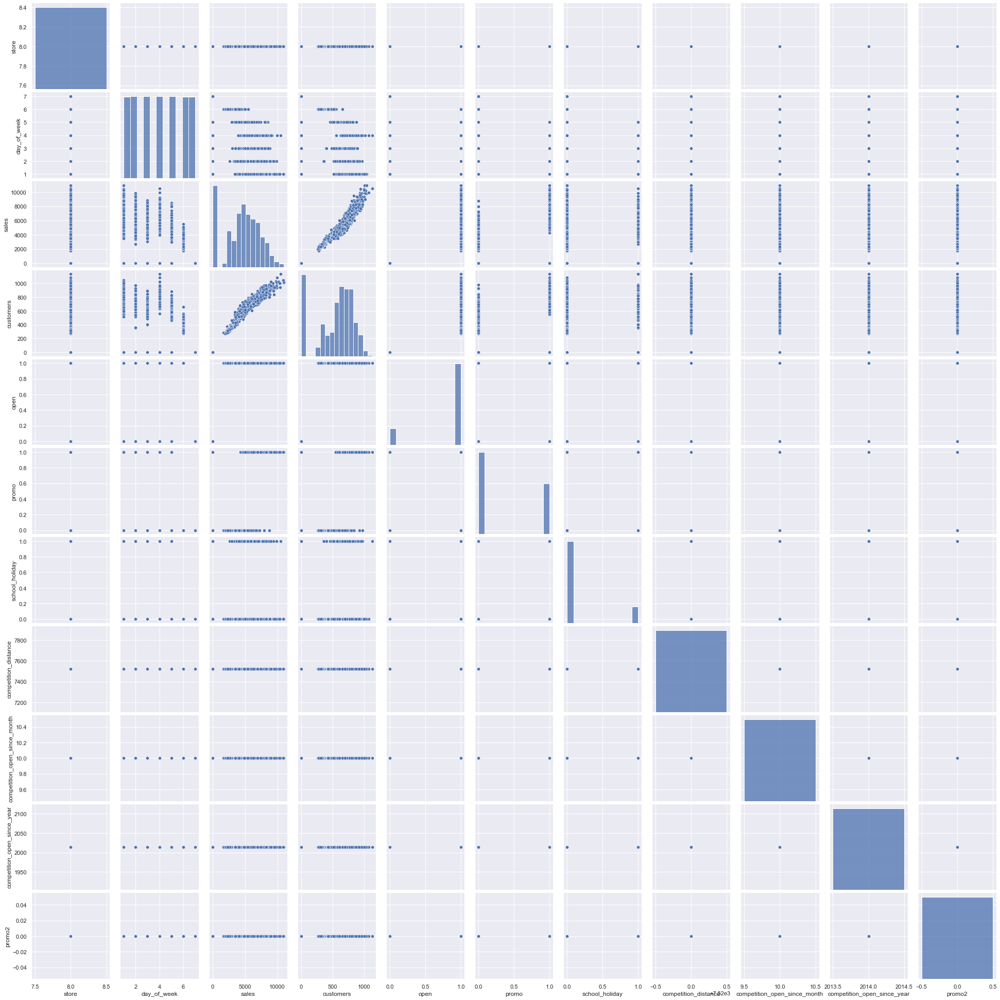

In [360]:
#pairplot with hue sales
sns.pairplot(df_store8)
# to show
plt.show()

**Some insights from EDA**

   - store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year

   - Day1,Day2 and Day4 have higher sales than other days

   - promo is correlated to sales

   - Promo2 doesn't have any effect on sales becuase it's value is equal to 0

   - There is no sale on a = public holiday, b = Easter holiday, c = Christmas

   - There is some effect of school holiday on sales


In [361]:
#Let's check the columns
df_store8.columns

Index(['store', 'day_of_week', 'date', 'sales', 'customers', 'open', 'promo',
       'state_holiday', 'school_holiday', 'store_type', 'assortment',
       'competition_distance', 'competition_open_since_month',
       'competition_open_since_year', 'promo2'],
      dtype='object')

In [362]:
# We can drop store_type,assortment,competition_distance,competition_open_since_month,promo2_since_week,promo2_since_year,promo_interval
#competition_open_since_year & promo2
df_store8_new=df_store8.drop(['store_type', 'assortment','competition_distance','competition_open_since_month','competition_open_since_year'], axis = 1)

In [363]:
df_store8_new.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 942 entries, 7 to 1016102
Data columns (total 10 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   store           942 non-null    int64         
 1   day_of_week     942 non-null    int64         
 2   date            942 non-null    datetime64[ns]
 3   sales           942 non-null    int64         
 4   customers       942 non-null    int64         
 5   open            942 non-null    int64         
 6   promo           942 non-null    int64         
 7   state_holiday   942 non-null    object        
 8   school_holiday  942 non-null    int64         
 9   promo2          942 non-null    int64         
dtypes: datetime64[ns](1), int64(8), object(1)
memory usage: 121.0+ KB


In [364]:
df_store8_new.head()

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,promo2
7,8,5,2015-07-31,8492,833,1,1,0,1,0
1122,8,4,2015-07-30,8420,882,1,1,0,1,0
2237,8,3,2015-07-29,7029,698,1,1,0,1,0
3352,8,2,2015-07-28,6717,695,1,1,0,1,0
4467,8,1,2015-07-27,8739,841,1,1,0,1,0


# Model Building

**ARIMA model**

In [365]:
df_store8_new=df_store8_new[::-1].reset_index()
df_store8_new.head()

,index,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,promo2
0,1016102,8,2,2013-01-01,0,0,0,0,a,1,0
1,1014987,8,3,2013-01-02,5419,698,1,0,0,1,0
2,1013872,8,4,2013-01-03,4842,662,1,0,0,1,0
3,1012757,8,5,2013-01-04,4059,517,1,0,0,1,0
4,1011642,8,6,2013-01-05,2337,312,1,0,0,0,0


In [366]:
df_store8_new=df_store8_new.drop(['index'], axis = 1)
df_store8_new.head()
#Let drop the index column

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,promo2
0,8,2,2013-01-01,0,0,0,0,a,1,0
1,8,3,2013-01-02,5419,698,1,0,0,1,0
2,8,4,2013-01-03,4842,662,1,0,0,1,0
3,8,5,2013-01-04,4059,517,1,0,0,1,0
4,8,6,2013-01-05,2337,312,1,0,0,0,0


In [367]:
df_store8_new.info()
#No missing value

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 942 entries, 0 to 941
Data columns (total 10 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   store           942 non-null    int64         
 1   day_of_week     942 non-null    int64         
 2   date            942 non-null    datetime64[ns]
 3   sales           942 non-null    int64         
 4   customers       942 non-null    int64         
 5   open            942 non-null    int64         
 6   promo           942 non-null    int64         
 7   state_holiday   942 non-null    object        
 8   school_holiday  942 non-null    int64         
 9   promo2          942 non-null    int64         
dtypes: datetime64[ns](1), int64(8), object(1)
memory usage: 73.7+ KB


In [368]:
# transform datatype of the variable data to datetime
df_store8_new['date'] = pd.to_datetime(df_store8_new['date'])

In [369]:
indexed_df_store8_new = df_store8_new.set_index(['date'])
indexed_df_store8_new.head()
#Let set the date as index column

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2
date,,,,,,,,,
2013-01-01,8,2,0,0,0,0,a,1,0
2013-01-02,8,3,5419,698,1,0,0,1,0
2013-01-03,8,4,4842,662,1,0,0,1,0
2013-01-04,8,5,4059,517,1,0,0,1,0
2013-01-05,8,6,2337,312,1,0,0,0,0


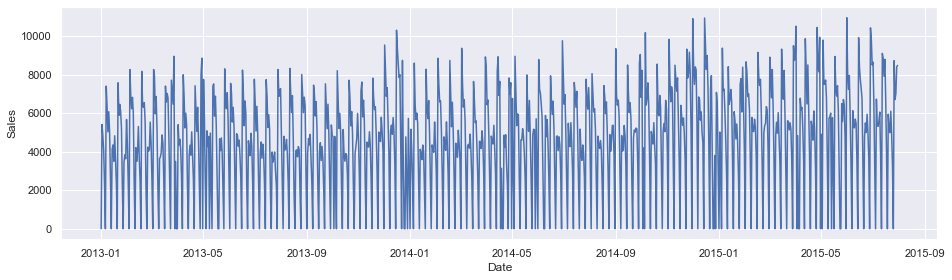

In [370]:
## plot graph
plt.xlabel('Date')
plt.ylabel('Sales')
plt.plot(indexed_df_store8_new['sales'])
plt.show()

In [371]:
#Let impute the zero values
(indexed_df_store8_new['sales']==0).sum()
# There are 158 zero value in sale column

158

In [372]:
indexed_df_store8_new['sales']=indexed_df_store8_new['sales'].replace(0, np.nan)

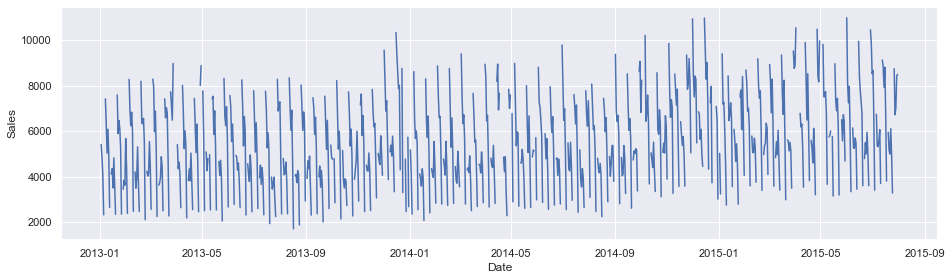

In [373]:
##plot graph
plt.xlabel('Date')
plt.ylabel('Sales')
plt.plot(indexed_df_store8_new['sales'])
plt.show()

In [374]:
#KNN imputer for filling NAN values
imputer = KNNImputer(n_neighbors=2)

In [375]:
indexed_df_store8_new['sales'] = imputer.fit_transform(np.array(indexed_df_store8_new['sales']).reshape(-1, 1))
indexed_df_store8_new['sales'].head()

date
2013-01-01    5539.358418
2013-01-02    5419.000000
2013-01-03    4842.000000
2013-01-04    4059.000000
2013-01-05    2337.000000
Name: sales, dtype: float64

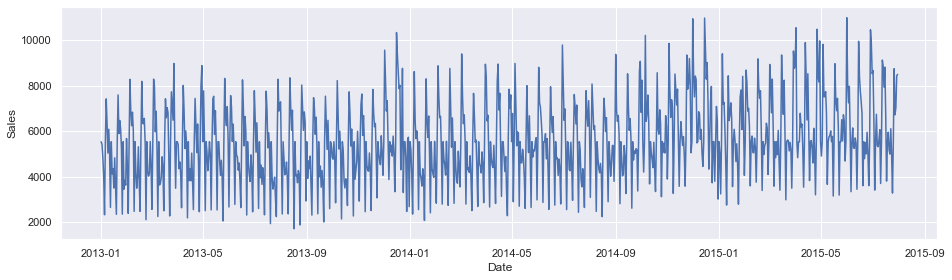

In [376]:
## plot graph
plt.xlabel('Date')
plt.ylabel('Sales')
plt.plot(indexed_df_store8_new['sales'])
plt.show()

In [377]:
(indexed_df_store8_new['sales']==0).sum()
# no missing value

0

**Outlier detection**

Box plot and interquartile range

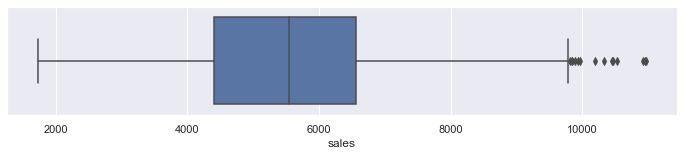

In [378]:
import seaborn as sns
fig = plt.subplots(figsize=(12, 2))
ax = sns.boxplot(x=indexed_df_store8_new['sales'],whis=1.5)
#Let treat the outliers

**Histogram**

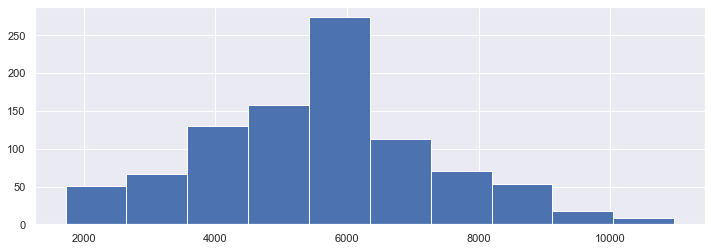

In [379]:
fig = indexed_df_store8_new['sales'].hist(figsize = (12,4))

In [380]:
percentile01 = indexed_df_store8_new['sales'].quantile(0.01)
percentile99 = indexed_df_store8_new['sales'].quantile(0.99)

In [381]:
upper_limit = percentile99
lower_limit = percentile01

In [382]:
upper_limit

9914.04

In [383]:
lower_limit

2255.23

In [384]:
new_df = indexed_df_store8_new[indexed_df_store8_new['sales'] < upper_limit]
new_df.shape

(932, 9)

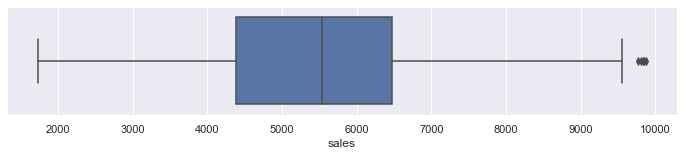

In [385]:
import seaborn as sns
fig = plt.subplots(figsize=(12, 2))
ax = sns.boxplot(x=new_df['sales'],whis=1.5)

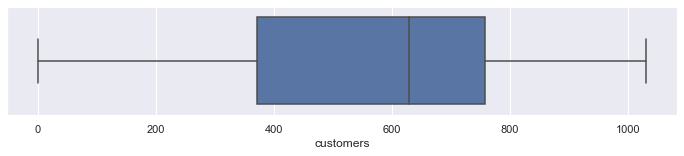

In [386]:
import seaborn as sns
fig = plt.subplots(figsize=(12, 2))
ax = sns.boxplot(x=new_df['customers'],whis=1.5)

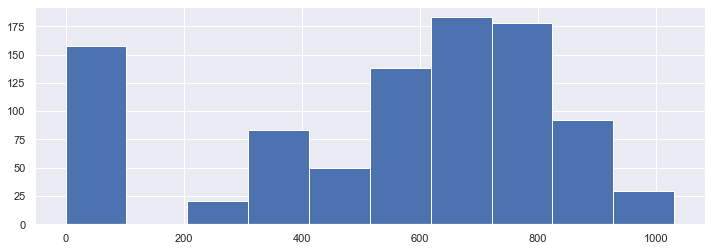

In [387]:
fig = new_df['customers'].hist(figsize = (12,4))

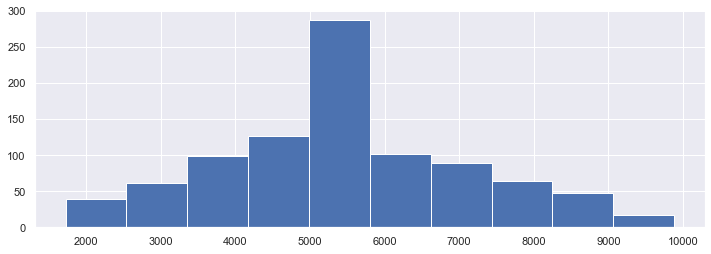

In [388]:
fig = new_df['sales'].hist(figsize = (12,4))

**ADF Stationary**


In [389]:
def test_stationarity(timeseries):
    
    #Determine rolling statistics
    movingAverage = timeseries.rolling(window=12).mean()
    movingSTD = timeseries.rolling(window=12).std()
    
    #Plot rolling statistics
    orig = plt.plot(timeseries, color='blue', label='Original')
    mean = plt.plot(movingAverage, color='red', label='Rolling Mean')
    std = plt.plot(movingSTD, color='black', label='Rolling Std')
    plt.legend(loc='best')
    plt.title('Rolling Mean & Standard Deviation')
    plt.show(block=False)
    
    #Perform Dickey–Fuller test:
    print('Results of Dickey Fuller Test:')
    dftest = adfuller(indexed_df_store8_new['sales'], autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    for key,value in dftest[4].items():
        dfoutput['Critical Value (%s)'%key] = value
    print(dfoutput)

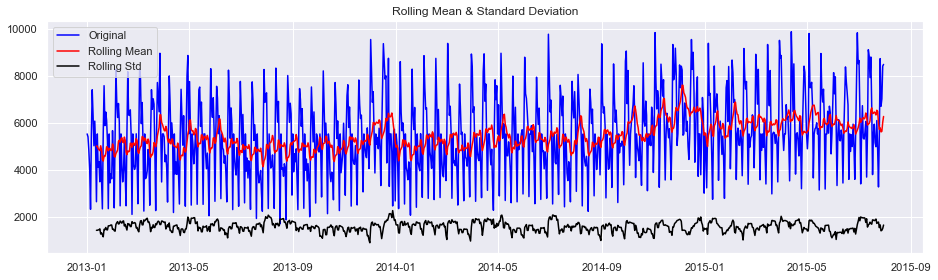

Results of Dickey Fuller Test:
Test Statistic                  -3.516398
p-value                          0.007576
#Lags Used                      22.000000
Number of Observations Used    919.000000
Critical Value (1%)             -3.437486
Critical Value (5%)             -2.864690
Critical Value (10%)            -2.568447
dtype: float64


In [390]:
test_stationarity(new_df['sales'])

- Null: Time Series is not stationary
- Alternate: Time Series is Stationary

**The p-value is less than 0.05 so The series is stationary**

In [391]:
from statsmodels.tsa.stattools import kpss
kpss_test = kpss(new_df['sales'])

print('KPSS Statistic: %f' % kpss_test[0])
print('Critical Values @ 0.05: %.2f' % kpss_test[3]['5%'])
print('p-value: %f' % kpss_test[1])

KPSS Statistic: 2.561074
Critical Values @ 0.05: 0.46
p-value: 0.010000


- Null: Time Series is not stationary
- Alternate: Time Series is Stationary
    
**The p-value is less than 0.05 so The series is non-stationary**

# Let's take the log of sales to Standardize the sales values

In [392]:
new_df.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2
date,,,,,,,,,
2013-01-01,8,2,5539.358418,0,0,0,a,1,0
2013-01-02,8,3,5419.000000,698,1,0,0,1,0
2013-01-03,8,4,4842.000000,662,1,0,0,1,0
2013-01-04,8,5,4059.000000,517,1,0,0,1,0
2013-01-05,8,6,2337.000000,312,1,0,0,0,0


In [393]:
#Log Transformation
new_df['sales_log'] = np.log(new_df['sales'])
new_df.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log
date,,,,,,,,,,
2013-01-01,8,2,5539.358418,0,0,0,a,1,0,8.619634
2013-01-02,8,3,5419.000000,698,1,0,0,1,0,8.597667
2013-01-03,8,4,4842.000000,662,1,0,0,1,0,8.485083
2013-01-04,8,5,4059.000000,517,1,0,0,1,0,8.308692
2013-01-05,8,6,2337.000000,312,1,0,0,0,0,7.756623


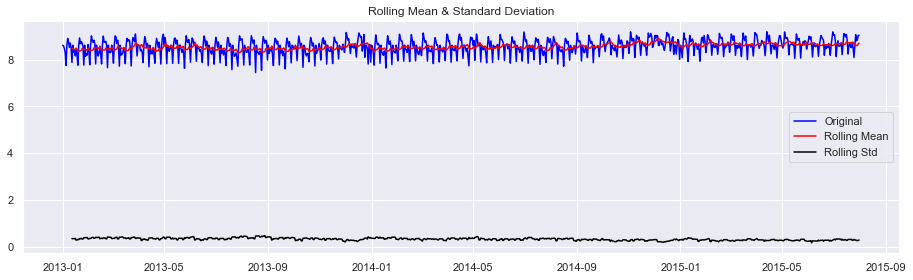

Results of Dickey Fuller Test:
Test Statistic                  -3.516398
p-value                          0.007576
#Lags Used                      22.000000
Number of Observations Used    919.000000
Critical Value (1%)             -3.437486
Critical Value (5%)             -2.864690
Critical Value (10%)            -2.568447
dtype: float64


In [394]:
test_stationarity(new_df['sales_log'])

**Log transformation has made mean & variance constant**

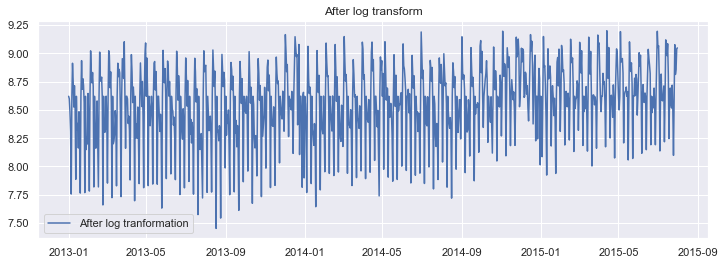

In [395]:
#After Log Transformation
plt.figure(figsize=(12,4))
plt.plot(new_df['sales_log'], label='After log tranformation')
plt.legend(loc='best')
plt.title('After log transform')
plt.show()

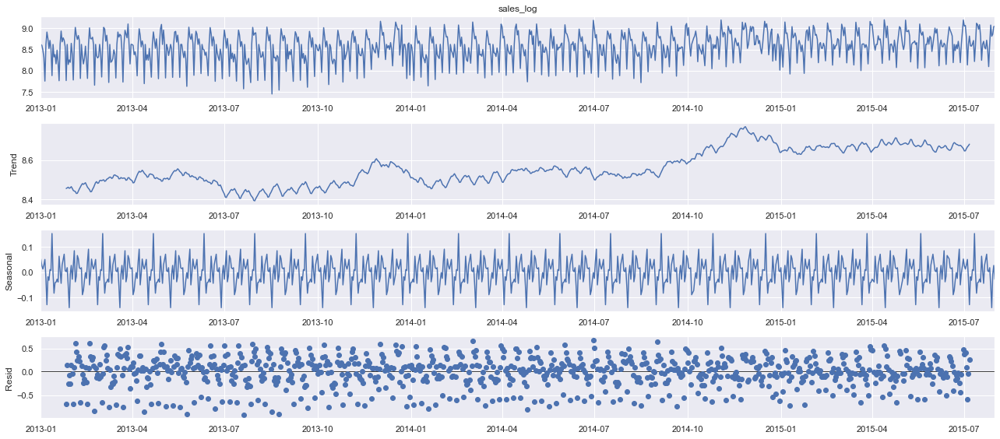

In [396]:
from matplotlib.pyplot import rcParams
rcParams['figure.figsize'] = 18,8
decomposition = sm.tsa.seasonal_decompose(new_df['sales_log'], model = "additive",period=50)
fig = decomposition.plot()

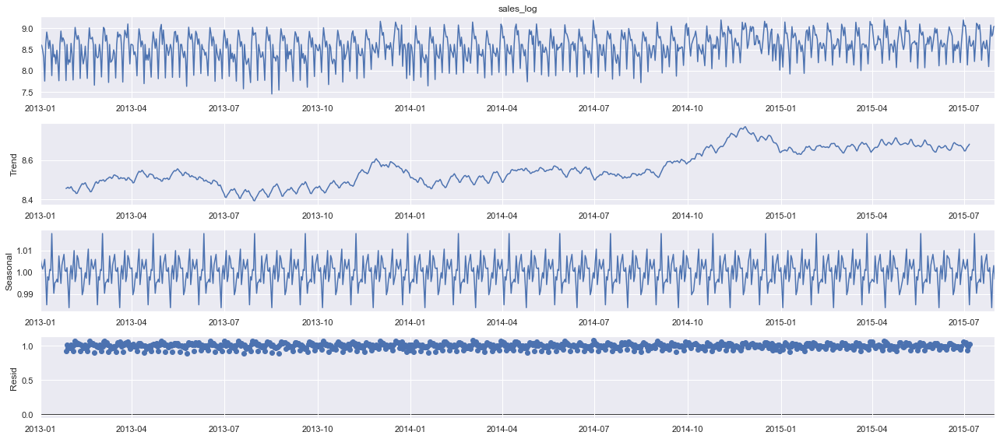

In [397]:
from matplotlib.pyplot import rcParams
rcParams['figure.figsize'] = 18,8
decomposition = sm.tsa.seasonal_decompose(new_df['sales_log'], model = "multiplicative",period=50)
fig = decomposition.plot()

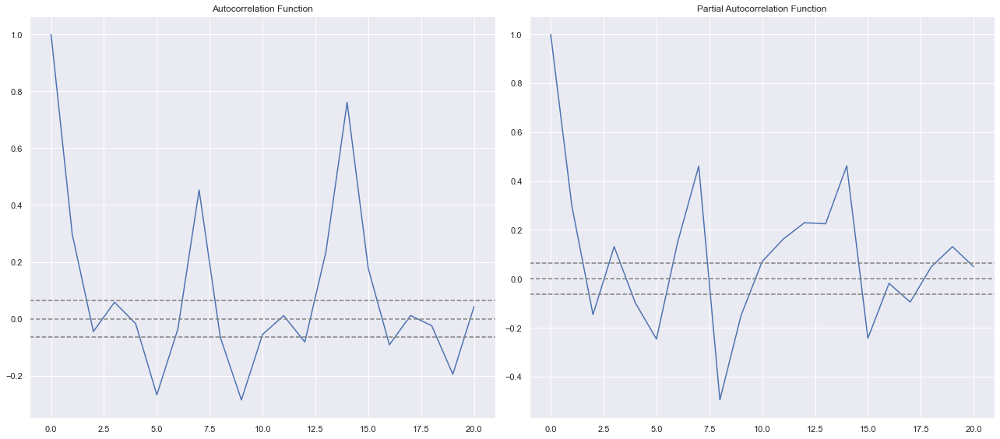

In [398]:
#ACF & PACF plots

lag_acf = acf(new_df['sales_log'], nlags=20) # MA 
lag_pacf = pacf(new_df['sales_log'], nlags=20, method='ols')  # AR 

#Plot ACF:
plt.subplot(121)
plt.plot(lag_acf)
plt.axhline(y=0, linestyle='--', color='gray')
plt.axhline(y=-1.96/np.sqrt(len(new_df['sales_log'])), linestyle='--', color='gray')
plt.axhline(y=1.96/np.sqrt(len(new_df['sales_log'])), linestyle='--', color='gray')
plt.title('Autocorrelation Function')            

#Plot PACF
plt.subplot(122)
plt.plot(lag_pacf)
plt.axhline(y=0, linestyle='--', color='gray')
plt.axhline(y=-1.96/np.sqrt(len(new_df['sales_log'])), linestyle='--', color='gray')
plt.axhline(y=1.96/np.sqrt(len(new_df['sales_log'])), linestyle='--', color='gray')
plt.title('Partial Autocorrelation Function')
            
plt.tight_layout() 

From the ACF graph, we see that curve touches y=0.0 line at x=2. Thus, from theory, Q = 2 From the PACF graph, we see that curve touches y=0.0 line at x=2. Thus, from theory, P = 2


**Build and evaluate time series forecast**

Split time series data into training and test set

In [399]:
train_len = 750
train = new_df['sales'][0:train_len] # first 750days as training set
test = new_df['sales'][train_len:] # last 182 days as out-of-time test set

In [400]:
print(train.shape)
print(test.shape)

(750,)
(182,)


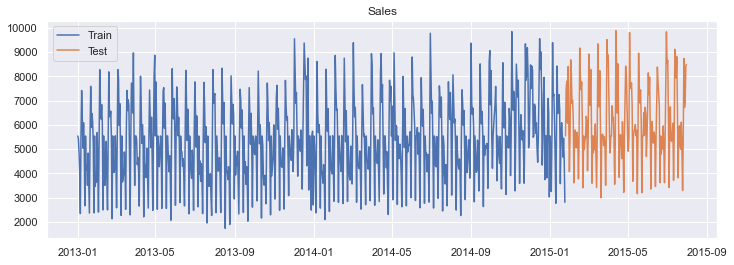

In [401]:
plt.figure(figsize=(12,4))
plt.plot(train, label='Train')
plt.plot(test, label='Test')
plt.legend(loc='best')
plt.title('Sales')
plt.show()

In [402]:
model = ARIMA(new_df['sales_log'], order=(2, 0, 2))
model_fit = model.fit()
print(model_fit.params)

const              8.559607
ar.L1.sales_log   -0.728296
ar.L2.sales_log   -0.030747
ma.L1.sales_log    1.101245
ma.L2.sales_log    0.234060
dtype: float64


In [403]:
new_df['ar_forecast_Log'] = model_fit.predict(new_df.index.min(), new_df.index.max())
new_df['arima_forecast'] = np.exp(new_df['ar_forecast_Log'])
new_df['arima_forecast']

date
2013-01-01    5216.632418
2013-01-02    5311.169383
2013-01-03    5238.734820
2013-01-04    5073.367276
2013-01-05    4832.552761
                 ...     
2015-07-27    5681.509875
2015-07-28    6004.357066
2015-07-29    5345.074215
2015-07-30    5782.032655
2015-07-31    5882.699352
Name: arima_forecast, Length: 932, dtype: float64

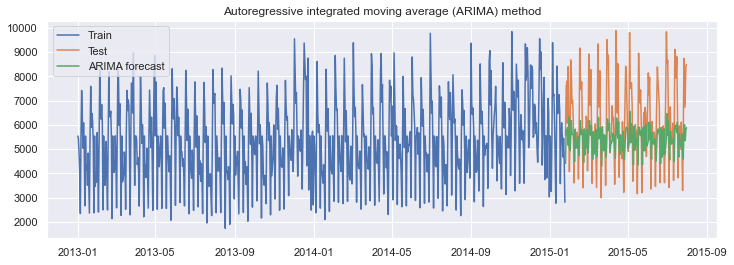

In [404]:
plt.figure(figsize=(12,4))
plt.plot(train, label='Train')
plt.plot(test, label='Test')
plt.plot(new_df['arima_forecast'][test.index.min():], label='ARIMA forecast')
plt.legend(loc='best')
plt.title('Autoregressive integrated moving average (ARIMA) method')
plt.show()

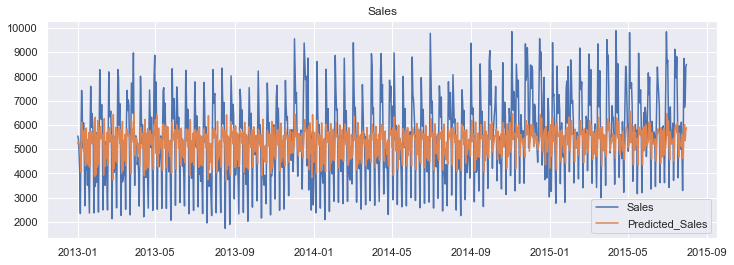

In [405]:
# plot the arima forecasting & Original series
plt.figure(figsize=(12,4))
plt.plot(new_df['sales'], label='Sales')
plt.plot(new_df['arima_forecast'], label='Predicted_Sales')
plt.legend(loc='best')
plt.title('Sales')
plt.show()

In [406]:
from sklearn.metrics import mean_squared_error
rmse = np.sqrt(mean_squared_error(test, new_df['arima_forecast'][test.index.min():])).round(2)
mape = np.round(np.mean(np.abs(test-new_df['arima_forecast'][test.index.min():])/test)*100,2)
Results = pd.DataFrame({'Method':['ARIMA'], 'RMSE': [rmse],'MAPE': [mape] })
Results

,Method,RMSE,MAPE
0,ARIMA,1609.49,20.64


**VAR model**

In [407]:
#Load the dataset
new_df.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast
date,,,,,,,,,,,,
2013-01-01,8,2,5539.358418,0,0,0,a,1,0,8.619634,8.559607,5216.632418
2013-01-02,8,3,5419.000000,698,1,0,0,1,0,8.597667,8.577567,5311.169383
2013-01-03,8,4,4842.000000,662,1,0,0,1,0,8.485083,8.563835,5238.734820
2013-01-04,8,5,4059.000000,517,1,0,0,1,0,8.308692,8.531760,5073.367276
2013-01-05,8,6,2337.000000,312,1,0,0,0,0,7.756623,8.483130,4832.552761


**Split the dataset to training & testing**

In [408]:
#split the dataset
nobs = 182
train, test = new_df[0:-nobs], new_df[-nobs:]

# Check size
print(train.shape)
print(test.shape)  

(750, 12)
(182, 12)


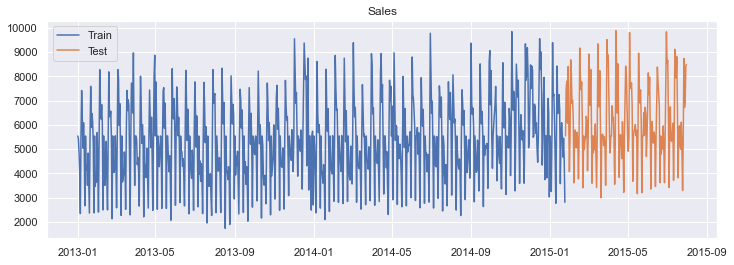

In [409]:
plt.figure(figsize=(12,4))
plt.plot(train['sales'], label='Train')
plt.plot(test['sales'], label='Test')
plt.legend(loc='best')
plt.title('Sales')
plt.show()

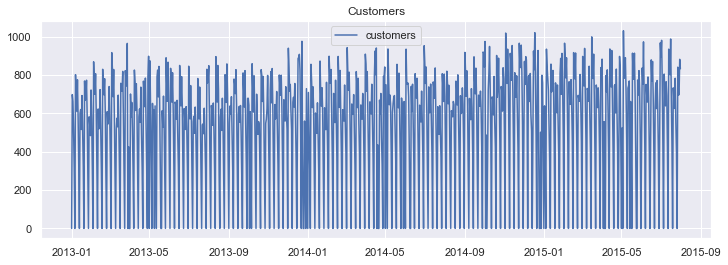

In [410]:
#plot the arima forecasting & Original series
plt.figure(figsize=(12,4))
plt.plot(new_df['customers'],label='customers')
plt.legend(loc='best')
plt.title('Customers')
plt.show()

In [411]:
(new_df['customers']==0).sum()

158

In [412]:
#impute the NAN values
new_df['customers']=new_df['customers'].replace(0, np.nan)

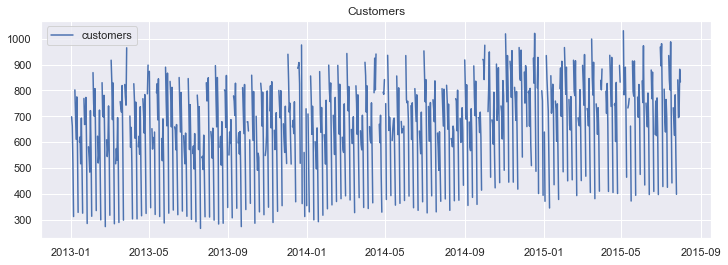

In [413]:
#plot the arima forecasting & Original series
plt.figure(figsize=(12,4))
plt.plot(new_df['customers'],label='customers')
plt.legend(loc='best')
plt.title('Customers')
plt.show()

In [414]:
#KNN imputer for filling NAN values
imputer = KNNImputer(n_neighbors=2)

In [415]:
new_df['customers'] = imputer.fit_transform(np.array(new_df['customers']).reshape(-1, 1))
new_df['customers'].head()

date
2013-01-01    653.527132
2013-01-02    698.000000
2013-01-03    662.000000
2013-01-04    517.000000
2013-01-05    312.000000
Name: customers, dtype: float64

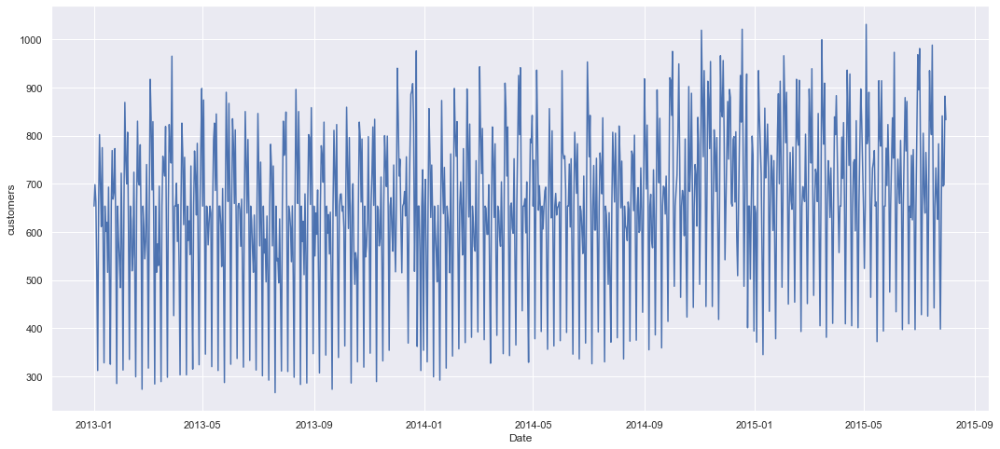

In [416]:
## plot graph
plt.xlabel('Date')
plt.ylabel('customers')
plt.plot(new_df['customers'])
plt.show()

In [417]:
new_df.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast
date,,,,,,,,,,,,
2013-01-01,8,2,5539.358418,653.527132,0,0,a,1,0,8.619634,8.559607,5216.632418
2013-01-02,8,3,5419.000000,698.000000,1,0,0,1,0,8.597667,8.577567,5311.169383
2013-01-03,8,4,4842.000000,662.000000,1,0,0,1,0,8.485083,8.563835,5238.734820
2013-01-04,8,5,4059.000000,517.000000,1,0,0,1,0,8.308692,8.531760,5073.367276
2013-01-05,8,6,2337.000000,312.000000,1,0,0,0,0,7.756623,8.483130,4832.552761


**ADF test**

In [418]:
def test_stationarity(timeseries):
    
    #Determine rolling statistics
    movingAverage = timeseries.rolling(window=12).mean()
    movingSTD = timeseries.rolling(window=12).std()
    
    #Plot rolling statistics
    orig = plt.plot(timeseries, color='blue', label='Original')
    mean = plt.plot(movingAverage, color='red', label='Rolling Mean')
    std = plt.plot(movingSTD, color='black', label='Rolling Std')
    plt.legend(loc='best')
    plt.title('Rolling Mean & Standard Deviation')
    plt.show(block=False)
    
    #Perform Dickey–Fuller test:
    print('Results of Dickey Fuller Test:')
    dftest = adfuller(new_df['customers'], autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    for key,value in dftest[4].items():
        dfoutput['Critical Value (%s)'%key] = value
    print(dfoutput)

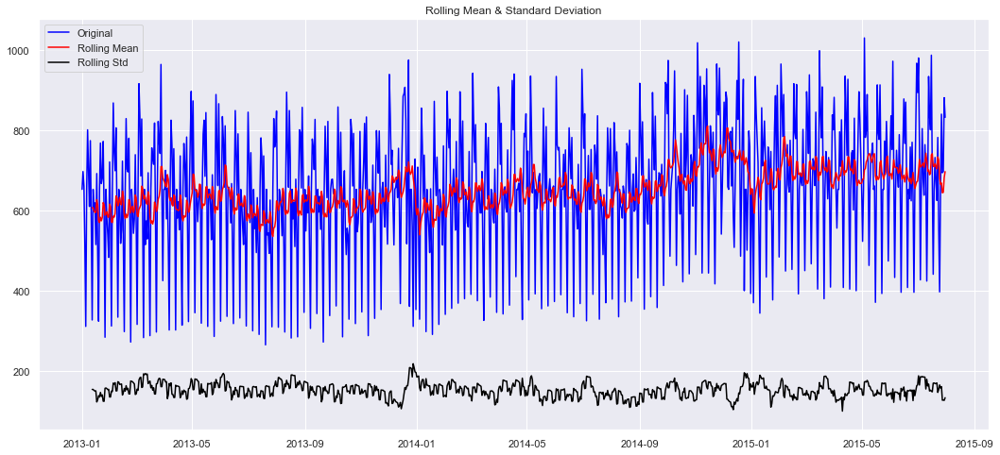

Results of Dickey Fuller Test:
Test Statistic                  -3.321760
p-value                          0.013933
#Lags Used                      18.000000
Number of Observations Used    913.000000
Critical Value (1%)             -3.437533
Critical Value (5%)             -2.864711
Critical Value (10%)            -2.568458
dtype: float64


In [419]:
test_stationarity(new_df['customers'])

- Null: Time Series is not stationary
- Alternate: Time Series is Stationary

**The p-value is less than 0.05 so The series is stationary**

In [420]:
from statsmodels.tsa.stattools import kpss
kpss_test = kpss(new_df['customers'])

print('KPSS Statistic: %f' % kpss_test[0])
print('Critical Values @ 0.05: %.2f' % kpss_test[3]['5%'])
print('p-value: %f' % kpss_test[1])

KPSS Statistic: 2.746759
Critical Values @ 0.05: 0.46
p-value: 0.010000


- Null: Time Series is not stationary
- Alternate: Time Series is Stationary

**The p-value is less than 0.05 so The series is non-stationary**

In [421]:
#Log Transformation
new_df['customers_log'] = np.log(new_df['customers'])
new_df

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast,customers_log
date,,,,,,,,,,,,,
2013-01-01,8,2,5539.358418,653.527132,0,0,a,1,0,8.619634,8.559607,5216.632418,6.482384
2013-01-02,8,3,5419.000000,698.000000,1,0,0,1,0,8.597667,8.577567,5311.169383,6.548219
2013-01-03,8,4,4842.000000,662.000000,1,0,0,1,0,8.485083,8.563835,5238.734820,6.495266
2013-01-04,8,5,4059.000000,517.000000,1,0,0,1,0,8.308692,8.531760,5073.367276,6.248043
2013-01-05,8,6,2337.000000,312.000000,1,0,0,0,0,7.756623,8.483130,4832.552761,5.743003
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2015-07-27,8,1,8739.000000,841.000000,1,1,0,1,0,9.075551,8.644972,5681.509875,6.734592
2015-07-28,8,2,6717.000000,695.000000,1,1,0,1,0,8.812397,8.700241,6004.357066,6.543912
2015-07-29,8,3,7029.000000,698.000000,1,1,0,1,0,8.857800,8.583931,5345.074215,6.548219


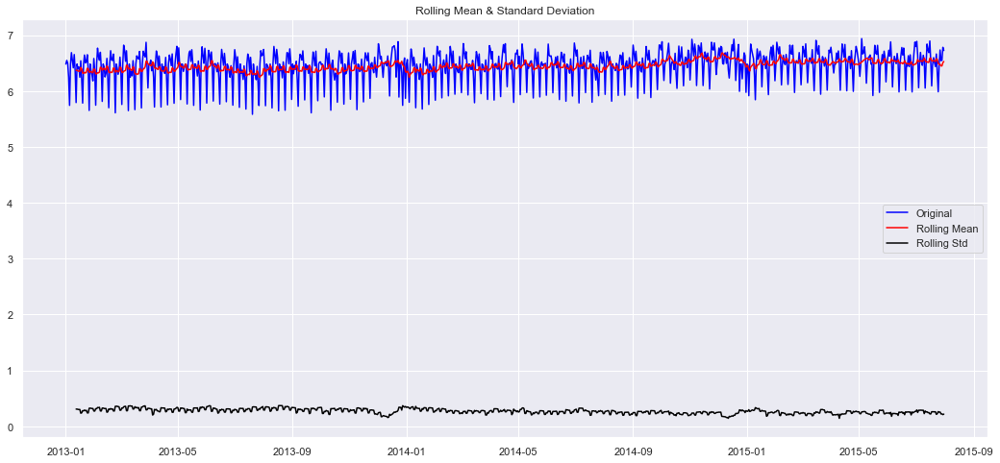

Results of Dickey Fuller Test:
Test Statistic                  -3.321760
p-value                          0.013933
#Lags Used                      18.000000
Number of Observations Used    913.000000
Critical Value (1%)             -3.437533
Critical Value (5%)             -2.864711
Critical Value (10%)            -2.568458
dtype: float64


In [422]:
test_stationarity(new_df['customers_log'])

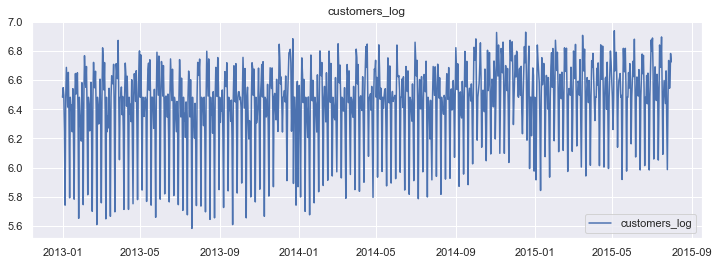

In [423]:
#plot the arima Log series
plt.figure(figsize=(12,4))
plt.plot(new_df['customers_log'],label='customers_log')
plt.legend(loc='best')
plt.title('customers_log')
plt.show()

In [424]:
#Let's check the info
new_df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 932 entries, 2013-01-01 to 2015-07-31
Data columns (total 13 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   store            932 non-null    int64  
 1   day_of_week      932 non-null    int64  
 2   sales            932 non-null    float64
 3   customers        932 non-null    float64
 4   open             932 non-null    int64  
 5   promo            932 non-null    int64  
 6   state_holiday    932 non-null    object 
 7   school_holiday   932 non-null    int64  
 8   promo2           932 non-null    int64  
 9   sales_log        932 non-null    float64
 10  ar_forecast_Log  932 non-null    float64
 11  arima_forecast   932 non-null    float64
 12  customers_log    932 non-null    float64
dtypes: float64(6), int64(6), object(1)
memory usage: 141.9+ KB


**Log transformation has made mean & variance constant**

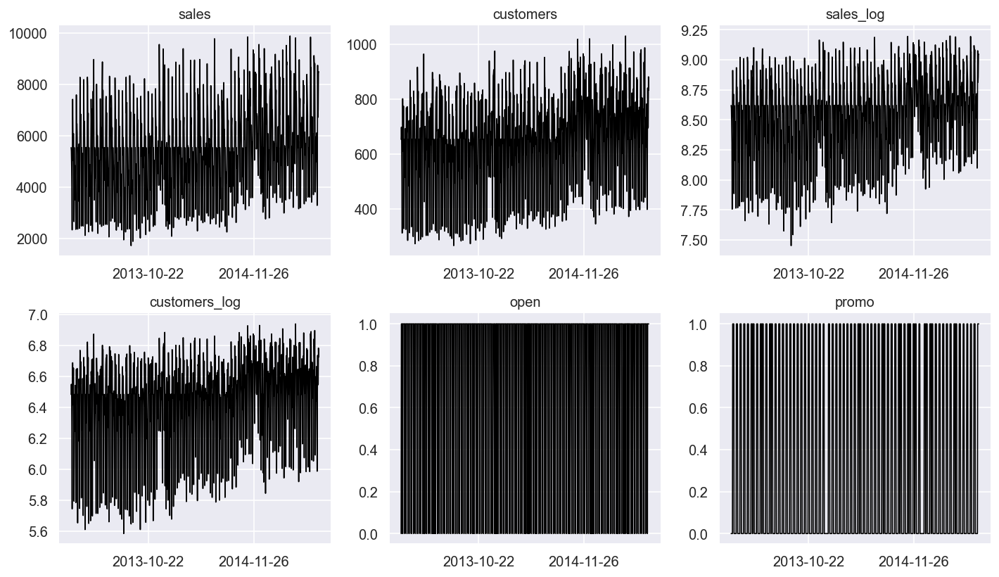

In [425]:
# Plot
ls=['sales','customers','sales_log','customers_log','open','promo','state_holiday','promo2','school_holiday']
df=new_df[ls]
fig, axes = plt.subplots(nrows=2, ncols=3, dpi=120, figsize=(12,7))
for i, ax in enumerate(axes.flatten()):
        ax.plot(df[df.columns[i]], color='black', linewidth=1)
        ax.xaxis.set_major_locator(plt.MaxNLocator(3))
        # Decorations
        ax.set_title(df.columns[i])
        ax.xaxis.set_ticks_position('none')
        ax.yaxis.set_ticks_position('none')
        ax.spines["top"].set_alpha(0)
        ax.tick_params(labelsize=12)

plt.tight_layout();

In [426]:
new_df.columns

Index(['store', 'day_of_week', 'sales', 'customers', 'open', 'promo',
       'state_holiday', 'school_holiday', 'promo2', 'sales_log',
       'ar_forecast_Log', 'arima_forecast', 'customers_log'],
      dtype='object')

In [427]:
new_df1=new_df[['sales_log', 'customers_log']]
new_df1

,sales_log,customers_log
date,,
2013-01-01,8.619634,6.482384
2013-01-02,8.597667,6.548219
2013-01-03,8.485083,6.495266
2013-01-04,8.308692,6.248043
2013-01-05,7.756623,5.743003
...,...,...
2015-07-27,9.075551,6.734592
2015-07-28,8.812397,6.543912
2015-07-29,8.857800,6.548219


In [428]:
#Let's create a model
model = VAR(new_df1)
for i in [1,2,3,4,5]:
    result = model.fit(i)
    print('Lag Order =', i)
    print('AIC : ', result.aic)
    print('BIC : ', result.bic)
    print('FPE : ', result.fpe)
    print('HQIC: ', result.hqic, '\n')

Lag Order = 1
AIC :  -7.670623913206736
BIC :  -7.63945575459915
FPE :  0.0004663268062851129
HQIC:  -7.658736815126191 

Lag Order = 2
AIC :  -7.9456502687325905
BIC :  -7.89365903662348
FPE :  0.00035419956472083707
HQIC:  -7.925820516564174 

Lag Order = 3
AIC :  -7.980185831449519
BIC :  -7.9073359688624425
FPE :  0.00034217602476262156
HQIC:  -7.952399039393203 

Lag Order = 4
AIC :  -8.046688676838073
BIC :  -7.952944526848686
FPE :  0.000320160712871602
HQIC:  -8.010930417620267 

Lag Order = 5
AIC :  -8.2978852842325
BIC :  -8.183211089580452
FPE :  0.00024904348050619745
HQIC:  -8.254141088942776 



In [429]:
x = model.select_order(maxlags=5)
x.summary()

,AIC,BIC,FPE,HQIC
0,-7.299,-7.289,0.0006762,-7.295
1,-7.672,-7.641,0.0004657,-7.660
2,-7.946,-7.894,0.0003539,-7.926
3,-7.982,-7.909,0.0003416,-7.954
4,-8.050,-7.956,0.0003190,-8.014
5,-8.298*,-8.183*,0.0002490*,-8.254*


In [430]:
#Let's fit the model
model_fitted = model.fit()
model_fitted.summary()

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Mon, 17, Jan, 2022
Time:                     16:03:01
--------------------------------------------------------------------
No. of Equations:         2.00000    BIC:                   -7.63946
Nobs:                     931.000    HQIC:                  -7.65874
Log likelihood:           934.612    FPE:                0.000466327
AIC:                     -7.67062    Det(Omega_mle):     0.000463336
--------------------------------------------------------------------
Results for equation sales_log
                      coefficient       std. error           t-stat            prob
-----------------------------------------------------------------------------------
const                    5.579380         0.259932           21.465           0.000
L1.sales_log             1.261260         0.104096           12.116           0.000
L1.customers_log        -1.211956         0.

In [431]:
# Get the lag order
lag_order = model_fitted.k_ar
print(lag_order)  #> 4

1


In [432]:
# Input data for forecasting
forecast_input = new_df1.values[-lag_order:]
forecast_input

array([[9.04687982, 6.72503364]])

In [433]:
# Forecast
fc = model_fitted.forecast(y=forecast_input, steps=182)
df_forecast = pd.DataFrame(fc, index=new_df.index[-182:], columns=new_df1.columns + '_2d')
df_forecast

,sales_log_2d,customers_log_2d
date,,
2015-01-25,8.839402,6.613398
2015-01-26,8.713015,6.539612
2015-01-27,8.643034,6.498185
2015-01-28,8.604977,6.475595
2015-01-29,8.584357,6.463347
...,...,...
2015-07-27,8.560014,6.448888
2015-07-28,8.560014,6.448888
2015-07-29,8.560014,6.448888


In [434]:
df_forecast['VAR_forecast_Sales'] = np.exp(df_forecast['sales_log_2d'])
df_forecast['VAR_forecast_customers'] = np.exp(df_forecast['customers_log_2d'])
df_forecast

,sales_log_2d,customers_log_2d,VAR_forecast_Sales,VAR_forecast_customers
date,,,,
2015-01-25,8.839402,6.613398,6900.861327,745.010292
2015-01-26,8.713015,6.539612,6081.550115,692.018029
2015-01-27,8.643034,6.498185,5670.507759,663.935662
2015-01-28,8.604977,6.475595,5458.761377,649.105123
2015-01-29,8.584357,6.463347,5347.350627,641.203795
...,...,...,...,...
2015-07-27,8.560014,6.448888,5218.754717,631.998905
2015-07-28,8.560014,6.448888,5218.754717,631.998905
2015-07-29,8.560014,6.448888,5218.754717,631.998905


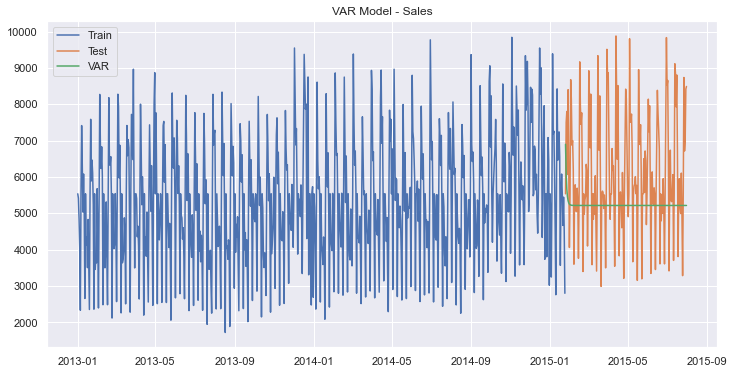

In [435]:
plt.figure(figsize=(12,6)) 
plt.plot(train['sales'], label='Train')
plt.plot(test['sales'], label='Test')
plt.plot(df_forecast['VAR_forecast_Sales'], label='VAR')
plt.legend(loc='best')
plt.title('VAR Model - Sales')
plt.show()

In [436]:
train_len = 750
train1 = new_df[0:train_len] # first 890days as training set
test1 = new_df[train_len:] # last 42 days as out-of-time test set

In [437]:
train1

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast,customers_log
date,,,,,,,,,,,,,
2013-01-01,8,2,5539.358418,653.527132,0,0,a,1,0,8.619634,8.559607,5216.632418,6.482384
2013-01-02,8,3,5419.000000,698.000000,1,0,0,1,0,8.597667,8.577567,5311.169383,6.548219
2013-01-03,8,4,4842.000000,662.000000,1,0,0,1,0,8.485083,8.563835,5238.734820,6.495266
2013-01-04,8,5,4059.000000,517.000000,1,0,0,1,0,8.308692,8.531760,5073.367276,6.248043
2013-01-05,8,6,2337.000000,312.000000,1,0,0,0,0,7.756623,8.483130,4832.552761,5.743003
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2015-01-20,8,2,5540.000000,727.000000,1,0,0,0,0,8.619750,8.548321,5158.086989,6.588926
2015-01-21,8,3,4670.000000,603.000000,1,0,0,0,0,8.448914,8.600951,5436.824916,6.401917
2015-01-22,8,4,5447.000000,748.000000,1,0,0,0,0,8.602820,8.487665,4854.517546,6.617403


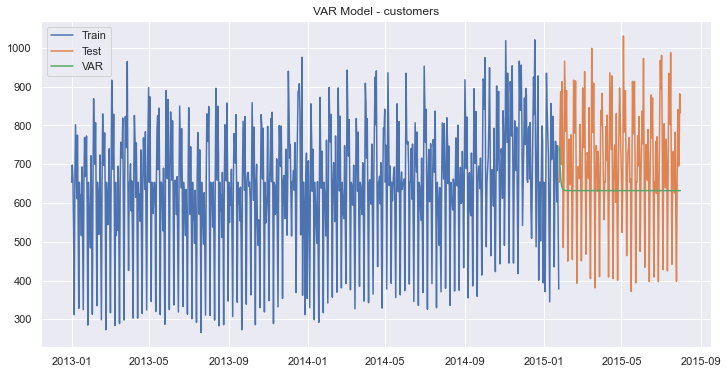

In [438]:
plt.figure(figsize=(12,6)) 
plt.plot(train1['customers'], label='Train')
plt.plot(test1['customers'], label='Test')
plt.plot(df_forecast['VAR_forecast_customers'], label='VAR')
plt.legend(loc='best')
plt.title('VAR Model - customers')
plt.show()

In [439]:
# Let's calculate the rmse and MAPE
rmse = np.sqrt(mean_squared_error(test['sales'], df_forecast['VAR_forecast_Sales'])).round(2)
mape = np.round(np.mean(np.abs(test['sales']-df_forecast['VAR_forecast_Sales'])/test['sales'])*100,2)
tempResults = pd.DataFrame({'Method':['VAR'], 'RMSE': [rmse],'MAPE': [mape] })

In [440]:
tempResults

,Method,RMSE,MAPE
0,VAR,1818.08,21.56


In [441]:
results = pd.concat([Results , tempResults])
results = results[['Method', 'RMSE', 'MAPE']]
results

,Method,RMSE,MAPE
0,ARIMA,1609.49,20.64
0,VAR,1818.08,21.56


**Johansen-Impulse**


In [442]:
joh_model1 = coint_johansen(new_df[['sales','customers']],-1,1)

In [443]:
joh_model1

In [444]:
joh_model1.lr2

array([182.6381396 ,  13.05792544])

In [445]:
joh_model1.lr1

array([195.69606504,  13.05792544])

In [446]:
new_df[['sales','customers']].shape

(932, 2)

In [447]:
def joh_output(res):
    output = pd.DataFrame([res.lr2,res.lr1],
                          index=['max_eig_stat',"trace_stat"])
    print(output.T,'\n')
    print("Critical values(90%, 95%, 99%) of max_eig_stat\n",res.cvm,'\n')
    print("Critical values(90%, 95%, 99%) of trace_stat\n",res.cvt,'\n')

In [448]:
joh_output(joh_model1)

   max_eig_stat  trace_stat
0    182.638140  195.696065
1     13.057925   13.057925 

Critical values(90%, 95%, 99%) of max_eig_stat
 [[ 9.4748 11.2246 15.0923]
 [ 2.9762  4.1296  6.9406]] 

Critical values(90%, 95%, 99%) of trace_stat
 [[10.4741 12.3212 16.364 ]
 [ 2.9762  4.1296  6.9406]] 



In [449]:
from statsmodels.tsa.vector_ar.vecm import select_coint_rank

In [450]:
rank=select_coint_rank(new_df[['sales','customers']],-1,1)
print(rank.rank)

2


**Rank is two**

In [451]:
from statsmodels.tsa.stattools import coint

In [452]:
coint(new_df['sales'],new_df['customers'])#null hypothesis-There is not coint

(-6.106373153627985,
 9.537625899035902e-07,
 array([-3.90824227, -3.34270081, -3.04900867]))

9.537625899035902e-07<.05

We can reject the null hypothesis

**Sales and customers are cointegration to each other**

**VARMAX MODEL**

In [453]:
#create dymmy variables
new_df=pd.get_dummies(new_df)
new_df.head()

,store,day_of_week,sales,customers,open,promo,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast,customers_log,state_holiday_0,state_holiday_0,state_holiday_a,state_holiday_b,state_holiday_c
date,,,,,,,,,,,,,,,,,
2013-01-01,8,2,5539.358418,653.527132,0,0,1,0,8.619634,8.559607,5216.632418,6.482384,0,0,1,0,0
2013-01-02,8,3,5419.000000,698.000000,1,0,1,0,8.597667,8.577567,5311.169383,6.548219,0,1,0,0,0
2013-01-03,8,4,4842.000000,662.000000,1,0,1,0,8.485083,8.563835,5238.734820,6.495266,0,1,0,0,0
2013-01-04,8,5,4059.000000,517.000000,1,0,1,0,8.308692,8.531760,5073.367276,6.248043,0,1,0,0,0
2013-01-05,8,6,2337.000000,312.000000,1,0,0,0,7.756623,8.483130,4832.552761,5.743003,0,1,0,0,0


In [454]:
exog = new_df[['open','promo','school_holiday','promo2','state_holiday_0','state_holiday_a','state_holiday_b','state_holiday_c']]
mod = sm.tsa.VARMAX(new_df[['sales_log', 'customers_log']], order=(1,1), trend='n', exog=exog)
res = mod.fit(maxiter=1000, disp=False)
print(res.summary())

                                 Statespace Model Results                                 
Dep. Variable:     ['sales_log', 'customers_log']   No. Observations:                  932
Model:                                VARMAX(1,1)   Log Likelihood                1288.429
Date:                            Mon, 17 Jan 2022   AIC                          -2518.857
Time:                                    16:08:34   BIC                          -2378.575
Sample:                                         0   HQIC                         -2465.358
                                            - 932                                         
Covariance Type:                              opg                                         
Ljung-Box (L1) (Q):             2.83, 0.00   Jarque-Bera (JB):           0.92, 7.49
Prob(Q):                        0.09, 0.99   Prob(JB):                   0.63, 0.02
Heteroskedasticity (H):         0.93, 0.97   Skew:                      -0.06, 0.05
Prob(H) (two-sided):

In [455]:
train_len = 750
train = new_df[0:train_len] # first 7500days as training set
test = new_df[train_len:] 

start_index = test.index.min()
end_index = test.index.max()

In [456]:
print(start_index)
print(end_index)

2015-01-25 00:00:00
2015-07-31 00:00:00


In [457]:
test.head()

,store,day_of_week,sales,customers,open,promo,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast,customers_log,state_holiday_0,state_holiday_0,state_holiday_a,state_holiday_b,state_holiday_c
date,,,,,,,,,,,,,,,,,
2015-01-25,8,7,5539.358418,653.527132,0,0,0,0,8.619634,8.391406,4409.013724,6.482384,0,1,0,0,0
2015-01-26,8,1,7502.000000,807.000000,1,1,0,0,8.922925,8.663787,5789.418778,6.693324,0,1,0,0,0
2015-01-27,8,2,7804.000000,887.000000,1,1,0,0,8.962392,8.631952,5608.014190,6.787845,0,1,0,0,0
2015-01-28,8,3,6071.000000,700.000000,1,1,0,0,8.711279,8.679639,5881.922498,6.551080,0,1,0,0,0
2015-01-29,8,4,8403.000000,913.000000,1,1,0,0,9.036344,8.548947,5161.317150,6.816736,0,1,0,0,0


In [458]:
predictions = mod.fit().predict(start=start_index, end=end_index, exog=test[['open','promo','school_holiday','promo2','state_holiday_0','state_holiday_a','state_holiday_b','state_holiday_c']])

In [459]:
predictions

,sales_log,customers_log
date,,
2015-01-25,8.517486,6.397174
2015-01-26,8.740471,6.567717
2015-01-27,8.871478,6.658687
2015-01-28,8.866606,6.666859
2015-01-29,8.777877,6.604643
...,...,...
2015-07-27,8.797973,6.624733
2015-07-28,9.011474,6.759969
2015-07-29,8.907404,6.701917


In [460]:
predictions['VARMAX_forecast_Sales'] = np.exp(predictions['sales_log'])
predictions['VARMAX_forecast_customers'] = np.exp(predictions['customers_log'])
predictions

,sales_log,customers_log,VARMAX_forecast_Sales,VARMAX_forecast_customers
date,,,,
2015-01-25,8.517486,6.397174,5001.462414,600.146568
2015-01-26,8.740471,6.567717,6250.837447,711.743249
2015-01-27,8.871478,6.658687,7125.802172,779.526914
2015-01-28,8.866606,6.666859,7091.170072,785.923166
2015-01-29,8.777877,6.604643,6489.083679,738.516073
...,...,...,...,...
2015-07-27,8.797973,6.624733,6620.809266,753.503250
2015-07-28,9.011474,6.759969,8196.594099,862.615341
2015-07-29,8.907404,6.701917,7386.459042,813.965049


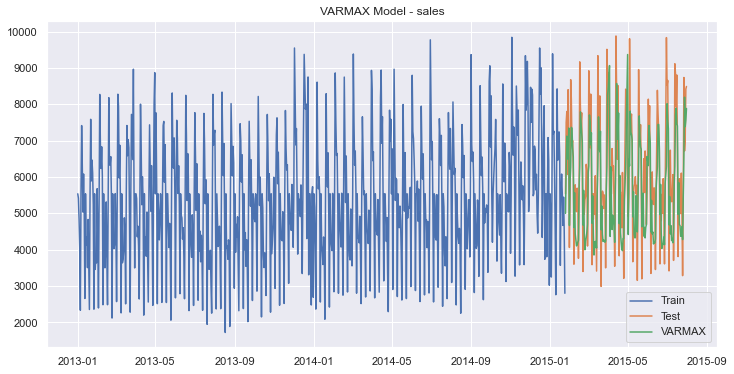

In [461]:
plt.figure(figsize=(12,6)) 
plt.plot(train['sales'], label='Train')
plt.plot(test['sales'], label='Test')
plt.plot(predictions['VARMAX_forecast_Sales'], label='VARMAX')
plt.legend(loc='best')
plt.title('VARMAX Model - sales')
plt.show()

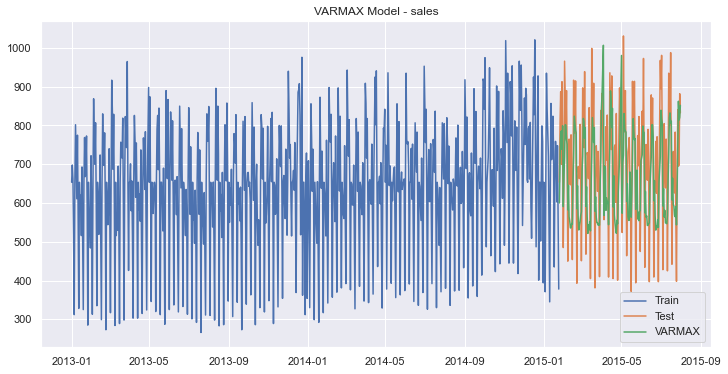

In [462]:
plt.figure(figsize=(12,6)) 
plt.plot(train['customers'], label='Train')
plt.plot(test['customers'], label='Test')
plt.plot(predictions['VARMAX_forecast_customers'], label='VARMAX')
plt.legend(loc='best')
plt.title('VARMAX Model - sales')
plt.show()

In [463]:
# Let's calculate the rmse and MAPE
rmse = np.sqrt(mean_squared_error(test['sales'], predictions['VARMAX_forecast_Sales'])).round(2)
mape = np.round(np.mean(np.abs(test['sales']-predictions['VARMAX_forecast_Sales'])/test['sales'])*100,2)
tempResults = pd.DataFrame({'Method':['VARMAX'], 'RMSE': [rmse],'MAPE': [mape] })

In [464]:
results = pd.concat([results  , tempResults])
results = results[['Method', 'RMSE', 'MAPE']]
results

,Method,RMSE,MAPE
0,ARIMA,1609.49,20.64
0,VAR,1818.08,21.56
0,VARMAX,1300.17,17.15


**VARMAX is the best model**

# Model- Store-9

In [465]:
df_new[df_new['store']==9]

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year,promo2,promo2_since_week,promo2_since_year,promo_interval
8,9,5,2015-07-31,8565,687,1,1,0,1,a,c,2030.0,8.0,2000.0,0,NaN,NaN,NaN
1123,9,4,2015-07-30,7539,651,1,1,0,1,a,c,2030.0,8.0,2000.0,0,NaN,NaN,NaN
2238,9,3,2015-07-29,7776,625,1,1,0,1,a,c,2030.0,8.0,2000.0,0,NaN,NaN,NaN
3353,9,2,2015-07-28,8751,678,1,1,0,1,a,c,2030.0,8.0,2000.0,0,NaN,NaN,NaN
4468,9,1,2015-07-27,10649,777,1,1,0,1,a,c,2030.0,8.0,2000.0,0,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1011643,9,6,2013-01-05,4254,450,1,0,0,0,a,c,2030.0,8.0,2000.0,0,NaN,NaN,NaN
1012758,9,5,2013-01-04,4798,497,1,0,0,1,a,c,2030.0,8.0,2000.0,0,NaN,NaN,NaN
1013873,9,4,2013-01-03,4602,453,1,0,0,1,a,c,2030.0,8.0,2000.0,0,NaN,NaN,NaN
1014988,9,3,2013-01-02,4903,481,1,0,0,1,a,c,2030.0,8.0,2000.0,0,NaN,NaN,NaN


In [466]:
# transform datatype of the variable data to datetime
df_new_store9['date'] = pd.to_datetime( df_new_store9['date'])

In [467]:
df_new_store9.info()
#Let's check the info

<class 'pandas.core.frame.DataFrame'>
Int64Index: 942 entries, 8 to 1016103
Data columns (total 18 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   store                         942 non-null    int64         
 1   day_of_week                   942 non-null    int64         
 2   date                          942 non-null    datetime64[ns]
 3   sales                         942 non-null    int64         
 4   customers                     942 non-null    int64         
 5   open                          942 non-null    int64         
 6   promo                         942 non-null    int64         
 7   state_holiday                 942 non-null    object        
 8   school_holiday                942 non-null    int64         
 9   store_type                    942 non-null    object        
 10  assortment                    942 non-null    object        
 11  competition_distance        

In [468]:
# Check NAN values
missing_count = df_new_store9.isnull().sum() # the count of missing values
value_count = df_new_store9.isnull().count() # the count of all values

missing_percentage = round(missing_count/value_count *100, 2) # the percentage of missing values
missing_df = pd.DataFrame({'missing values count': missing_count, 'percentage': missing_percentage})
missing_df

,missing values count,percentage
store,0,0.0
day_of_week,0,0.0
date,0,0.0
sales,0,0.0
customers,0,0.0
open,0,0.0
promo,0,0.0
state_holiday,0,0.0
school_holiday,0,0.0
store_type,0,0.0


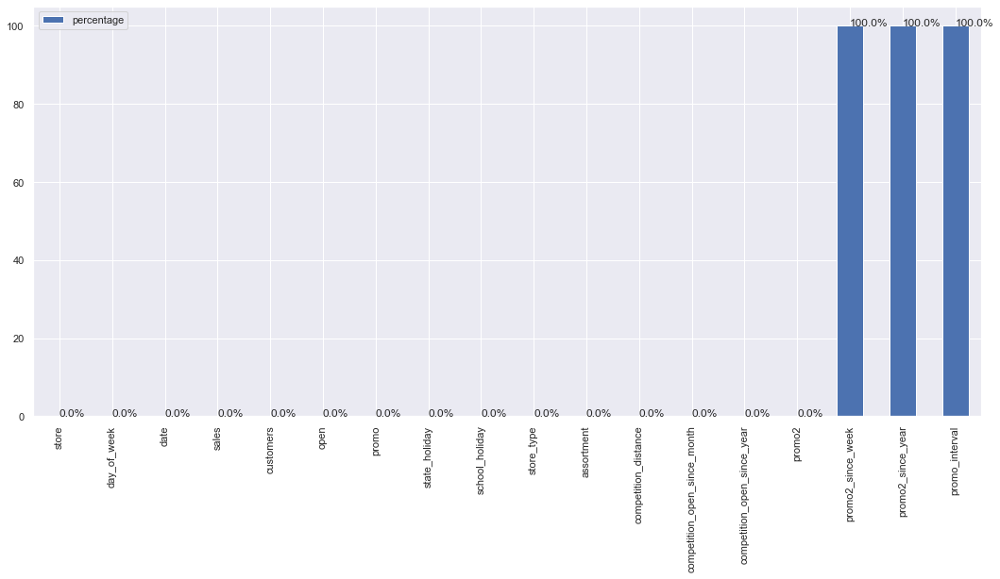

In [469]:
barchart = missing_df.plot.bar(y='percentage')
for index, percentage in enumerate( missing_percentage ):
    barchart.text( index, percentage, str(percentage)+'%')

In [470]:
#Let's drop the promo2_since_year,promo2_since_year,promo_interval
df_new_store9=df_new_store9.drop(['promo2_since_week', 'promo2_since_year','promo_interval'], axis = 1)

In [471]:
df_new_store9.head()

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year,promo2
8,9,5,2015-07-31,8565,687,1,1,0,1,a,c,2030.0,8.0,2000.0,0
1123,9,4,2015-07-30,7539,651,1,1,0,1,a,c,2030.0,8.0,2000.0,0
2238,9,3,2015-07-29,7776,625,1,1,0,1,a,c,2030.0,8.0,2000.0,0
3353,9,2,2015-07-28,8751,678,1,1,0,1,a,c,2030.0,8.0,2000.0,0
4468,9,1,2015-07-27,10649,777,1,1,0,1,a,c,2030.0,8.0,2000.0,0


In [472]:
df_new_store9.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 942 entries, 8 to 1016103
Data columns (total 15 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   store                         942 non-null    int64         
 1   day_of_week                   942 non-null    int64         
 2   date                          942 non-null    datetime64[ns]
 3   sales                         942 non-null    int64         
 4   customers                     942 non-null    int64         
 5   open                          942 non-null    int64         
 6   promo                         942 non-null    int64         
 7   state_holiday                 942 non-null    object        
 8   school_holiday                942 non-null    int64         
 9   store_type                    942 non-null    object        
 10  assortment                    942 non-null    object        
 11  competition_distance        

In [473]:
df_new_store9 = df_new_store9.astype({'competition_open_since_month':'int64', 'competition_open_since_year':'int64',})
df_new_store9.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 942 entries, 8 to 1016103
Data columns (total 15 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   store                         942 non-null    int64         
 1   day_of_week                   942 non-null    int64         
 2   date                          942 non-null    datetime64[ns]
 3   sales                         942 non-null    int64         
 4   customers                     942 non-null    int64         
 5   open                          942 non-null    int64         
 6   promo                         942 non-null    int64         
 7   state_holiday                 942 non-null    object        
 8   school_holiday                942 non-null    int64         
 9   store_type                    942 non-null    object        
 10  assortment                    942 non-null    object        
 11  competition_distance        

In [474]:
# Let's copy the dataset
df_store9 = df_new_store9.copy()

In [475]:
df_store9.head()

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year,promo2
8,9,5,2015-07-31,8565,687,1,1,0,1,a,c,2030.0,8,2000,0
1123,9,4,2015-07-30,7539,651,1,1,0,1,a,c,2030.0,8,2000,0
2238,9,3,2015-07-29,7776,625,1,1,0,1,a,c,2030.0,8,2000,0
3353,9,2,2015-07-28,8751,678,1,1,0,1,a,c,2030.0,8,2000,0
4468,9,1,2015-07-27,10649,777,1,1,0,1,a,c,2030.0,8,2000,0


**Descriptive Statistics**

In [476]:
df_store9.describe().T

,count,mean,std,min,25%,50%,75%,max
store,942.0,9.000000,0.000000,9.0,9.0,9.0,9.00,9.0
day_of_week,942.0,3.997877,1.998404,1.0,2.0,4.0,6.00,7.0
sales,942.0,5426.816348,2891.687966,0.0,4765.5,5904.5,7086.75,13457.0
customers,942.0,479.487261,238.656876,0.0,460.5,539.0,620.75,1019.0
open,942.0,0.826964,0.378479,0.0,1.0,1.0,1.00,1.0
promo,942.0,0.382166,0.486175,0.0,0.0,0.0,1.00,1.0
school_holiday,942.0,0.180467,0.384780,0.0,0.0,0.0,0.00,1.0
competition_distance,942.0,2030.000000,0.000000,2030.0,2030.0,2030.0,2030.00,2030.0
competition_open_since_month,942.0,8.000000,0.000000,8.0,8.0,8.0,8.00,8.0
competition_open_since_year,942.0,2000.000000,0.000000,2000.0,2000.0,2000.0,2000.00,2000.0


In [477]:
# separate numerical and categorical attributes
num_attributes = df_store9.select_dtypes( include = 'number')
cate_attributes = df_store9.select_dtypes( include = 'object')

**Numerical Attributes**

In [478]:
# Central Tendency - Mean, median
ct1 = pd.DataFrame( num_attributes.apply( np.mean ) ).T
ct2 = pd.DataFrame( num_attributes.apply( np.median ) ).T

# Dispersion - std, min, max, range, skew, kurtoisis
d1 = pd.DataFrame(num_attributes.apply( np.std )).T
d2 = pd.DataFrame(num_attributes.apply( min )).T
d3 = pd.DataFrame(num_attributes.apply( max )).T
d4 = pd.DataFrame(num_attributes.apply( lambda x: x.max() - x.min() )).T
d5 = pd.DataFrame(num_attributes.apply( lambda x: x.skew() )).T
d6 = pd.DataFrame(num_attributes.apply( lambda x: x.kurtosis() )).T

#concatenate
m = pd.concat( [d2, d3, d4, ct1, ct2, d1, d5, d6] ).T.reset_index()


m.columns = ['attributes', 'min', 'max', 'range', 'mean', 'median', 'std', 'skew', 'kurtosis']
m

,attributes,min,max,range,mean,median,std,skew,kurtosis
0,store,9.0,9.0,0.0,9.000000,9.0,0.000000,0.000000,0.000000
1,day_of_week,1.0,7.0,6.0,3.997877,4.0,1.997343,0.002127,-1.247185
2,sales,0.0,13457.0,13457.0,5426.816348,5904.5,2890.152692,-0.633586,0.008107
3,customers,0.0,1019.0,1019.0,479.487261,539.0,238.530167,-1.093070,0.234164
4,open,0.0,1.0,1.0,0.826964,1.0,0.378278,-1.731453,1.000047
5,promo,0.0,1.0,1.0,0.382166,0.0,0.485917,0.485772,-1.767783
6,school_holiday,0.0,1.0,1.0,0.180467,0.0,0.384576,1.664393,0.771837
7,competition_distance,2030.0,2030.0,0.0,2030.000000,2030.0,0.000000,0.000000,0.000000
8,competition_open_since_month,8.0,8.0,0.0,8.000000,8.0,0.000000,0.000000,0.000000
9,competition_open_since_year,2000.0,2000.0,0.0,2000.000000,2000.0,0.000000,0.000000,0.000000


**Categorical Attributes**


In [479]:
# check unique values of categorical features
cate_attributes.apply( lambda x: x.unique().shape[0])

state_holiday    5
store_type       1
assortment       1
dtype: int64

In [480]:
#Let's check the unique values
print(df_store9['state_holiday'].unique())
print(df_store9['store_type'].unique())
print(df_store9['assortment'].unique())

['0' 'a' 'b' 'c' 0]
['a']
['c']


# Exploratory data analysis(EDA)

Let’s perform EDA to gain insights into the given data.

**Univariate Analysis**

Response Variable (target)

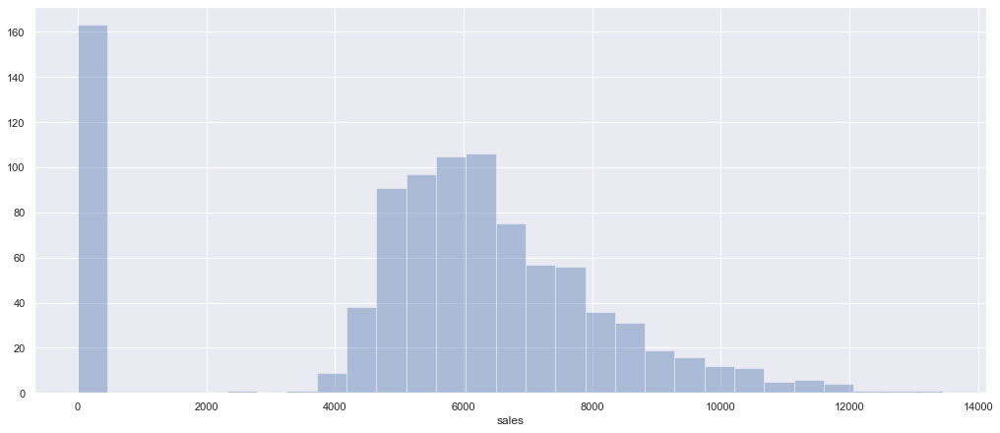

In [481]:
fig = plt.figure( figsize = (14, 6), constrained_layout=True)
sns.distplot(df_store9['sales'], kde = False);
plt.show()

**Numerical Variable**

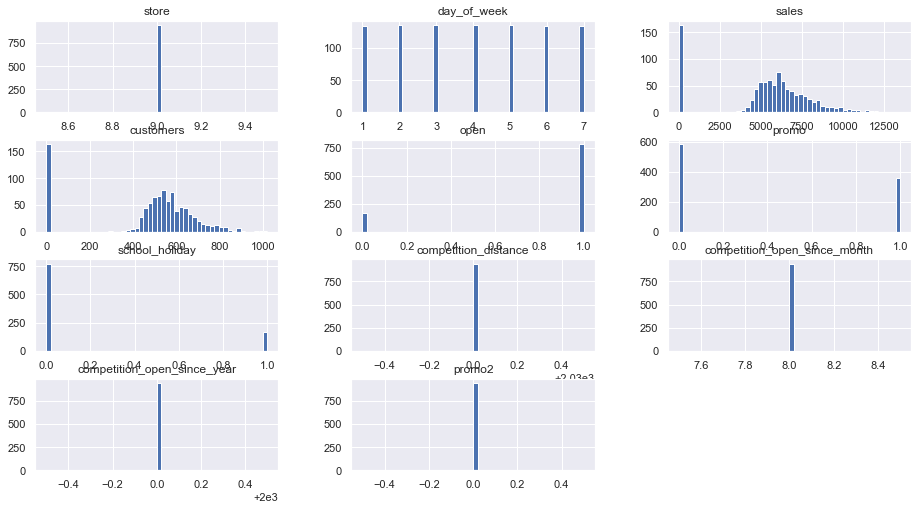

In [482]:
sns.set(rc={'figure.figsize':(15.7,8.27)})
num_attributes.hist(bins = 50);

In [483]:
df_store9['day_of_week'].value_counts()
#day of the week

5    135
4    135
3    135
2    135
7    134
6    134
1    134
Name: day_of_week, dtype: int64

In [484]:
df_store9['open'].value_counts()
# value count of store is open or not

1    779
0    163
Name: open, dtype: int64

In [485]:
df_store9['promo'].value_counts()
# value count of promo

0    582
1    360
Name: promo, dtype: int64

In [486]:
df_store9['state_holiday'].value_counts()
# value count of state_holiday

0    784
0    129
a     19
b      6
c      4
Name: state_holiday, dtype: int64

In [487]:
df_store9['school_holiday'].value_counts()
# value count of state_holiday

0    772
1    170
Name: school_holiday, dtype: int64

In [488]:
df_store9['store_type'].value_counts()
# value count of state_holiday

a    942
Name: store_type, dtype: int64

In [489]:
df_store9['store_type'].value_counts()
# value count of state_holiday

a    942
Name: store_type, dtype: int64

In [490]:
df_store9['assortment'].value_counts()
# value count of assortment

c    942
Name: assortment, dtype: int64

In [491]:
df_store9['competition_distance'].value_counts()
# value count of competition_distance

2030.0    942
Name: competition_distance, dtype: int64

In [492]:
df_store9['competition_open_since_month'].value_counts()
# value count of competition_open_since_month

8    942
Name: competition_open_since_month, dtype: int64

In [493]:
df_store9['competition_open_since_year'].value_counts()
# value count of competition_open_since_year

2000    942
Name: competition_open_since_year, dtype: int64

In [494]:
df_store9['promo2'].value_counts()
# value count of promo2

0    942
Name: promo2, dtype: int64

**Categorical Variable**

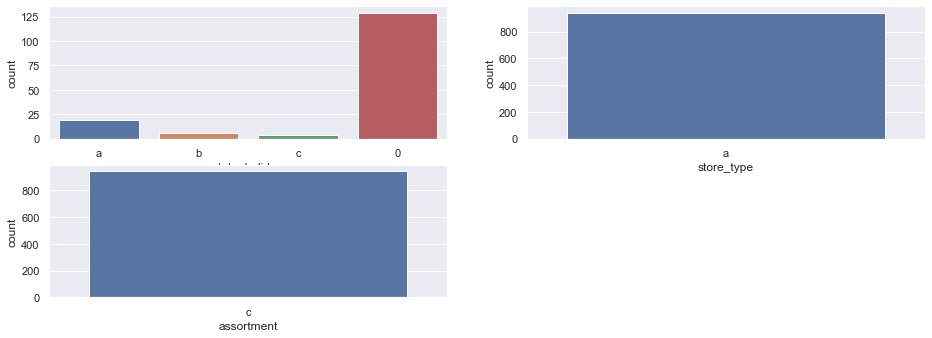

In [495]:
# state_holiday
plt.subplot(3, 2, 1)
a = df_store9[df_store9['state_holiday'] != '0']
sns.countplot(data = a, x = a['state_holiday'])

# store_type
plt.subplot(3, 2, 2)
sns.countplot(data = df_store9, x = df_store9['store_type'])

# assortment
plt.subplot(3, 2, 3)
sns.countplot(data = df_store9, x = df_store9['assortment'])

plt.show()

In [496]:
df_store9[df_store9['sales']==0]

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year,promo2
5583,9,7,2015-07-26,0,0,0,0,0,0,a,c,2030.0,8,2000,0
13388,9,7,2015-07-19,0,0,0,0,0,0,a,c,2030.0,8,2000,0
21193,9,7,2015-07-12,0,0,0,0,0,0,a,c,2030.0,8,2000,0
28998,9,7,2015-07-05,0,0,0,0,0,0,a,c,2030.0,8,2000,0
36803,9,7,2015-06-28,0,0,0,0,0,0,a,c,2030.0,8,2000,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
987113,9,7,2013-01-27,0,0,0,0,0,0,a,c,2030.0,8,2000,0
994918,9,7,2013-01-20,0,0,0,0,0,0,a,c,2030.0,8,2000,0
1002723,9,7,2013-01-13,0,0,0,0,0,0,a,c,2030.0,8,2000,0
1010528,9,7,2013-01-06,0,0,0,0,0,0,a,c,2030.0,8,2000,0


In [497]:
df_store9.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 942 entries, 8 to 1016103
Data columns (total 15 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   store                         942 non-null    int64         
 1   day_of_week                   942 non-null    int64         
 2   date                          942 non-null    datetime64[ns]
 3   sales                         942 non-null    int64         
 4   customers                     942 non-null    int64         
 5   open                          942 non-null    int64         
 6   promo                         942 non-null    int64         
 7   state_holiday                 942 non-null    object        
 8   school_holiday                942 non-null    int64         
 9   store_type                    942 non-null    object        
 10  assortment                    942 non-null    object        
 11  competition_distance        


-    Sale  and customer colomns has zero values which has to be imputed

-    Store is open on 80% of days

-    80% are regular days

-    All the rows of column-store type belongs to 'a'

-    All the rows of column-assortment belongs to 'c'

-    All the rows of columns-competition_distance to 2030

-    All the competition is opened since month-8

-    All the competition is opened since 2000

-    All the rows of promo2 belogs to 0

**Bivariate Analysis**

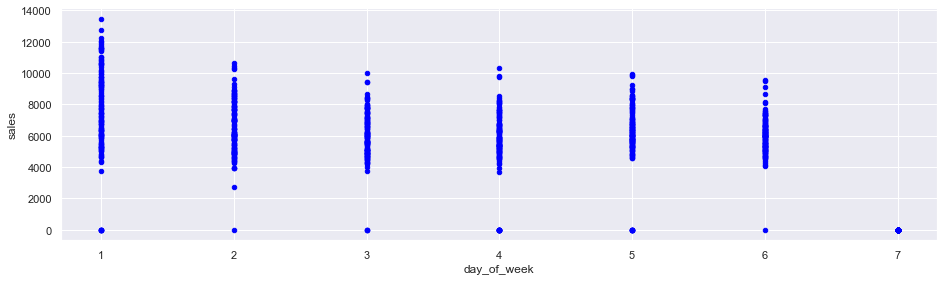

In [498]:
# lets draw a scatter plot between  Sales and day_of_week
sns.set(rc={'figure.figsize':(15.7,4.27)})
df_store9[['sales', 'day_of_week']].plot.scatter(x = 'day_of_week',y='sales',c='blue')
plt.show()

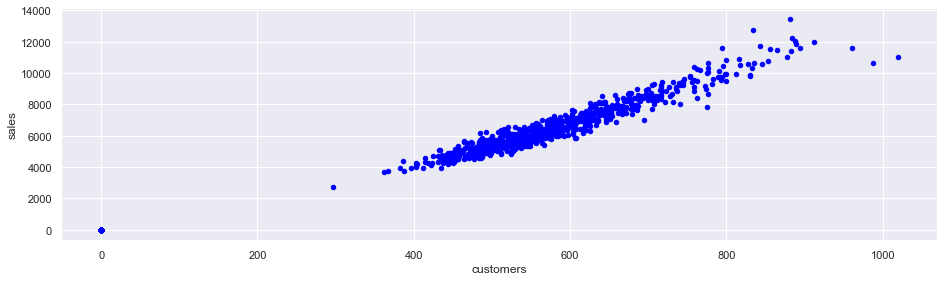

In [499]:
#Let's draw a scatter plot between Sales and Customers
df_store9[['sales', 'customers']].plot.scatter(x = 'customers',y='sales',c='blue')
plt.show()

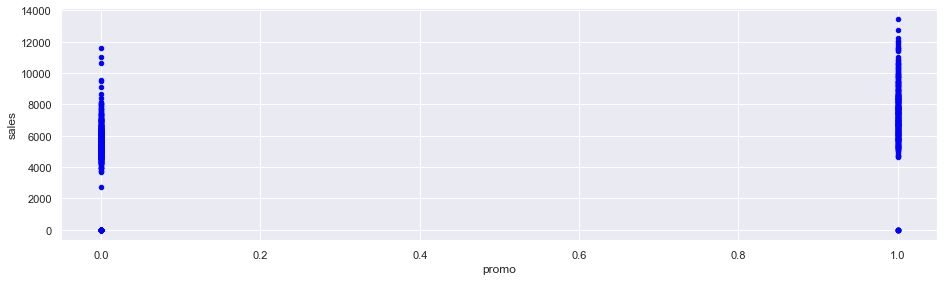

In [500]:
#Let's now draw a scatter plot between Sales and promo
df_store9[['sales', 'promo']].plot.scatter(x = 'promo',y='sales',c='blue')
plt.show()

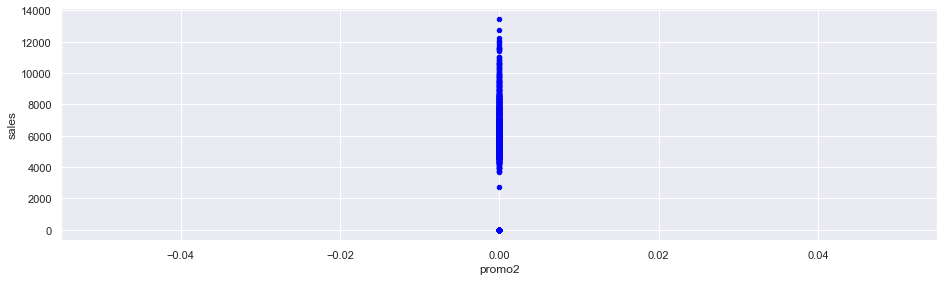

In [501]:
#Let's now draw a scatter plot between Sales and promo
df_store9[['sales', 'promo2']].plot.scatter(x = 'promo2',y='sales',c='blue')
plt.show()

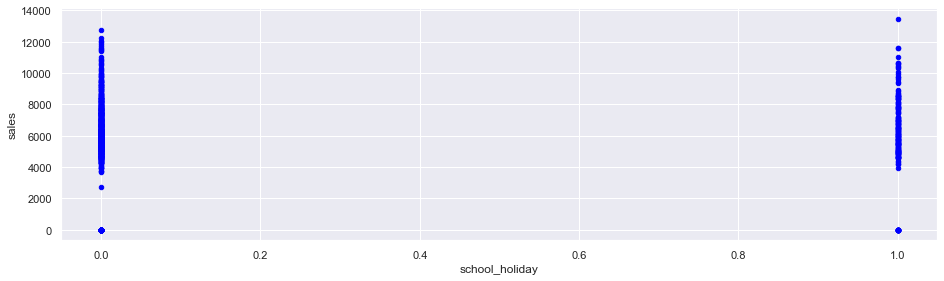

In [502]:
#lets now draw a scatter plot between  Sales and school_holiday
df_store9[['sales', 'school_holiday']].plot.scatter(x = 'school_holiday',y='sales',c='blue')
plt.show()

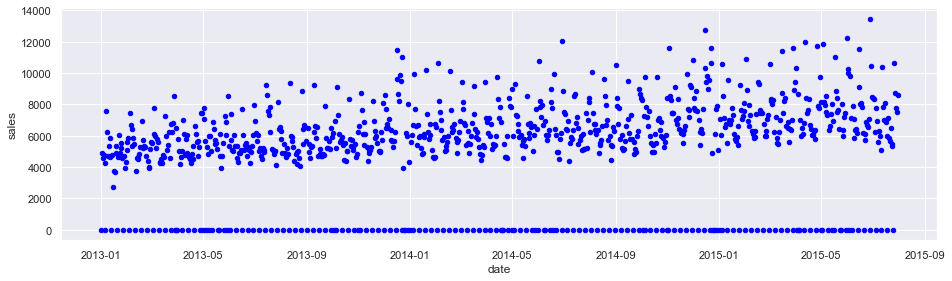

In [503]:
#lets now draw a scatter plot between Sales and date
df_store9[['sales', 'date']].plot.scatter(x = 'date',y='sales',c='blue')
plt.show()

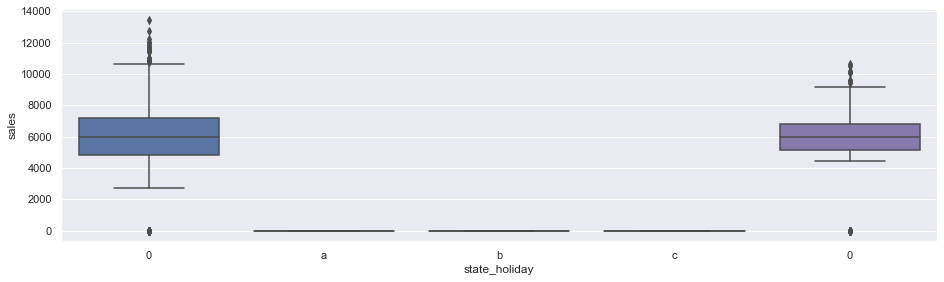

In [504]:
#Let's draw the boxplot between sales and state_holiday
sns.set(rc={'figure.figsize':(15.7,4.27)})
# create grouped boxplot 
sns.boxplot(x = df_store9['state_holiday'],
            y = df_store9['sales'])
plt.show()

**Multivariate Analysis**

**Numerical Attributes**

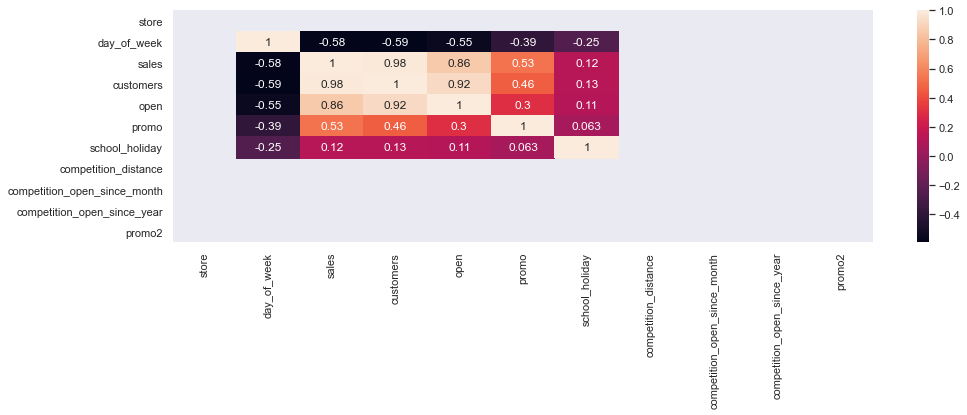

In [505]:
correlation = (num_attributes.corr( method = 'pearson' ))
sns.heatmap( correlation, annot = True );

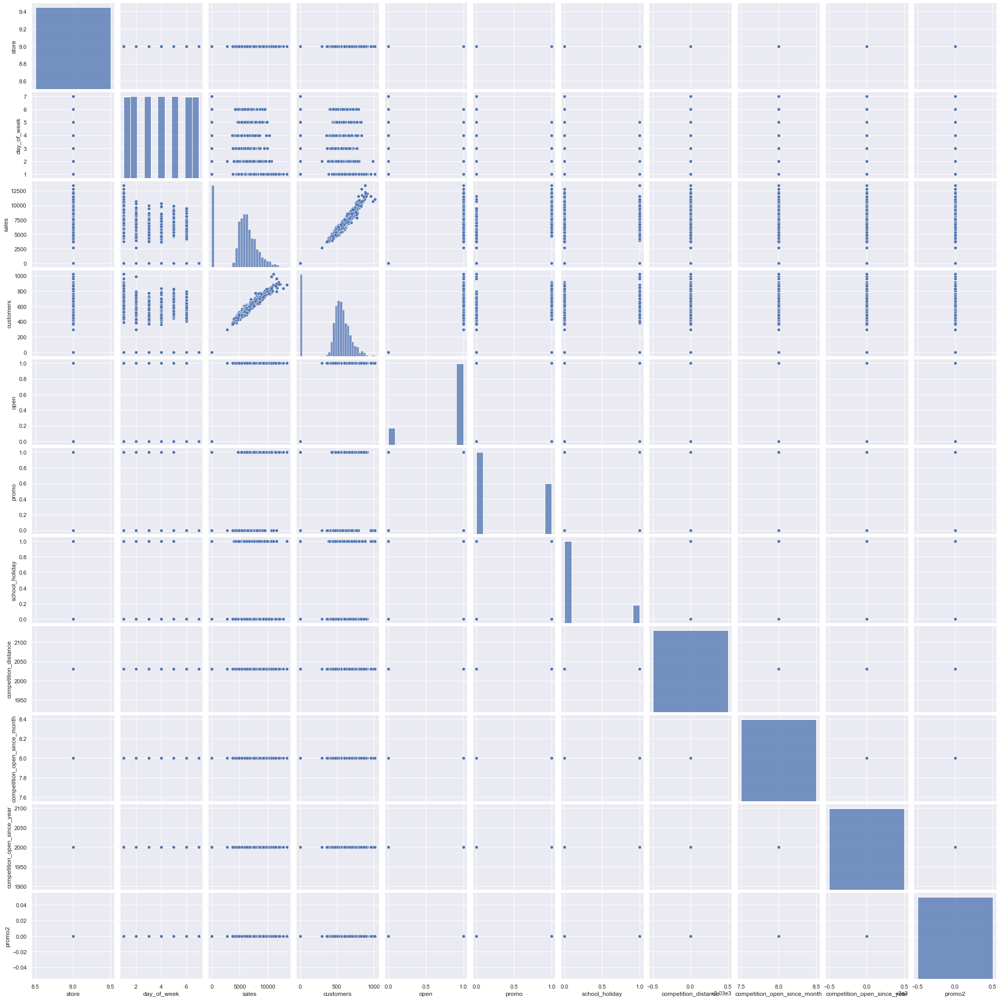

In [506]:
#pairplot with hue sales
sns.pairplot(df_store9)
# to show
plt.show()

**Some insights from EDA**

   - store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year are uncessary  columns so we could remove them

   - Day1,Day2 and Day4 have higher sales than other days

   - promo is correlated to sales

   - Promo2 doesn't have any effect on sales becuase it's value is equal to 0

   - There is no sale on a = public holiday, b = Easter holiday, c = Christmas

   - There is some effect of school holiday on sales

In [507]:
df_store9.columns

Index(['store', 'day_of_week', 'date', 'sales', 'customers', 'open', 'promo',
       'state_holiday', 'school_holiday', 'store_type', 'assortment',
       'competition_distance', 'competition_open_since_month',
       'competition_open_since_year', 'promo2'],
      dtype='object')

In [508]:
# We can drop store_type,assortment,competition_distance,competition_open_since_month,promo2_since_week,promo2_since_year,promo_interval
#competition_open_since_year & promo2
df_store9_new=df_store9.drop(['store_type', 'assortment','competition_distance','competition_open_since_month','competition_open_since_year'], axis = 1)

In [509]:
df_store9_new.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 942 entries, 8 to 1016103
Data columns (total 10 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   store           942 non-null    int64         
 1   day_of_week     942 non-null    int64         
 2   date            942 non-null    datetime64[ns]
 3   sales           942 non-null    int64         
 4   customers       942 non-null    int64         
 5   open            942 non-null    int64         
 6   promo           942 non-null    int64         
 7   state_holiday   942 non-null    object        
 8   school_holiday  942 non-null    int64         
 9   promo2          942 non-null    int64         
dtypes: datetime64[ns](1), int64(8), object(1)
memory usage: 121.0+ KB


In [510]:
df_store9_new.head()

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,promo2
8,9,5,2015-07-31,8565,687,1,1,0,1,0
1123,9,4,2015-07-30,7539,651,1,1,0,1,0
2238,9,3,2015-07-29,7776,625,1,1,0,1,0
3353,9,2,2015-07-28,8751,678,1,1,0,1,0
4468,9,1,2015-07-27,10649,777,1,1,0,1,0


# Model Building

**ARIMA model**

In [511]:
df_store9_new=df_store9_new[::-1].reset_index()
df_store9_new.head()

,index,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,promo2
0,1016103,9,2,2013-01-01,0,0,0,0,a,1,0
1,1014988,9,3,2013-01-02,4903,481,1,0,0,1,0
2,1013873,9,4,2013-01-03,4602,453,1,0,0,1,0
3,1012758,9,5,2013-01-04,4798,497,1,0,0,1,0
4,1011643,9,6,2013-01-05,4254,450,1,0,0,0,0


In [512]:
df_store9_new=df_store9_new.drop(['index'], axis = 1)
df_store9_new.head()
#Let drop the index column

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,promo2
0,9,2,2013-01-01,0,0,0,0,a,1,0
1,9,3,2013-01-02,4903,481,1,0,0,1,0
2,9,4,2013-01-03,4602,453,1,0,0,1,0
3,9,5,2013-01-04,4798,497,1,0,0,1,0
4,9,6,2013-01-05,4254,450,1,0,0,0,0


In [513]:
df_store9_new.info()
#No missing value

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 942 entries, 0 to 941
Data columns (total 10 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   store           942 non-null    int64         
 1   day_of_week     942 non-null    int64         
 2   date            942 non-null    datetime64[ns]
 3   sales           942 non-null    int64         
 4   customers       942 non-null    int64         
 5   open            942 non-null    int64         
 6   promo           942 non-null    int64         
 7   state_holiday   942 non-null    object        
 8   school_holiday  942 non-null    int64         
 9   promo2          942 non-null    int64         
dtypes: datetime64[ns](1), int64(8), object(1)
memory usage: 73.7+ KB


In [514]:
# transform datatype of the variable data to datetime
df_store9_new['date'] = pd.to_datetime(df_store9_new['date'])

In [515]:
indexed_df_store9_new = df_store9_new.set_index(['date'])
indexed_df_store9_new.head()
#Let set the date as index column

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2
date,,,,,,,,,
2013-01-01,9,2,0,0,0,0,a,1,0
2013-01-02,9,3,4903,481,1,0,0,1,0
2013-01-03,9,4,4602,453,1,0,0,1,0
2013-01-04,9,5,4798,497,1,0,0,1,0
2013-01-05,9,6,4254,450,1,0,0,0,0


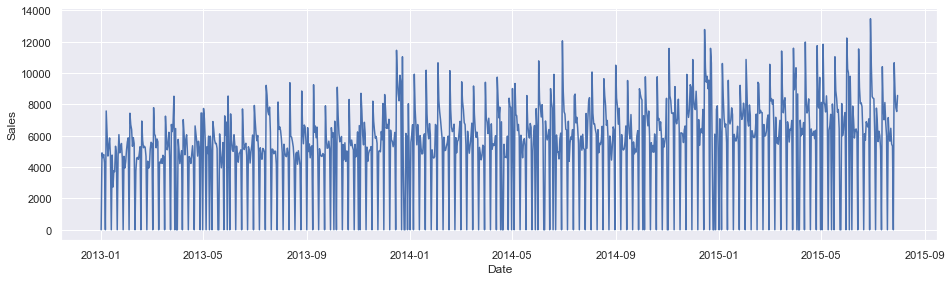

In [516]:
## plot graph
plt.xlabel('Date')
plt.ylabel('Sales')
plt.plot(indexed_df_store9_new['sales'])
plt.show()

In [517]:
#Let impute the zero values
(indexed_df_store9_new['sales']==0).sum()
# There are 163 zero value in sale column

163

In [518]:
indexed_df_store9_new['sales']=indexed_df_store9_new['sales'].replace(0, np.nan)

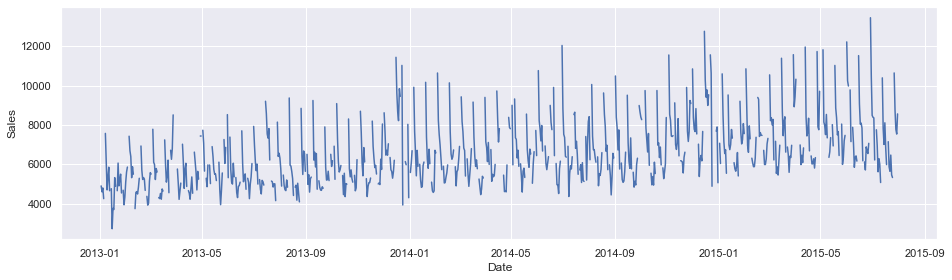

In [519]:
##plot graph
plt.xlabel('Date')
plt.ylabel('Sales')
plt.plot(indexed_df_store9_new['sales'])
plt.show()

In [520]:
#KNN imputer for filling NAN values
imputer = KNNImputer(n_neighbors=2)

In [521]:
indexed_df_store9_new['sales'] = imputer.fit_transform(np.array(indexed_df_store9_new['sales']).reshape(-1, 1))
indexed_df_store9_new['sales'].head()

date
2013-01-01    6562.337612
2013-01-02    4903.000000
2013-01-03    4602.000000
2013-01-04    4798.000000
2013-01-05    4254.000000
Name: sales, dtype: float64

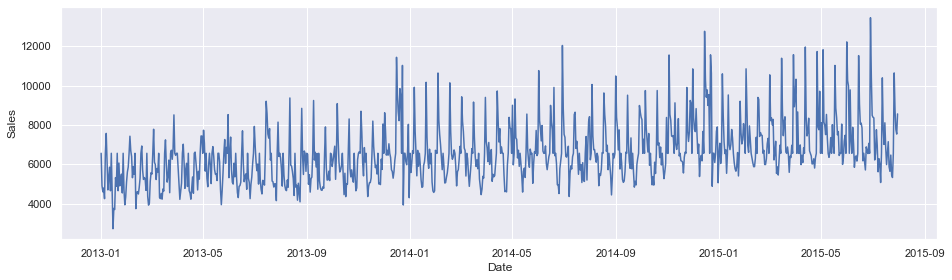

In [522]:
## plot graph
plt.xlabel('Date')
plt.ylabel('Sales')
plt.plot(indexed_df_store9_new['sales'])
plt.show()

In [523]:
(indexed_df_store9_new['sales']==0).sum()
# no missing value

0

**Outlier detection**

Box plot and interquartile range

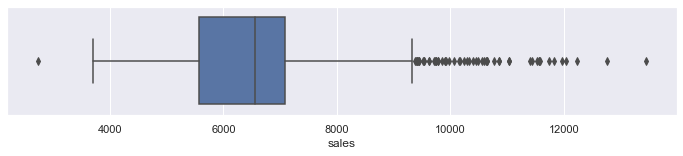

In [524]:
import seaborn as sns
fig = plt.subplots(figsize=(12, 2))
ax = sns.boxplot(x=indexed_df_store9_new['sales'],whis=1.5)
#Let treat the outliers

**Histogram**

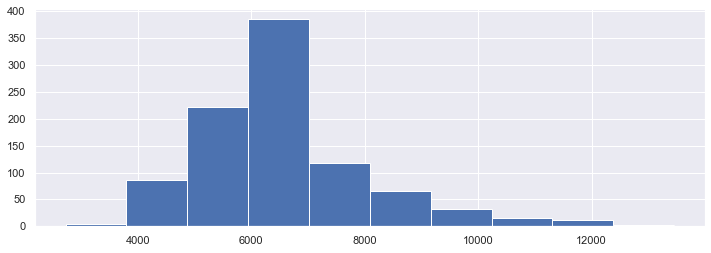

In [525]:
fig = indexed_df_store9_new['sales'].hist(figsize = (12,4))

In [526]:
percentile01 = indexed_df_store9_new['sales'].quantile(0.01)
percentile99 = indexed_df_store9_new['sales'].quantile(0.99)

In [527]:
upper_limit = percentile99
lower_limit = percentile01

In [528]:
upper_limit

11548.880000000001

In [529]:
lower_limit

4117.01

In [530]:
new_df = indexed_df_store9_new[indexed_df_store9_new['sales'] < upper_limit]
new_df.shape

(932, 9)

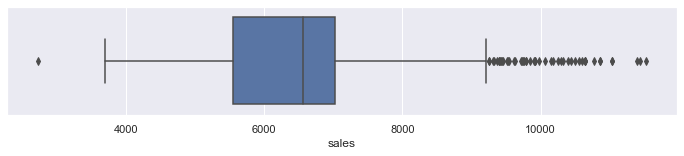

In [531]:
import seaborn as sns
fig = plt.subplots(figsize=(12, 2))
ax = sns.boxplot(x=new_df['sales'],whis=1.5)

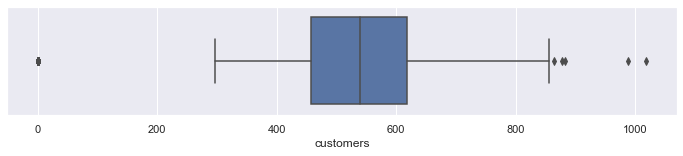

In [532]:
import seaborn as sns
fig = plt.subplots(figsize=(12, 2))
ax = sns.boxplot(x=new_df['customers'],whis=1.5)

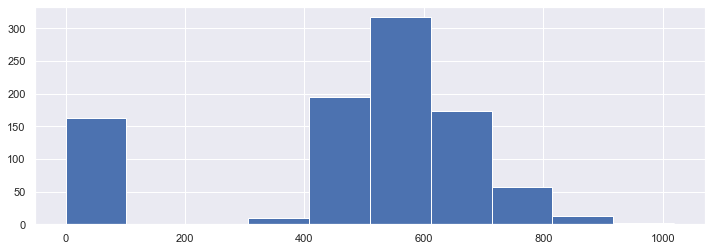

In [533]:
fig = new_df['customers'].hist(figsize = (12,4))

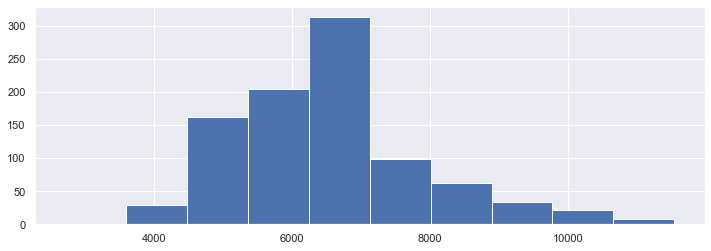

In [534]:
fig = new_df['sales'].hist(figsize = (12,4))

**ADF Stationary**

In [535]:
def test_stationarity(timeseries):
    
    #Determine rolling statistics
    movingAverage = timeseries.rolling(window=12).mean()
    movingSTD = timeseries.rolling(window=12).std()
    
    #Plot rolling statistics
    orig = plt.plot(timeseries, color='blue', label='Original')
    mean = plt.plot(movingAverage, color='red', label='Rolling Mean')
    std = plt.plot(movingSTD, color='black', label='Rolling Std')
    plt.legend(loc='best')
    plt.title('Rolling Mean & Standard Deviation')
    plt.show(block=False)
    
    #Perform Dickey–Fuller test:
    print('Results of Dickey Fuller Test:')
    dftest = adfuller(indexed_df_store9_new['sales'], autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    for key,value in dftest[4].items():
        dfoutput['Critical Value (%s)'%key] = value
    print(dfoutput)

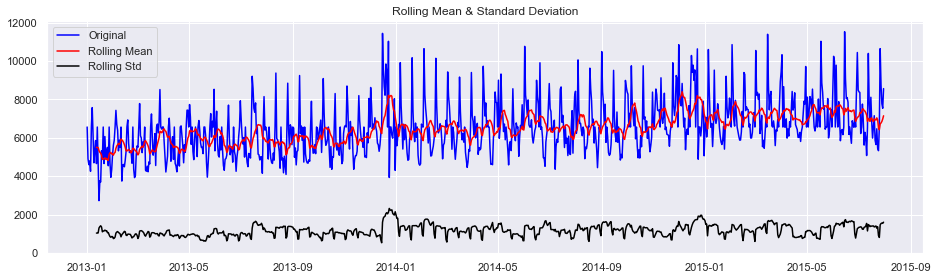

Results of Dickey Fuller Test:
Test Statistic                  -3.165813
p-value                          0.022051
#Lags Used                      22.000000
Number of Observations Used    919.000000
Critical Value (1%)             -3.437486
Critical Value (5%)             -2.864690
Critical Value (10%)            -2.568447
dtype: float64


In [536]:
test_stationarity(new_df['sales'])

- Null: Time Series is not stationary
- Alternate: Time Series is Stationary

**The p-value is less than 0.05 so The series is stationary**

In [537]:
from statsmodels.tsa.stattools import kpss
kpss_test = kpss(new_df['sales'])

print('KPSS Statistic: %f' % kpss_test[0])
print('Critical Values @ 0.05: %.2f' % kpss_test[3]['5%'])
print('p-value: %f' % kpss_test[1])

KPSS Statistic: 3.342234
Critical Values @ 0.05: 0.46
p-value: 0.010000


- Null: Time Series is not stationary
- Alternate: Time Series is Stationary
    
**The p-value is less than 0.05 so The series is non-stationary**

# Let's take the log of sales to Standardize the sales values

In [538]:
new_df.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2
date,,,,,,,,,
2013-01-01,9,2,6562.337612,0,0,0,a,1,0
2013-01-02,9,3,4903.000000,481,1,0,0,1,0
2013-01-03,9,4,4602.000000,453,1,0,0,1,0
2013-01-04,9,5,4798.000000,497,1,0,0,1,0
2013-01-05,9,6,4254.000000,450,1,0,0,0,0


In [539]:
#Log Transformation
new_df['sales_log'] = np.log(new_df['sales'])
new_df

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log
date,,,,,,,,,,
2013-01-01,9,2,6562.337612,0,0,0,a,1,0,8.789102
2013-01-02,9,3,4903.000000,481,1,0,0,1,0,8.497603
2013-01-03,9,4,4602.000000,453,1,0,0,1,0,8.434246
2013-01-04,9,5,4798.000000,497,1,0,0,1,0,8.475954
2013-01-05,9,6,4254.000000,450,1,0,0,0,0,8.355615
...,...,...,...,...,...,...,...,...,...,...
2015-07-27,9,1,10649.000000,777,1,1,0,1,0,9.273221
2015-07-28,9,2,8751.000000,678,1,1,0,1,0,9.076923
2015-07-29,9,3,7776.000000,625,1,1,0,1,0,8.958797


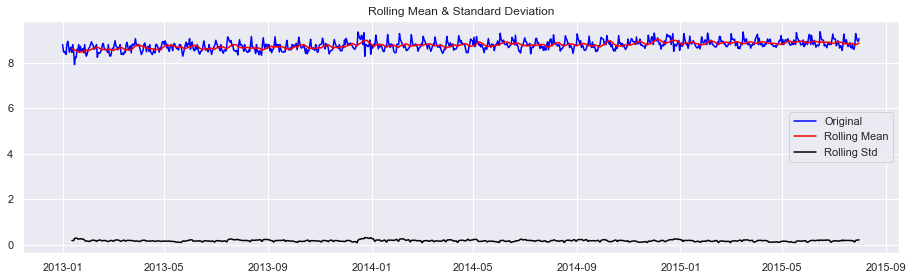

Results of Dickey Fuller Test:
Test Statistic                  -3.165813
p-value                          0.022051
#Lags Used                      22.000000
Number of Observations Used    919.000000
Critical Value (1%)             -3.437486
Critical Value (5%)             -2.864690
Critical Value (10%)            -2.568447
dtype: float64


In [540]:
test_stationarity(new_df['sales_log'])

**Log transformation has made mean & variance constant**

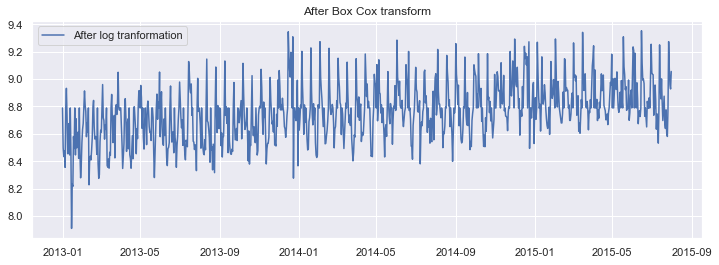

In [541]:
#After Log Transformation
plt.figure(figsize=(12,4))
plt.plot(new_df['sales_log'], label='After log tranformation')
plt.legend(loc='best')
plt.title('After Box Cox transform')
plt.show()

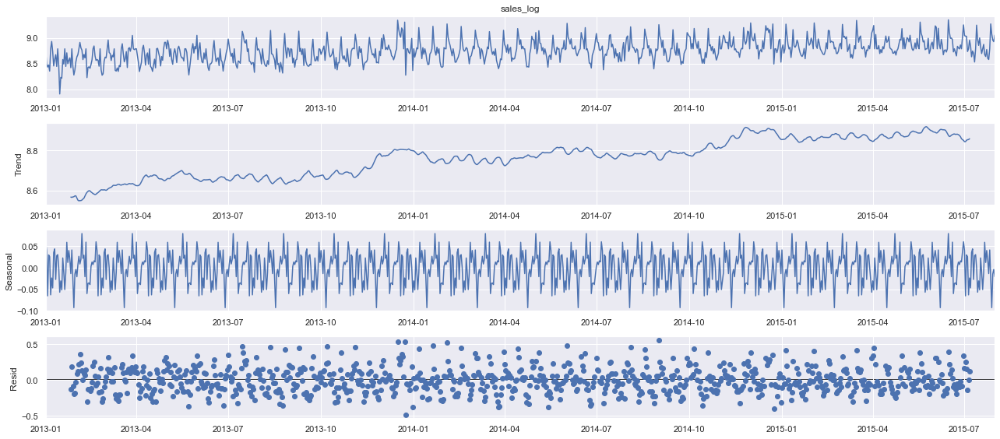

In [542]:
from matplotlib.pyplot import rcParams
rcParams['figure.figsize'] = 18,8
decomposition = sm.tsa.seasonal_decompose(new_df['sales_log'], model = "additive",period=50)
fig = decomposition.plot()

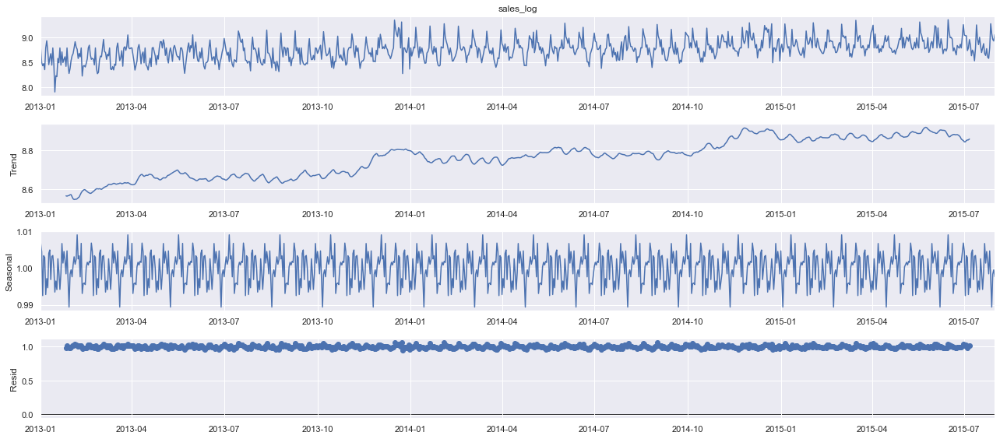

In [543]:
from matplotlib.pyplot import rcParams
rcParams['figure.figsize'] = 18,8
decomposition = sm.tsa.seasonal_decompose(new_df['sales_log'], model = "multiplicative",period=50)
fig = decomposition.plot()

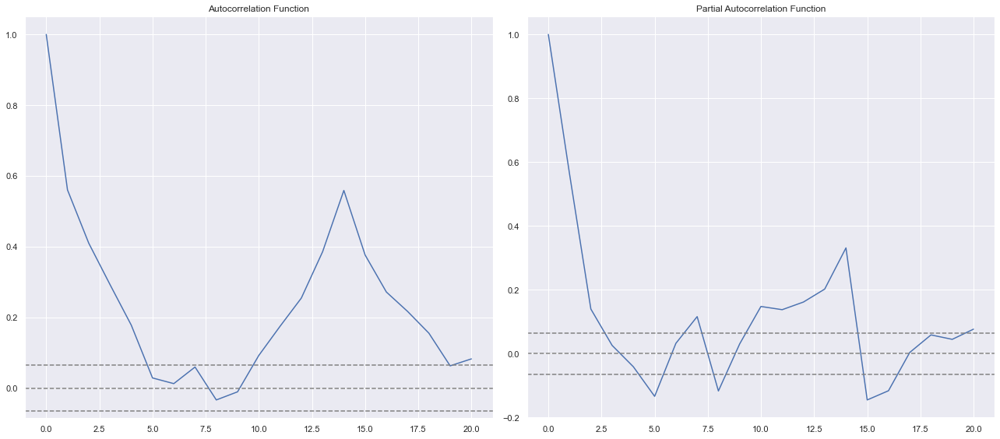

In [544]:
#ACF & PACF plots

lag_acf = acf(new_df['sales_log'], nlags=20) # MA 
lag_pacf = pacf(new_df['sales_log'], nlags=20, method='ols')  # AR 

#Plot ACF:
plt.subplot(121)
plt.plot(lag_acf)
plt.axhline(y=0, linestyle='--', color='gray')
plt.axhline(y=-1.96/np.sqrt(len(new_df['sales_log'])), linestyle='--', color='gray')
plt.axhline(y=1.96/np.sqrt(len(new_df['sales_log'])), linestyle='--', color='gray')
plt.title('Autocorrelation Function')            

#Plot PACF
plt.subplot(122)
plt.plot(lag_pacf)
plt.axhline(y=0, linestyle='--', color='gray')
plt.axhline(y=-1.96/np.sqrt(len(new_df['sales_log'])), linestyle='--', color='gray')
plt.axhline(y=1.96/np.sqrt(len(new_df['sales_log'])), linestyle='--', color='gray')
plt.title('Partial Autocorrelation Function')
            
plt.tight_layout()

From the ACF graph, we see that curve touches y=0.0 line at x=5. Thus, from theory, Q = 5 From the PACF graph, we see that curve touches y=0.0 line at x=3. Thus, from theory, P = 3

**Build and evaluate time series forecast**

Split time series data into training and test set

In [545]:
train_len = 750
train = new_df['sales'][0:train_len] # first 750days as training set
test = new_df['sales'][train_len:] # last 182 days as out-of-time test set

In [546]:
print(train.shape)
print(test.shape)

(750,)
(182,)


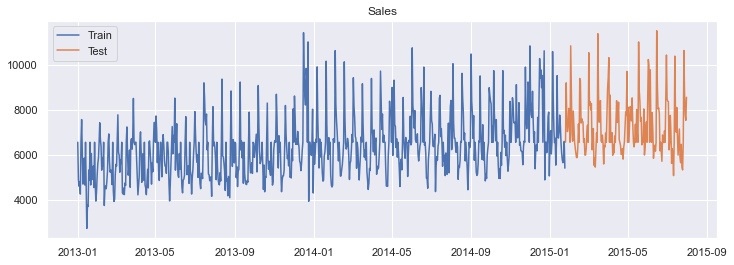

In [547]:
plt.figure(figsize=(12,4))
plt.plot(train, label='Train')
plt.plot(test, label='Test')
plt.legend(loc='best')
plt.title('Sales')
plt.show()

In [548]:
model = ARIMA(new_df['sales_log'], order=(2, 0, 2))
model_fit = model.fit()
print(model_fit.params)

const              8.759312
ar.L1.sales_log    1.363721
ar.L2.sales_log   -0.533534
ma.L1.sales_log   -0.902552
ma.L2.sales_log    0.297125
dtype: float64


In [549]:
new_df['ar_forecast_Log'] = model_fit.predict(new_df.index.min(), new_df.index.max())
new_df['arima_forecast'] = np.exp(new_df['ar_forecast_Log'])
new_df['arima_forecast']

date
2013-01-01    6369.730107
2013-01-02    6476.155308
2013-01-03    5668.328184
2013-01-04    5233.093191
2013-01-05    5233.208657
                 ...     
2015-07-27    6259.660228
2015-07-28    8141.227653
2015-07-29    8192.241171
2015-07-30    7558.457964
2015-07-31    7112.039949
Name: arima_forecast, Length: 932, dtype: float64

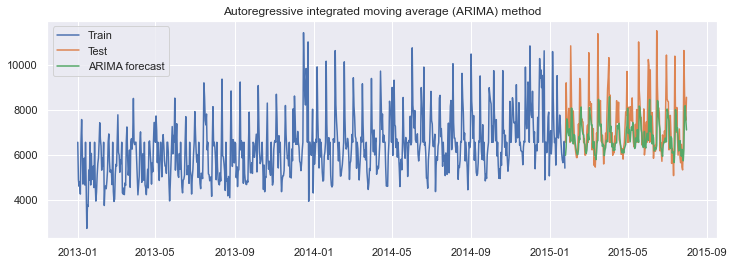

In [550]:
plt.figure(figsize=(12,4))
plt.plot(train, label='Train')
plt.plot(test, label='Test')
plt.plot(new_df['arima_forecast'][test.index.min():], label='ARIMA forecast')
plt.legend(loc='best')
plt.title('Autoregressive integrated moving average (ARIMA) method')
plt.show()

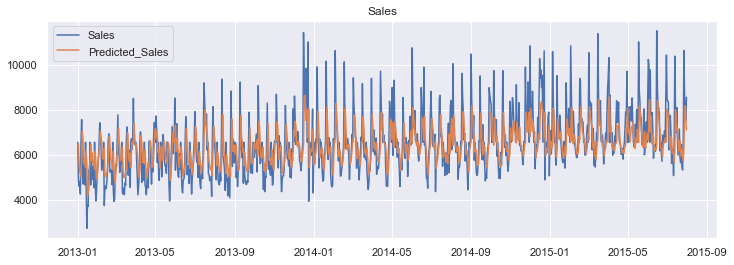

In [551]:
# plot the arima forecasting & Original series
plt.figure(figsize=(12,4))
plt.plot(new_df['sales'], label='Sales')
plt.plot(new_df['arima_forecast'], label='Predicted_Sales')
plt.legend(loc='best')
plt.title('Sales')
plt.show()

**Model Evalution**

In [552]:
from sklearn.metrics import mean_squared_error
rmse = np.sqrt(mean_squared_error(test, new_df['arima_forecast'][test.index.min():])).round(2)
mape = np.round(np.mean(np.abs(test-new_df['arima_forecast'][test.index.min():])/test)*100,2)
Results = pd.DataFrame({'Method':['ARIMA'], 'RMSE': [rmse],'MAPE': [mape] })
Results

,Method,RMSE,MAPE
0,ARIMA,1290.57,10.53


**VAR model**

In [553]:
#Load the dataset
new_df.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast
date,,,,,,,,,,,,
2013-01-01,9,2,6562.337612,0,0,0,a,1,0,8.789102,8.759312,6369.730107
2013-01-02,9,3,4903.000000,481,1,0,0,1,0,8.497603,8.775882,6476.155308
2013-01-03,9,4,4602.000000,453,1,0,0,1,0,8.434246,8.642650,5668.328184
2013-01-04,9,5,4798.000000,497,1,0,0,1,0,8.475954,8.562758,5233.093191
2013-01-05,9,6,4254.000000,450,1,0,0,0,0,8.355615,8.562780,5233.208657


**Split the dataset to training & testing**

In [554]:
#split the dataset
nobs = 182
train, test = new_df[0:-nobs], new_df[-nobs:]

# Check size
print(train.shape)
print(test.shape)  

(750, 12)
(182, 12)


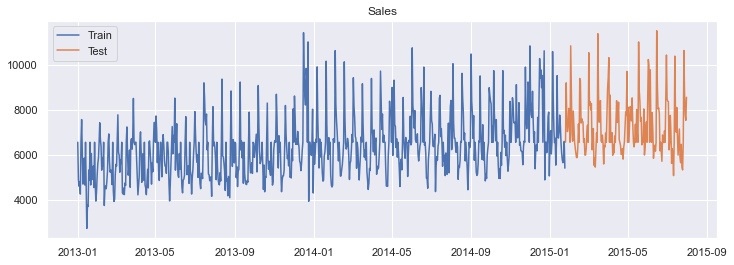

In [555]:
plt.figure(figsize=(12,4))
plt.plot(train['sales'], label='Train')
plt.plot(test['sales'], label='Test')
plt.legend(loc='best')
plt.title('Sales')
plt.show()

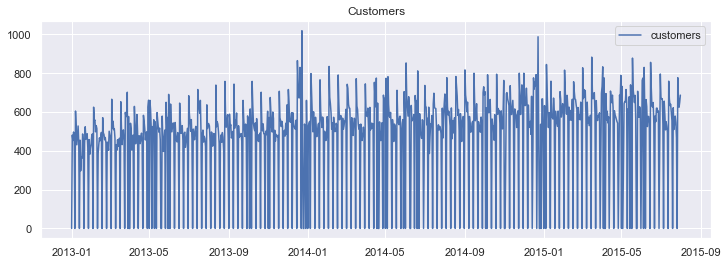

In [556]:
#plot the arima forecasting & Original series
plt.figure(figsize=(12,4))
plt.plot(new_df['customers'],label='customers')
plt.legend(loc='best')
plt.title('Customers')
plt.show()

In [557]:
(new_df['customers']==0).sum()

163

In [558]:
#impute the NAN values
new_df['customers']=new_df['customers'].replace(0, np.nan)

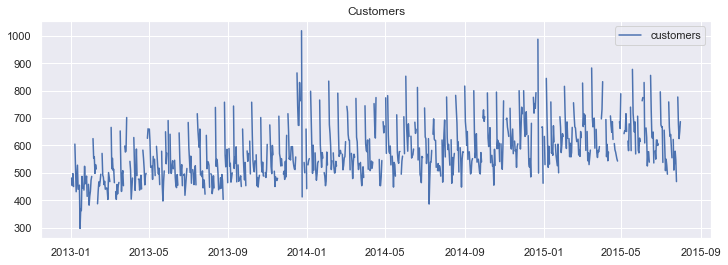

In [559]:
#plot the arima forecasting & Original series
plt.figure(figsize=(12,4))
plt.plot(new_df['customers'],label='customers')
plt.legend(loc='best')
plt.title('Customers')
plt.show()

In [560]:
#KNN imputer for filling NAN values
imputer = KNNImputer(n_neighbors=2)

In [561]:
new_df['customers'] = imputer.fit_transform(np.array(new_df['customers']).reshape(-1, 1))
new_df['customers'].head()

date
2013-01-01    575.936281
2013-01-02    481.000000
2013-01-03    453.000000
2013-01-04    497.000000
2013-01-05    450.000000
Name: customers, dtype: float64

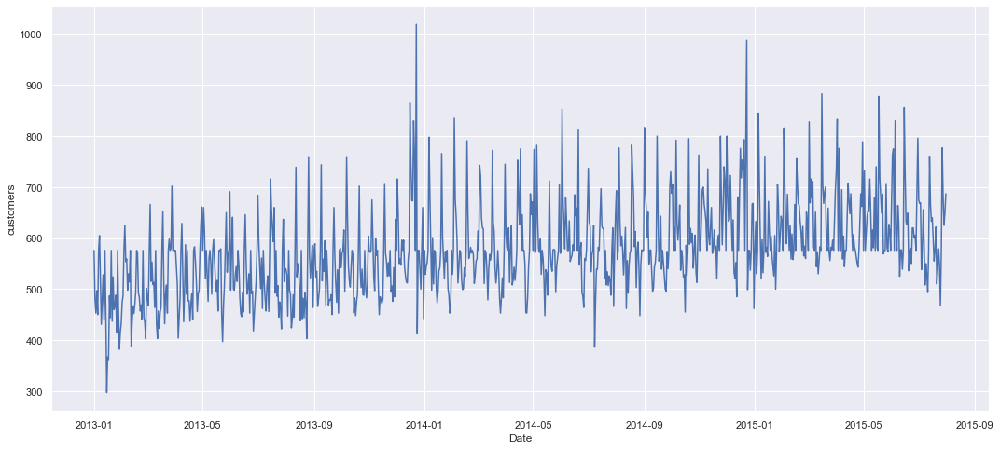

In [562]:
## plot graph
plt.xlabel('Date')
plt.ylabel('customers')
plt.plot(new_df['customers'])
plt.show()

In [563]:
new_df.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast
date,,,,,,,,,,,,
2013-01-01,9,2,6562.337612,575.936281,0,0,a,1,0,8.789102,8.759312,6369.730107
2013-01-02,9,3,4903.000000,481.000000,1,0,0,1,0,8.497603,8.775882,6476.155308
2013-01-03,9,4,4602.000000,453.000000,1,0,0,1,0,8.434246,8.642650,5668.328184
2013-01-04,9,5,4798.000000,497.000000,1,0,0,1,0,8.475954,8.562758,5233.093191
2013-01-05,9,6,4254.000000,450.000000,1,0,0,0,0,8.355615,8.562780,5233.208657


**ADF test**

In [564]:
def test_stationarity(timeseries):
    
    #Determine rolling statistics
    movingAverage = timeseries.rolling(window=12).mean()
    movingSTD = timeseries.rolling(window=12).std()
    
    #Plot rolling statistics
    orig = plt.plot(timeseries, color='blue', label='Original')
    mean = plt.plot(movingAverage, color='red', label='Rolling Mean')
    std = plt.plot(movingSTD, color='black', label='Rolling Std')
    plt.legend(loc='best')
    plt.title('Rolling Mean & Standard Deviation')
    plt.show(block=False)
    
    #Perform Dickey–Fuller test:
    print('Results of Dickey Fuller Test:')
    dftest = adfuller(new_df['customers'], autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    for key,value in dftest[4].items():
        dfoutput['Critical Value (%s)'%key] = value
    print(dfoutput)

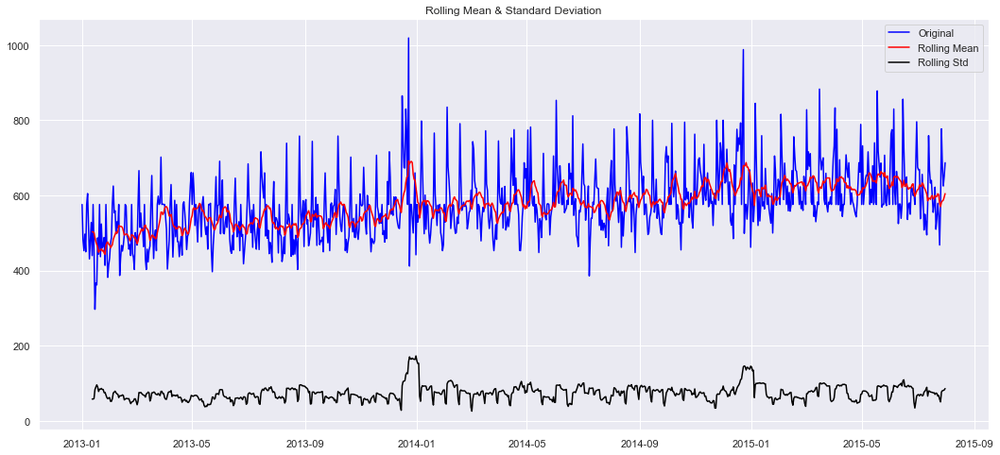

Results of Dickey Fuller Test:
Test Statistic                  -3.096754
p-value                          0.026794
#Lags Used                      20.000000
Number of Observations Used    911.000000
Critical Value (1%)             -3.437548
Critical Value (5%)             -2.864718
Critical Value (10%)            -2.568462
dtype: float64


In [565]:
test_stationarity(new_df['customers'])

- Null: Time Series is not stationary
- Alternate: Time Series is Stationary

**The p-value is less than 0.05 so The series is stationary**

In [566]:
from statsmodels.tsa.stattools import kpss
kpss_test = kpss(new_df['customers'])

print('KPSS Statistic: %f' % kpss_test[0])
print('Critical Values @ 0.05: %.2f' % kpss_test[3]['5%'])
print('p-value: %f' % kpss_test[1])

KPSS Statistic: 3.411945
Critical Values @ 0.05: 0.46
p-value: 0.010000


- Null: Time Series is not stationary
- Alternate: Time Series is Stationary

**The p-value is less than 0.05 so The series is non-stationary**

**Log transformation has made mean & variance constant**

In [567]:
#Log Transformation
new_df['customers_log'] = np.log(new_df['customers'])
new_df.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast,customers_log
date,,,,,,,,,,,,,
2013-01-01,9,2,6562.337612,575.936281,0,0,a,1,0,8.789102,8.759312,6369.730107,6.355997
2013-01-02,9,3,4903.000000,481.000000,1,0,0,1,0,8.497603,8.775882,6476.155308,6.175867
2013-01-03,9,4,4602.000000,453.000000,1,0,0,1,0,8.434246,8.642650,5668.328184,6.115892
2013-01-04,9,5,4798.000000,497.000000,1,0,0,1,0,8.475954,8.562758,5233.093191,6.208590
2013-01-05,9,6,4254.000000,450.000000,1,0,0,0,0,8.355615,8.562780,5233.208657,6.109248


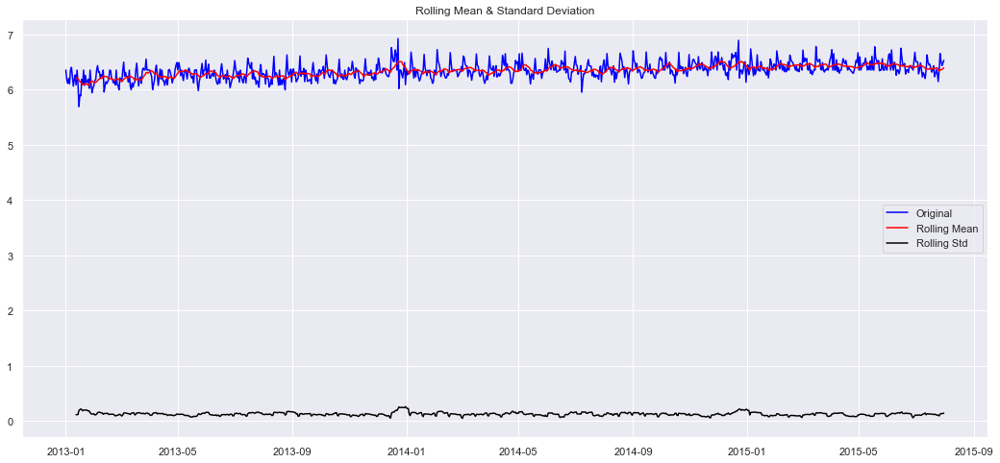

Results of Dickey Fuller Test:
Test Statistic                  -3.096754
p-value                          0.026794
#Lags Used                      20.000000
Number of Observations Used    911.000000
Critical Value (1%)             -3.437548
Critical Value (5%)             -2.864718
Critical Value (10%)            -2.568462
dtype: float64


In [568]:
test_stationarity(new_df['customers_log'])

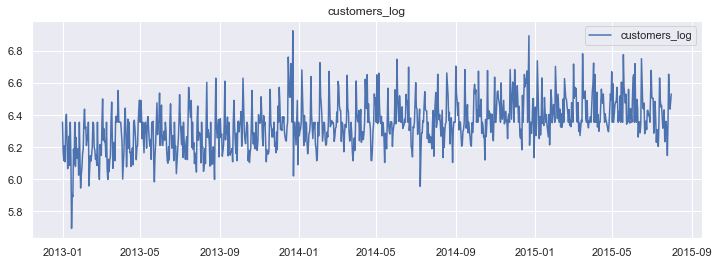

In [569]:
#plot the arima Log series
plt.figure(figsize=(12,4))
plt.plot(new_df['customers_log'],label='customers_log')
plt.legend(loc='best')
plt.title('customers_log')
plt.show()

In [570]:
#Let's check the info
new_df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 932 entries, 2013-01-01 to 2015-07-31
Data columns (total 13 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   store            932 non-null    int64  
 1   day_of_week      932 non-null    int64  
 2   sales            932 non-null    float64
 3   customers        932 non-null    float64
 4   open             932 non-null    int64  
 5   promo            932 non-null    int64  
 6   state_holiday    932 non-null    object 
 7   school_holiday   932 non-null    int64  
 8   promo2           932 non-null    int64  
 9   sales_log        932 non-null    float64
 10  ar_forecast_Log  932 non-null    float64
 11  arima_forecast   932 non-null    float64
 12  customers_log    932 non-null    float64
dtypes: float64(6), int64(6), object(1)
memory usage: 141.9+ KB


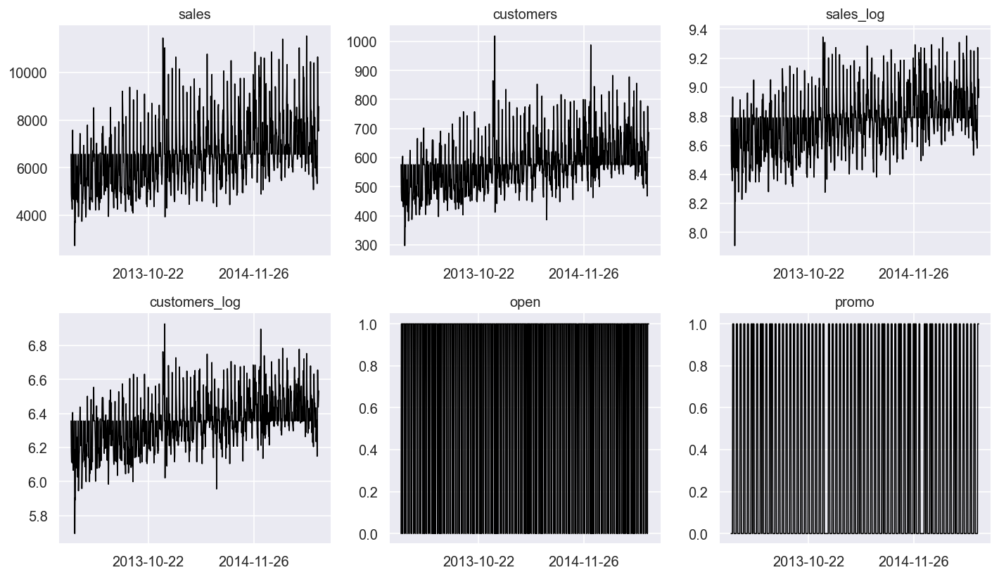

In [571]:
# Plot
ls=['sales','customers','sales_log','customers_log','open','promo','state_holiday','promo2','school_holiday']
df=new_df[ls]
fig, axes = plt.subplots(nrows=2, ncols=3, dpi=120, figsize=(12,7))
for i, ax in enumerate(axes.flatten()):
        ax.plot(df[df.columns[i]], color='black', linewidth=1)
        ax.xaxis.set_major_locator(plt.MaxNLocator(3))
        # Decorations
        ax.set_title(df.columns[i])
        ax.xaxis.set_ticks_position('none')
        ax.yaxis.set_ticks_position('none')
        ax.spines["top"].set_alpha(0)
        ax.tick_params(labelsize=12)

plt.tight_layout();

In [572]:
new_df.columns

Index(['store', 'day_of_week', 'sales', 'customers', 'open', 'promo',
       'state_holiday', 'school_holiday', 'promo2', 'sales_log',
       'ar_forecast_Log', 'arima_forecast', 'customers_log'],
      dtype='object')

In [573]:
new_df1=new_df[['sales_log', 'customers_log']]
new_df1

,sales_log,customers_log
date,,
2013-01-01,8.789102,6.355997
2013-01-02,8.497603,6.175867
2013-01-03,8.434246,6.115892
2013-01-04,8.475954,6.208590
2013-01-05,8.355615,6.109248
...,...,...
2015-07-27,9.273221,6.655440
2015-07-28,9.076923,6.519147
2015-07-29,8.958797,6.437752


In [574]:
#Let's create a model
model = VAR(new_df1)
for i in [1,2,3,4,5]:
    result = model.fit(i)
    print('Lag Order =', i)
    print('AIC : ', result.aic)
    print('BIC : ', result.bic)
    print('FPE : ', result.fpe)
    print('HQIC: ', result.hqic, '\n')

Lag Order = 1
AIC :  -10.011271397251155
BIC :  -9.980103238643569
FPE :  4.4891084220242956e-05
HQIC:  -9.99938429917061 

Lag Order = 2
AIC :  -10.035489894594367
BIC :  -9.983498662485255
FPE :  4.381695621124856e-05
HQIC:  -10.01566014242595 

Lag Order = 3
AIC :  -10.070591212733245
BIC :  -9.997741350146168
FPE :  4.230561906553033e-05
HQIC:  -10.042804420676928 

Lag Order = 4
AIC :  -10.086791836197705
BIC :  -9.993047686208318
FPE :  4.1625790457229154e-05
HQIC:  -10.051033576979899 

Lag Order = 5
AIC :  -10.102652691079838
BIC :  -9.98797849642779
FPE :  4.097081954425901e-05
HQIC:  -10.058908495790114 



In [575]:
x = model.select_order(maxlags=5)
x.summary()

,AIC,BIC,FPE,HQIC
0,-9.562,-9.551,7.038e-05,-9.558
1,-10.01,-9.982,4.482e-05,-10.00
2,-10.04,-9.984,4.380e-05,-10.02
3,-10.07,-9.998*,4.227e-05,-10.04
4,-10.09,-9.993,4.162e-05,-10.05
5,-10.10*,-9.988,4.097e-05*,-10.06*


In [576]:
#Let's fit the model
model_fitted = model.fit()
model_fitted.summary()

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Mon, 17, Jan, 2022
Time:                     16:12:49
--------------------------------------------------------------------
No. of Equations:         2.00000    BIC:                   -9.98010
Nobs:                     931.000    HQIC:                  -9.99938
Log likelihood:           2024.18    FPE:                4.48911e-05
AIC:                     -10.0113    Det(Omega_mle):     4.46032e-05
--------------------------------------------------------------------
Results for equation sales_log
                      coefficient       std. error           t-stat            prob
-----------------------------------------------------------------------------------
const                    3.954382         0.234914           16.833           0.000
L1.sales_log             1.109970         0.097754           11.355           0.000
L1.customers_log        -0.775062         0.

In [577]:
# Get the lag order
lag_order = model_fitted.k_ar
print(lag_order)  #> 4

1


In [578]:
# Input data for forecasting
forecast_input = new_df1.values[-lag_order:]
forecast_input

array([[9.05543941, 6.53233429]])

In [579]:
# Forecast
fc = model_fitted.forecast(y=forecast_input, steps=182)
df_forecast = pd.DataFrame(fc, index=new_df.index[-182:], columns=new_df1.columns + '_2d')
df_forecast

,sales_log_2d,customers_log_2d
date,,
2015-01-25,8.942684,6.468873
2015-01-26,8.866716,6.419021
2015-01-27,8.821032,6.387789
2015-01-28,8.794531,6.369424
2015-01-29,8.779349,6.358853
...,...,...
2015-07-27,8.759258,6.344832
2015-07-28,8.759258,6.344832
2015-07-29,8.759258,6.344832


In [580]:
df_forecast['VAR_forecast_Sales'] = np.exp(df_forecast['sales_log_2d'])
df_forecast['VAR_forecast_customers'] = np.exp(df_forecast['customers_log_2d'])
df_forecast

,sales_log_2d,customers_log_2d,VAR_forecast_Sales,VAR_forecast_customers
date,,,,
2015-01-25,8.942684,6.468873,7651.710504,644.756941
2015-01-26,8.866716,6.419021,7091.952992,613.402007
2015-01-27,8.821032,6.387789,6775.255809,594.540759
2015-01-28,8.794531,6.369424,6598.060944,583.721680
2015-01-29,8.779349,6.358853,6498.647919,577.583433
...,...,...,...,...
2015-07-27,8.759258,6.344832,6369.383954,569.541629
2015-07-28,8.759258,6.344832,6369.383954,569.541629
2015-07-29,8.759258,6.344832,6369.383954,569.541629


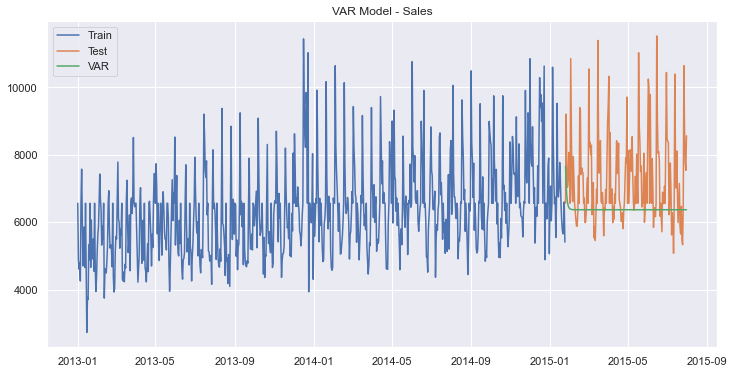

In [581]:
plt.figure(figsize=(12,6)) 
plt.plot(train['sales'], label='Train')
plt.plot(test['sales'], label='Test')
plt.plot(df_forecast['VAR_forecast_Sales'], label='VAR')
plt.legend(loc='best')
plt.title('VAR Model - Sales')
plt.show()

In [582]:
train_len = 750
train1 = new_df[0:train_len] # first 890days as training set
test1 = new_df[train_len:] # last 42 days as out-of-time test set

In [583]:
train1.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast,customers_log
date,,,,,,,,,,,,,
2013-01-01,9,2,6562.337612,575.936281,0,0,a,1,0,8.789102,8.759312,6369.730107,6.355997
2013-01-02,9,3,4903.000000,481.000000,1,0,0,1,0,8.497603,8.775882,6476.155308,6.175867
2013-01-03,9,4,4602.000000,453.000000,1,0,0,1,0,8.434246,8.642650,5668.328184,6.115892
2013-01-04,9,5,4798.000000,497.000000,1,0,0,1,0,8.475954,8.562758,5233.093191,6.208590
2013-01-05,9,6,4254.000000,450.000000,1,0,0,0,0,8.355615,8.562780,5233.208657,6.109248


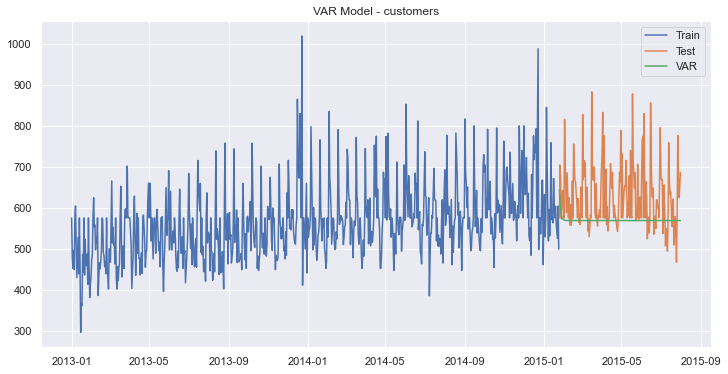

In [584]:
plt.figure(figsize=(12,6)) 
plt.plot(train1['customers'], label='Train')
plt.plot(test1['customers'], label='Test')
plt.plot(df_forecast['VAR_forecast_customers'], label='VAR')
plt.legend(loc='best')
plt.title('VAR Model - customers')
plt.show()

**Model Evalution**


In [585]:
# Let's calculate the rmse and MAPE
rmse = np.sqrt(mean_squared_error(test['sales'], df_forecast['VAR_forecast_Sales'])).round(2)
mape = np.round(np.mean(np.abs(test['sales']-df_forecast['VAR_forecast_Sales'])/test['sales'])*100,2)
tempResults = pd.DataFrame({'Method':['VAR'], 'RMSE': [rmse],'MAPE': [mape] })

In [586]:
tempResults

,Method,RMSE,MAPE
0,VAR,1566.32,13.08


In [587]:
results = pd.concat([Results , tempResults])
results = results[['Method', 'RMSE', 'MAPE']]
results

,Method,RMSE,MAPE
0,ARIMA,1290.57,10.53
0,VAR,1566.32,13.08


**Johansen-Impulse**

In [588]:
joh_model1 = coint_johansen(new_df[['sales','customers']],-1,1)

In [589]:
joh_model1

In [590]:
joh_model1.lr2

array([179.07084463,   1.56447848])

In [591]:
joh_model1.lr1

array([180.63532311,   1.56447848])

In [592]:
new_df[['sales','customers']].shape

(932, 2)

In [593]:
def joh_output(res):
    output = pd.DataFrame([res.lr2,res.lr1],
                          index=['max_eig_stat',"trace_stat"])
    print(output.T,'\n')
    print("Critical values(90%, 95%, 99%) of max_eig_stat\n",res.cvm,'\n')
    print("Critical values(90%, 95%, 99%) of trace_stat\n",res.cvt,'\n')

In [594]:
joh_output(joh_model1)

   max_eig_stat  trace_stat
0    179.070845  180.635323
1      1.564478    1.564478 

Critical values(90%, 95%, 99%) of max_eig_stat
 [[ 9.4748 11.2246 15.0923]
 [ 2.9762  4.1296  6.9406]] 

Critical values(90%, 95%, 99%) of trace_stat
 [[10.4741 12.3212 16.364 ]
 [ 2.9762  4.1296  6.9406]] 



In [595]:
from statsmodels.tsa.vector_ar.vecm import select_coint_rank

In [596]:
rank=select_coint_rank(new_df[['sales','customers']],-1,1)
print(rank.rank)

1


**Rank is one**

In [597]:
from statsmodels.tsa.stattools import coint

In [598]:
coint(new_df['sales'],new_df['customers'])#null hypothesis-There is not coint

(-6.029102926899932,
 1.404581633624642e-06,
 array([-3.90824227, -3.34270081, -3.04900867]))

1.404581633624642e-06<.05

We can reject the null hypothesis

**Sales and customers are cointegration to each other**

**VARMAX MODEL**

In [599]:
#create dymmy variables
new_df=pd.get_dummies(new_df)
new_df.head()

,store,day_of_week,sales,customers,open,promo,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast,customers_log,state_holiday_0,state_holiday_0,state_holiday_a,state_holiday_b,state_holiday_c
date,,,,,,,,,,,,,,,,,
2013-01-01,9,2,6562.337612,575.936281,0,0,1,0,8.789102,8.759312,6369.730107,6.355997,0,0,1,0,0
2013-01-02,9,3,4903.000000,481.000000,1,0,1,0,8.497603,8.775882,6476.155308,6.175867,0,1,0,0,0
2013-01-03,9,4,4602.000000,453.000000,1,0,1,0,8.434246,8.642650,5668.328184,6.115892,0,1,0,0,0
2013-01-04,9,5,4798.000000,497.000000,1,0,1,0,8.475954,8.562758,5233.093191,6.208590,0,1,0,0,0
2013-01-05,9,6,4254.000000,450.000000,1,0,0,0,8.355615,8.562780,5233.208657,6.109248,0,1,0,0,0


In [600]:
exog = new_df[['open','promo','school_holiday','promo2','state_holiday_0','state_holiday_a','state_holiday_b','state_holiday_c']]
mod = sm.tsa.VARMAX(new_df[['sales_log', 'customers_log']], order=(1,1), trend='n', exog=exog)
res = mod.fit(maxiter=1000, disp=False)
print(res.summary())

                                 Statespace Model Results                                 
Dep. Variable:     ['sales_log', 'customers_log']   No. Observations:                  932
Model:                                VARMAX(1,1)   Log Likelihood                2129.865
Date:                            Mon, 17 Jan 2022   AIC                          -4201.731
Time:                                    16:15:02   BIC                          -4061.448
Sample:                                         0   HQIC                         -4148.232
                                            - 932                                         
Covariance Type:                              opg                                         
Ljung-Box (L1) (Q):            10.26, 0.09   Jarque-Bera (JB):         69.84, 58.21
Prob(Q):                        0.00, 0.76   Prob(JB):                   0.00, 0.00
Heteroskedasticity (H):         0.89, 1.01   Skew:                      0.30, -0.01
Prob(H) (two-sided):

In [601]:
train_len = 750
train = new_df[0:train_len] # first 7500days as training set
test = new_df[train_len:] 

start_index = test.index.min()
end_index = test.index.max()

In [602]:
print(start_index)
print(end_index)

2015-01-25 00:00:00
2015-07-31 00:00:00


In [603]:
test.head()

,store,day_of_week,sales,customers,open,promo,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast,customers_log,state_holiday_0,state_holiday_0,state_holiday_a,state_holiday_b,state_holiday_c
date,,,,,,,,,,,,,,,,,
2015-01-25,9,7,6562.337612,575.936281,0,0,0,0,8.789102,8.696504,5981.961612,6.355997,0,1,0,0,0
2015-01-26,9,1,9209.000000,705.000000,1,1,0,0,9.127937,8.754277,6337.736789,6.558198,0,1,0,0,0
2015-01-27,9,2,7619.000000,666.000000,1,1,0,0,8.938400,8.936385,7603.659068,6.501290,0,1,0,0,0
2015-01-28,9,3,7038.000000,574.000000,1,1,0,0,8.859079,8.916069,7450.745263,6.352629,0,1,0,0,0
2015-01-29,9,4,7253.000000,603.000000,1,1,0,0,8.889170,8.851852,6987.320854,6.401917,0,1,0,0,0


In [604]:
predictions = mod.fit().predict(start=start_index, end=end_index, exog=test[['open','promo','school_holiday','promo2','state_holiday_0','state_holiday_a','state_holiday_b','state_holiday_c']])

In [605]:
predictions

,sales_log,customers_log
date,,
2015-01-25,8.713628,6.299519
2015-01-26,8.836885,6.387041
2015-01-27,8.969047,6.475768
2015-01-28,8.909156,6.448437
2015-01-29,8.887535,6.418075
...,...,...
2015-07-27,8.845821,6.397159
2015-07-28,9.029087,6.521108
2015-07-29,8.981643,6.491874


In [606]:
#Inverse the log
predictions['VARMAX_forecast_Sales'] = np.exp(predictions['sales_log'])
predictions['VARMAX_forecast_customers'] = np.exp(predictions['customers_log'])
predictions

,sales_log,customers_log,VARMAX_forecast_Sales,VARMAX_forecast_customers
date,,,,
2015-01-25,8.713628,6.299519,6085.278369,544.310180
2015-01-26,8.836885,6.387041,6883.514706,594.096221
2015-01-27,8.969047,6.475768,7856.111723,649.217389
2015-01-28,8.909156,6.448437,7399.414333,631.714387
2015-01-29,8.887535,6.418075,7241.144304,612.822137
...,...,...,...,...
2015-07-27,8.845821,6.397159,6945.300891,600.137554
2015-07-28,9.029087,6.521108,8342.243220,679.330506
2015-07-29,8.981643,6.491874,7955.695629,659.758424


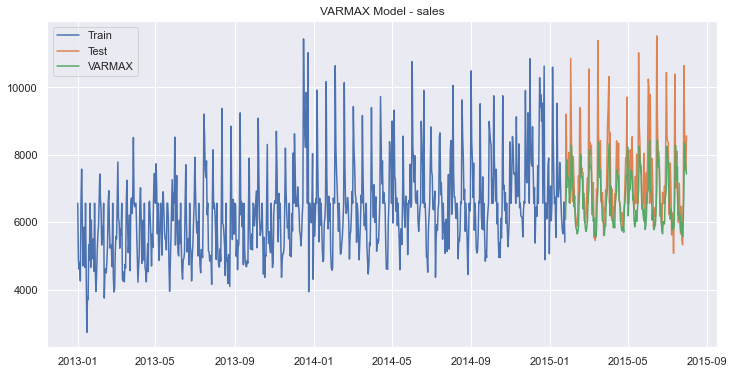

In [607]:
plt.figure(figsize=(12,6)) 
plt.plot(train['sales'], label='Train')
plt.plot(test['sales'], label='Test')
plt.plot(predictions['VARMAX_forecast_Sales'], label='VARMAX')
plt.legend(loc='best')
plt.title('VARMAX Model - sales')
plt.show()

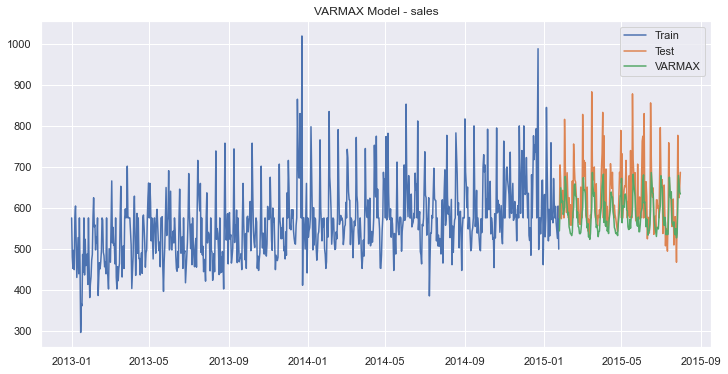

In [608]:
plt.figure(figsize=(12,6)) 
plt.plot(train['customers'], label='Train')
plt.plot(test['customers'], label='Test')
plt.plot(predictions['VARMAX_forecast_customers'], label='VARMAX')
plt.legend(loc='best')
plt.title('VARMAX Model - sales')
plt.show()

**Model Evaluation**


In [609]:
# Let's calculate the rmse and MAPE
rmse = np.sqrt(mean_squared_error(test['sales'], predictions['VARMAX_forecast_Sales'])).round(2)
mape = np.round(np.mean(np.abs(test['sales']-predictions['VARMAX_forecast_Sales'])/test['sales'])*100,2)
tempResults = pd.DataFrame({'Method':['VARMAX'], 'RMSE': [rmse],'MAPE': [mape] })

In [610]:
results = pd.concat([results  , tempResults])
results = results[['Method', 'RMSE', 'MAPE']]
results

,Method,RMSE,MAPE
0,ARIMA,1290.57,10.53
0,VAR,1566.32,13.08
0,VARMAX,1208.14,10.01


**VARMAX is the best model**

# Model-Store-13

In [611]:
#Store_13
df_new_store13=df_new[df_new['store']==13]

In [612]:
# transform datatype of the variable data to datetime
df_new_store13['date'] = pd.to_datetime( df_new_store13['date'])

In [613]:
df_new_store13.info()
#Let's check the info

<class 'pandas.core.frame.DataFrame'>
Int64Index: 758 entries, 12 to 1016107
Data columns (total 18 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   store                         758 non-null    int64         
 1   day_of_week                   758 non-null    int64         
 2   date                          758 non-null    datetime64[ns]
 3   sales                         758 non-null    int64         
 4   customers                     758 non-null    int64         
 5   open                          758 non-null    int64         
 6   promo                         758 non-null    int64         
 7   state_holiday                 758 non-null    object        
 8   school_holiday                758 non-null    int64         
 9   store_type                    758 non-null    object        
 10  assortment                    758 non-null    object        
 11  competition_distance       

In [614]:
# Check NAN values
missing_count = df_new_store13.isnull().sum() # the count of missing values
value_count = df_new_store13.isnull().count() # the count of all values

missing_percentage = round(missing_count/value_count *100, 2) # the percentage of missing values
missing_df = pd.DataFrame({'missing values count': missing_count, 'percentage': missing_percentage})
missing_df

,missing values count,percentage
store,0,0.0
day_of_week,0,0.0
date,0,0.0
sales,0,0.0
customers,0,0.0
open,0,0.0
promo,0,0.0
state_holiday,0,0.0
school_holiday,0,0.0
store_type,0,0.0


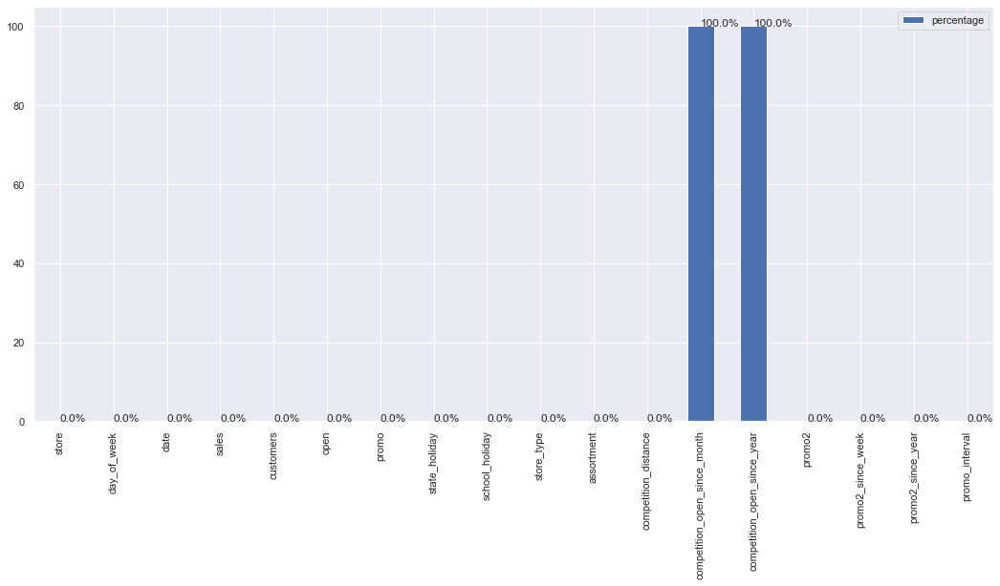

In [615]:
barchart = missing_df.plot.bar(y='percentage')
for index, percentage in enumerate( missing_percentage ):
    barchart.text( index, percentage, str(percentage)+'%')

In [616]:
#Let's drop the competition_open_since_month,competition_open_since_year
df_new_store13=df_new_store13.drop(['competition_open_since_month', 'competition_open_since_year'], axis = 1)

In [617]:
df_new_store13.columns

Index(['store', 'day_of_week', 'date', 'sales', 'customers', 'open', 'promo',
       'state_holiday', 'school_holiday', 'store_type', 'assortment',
       'competition_distance', 'promo2', 'promo2_since_week',
       'promo2_since_year', 'promo_interval'],
      dtype='object')

In [618]:
df_new_store13.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 758 entries, 12 to 1016107
Data columns (total 16 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   store                 758 non-null    int64         
 1   day_of_week           758 non-null    int64         
 2   date                  758 non-null    datetime64[ns]
 3   sales                 758 non-null    int64         
 4   customers             758 non-null    int64         
 5   open                  758 non-null    int64         
 6   promo                 758 non-null    int64         
 7   state_holiday         758 non-null    object        
 8   school_holiday        758 non-null    int64         
 9   store_type            758 non-null    object        
 10  assortment            758 non-null    object        
 11  competition_distance  758 non-null    float64       
 12  promo2                758 non-null    int64         
 13  promo2_since_we

In [619]:
# Let's copy the dataset
df_store13 = df_new_store13.copy()

In [620]:
df_store13.head()

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,store_type,assortment,competition_distance,promo2,promo2_since_week,promo2_since_year,promo_interval
12,13,5,2015-07-31,8821,568,1,1,0,0,d,a,310.0,1,45.0,2009.0,"Feb,May,Aug,Nov"
1127,13,4,2015-07-30,7648,474,1,1,0,0,d,a,310.0,1,45.0,2009.0,"Feb,May,Aug,Nov"
2242,13,3,2015-07-29,6648,406,1,1,0,0,d,a,310.0,1,45.0,2009.0,"Feb,May,Aug,Nov"
3357,13,2,2015-07-28,6819,446,1,1,0,0,d,a,310.0,1,45.0,2009.0,"Feb,May,Aug,Nov"
4472,13,1,2015-07-27,7926,527,1,1,0,0,d,a,310.0,1,45.0,2009.0,"Feb,May,Aug,Nov"


**Descriptive Statistics**


In [621]:
df_store13.describe().T

,count,mean,std,min,25%,50%,75%,max
store,758.0,13.000000,0.000000,13.0,13.00,13.0,13.00,13.0
day_of_week,758.0,4.001319,1.999009,1.0,2.00,4.0,6.00,7.0
sales,758.0,4124.773087,2429.243956,0.0,3135.25,4261.5,5784.25,10460.0
customers,758.0,313.641161,167.602980,0.0,276.00,345.5,421.00,672.0
open,758.0,0.819261,0.385056,0.0,1.00,1.0,1.00,1.0
promo,758.0,0.377309,0.485033,0.0,0.00,0.0,1.00,1.0
school_holiday,758.0,0.163588,0.370146,0.0,0.00,0.0,0.00,1.0
competition_distance,758.0,310.000000,0.000000,310.0,310.00,310.0,310.00,310.0
promo2,758.0,1.000000,0.000000,1.0,1.00,1.0,1.00,1.0
promo2_since_week,758.0,45.000000,0.000000,45.0,45.00,45.0,45.00,45.0


In [622]:
# separate numerical and categorical attributes
num_attributes = df_store13.select_dtypes( include = 'number')
cate_attributes = df_store13.select_dtypes( include = 'object')

**Numerical Attributes**

In [623]:
# Central Tendency - Mean, median
ct1 = pd.DataFrame( num_attributes.apply( np.mean ) ).T
ct2 = pd.DataFrame( num_attributes.apply( np.median ) ).T

# Dispersion - std, min, max, range, skew, kurtoisis
d1 = pd.DataFrame(num_attributes.apply( np.std )).T
d2 = pd.DataFrame(num_attributes.apply( min )).T
d3 = pd.DataFrame(num_attributes.apply( max )).T
d4 = pd.DataFrame(num_attributes.apply( lambda x: x.max() - x.min() )).T
d5 = pd.DataFrame(num_attributes.apply( lambda x: x.skew() )).T
d6 = pd.DataFrame(num_attributes.apply( lambda x: x.kurtosis() )).T

#concatenate
m = pd.concat( [d2, d3, d4, ct1, ct2, d1, d5, d6] ).T.reset_index()


m.columns = ['attributes', 'min', 'max', 'range', 'mean', 'median', 'std', 'skew', 'kurtosis']
m

,attributes,min,max,range,mean,median,std,skew,kurtosis
0,store,13.0,13.0,0.0,13.000000,13.0,0.000000,0.000000,0.000000
1,day_of_week,1.0,7.0,6.0,4.001319,4.0,1.997690,-0.001819,-1.246747
2,sales,0.0,10460.0,10460.0,4124.773087,4261.5,2427.641023,-0.258495,-0.417835
3,customers,0.0,672.0,672.0,313.641161,345.5,167.492387,-0.770709,-0.193274
4,open,0.0,1.0,1.0,0.819261,1.0,0.384802,-1.662647,0.766410
5,promo,0.0,1.0,1.0,0.377309,0.0,0.484713,0.507247,-1.747318
6,school_holiday,0.0,1.0,1.0,0.163588,0.0,0.369902,1.822533,1.325117
7,competition_distance,310.0,310.0,0.0,310.000000,310.0,0.000000,0.000000,0.000000
8,promo2,1.0,1.0,0.0,1.000000,1.0,0.000000,0.000000,0.000000
9,promo2_since_week,45.0,45.0,0.0,45.000000,45.0,0.000000,0.000000,0.000000


**Categorical Attributes**


In [624]:
# check unique values of categorical features
cate_attributes.apply( lambda x: x.unique().shape[0])

state_holiday     5
store_type        1
assortment        1
promo_interval    1
dtype: int64

In [625]:
#Let's check the unique values
print(df_store13['state_holiday'].unique())
print(df_store13['store_type'].unique())
print(df_store13['assortment'].unique())
print(df_store13['promo_interval'].unique())

['0' 'a' 'b' 0 'c']
['d']
['a']
['Feb,May,Aug,Nov']


In [626]:
df_store13.columns

Index(['store', 'day_of_week', 'date', 'sales', 'customers', 'open', 'promo',
       'state_holiday', 'school_holiday', 'store_type', 'assortment',
       'competition_distance', 'promo2', 'promo2_since_week',
       'promo2_since_year', 'promo_interval'],
      dtype='object')

# Exploratory data analysis(EDA)

Let’s perform EDA to gain insights into the given data.


**Univariate Analysis**

Response Variable (target)

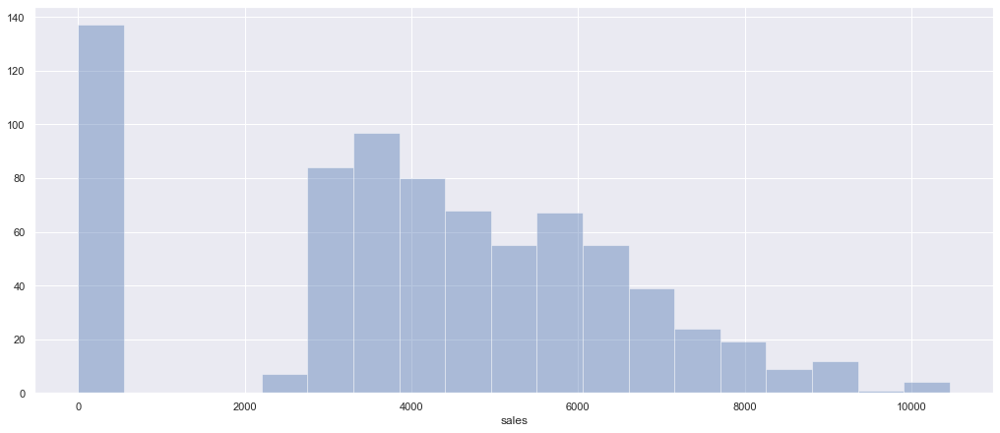

In [627]:
fig = plt.figure( figsize = (14, 6), constrained_layout=True)
sns.distplot(df_store13['sales'], kde = False);
plt.show()

**Numerical Variable**


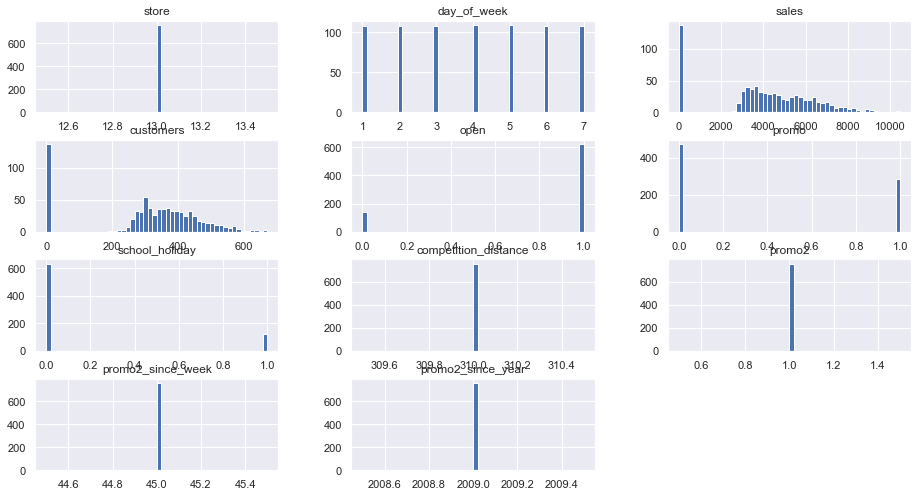

In [628]:
sns.set(rc={'figure.figsize':(15.7,8.27)})
num_attributes.hist(bins = 50);

In [629]:
df_store13['day_of_week'].value_counts()
#day of the week

5    109
4    109
7    108
6    108
3    108
2    108
1    108
Name: day_of_week, dtype: int64

In [630]:
df_store13['open'].value_counts()
# value count of store is open or not

1    621
0    137
Name: open, dtype: int64

In [631]:
df_store13['school_holiday'].value_counts()
# value count of state_holiday

0    634
1    124
Name: school_holiday, dtype: int64

In [632]:
df_store13['store_type'].value_counts()
# value count of store_type

d    758
Name: store_type, dtype: int64

In [633]:
df_store13['assortment'].value_counts()
# value count of assortment

a    758
Name: assortment, dtype: int64

In [634]:
df_store13['competition_distance'].value_counts()
# value count of competition distance

310.0    758
Name: competition_distance, dtype: int64

In [635]:
df_store13['promo2'].value_counts()
# value count of promo2

1    758
Name: promo2, dtype: int64

In [636]:
df_store13['promo2_since_year'].value_counts()
# value count of promo2_since_year

2009.0    758
Name: promo2_since_year, dtype: int64

In [637]:
df_store13['promo_interval'].value_counts()
# value count of promo_interval

Feb,May,Aug,Nov    758
Name: promo_interval, dtype: int64

**Categorical Variable**

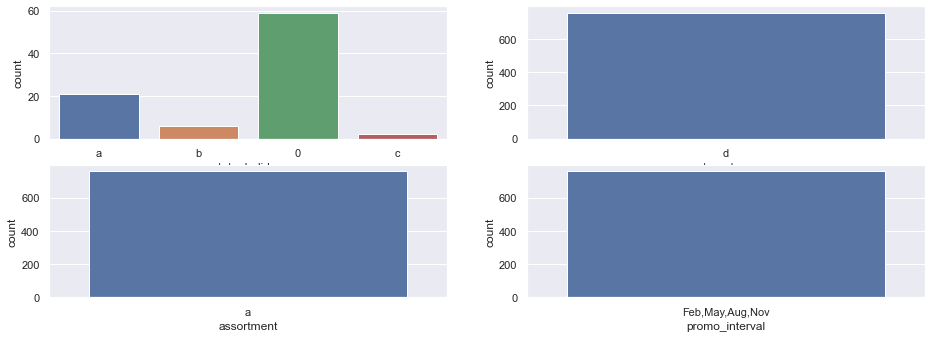

In [638]:
# state_holiday
plt.subplot(3, 2, 1)
a = df_store13[df_store13['state_holiday'] != '0']
sns.countplot(data = a, x = a['state_holiday'])

# store_type
plt.subplot(3, 2, 2)
sns.countplot(data = df_store13, x = df_store13['store_type'])

# assortment
plt.subplot(3, 2, 3)
sns.countplot(data = df_store13, x = df_store13['assortment'])

# promo_interval
plt.subplot(3, 2, 4)
sns.countplot(data = df_store13, x = df_store13['promo_interval'])


plt.show()

In [639]:
# Zero values in sales 
df_store13[df_store13['sales']==0]

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,store_type,assortment,competition_distance,promo2,promo2_since_week,promo2_since_year,promo_interval
5587,13,7,2015-07-26,0,0,0,0,0,0,d,a,310.0,1,45.0,2009.0,"Feb,May,Aug,Nov"
13392,13,7,2015-07-19,0,0,0,0,0,0,d,a,310.0,1,45.0,2009.0,"Feb,May,Aug,Nov"
21197,13,7,2015-07-12,0,0,0,0,0,0,d,a,310.0,1,45.0,2009.0,"Feb,May,Aug,Nov"
29002,13,7,2015-07-05,0,0,0,0,0,0,d,a,310.0,1,45.0,2009.0,"Feb,May,Aug,Nov"
36807,13,7,2015-06-28,0,0,0,0,0,0,d,a,310.0,1,45.0,2009.0,"Feb,May,Aug,Nov"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
987117,13,7,2013-01-27,0,0,0,0,0,0,d,a,310.0,1,45.0,2009.0,"Feb,May,Aug,Nov"
994922,13,7,2013-01-20,0,0,0,0,0,0,d,a,310.0,1,45.0,2009.0,"Feb,May,Aug,Nov"
1002727,13,7,2013-01-13,0,0,0,0,0,0,d,a,310.0,1,45.0,2009.0,"Feb,May,Aug,Nov"
1010532,13,7,2013-01-06,0,0,0,0,a,0,d,a,310.0,1,45.0,2009.0,"Feb,May,Aug,Nov"


In [640]:
df_store13.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 758 entries, 12 to 1016107
Data columns (total 16 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   store                 758 non-null    int64         
 1   day_of_week           758 non-null    int64         
 2   date                  758 non-null    datetime64[ns]
 3   sales                 758 non-null    int64         
 4   customers             758 non-null    int64         
 5   open                  758 non-null    int64         
 6   promo                 758 non-null    int64         
 7   state_holiday         758 non-null    object        
 8   school_holiday        758 non-null    int64         
 9   store_type            758 non-null    object        
 10  assortment            758 non-null    object        
 11  competition_distance  758 non-null    float64       
 12  promo2                758 non-null    int64         
 13  promo2_since_we


-    Sale  and customer colomns has zero values which has to be imputed

-    Store is open on 80% of days

-    80% are regular days

-    All the rows of column-store type belongs to 'd'

-    All the rows of column-assortment belongs to 'a'

-    All the rows of columns-competition_distance to 310

-    All the competition is opened since month-45

-    All the competition is opened since 2009

-    All the rows of promo2 belogs to 1

**Bivariate Analysis**

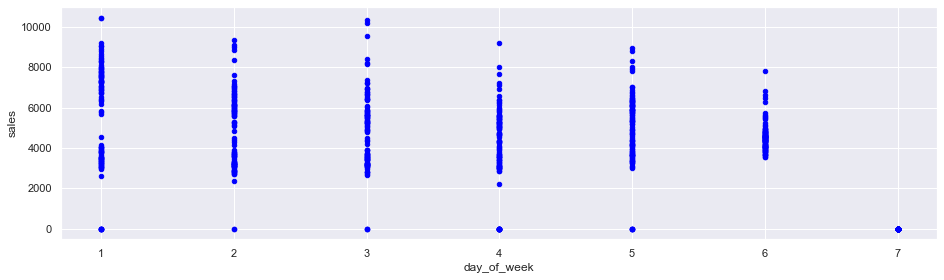

In [641]:
# lets draw a scatter plot between  Sales and day_of_week
sns.set(rc={'figure.figsize':(15.7,4.27)})
df_store13[['sales', 'day_of_week']].plot.scatter(x = 'day_of_week',y='sales',c='blue')
plt.show()

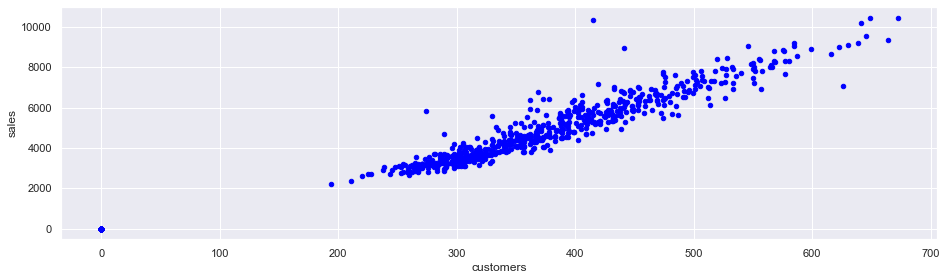

In [642]:
#Let's draw a scatter plot between Sales and Customers
df_store13[['sales', 'customers']].plot.scatter(x = 'customers',y='sales',c='blue')
plt.show()

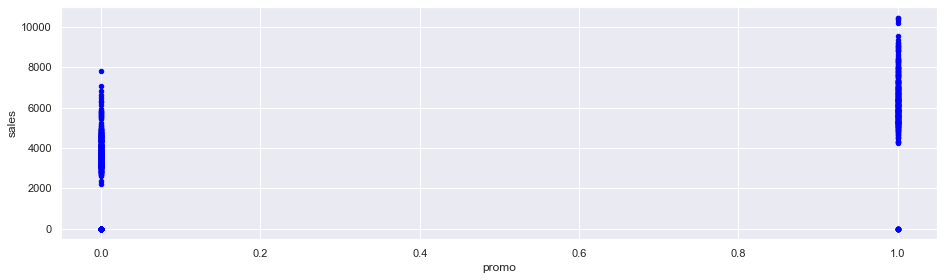

In [643]:
#Let's now draw a scatter plot between Sales and promo
df_store13[['sales', 'promo']].plot.scatter(x = 'promo',y='sales',c='blue')
plt.show()

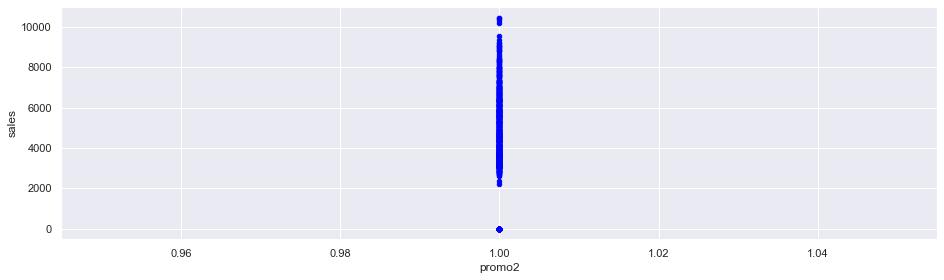

In [644]:
#Let's now draw a scatter plot between Sales and promo
df_store13[['sales', 'promo2']].plot.scatter(x = 'promo2',y='sales',c='blue')
plt.show()

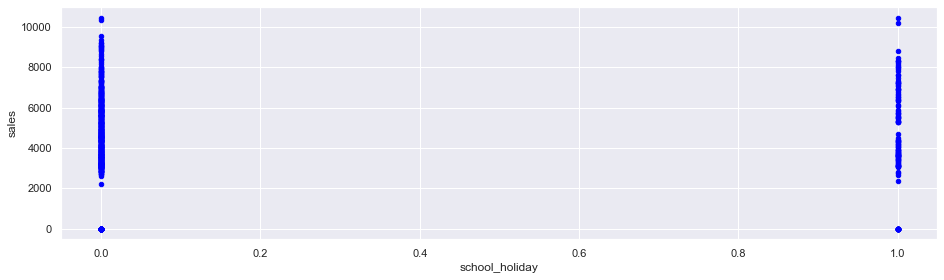

In [645]:
#lets now draw a scatter plot between  Sales and school_holiday
df_store13[['sales', 'school_holiday']].plot.scatter(x = 'school_holiday',y='sales',c='blue')
plt.show()

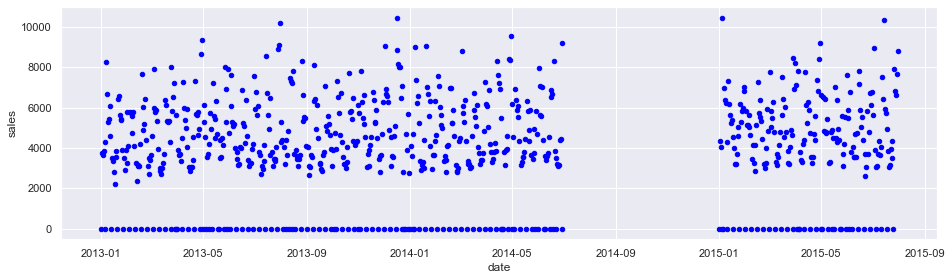

In [646]:
#lets now draw a scatter plot between Sales and date
df_store13[['sales', 'date']].plot.scatter(x = 'date',y='sales',c='blue')
plt.show()

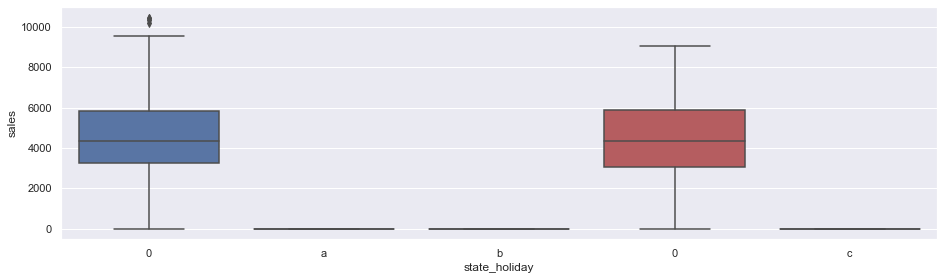

In [647]:
#Let's draw the boxplot between sales and state_holiday
sns.set(rc={'figure.figsize':(15.7,4.27)})
# create grouped boxplot 
sns.boxplot(x = df_store13['state_holiday'],
            y = df_store13['sales'])
plt.show()

**Multivariate Analysis**

**Numerical Attributes**

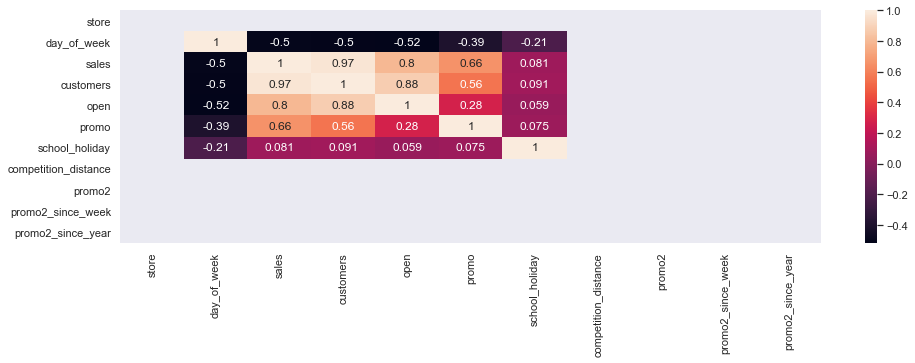

In [648]:
correlation = (num_attributes.corr( method = 'pearson' ))
sns.heatmap( correlation, annot = True );

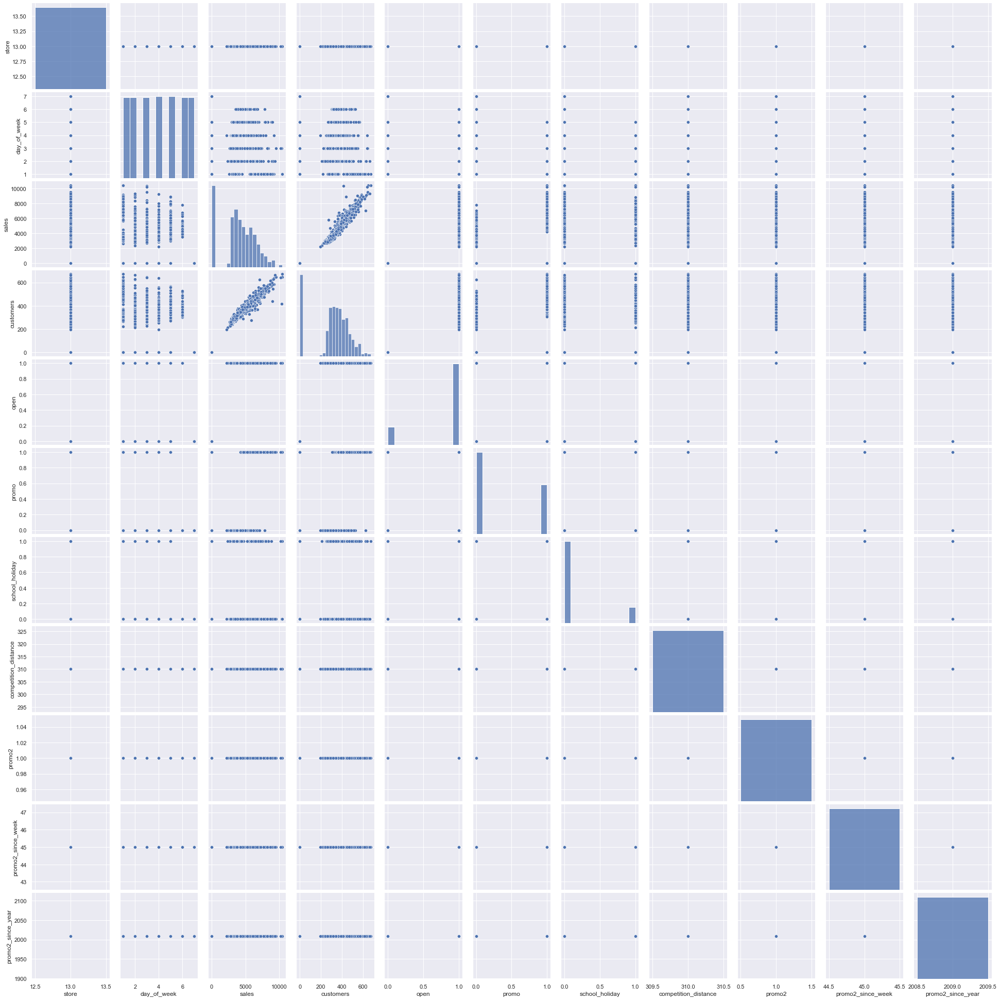

In [649]:
#pairplot with hue sales
sns.pairplot(df_store13)
# to show
plt.show()

**Some insights from EDA**

   - store_type,assortment,competition_distance,promo2_since_week,promo2_since_year,promo_interval  are uncessary columns so we have to drop them

   - Day1 and Day3 have higher sales than other days

   - promo is correlated to sales

   - Promo2 doesn't have any effect on sales becuase it's value is equal to 1

   - There is no sale on a = public holiday, b = Easter holiday, c = Christmas

   - There is some effect of school holiday on sales

In [650]:
#We can drop store_type,assortment,competition_distance,competition_open_since_month,promo2_since_week,promo2_since_year,promo_interval
#competition_open_since_year & promo2
df_store13_new=df_store13.drop(['store_type', 'assortment','competition_distance','promo2_since_week','promo2_since_year','promo_interval'], axis = 1)
df_store13_new.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 758 entries, 12 to 1016107
Data columns (total 10 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   store           758 non-null    int64         
 1   day_of_week     758 non-null    int64         
 2   date            758 non-null    datetime64[ns]
 3   sales           758 non-null    int64         
 4   customers       758 non-null    int64         
 5   open            758 non-null    int64         
 6   promo           758 non-null    int64         
 7   state_holiday   758 non-null    object        
 8   school_holiday  758 non-null    int64         
 9   promo2          758 non-null    int64         
dtypes: datetime64[ns](1), int64(8), object(1)
memory usage: 85.1+ KB


In [651]:
df_store13_new.columns

Index(['store', 'day_of_week', 'date', 'sales', 'customers', 'open', 'promo',
       'state_holiday', 'school_holiday', 'promo2'],
      dtype='object')

In [652]:
df_store13_new.head()

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,promo2
12,13,5,2015-07-31,8821,568,1,1,0,0,1
1127,13,4,2015-07-30,7648,474,1,1,0,0,1
2242,13,3,2015-07-29,6648,406,1,1,0,0,1
3357,13,2,2015-07-28,6819,446,1,1,0,0,1
4472,13,1,2015-07-27,7926,527,1,1,0,0,1


# Model Building

**ARIMA model**


In [653]:
df_store13_new=df_store13_new[::-1].reset_index()
df_store13_new.head()

,index,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,promo2
0,1016107,13,2,2013-01-01,0,0,0,0,a,1,1
1,1014992,13,3,2013-01-02,3737,317,1,0,0,1,1
2,1013877,13,4,2013-01-03,3674,292,1,0,0,1,1
3,1012762,13,5,2013-01-04,3848,340,1,0,0,1,1
4,1011647,13,6,2013-01-05,4285,344,1,0,0,0,1


In [654]:
df_store13_new=df_store13_new.drop(['index'], axis = 1)
df_store13_new.head()
#Let drop the index column

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,promo2
0,13,2,2013-01-01,0,0,0,0,a,1,1
1,13,3,2013-01-02,3737,317,1,0,0,1,1
2,13,4,2013-01-03,3674,292,1,0,0,1,1
3,13,5,2013-01-04,3848,340,1,0,0,1,1
4,13,6,2013-01-05,4285,344,1,0,0,0,1


In [655]:
df_store13_new.info()
#No missing value

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 758 entries, 0 to 757
Data columns (total 10 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   store           758 non-null    int64         
 1   day_of_week     758 non-null    int64         
 2   date            758 non-null    datetime64[ns]
 3   sales           758 non-null    int64         
 4   customers       758 non-null    int64         
 5   open            758 non-null    int64         
 6   promo           758 non-null    int64         
 7   state_holiday   758 non-null    object        
 8   school_holiday  758 non-null    int64         
 9   promo2          758 non-null    int64         
dtypes: datetime64[ns](1), int64(8), object(1)
memory usage: 59.3+ KB


In [656]:
# transform datatype of the variable data to datetime
df_store13_new['date'] = pd.to_datetime(df_store13_new['date'])

In [657]:
indexed_df_store13_new = df_store13_new.set_index(['date'])
indexed_df_store13_new.head()
#Let set the date as index column

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2
date,,,,,,,,,
2013-01-01,13,2,0,0,0,0,a,1,1
2013-01-02,13,3,3737,317,1,0,0,1,1
2013-01-03,13,4,3674,292,1,0,0,1,1
2013-01-04,13,5,3848,340,1,0,0,1,1
2013-01-05,13,6,4285,344,1,0,0,0,1


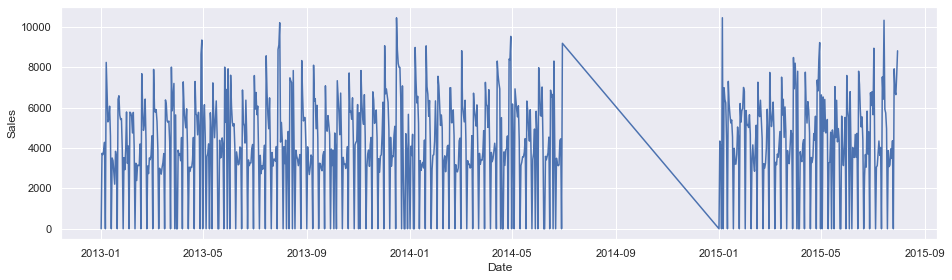

In [658]:
## plot graph
plt.xlabel('Date')
plt.ylabel('Sales')
plt.plot(indexed_df_store13_new['sales'])
plt.show()

In [659]:
#Let impute the zero values
(indexed_df_store13_new['sales']==0).sum()
# There are 137 zero value in sale column

137

In [660]:
indexed_df_store13_new['sales']=indexed_df_store13_new['sales'].replace(0, np.nan)

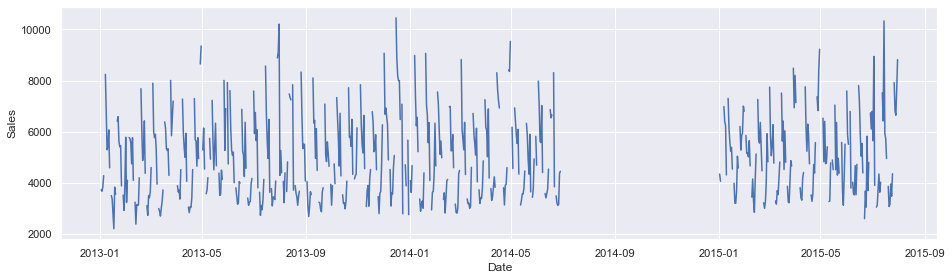

In [661]:
##plot graph
plt.xlabel('Date')
plt.ylabel('Sales')
plt.plot(indexed_df_store13_new['sales'])
plt.show()

In [662]:
#KNN imputer for filling NAN values
imputer = KNNImputer(n_neighbors=2)

In [663]:
indexed_df_store13_new['sales'] = imputer.fit_transform(np.array(indexed_df_store13_new['sales']).reshape(-1, 1))
indexed_df_store13_new['sales'].head()

date
2013-01-01    5034.747182
2013-01-02    3737.000000
2013-01-03    3674.000000
2013-01-04    3848.000000
2013-01-05    4285.000000
Name: sales, dtype: float64

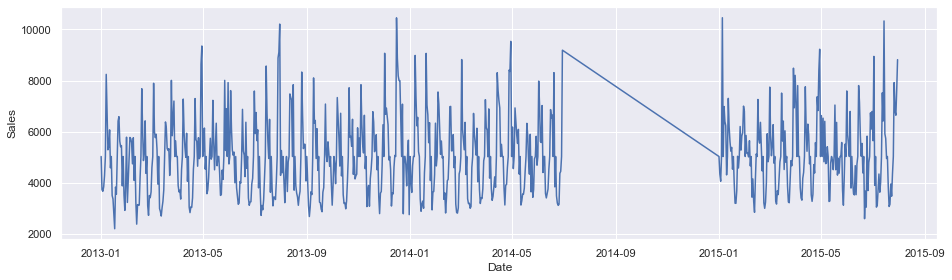

In [664]:
## plot graph
plt.xlabel('Date')
plt.ylabel('Sales')
plt.plot(indexed_df_store13_new['sales'])
plt.show()

In [665]:
(indexed_df_store13_new['sales']==0).sum()
# no missing value

0

**We have filled the zero values but data from 01/07/2014 to 31/12/2014 is missing. It will create a problem to create a model so we should keep the data till 30/06/2014 for modelling**

In [666]:
indexed_df_store13_new1=indexed_df_store13_new[:546]
indexed_df_store13_new1.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2
date,,,,,,,,,
2013-01-01,13,2,5034.747182,0,0,0,a,1,1
2013-01-02,13,3,3737.000000,317,1,0,0,1,1
2013-01-03,13,4,3674.000000,292,1,0,0,1,1
2013-01-04,13,5,3848.000000,340,1,0,0,1,1
2013-01-05,13,6,4285.000000,344,1,0,0,0,1


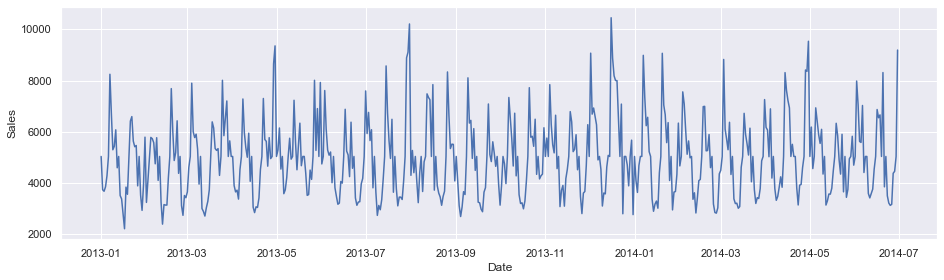

In [667]:
## plot graph
plt.xlabel('Date')
plt.ylabel('Sales')
plt.plot(indexed_df_store13_new1['sales'])
plt.show()

**Outlier detection**

Box plot and interquartile range

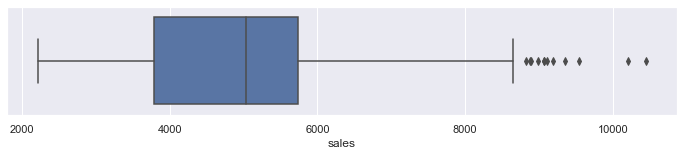

In [668]:
import seaborn as sns
fig = plt.subplots(figsize=(12, 2))
ax = sns.boxplot(x=indexed_df_store13_new1['sales'],whis=1.5)
#Let treat the outliers

**Histogram**

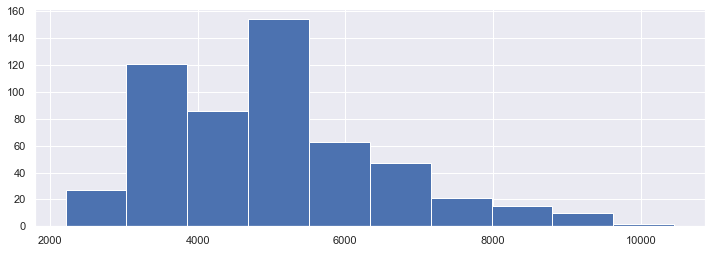

In [669]:
fig = indexed_df_store13_new1['sales'].hist(figsize = (12,4))

In [670]:
percentile01 = indexed_df_store13_new1['sales'].quantile(0.01)
percentile99 = indexed_df_store13_new1['sales'].quantile(0.99)

In [671]:
upper_limit = percentile99
lower_limit = percentile01

In [672]:
upper_limit

9092.449999999997

In [673]:
lower_limit

2746.6000000000004

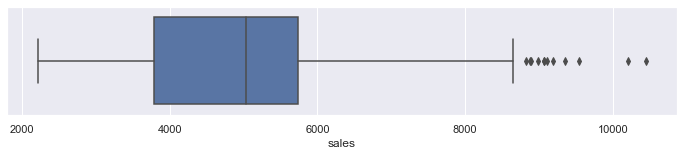

In [674]:
import seaborn as sns
fig = plt.subplots(figsize=(12, 2))
ax = sns.boxplot(x=indexed_df_store13_new1['sales'],whis=1.5)

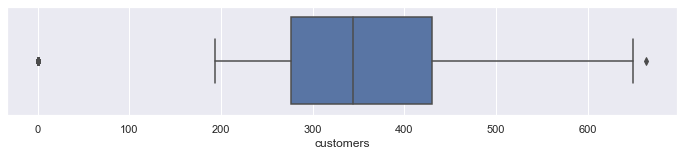

In [675]:
import seaborn as sns
fig = plt.subplots(figsize=(12, 2))
ax = sns.boxplot(x=indexed_df_store13_new1['customers'],whis=1.5)

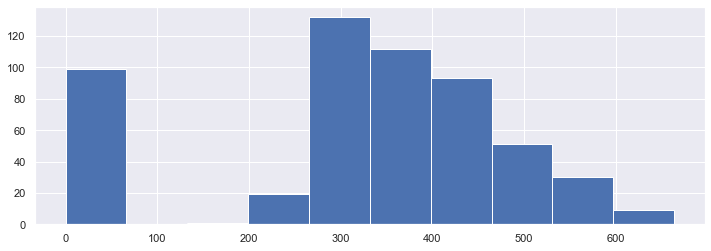

In [676]:
fig = indexed_df_store13_new1['customers'].hist(figsize = (12,4))

**ADF Stationary**

In [677]:
def test_stationarity(timeseries):
    
    #Determine rolling statistics
    movingAverage = timeseries.rolling(window=12).mean()
    movingSTD = timeseries.rolling(window=12).std()
    
    #Plot rolling statistics
    orig = plt.plot(timeseries, color='blue', label='Original')
    mean = plt.plot(movingAverage, color='red', label='Rolling Mean')
    std = plt.plot(movingSTD, color='black', label='Rolling Std')
    plt.legend(loc='best')
    plt.title('Rolling Mean & Standard Deviation')
    plt.show(block=False)
    
    #Perform Dickey–Fuller test:
    print('Results of Dickey Fuller Test:')
    dftest = adfuller(indexed_df_store13_new1['sales'], autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    for key,value in dftest[4].items():
        dfoutput['Critical Value (%s)'%key] = value
    print(dfoutput)

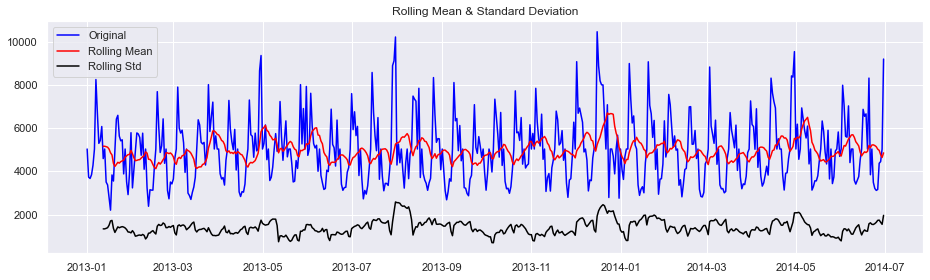

Results of Dickey Fuller Test:
Test Statistic                -5.693638e+00
p-value                        7.965604e-07
#Lags Used                     1.500000e+01
Number of Observations Used    5.300000e+02
Critical Value (1%)           -3.442749e+00
Critical Value (5%)           -2.867009e+00
Critical Value (10%)          -2.569683e+00
dtype: float64


In [678]:
test_stationarity(indexed_df_store13_new1['sales'])

- Null: Time Series is not stationary
- Alternate: Time Series is Stationary

**The p-value is less than 0.05 so The series is stationary**

In [679]:
from statsmodels.tsa.stattools import kpss
kpss_test = kpss(indexed_df_store13_new1['sales'])

print('KPSS Statistic: %f' % kpss_test[0])
print('Critical Values @ 0.05: %.2f' % kpss_test[3]['5%'])
print('p-value: %f' % kpss_test[1])

KPSS Statistic: 0.191785
Critical Values @ 0.05: 0.46
p-value: 0.100000


- Null: Time Series is not stationary
- Alternate: Time Series is Stationary
    
**The p-value is greater than 0.05 so The series is stationary**

# Let's take the log of sales to Standardize the sales values

In [680]:
new_df=indexed_df_store13_new1.copy()
new_df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 546 entries, 2013-01-01 to 2014-06-30
Data columns (total 9 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   store           546 non-null    int64  
 1   day_of_week     546 non-null    int64  
 2   sales           546 non-null    float64
 3   customers       546 non-null    int64  
 4   open            546 non-null    int64  
 5   promo           546 non-null    int64  
 6   state_holiday   546 non-null    object 
 7   school_holiday  546 non-null    int64  
 8   promo2          546 non-null    int64  
dtypes: float64(1), int64(7), object(1)
memory usage: 42.7+ KB


In [681]:
#Log Transformation
new_df['sales_log'] = np.log(new_df['sales'])
new_df.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log
date,,,,,,,,,,
2013-01-01,13,2,5034.747182,0,0,0,a,1,1,8.524119
2013-01-02,13,3,3737.000000,317,1,0,0,1,1,8.226038
2013-01-03,13,4,3674.000000,292,1,0,0,1,1,8.209036
2013-01-04,13,5,3848.000000,340,1,0,0,1,1,8.255309
2013-01-05,13,6,4285.000000,344,1,0,0,0,1,8.362876


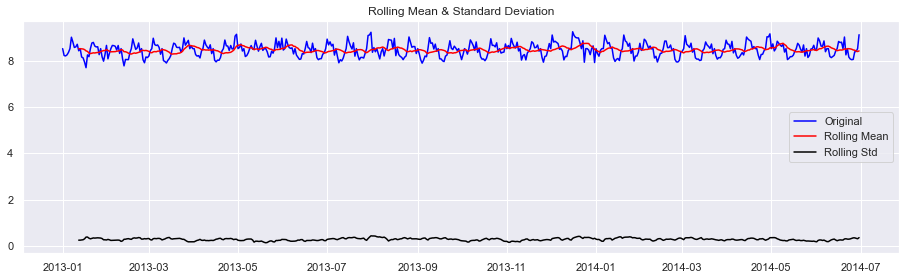

Results of Dickey Fuller Test:
Test Statistic                -5.693638e+00
p-value                        7.965604e-07
#Lags Used                     1.500000e+01
Number of Observations Used    5.300000e+02
Critical Value (1%)           -3.442749e+00
Critical Value (5%)           -2.867009e+00
Critical Value (10%)          -2.569683e+00
dtype: float64


In [682]:
test_stationarity(new_df['sales_log'])

**Log transformation has made mean & variance constant**

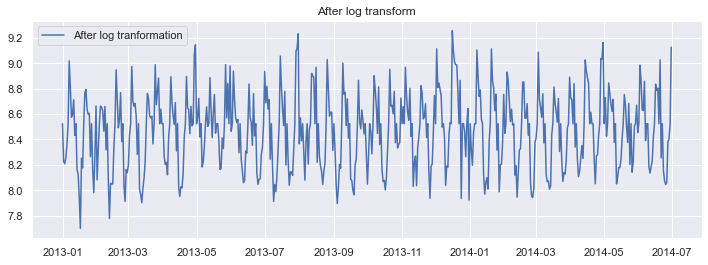

In [683]:
#After Log Transformation
plt.figure(figsize=(12,4))
plt.plot(new_df['sales_log'], label='After log tranformation')
plt.legend(loc='best')
plt.title('After log transform')
plt.show()

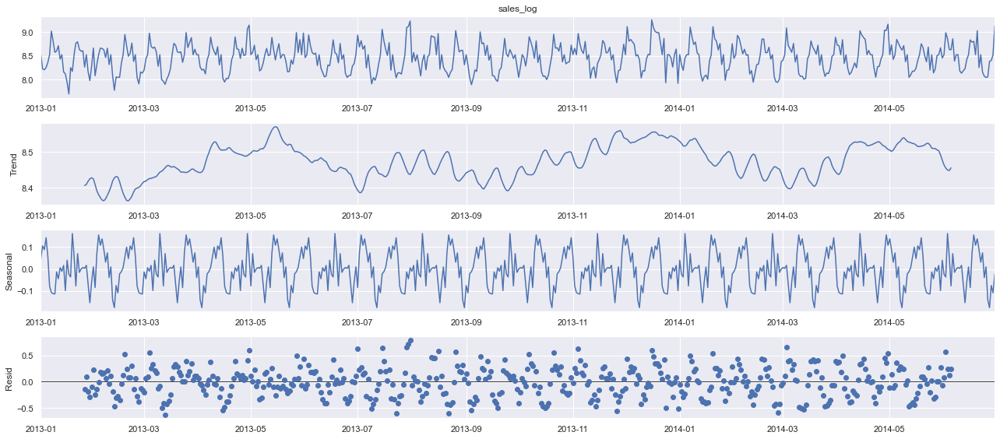

In [684]:
from matplotlib.pyplot import rcParams
rcParams['figure.figsize'] = 18,8
decomposition = sm.tsa.seasonal_decompose(new_df['sales_log'], model = "additive",period=50)
fig = decomposition.plot()

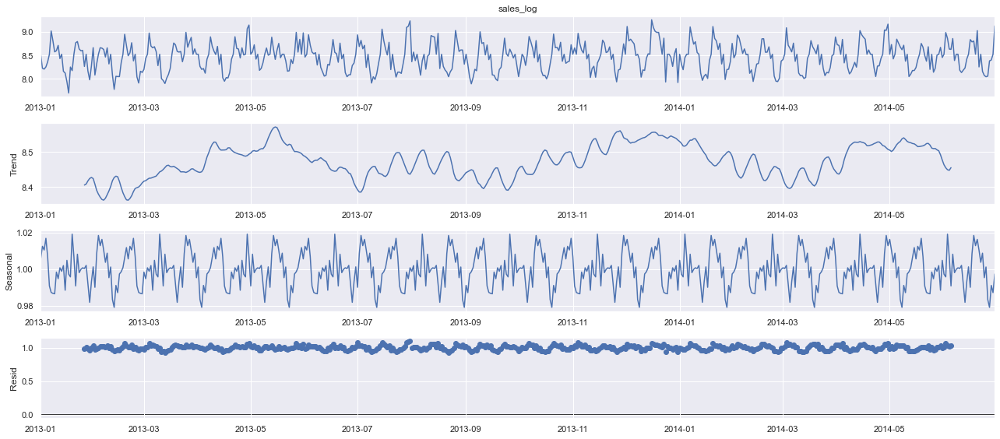

In [685]:
from matplotlib.pyplot import rcParams
rcParams['figure.figsize'] = 18,8
decomposition = sm.tsa.seasonal_decompose(new_df['sales_log'], model = "multiplicative",period=50)
fig = decomposition.plot()

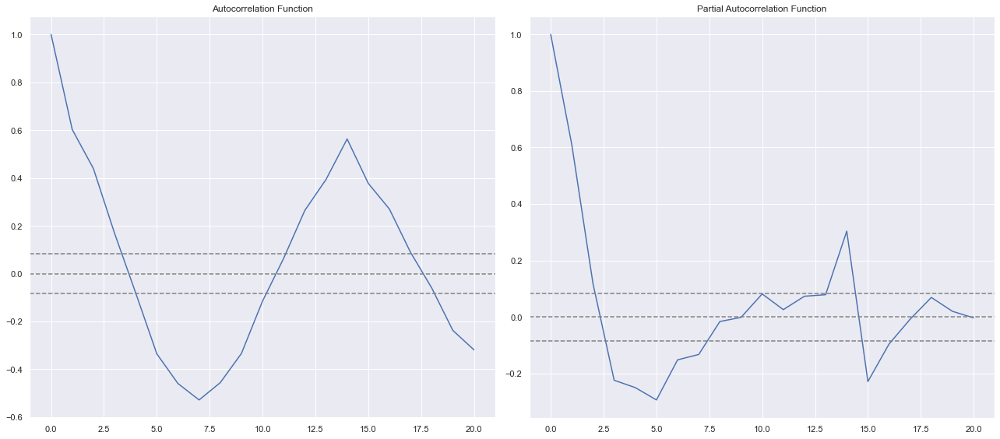

In [686]:
#ACF & PACF plots

lag_acf = acf(new_df['sales_log'], nlags=20) # MA 
lag_pacf = pacf(new_df['sales_log'], nlags=20, method='ols')  # AR 

#Plot ACF:
plt.subplot(121)
plt.plot(lag_acf)
plt.axhline(y=0, linestyle='--', color='gray')
plt.axhline(y=-1.96/np.sqrt(len(new_df['sales_log'])), linestyle='--', color='gray')
plt.axhline(y=1.96/np.sqrt(len(new_df['sales_log'])), linestyle='--', color='gray')
plt.title('Autocorrelation Function')            

#Plot PACF
plt.subplot(122)
plt.plot(lag_pacf)
plt.axhline(y=0, linestyle='--', color='gray')
plt.axhline(y=-1.96/np.sqrt(len(new_df['sales_log'])), linestyle='--', color='gray')
plt.axhline(y=1.96/np.sqrt(len(new_df['sales_log'])), linestyle='--', color='gray')
plt.title('Partial Autocorrelation Function')
            
plt.tight_layout() 

From the ACF graph, we see that curve touches y=0.0 line at x=4. Thus, from theory, Q = 4 From the PACF graph, we see that curve touches y=0.0 line at x=3. Thus, from theory, P = 3


**Build and evaluate time series forecast**

Split time series data into training and test set

In [687]:
train_len = 446
train = new_df['sales'][0:train_len] # first 446days as training set
test = new_df['sales'][train_len:] # last 100 days as out-of-time test set

In [688]:
print(train.shape)
print(test.shape)

(446,)
(100,)


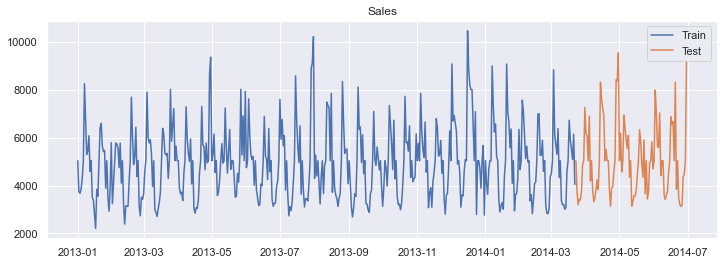

In [689]:
plt.figure(figsize=(12,4))
plt.plot(train, label='Train')
plt.plot(test, label='Test')
plt.legend(loc='best')
plt.title('Sales')
plt.show()

In [690]:
model = ARIMA(new_df['sales_log'], order=(3, 0, 4))
model_fit = model.fit()
print(model_fit.params)

const              8.472804
ar.L1.sales_log    0.770553
ar.L2.sales_log    0.778541
ar.L3.sales_log   -0.938403
ma.L1.sales_log   -0.403642
ma.L2.sales_log   -0.744620
ma.L3.sales_log    0.593965
ma.L4.sales_log    0.066306
dtype: float64


In [691]:
new_df['ar_forecast_Log'] = model_fit.predict(new_df.index.min(), new_df.index.max())
new_df['arima_forecast'] = np.exp(new_df['ar_forecast_Log'])
new_df['arima_forecast']

date
2013-01-01    4782.907347
2013-01-02    4935.242128
2013-01-03    4208.145517
2013-01-04    3832.251371
2013-01-05    4022.594208
                 ...     
2014-06-26    3664.888334
2014-06-27    3551.756128
2014-06-28    4789.504154
2014-06-29    5016.745334
2014-06-30    6046.202238
Name: arima_forecast, Length: 546, dtype: float64

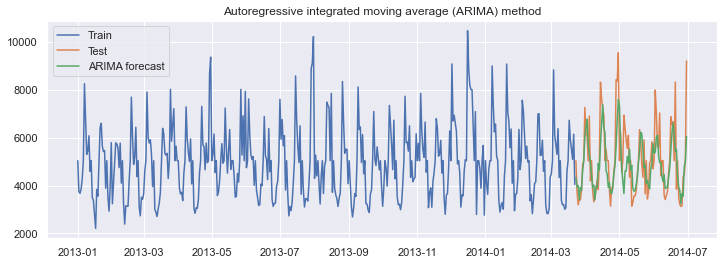

In [692]:
plt.figure(figsize=(12,4))
plt.plot(train, label='Train')
plt.plot(test, label='Test')
plt.plot(new_df['arima_forecast'][test.index.min():], label='ARIMA forecast')
plt.legend(loc='best')
plt.title('Autoregressive integrated moving average (ARIMA) method')
plt.show()

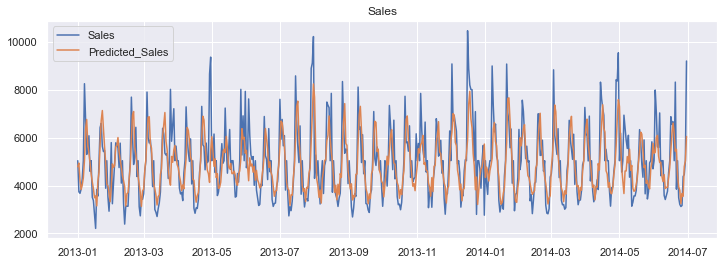

In [693]:
# plot the arima forecasting & Original series
plt.figure(figsize=(12,4))
plt.plot(new_df['sales'], label='Sales')
plt.plot(new_df['arima_forecast'], label='Predicted_Sales')
plt.legend(loc='best')
plt.title('Sales')
plt.show()

**Model Evalution**


In [694]:
from sklearn.metrics import mean_squared_error
rmse = np.sqrt(mean_squared_error(test, new_df['arima_forecast'][test.index.min():])).round(2)
mape = np.round(np.mean(np.abs(test-new_df['arima_forecast'][test.index.min():])/test)*100,2)
Results = pd.DataFrame({'Method':['ARIMA'], 'RMSE': [rmse],'MAPE': [mape] })
Results

,Method,RMSE,MAPE
0,ARIMA,1081.61,14.95


**VAR model**

In [695]:
#Load the dataset
new_df.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast
date,,,,,,,,,,,,
2013-01-01,13,2,5034.747182,0,0,0,a,1,1,8.524119,8.472804,4782.907347
2013-01-02,13,3,3737.000000,317,1,0,0,1,1,8.226038,8.504157,4935.242128
2013-01-03,13,4,3674.000000,292,1,0,0,1,1,8.209036,8.344777,4208.145517
2013-01-04,13,5,3848.000000,340,1,0,0,1,1,8.255309,8.251208,3832.251371
2013-01-05,13,6,4285.000000,344,1,0,0,0,1,8.362876,8.299682,4022.594208


**Split the dataset to training & testing**

In [696]:
#split the dataset
nobs = 100
train, test = new_df[0:-nobs], new_df[-nobs:]

# Check size
print(train.shape)
print(test.shape)  

(446, 12)
(100, 12)


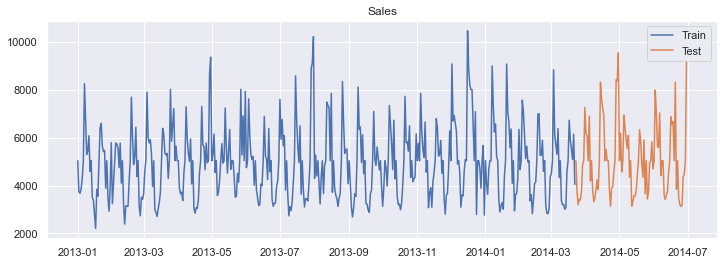

In [697]:
plt.figure(figsize=(12,4))
plt.plot(train['sales'], label='Train')
plt.plot(test['sales'], label='Test')
plt.legend(loc='best')
plt.title('Sales')
plt.show()

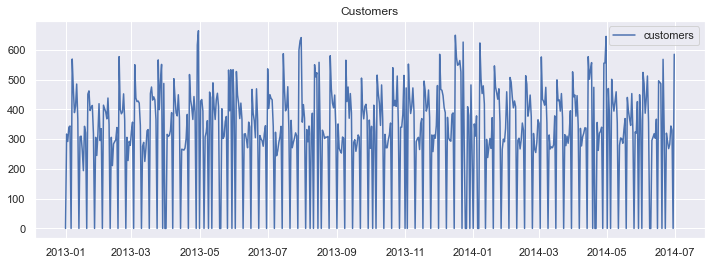

In [698]:
#plot the arima forecasting & Original series
plt.figure(figsize=(12,4))
plt.plot(new_df['customers'],label='customers')
plt.legend(loc='best')
plt.title('Customers')
plt.show()

In [699]:
(new_df['customers']==0).sum()

99

In [700]:
#impute the NAN values
new_df['customers']=new_df['customers'].replace(0, np.nan)

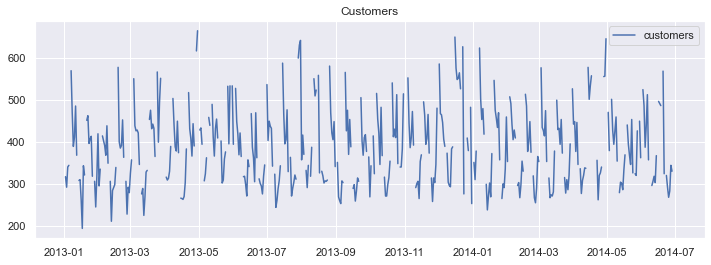

In [701]:
#plot the arima forecasting & Original series
plt.figure(figsize=(12,4))
plt.plot(new_df['customers'],label='customers')
plt.legend(loc='best')
plt.title('Customers')
plt.show()

In [702]:
#KNN imputer for filling NAN values
imputer = KNNImputer(n_neighbors=2)

In [703]:
new_df['customers'] = imputer.fit_transform(np.array(new_df['customers']).reshape(-1, 1))
new_df['customers'].head()

date
2013-01-01    387.149888
2013-01-02    317.000000
2013-01-03    292.000000
2013-01-04    340.000000
2013-01-05    344.000000
Name: customers, dtype: float64

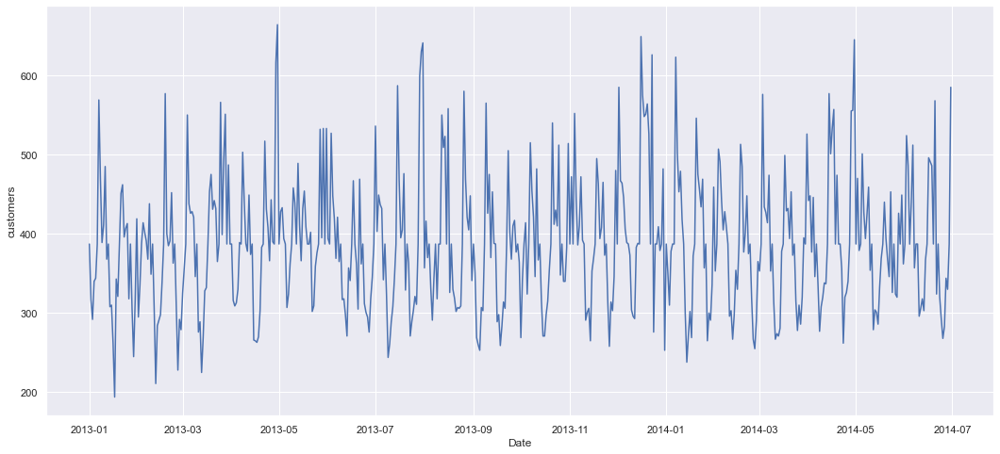

In [704]:
## plot graph
plt.xlabel('Date')
plt.ylabel('customers')
plt.plot(new_df['customers'])
plt.show()

In [705]:
new_df.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast
date,,,,,,,,,,,,
2013-01-01,13,2,5034.747182,387.149888,0,0,a,1,1,8.524119,8.472804,4782.907347
2013-01-02,13,3,3737.000000,317.000000,1,0,0,1,1,8.226038,8.504157,4935.242128
2013-01-03,13,4,3674.000000,292.000000,1,0,0,1,1,8.209036,8.344777,4208.145517
2013-01-04,13,5,3848.000000,340.000000,1,0,0,1,1,8.255309,8.251208,3832.251371
2013-01-05,13,6,4285.000000,344.000000,1,0,0,0,1,8.362876,8.299682,4022.594208


**ADF test**

In [706]:
def test_stationarity(timeseries):
    
    #Determine rolling statistics
    movingAverage = timeseries.rolling(window=12).mean()
    movingSTD = timeseries.rolling(window=12).std()
    
    #Plot rolling statistics
    orig = plt.plot(timeseries, color='blue', label='Original')
    mean = plt.plot(movingAverage, color='red', label='Rolling Mean')
    std = plt.plot(movingSTD, color='black', label='Rolling Std')
    plt.legend(loc='best')
    plt.title('Rolling Mean & Standard Deviation')
    plt.show(block=False)
    
    #Perform Dickey–Fuller test:
    print('Results of Dickey Fuller Test:')
    dftest = adfuller(new_df['customers'], autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    for key,value in dftest[4].items():
        dfoutput['Critical Value (%s)'%key] = value
    print(dfoutput)

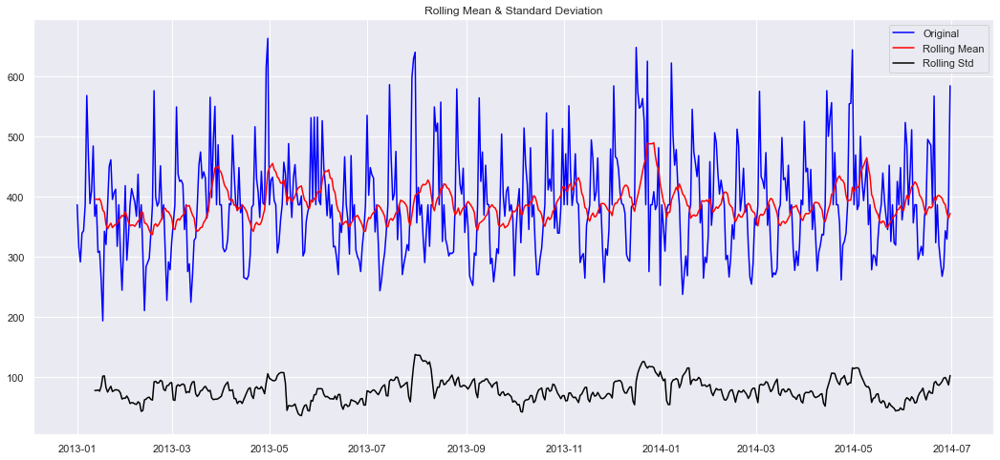

Results of Dickey Fuller Test:
Test Statistic                  -4.800083
p-value                          0.000054
#Lags Used                      17.000000
Number of Observations Used    528.000000
Critical Value (1%)             -3.442796
Critical Value (5%)             -2.867030
Critical Value (10%)            -2.569694
dtype: float64


In [707]:
test_stationarity(new_df['customers'])

- Null: Time Series is not stationary
- Alternate: Time Series is Stationary

**The p-value is less than 0.05 so The series is stationary**

In [708]:
from statsmodels.tsa.stattools import kpss
kpss_test = kpss(new_df['customers'])

print('KPSS Statistic: %f' % kpss_test[0])
print('Critical Values @ 0.05: %.2f' % kpss_test[3]['5%'])
print('p-value: %f' % kpss_test[1])

KPSS Statistic: 0.142600
Critical Values @ 0.05: 0.46
p-value: 0.100000


- Null: Time Series is not stationary
- Alternate: Time Series is Stationary

**The p-value is less than 0.05 so The series is non-stationary**

**Log transformation has made mean & variance constant**

In [709]:
#Log Transformation
new_df['customers_log'] = np.log(new_df['customers'])
new_df.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast,customers_log
date,,,,,,,,,,,,,
2013-01-01,13,2,5034.747182,387.149888,0,0,a,1,1,8.524119,8.472804,4782.907347,5.958812
2013-01-02,13,3,3737.000000,317.000000,1,0,0,1,1,8.226038,8.504157,4935.242128,5.758902
2013-01-03,13,4,3674.000000,292.000000,1,0,0,1,1,8.209036,8.344777,4208.145517,5.676754
2013-01-04,13,5,3848.000000,340.000000,1,0,0,1,1,8.255309,8.251208,3832.251371,5.828946
2013-01-05,13,6,4285.000000,344.000000,1,0,0,0,1,8.362876,8.299682,4022.594208,5.840642


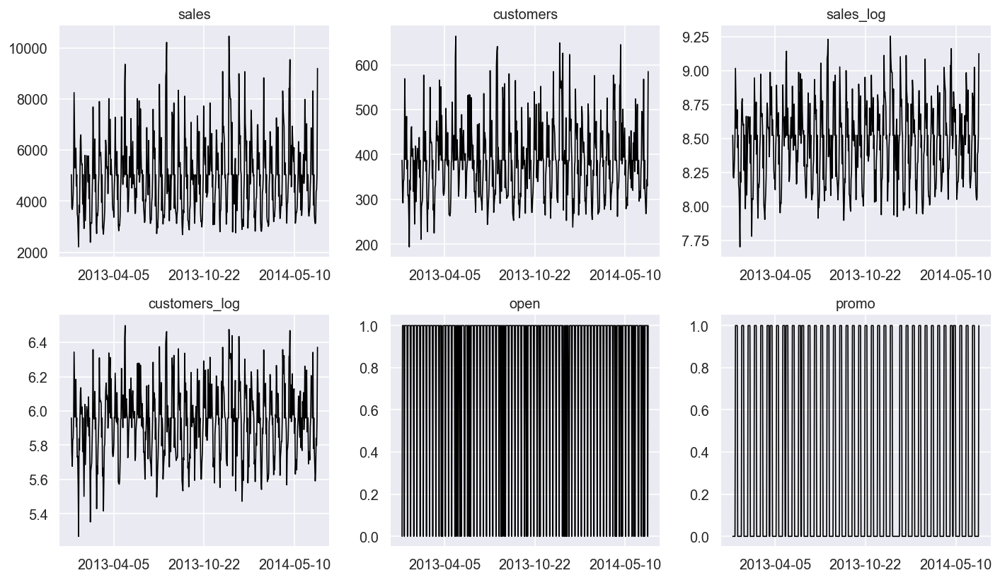

In [710]:
# Plot
ls=['sales','customers','sales_log','customers_log','open','promo','state_holiday','promo2','school_holiday']
df=new_df[ls]
fig, axes = plt.subplots(nrows=2, ncols=3, dpi=120, figsize=(12,7))
for i, ax in enumerate(axes.flatten()):
        ax.plot(df[df.columns[i]], color='black', linewidth=1)
        ax.xaxis.set_major_locator(plt.MaxNLocator(3))
        # Decorations
        ax.set_title(df.columns[i])
        ax.xaxis.set_ticks_position('none')
        ax.yaxis.set_ticks_position('none')
        ax.spines["top"].set_alpha(0)
        ax.tick_params(labelsize=12)

plt.tight_layout();

In [711]:
new_df.columns

Index(['store', 'day_of_week', 'sales', 'customers', 'open', 'promo',
       'state_holiday', 'school_holiday', 'promo2', 'sales_log',
       'ar_forecast_Log', 'arima_forecast', 'customers_log'],
      dtype='object')

In [712]:
new_df1=new_df[['sales_log', 'customers_log']]
new_df1

,sales_log,customers_log
date,,
2013-01-01,8.524119,5.958812
2013-01-02,8.226038,5.758902
2013-01-03,8.209036,5.676754
2013-01-04,8.255309,5.828946
2013-01-05,8.362876,5.840642
...,...,...
2014-06-26,8.059908,5.645447
2014-06-27,8.383890,5.840642
2014-06-28,8.401782,5.799093


In [713]:
#Let's create a model
model = VAR(new_df1)
for i in [1,2,3,4,5]:
    result = model.fit(i)
    print('Lag Order =', i)
    print('AIC : ', result.aic)
    print('BIC : ', result.bic)
    print('FPE : ', result.fpe)
    print('HQIC: ', result.hqic, '\n')

Lag Order = 1
AIC :  -9.04590716830437
BIC :  -8.998559067812662
FPE :  0.00011787250945712593
HQIC:  -9.027396907278364 

Lag Order = 2
AIC :  -9.048814587201607
BIC :  -8.969789784869697
FPE :  0.00011753039794980449
HQIC:  -9.017918159507719 

Lag Order = 3
AIC :  -9.112626541522767
BIC :  -9.001835509332942
FPE :  0.00011026503459306327
HQIC:  -9.069306947931949 

Lag Order = 4
AIC :  -9.156060233506855
BIC :  -9.01341302312694
FPE :  0.00010557867717845991
HQIC:  -9.100280297689016 

Lag Order = 5
AIC :  -9.258908675713613
BIC :  -9.08431491576052
FPE :  9.526029507576106e-05
HQIC:  -9.190631043077191 



In [714]:
x = model.select_order(maxlags=5)
x.summary()

,AIC,BIC,FPE,HQIC
0,-8.583,-8.567,0.0001872,-8.577
1,-9.042,-8.994,0.0001184,-9.023
2,-9.045,-8.966,0.0001180,-9.014
3,-9.107,-8.996,0.0001109,-9.063
4,-9.153,-9.010,0.0001059,-9.097
5,-9.259*,-9.084*,9.526e-05*,-9.191*


In [715]:
#Let's fit the model
model_fitted = model.fit()
model_fitted.summary()

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Mon, 17, Jan, 2022
Time:                     16:19:56
--------------------------------------------------------------------
No. of Equations:         2.00000    BIC:                   -8.99856
Nobs:                     545.000    HQIC:                  -9.02740
Log likelihood:           924.367    FPE:                0.000117873
AIC:                     -9.04591    Det(Omega_mle):     0.000116585
--------------------------------------------------------------------
Results for equation sales_log
                      coefficient       std. error           t-stat            prob
-----------------------------------------------------------------------------------
const                    3.288754         0.288901           11.384           0.000
L1.sales_log             1.050155         0.150756            6.966           0.000
L1.customers_log        -0.625411         0.

In [716]:
# Get the lag order
lag_order = model_fitted.k_ar
print(lag_order)  #> 4

1


In [717]:
# Input data for forecasting
forecast_input = new_df1.values[-lag_order:]
forecast_input

array([[9.12608882, 6.37161185]])

In [718]:
# Forecast
fc = model_fitted.forecast(y=forecast_input, steps=100)
df_forecast = pd.DataFrame(fc, index=new_df.index[-100:], columns=new_df1.columns + '_2d')
df_forecast

,sales_log_2d,customers_log_2d
date,,
2014-03-23,8.887686,6.232920
2014-03-24,8.724065,6.116818
2014-03-25,8.624849,6.046247
2014-03-26,8.564792,6.003529
2014-03-27,8.528440,5.977671
...,...,...
2014-06-26,8.472694,5.938018
2014-06-27,8.472694,5.938018
2014-06-28,8.472694,5.938018


In [719]:
df_forecast['VAR_forecast_Sales'] = np.exp(df_forecast['sales_log_2d'])
df_forecast['VAR_forecast_customers'] = np.exp(df_forecast['customers_log_2d'])
df_forecast

,sales_log_2d,customers_log_2d,VAR_forecast_Sales,VAR_forecast_customers
date,,,,
2014-03-23,8.887686,6.232920,7242.238246,509.240201
2014-03-24,8.724065,6.116818,6149.123002,453.419779
2014-03-25,8.624849,6.046247,5568.319756,422.524510
2014-03-26,8.564792,6.003529,5243.749831,404.854864
2014-03-27,8.528440,5.977671,5056.553123,394.520540
...,...,...,...,...
2014-06-26,8.472694,5.938018,4782.381124,379.182690
2014-06-27,8.472694,5.938018,4782.381124,379.182690
2014-06-28,8.472694,5.938018,4782.381124,379.182690


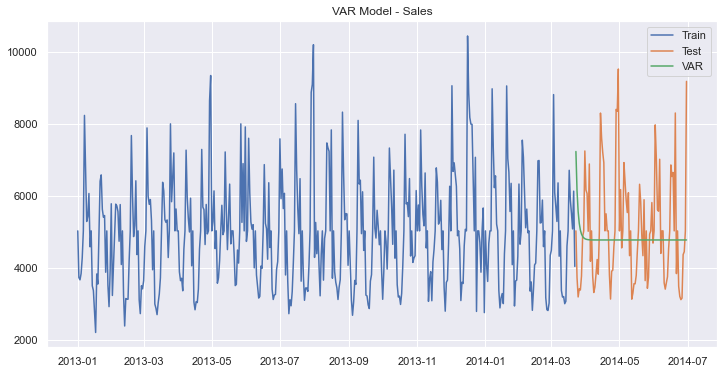

In [720]:
plt.figure(figsize=(12,6)) 
plt.plot(train['sales'], label='Train')
plt.plot(test['sales'], label='Test')
plt.plot(df_forecast['VAR_forecast_Sales'], label='VAR')
plt.legend(loc='best')
plt.title('VAR Model - Sales')
plt.show()

In [721]:
train_len = 446
train1 = new_df[0:train_len] # first 446days as training set
test1 = new_df[train_len:] # last 100 days as out-of-time test set

In [722]:
train1.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast,customers_log
date,,,,,,,,,,,,,
2013-01-01,13,2,5034.747182,387.149888,0,0,a,1,1,8.524119,8.472804,4782.907347,5.958812
2013-01-02,13,3,3737.000000,317.000000,1,0,0,1,1,8.226038,8.504157,4935.242128,5.758902
2013-01-03,13,4,3674.000000,292.000000,1,0,0,1,1,8.209036,8.344777,4208.145517,5.676754
2013-01-04,13,5,3848.000000,340.000000,1,0,0,1,1,8.255309,8.251208,3832.251371,5.828946
2013-01-05,13,6,4285.000000,344.000000,1,0,0,0,1,8.362876,8.299682,4022.594208,5.840642


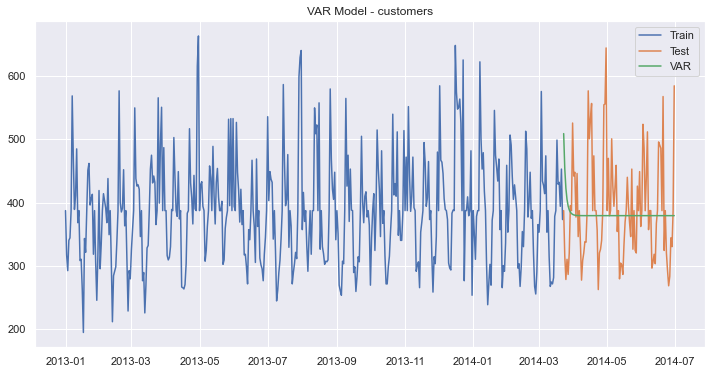

In [723]:
plt.figure(figsize=(12,6)) 
plt.plot(train1['customers'], label='Train')
plt.plot(test1['customers'], label='Test')
plt.plot(df_forecast['VAR_forecast_customers'], label='VAR')
plt.legend(loc='best')
plt.title('VAR Model - customers')
plt.show()

**Model evalution**

In [724]:
# Let's calculate the rmse and MAPE
rmse = np.sqrt(mean_squared_error(test1['sales'], df_forecast['VAR_forecast_Sales'])).round(2)
mape = np.round(np.mean(np.abs(test1['sales']-df_forecast['VAR_forecast_Sales'])/test1['sales'])*100,2)
tempResults = pd.DataFrame({'Method':['VAR'], 'RMSE': [rmse],'MAPE': [mape] })

In [725]:
tempResults

,Method,RMSE,MAPE
0,VAR,1565.18,23.6


In [726]:
results = pd.concat([Results , tempResults])
results = results[['Method', 'RMSE', 'MAPE']]
results

,Method,RMSE,MAPE
0,ARIMA,1081.61,14.95
0,VAR,1565.18,23.60


**Johansen-Impulse**

In [727]:
joh_model1 = coint_johansen(new_df[['sales','customers']],-1,1)

In [728]:
joh_model1

In [729]:
joh_model1.lr2

array([99.26498561,  1.34566343])

In [730]:
joh_model1.lr1

array([100.61064904,   1.34566343])

In [731]:
new_df[['sales','customers']].shape

(546, 2)

In [732]:
def joh_output(res):
    output = pd.DataFrame([res.lr2,res.lr1],
                          index=['max_eig_stat',"trace_stat"])
    print(output.T,'\n')
    print("Critical values(90%, 95%, 99%) of max_eig_stat\n",res.cvm,'\n')
    print("Critical values(90%, 95%, 99%) of trace_stat\n",res.cvt,'\n')

In [733]:
joh_output(joh_model1)

   max_eig_stat  trace_stat
0     99.264986  100.610649
1      1.345663    1.345663 

Critical values(90%, 95%, 99%) of max_eig_stat
 [[ 9.4748 11.2246 15.0923]
 [ 2.9762  4.1296  6.9406]] 

Critical values(90%, 95%, 99%) of trace_stat
 [[10.4741 12.3212 16.364 ]
 [ 2.9762  4.1296  6.9406]] 



In [734]:
from statsmodels.tsa.vector_ar.vecm import select_coint_rank

In [735]:
rank=select_coint_rank(new_df[['sales','customers']],-1,1)
print(rank.rank)

1


**Rank is one**

In [736]:
from statsmodels.tsa.stattools import coint

In [737]:
coint(new_df['sales'],new_df['customers'])#null hypothesis-There is not coint

(-5.41457741290247,
 2.653951142044937e-05,
 array([-3.91664811, -3.34736416, -3.05224118]))

2.653951142044937e-05<.05

We can reject the null hypothesis

**Sales and customers are cointegration to each other**

**VARMAX MODEL**


In [738]:
#create dymmy variables
new_df=pd.get_dummies(new_df)
new_df.head()

,store,day_of_week,sales,customers,open,promo,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast,customers_log,state_holiday_0,state_holiday_0,state_holiday_a,state_holiday_b,state_holiday_c
date,,,,,,,,,,,,,,,,,
2013-01-01,13,2,5034.747182,387.149888,0,0,1,1,8.524119,8.472804,4782.907347,5.958812,0,0,1,0,0
2013-01-02,13,3,3737.000000,317.000000,1,0,1,1,8.226038,8.504157,4935.242128,5.758902,0,1,0,0,0
2013-01-03,13,4,3674.000000,292.000000,1,0,1,1,8.209036,8.344777,4208.145517,5.676754,0,1,0,0,0
2013-01-04,13,5,3848.000000,340.000000,1,0,1,1,8.255309,8.251208,3832.251371,5.828946,0,1,0,0,0
2013-01-05,13,6,4285.000000,344.000000,1,0,0,1,8.362876,8.299682,4022.594208,5.840642,0,1,0,0,0


In [739]:
new_df.head()

,store,day_of_week,sales,customers,open,promo,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast,customers_log,state_holiday_0,state_holiday_0,state_holiday_a,state_holiday_b,state_holiday_c
date,,,,,,,,,,,,,,,,,
2013-01-01,13,2,5034.747182,387.149888,0,0,1,1,8.524119,8.472804,4782.907347,5.958812,0,0,1,0,0
2013-01-02,13,3,3737.000000,317.000000,1,0,1,1,8.226038,8.504157,4935.242128,5.758902,0,1,0,0,0
2013-01-03,13,4,3674.000000,292.000000,1,0,1,1,8.209036,8.344777,4208.145517,5.676754,0,1,0,0,0
2013-01-04,13,5,3848.000000,340.000000,1,0,1,1,8.255309,8.251208,3832.251371,5.828946,0,1,0,0,0
2013-01-05,13,6,4285.000000,344.000000,1,0,0,1,8.362876,8.299682,4022.594208,5.840642,0,1,0,0,0


In [740]:
exog = new_df[['open','promo','school_holiday','promo2','state_holiday_0','state_holiday_a','state_holiday_b','state_holiday_c']]
mod = sm.tsa.VARMAX(new_df[['sales_log', 'customers_log']], order=(1,1), trend='n', exog=exog)
res = mod.fit(maxiter=1000, disp=False)
print(res.summary())

                                 Statespace Model Results                                 
Dep. Variable:     ['sales_log', 'customers_log']   No. Observations:                  546
Model:                                VARMAX(1,1)   Log Likelihood                1125.119
Date:                            Mon, 17 Jan 2022   AIC                          -2192.238
Time:                                    16:20:19   BIC                          -2067.462
Sample:                                01-01-2013   HQIC                         -2143.462
                                     - 06-30-2014                                         
Covariance Type:                              opg                                         
Ljung-Box (L1) (Q):             0.02, 0.30   Jarque-Bera (JB):          14.27, 7.97
Prob(Q):                        0.88, 0.58   Prob(JB):                   0.00, 0.02
Heteroskedasticity (H):         1.01, 0.75   Skew:                       0.30, 0.09
Prob(H) (two-sided):

In [741]:
train_len = 446
train = new_df[0:train_len] # first 7500days as training set
test = new_df[train_len:] 

start_index = test.index.min()
end_index = test.index.max()

In [742]:
print(start_index)
print(end_index)

2014-03-23 00:00:00
2014-06-30 00:00:00


In [743]:
test.head()

,store,day_of_week,sales,customers,open,promo,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast,customers_log,state_holiday_0,state_holiday_0,state_holiday_a,state_holiday_b,state_holiday_c
date,,,,,,,,,,,,,,,,,
2014-03-23,13,7,5034.747182,387.149888,0,0,0,1,8.524119,8.371932,4323.982058,5.958812,0,1,0,0,0
2014-03-24,13,1,3737.000000,315.000000,1,0,0,1,8.226038,8.281993,3952.062122,5.752573,0,1,0,0,0
2014-03-25,13,2,3198.000000,278.000000,1,0,0,1,8.070281,8.293747,3998.789028,5.627621,0,1,0,0,0
2014-03-26,13,3,3425.000000,310.000000,1,0,0,1,8.138857,8.133083,3405.282190,5.736572,0,1,0,0,0
2014-03-27,13,4,3391.000000,286.000000,1,0,0,1,8.128880,8.274587,3922.903926,5.655992,0,1,0,0,0


In [744]:
predictions = mod.fit().predict(start=start_index, end=end_index, exog=test[['open','promo','school_holiday','promo2','state_holiday_0','state_holiday_a','state_holiday_b','state_holiday_c']])

In [745]:
predictions

,sales_log,customers_log
2014-03-23,8.484047,5.933763
2014-03-24,8.302327,5.828362
2014-03-25,8.216356,5.767179
2014-03-26,8.173696,5.736344
2014-03-27,8.188579,5.747938
...,...,...
2014-06-26,8.170486,5.732838
2014-06-27,8.169055,5.733381
2014-06-28,8.271985,5.802496
2014-06-29,8.540071,5.964493


In [746]:
# Inverse of log
predictions['VARMAX_forecast_Sales'] = np.exp(predictions['sales_log'])
predictions['VARMAX_forecast_customers'] = np.exp(predictions['customers_log'])
predictions

,sales_log,customers_log,VARMAX_forecast_Sales,VARMAX_forecast_customers
2014-03-23,8.484047,5.933763,4836.986486,377.572675
2014-03-24,8.302327,5.828362,4033.246156,339.801699
2014-03-25,8.216356,5.767179,3700.991054,319.634739
2014-03-26,8.173696,5.736344,3546.426898,309.929353
2014-03-27,8.188579,5.747938,3599.603225,313.543508
...,...,...,...,...
2014-06-26,8.170486,5.732838,3535.062783,308.844428
2014-06-27,8.169055,5.733381,3530.006786,309.012280
2014-06-28,8.271985,5.802496,3912.706072,331.125131
2014-06-29,8.540071,5.964493,5115.708594,389.355672


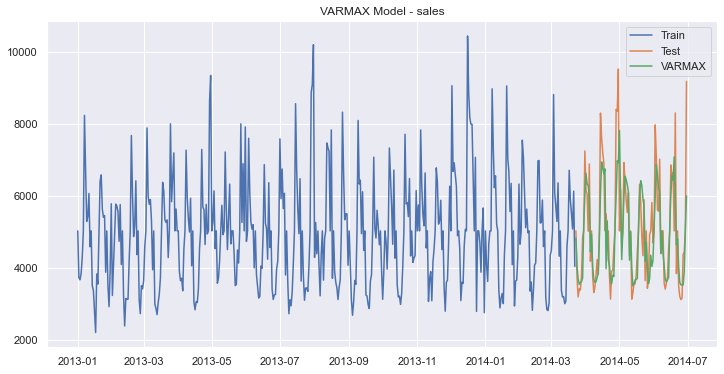

In [747]:
# plot the graph
plt.figure(figsize=(12,6)) 
plt.plot(train['sales'], label='Train')
plt.plot(test['sales'], label='Test')
plt.plot(predictions['VARMAX_forecast_Sales'], label='VARMAX')
plt.legend(loc='best')
plt.title('VARMAX Model - sales')
plt.show()

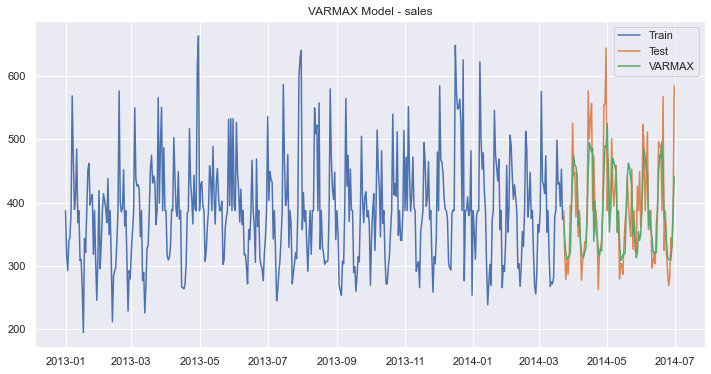

In [748]:
plt.figure(figsize=(12,6)) 
plt.plot(train['customers'], label='Train')
plt.plot(test['customers'], label='Test')
plt.plot(predictions['VARMAX_forecast_customers'], label='VARMAX')
plt.legend(loc='best')
plt.title('VARMAX Model - sales')
plt.show()

**Model Evalution**


In [749]:
# Let's calculate the rmse and MAPE
rmse = np.sqrt(mean_squared_error(test['sales'], predictions['VARMAX_forecast_Sales'])).round(2)
mape = np.round(np.mean(np.abs(test['sales']-predictions['VARMAX_forecast_Sales'])/test['sales'])*100,2)
tempResults = pd.DataFrame({'Method':['VARMAX'], 'RMSE': [rmse],'MAPE': [mape] })

In [750]:
results = pd.concat([results  , tempResults])
results = results[['Method', 'RMSE', 'MAPE']]
results

,Method,RMSE,MAPE
0,ARIMA,1081.61,14.95
0,VAR,1565.18,23.60
0,VARMAX,933.80,11.79


**VARMAX is the best model**

# Model-Store-25

In [751]:
df_new[df_new['store']==25].head()

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year,promo2,promo2_since_week,promo2_since_year,promo_interval
24,25,5,2015-07-31,14180,1586,1,1,0,1,c,a,430.0,4.0,2003.0,0,NaN,NaN,NaN
1139,25,4,2015-07-30,11272,1422,1,1,0,1,c,a,430.0,4.0,2003.0,0,NaN,NaN,NaN
2254,25,3,2015-07-29,10527,1254,1,1,0,1,c,a,430.0,4.0,2003.0,0,NaN,NaN,NaN
3369,25,2,2015-07-28,10865,1363,1,1,0,1,c,a,430.0,4.0,2003.0,0,NaN,NaN,NaN
4484,25,1,2015-07-27,11806,1536,1,1,0,1,c,a,430.0,4.0,2003.0,0,NaN,NaN,NaN


In [752]:
#Store_25
df_new_store25=df_new[df_new['store']==25]

In [753]:
# transform datatype of the variable data to datetime
df_new_store25['date'] = pd.to_datetime( df_new_store25['date'])

In [754]:
df_new_store25.info()
#Let's check the info

<class 'pandas.core.frame.DataFrame'>
Int64Index: 942 entries, 24 to 1016119
Data columns (total 18 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   store                         942 non-null    int64         
 1   day_of_week                   942 non-null    int64         
 2   date                          942 non-null    datetime64[ns]
 3   sales                         942 non-null    int64         
 4   customers                     942 non-null    int64         
 5   open                          942 non-null    int64         
 6   promo                         942 non-null    int64         
 7   state_holiday                 942 non-null    object        
 8   school_holiday                942 non-null    int64         
 9   store_type                    942 non-null    object        
 10  assortment                    942 non-null    object        
 11  competition_distance       

In [755]:
# Check NAN values
missing_count = df_new_store25.isnull().sum() # the count of missing values
value_count = df_new_store25.isnull().count() # the count of all values

missing_percentage = round(missing_count/value_count *100, 2) # the percentage of missing values
missing_df = pd.DataFrame({'missing values count': missing_count, 'percentage': missing_percentage})
missing_df

,missing values count,percentage
store,0,0.0
day_of_week,0,0.0
date,0,0.0
sales,0,0.0
customers,0,0.0
open,0,0.0
promo,0,0.0
state_holiday,0,0.0
school_holiday,0,0.0
store_type,0,0.0


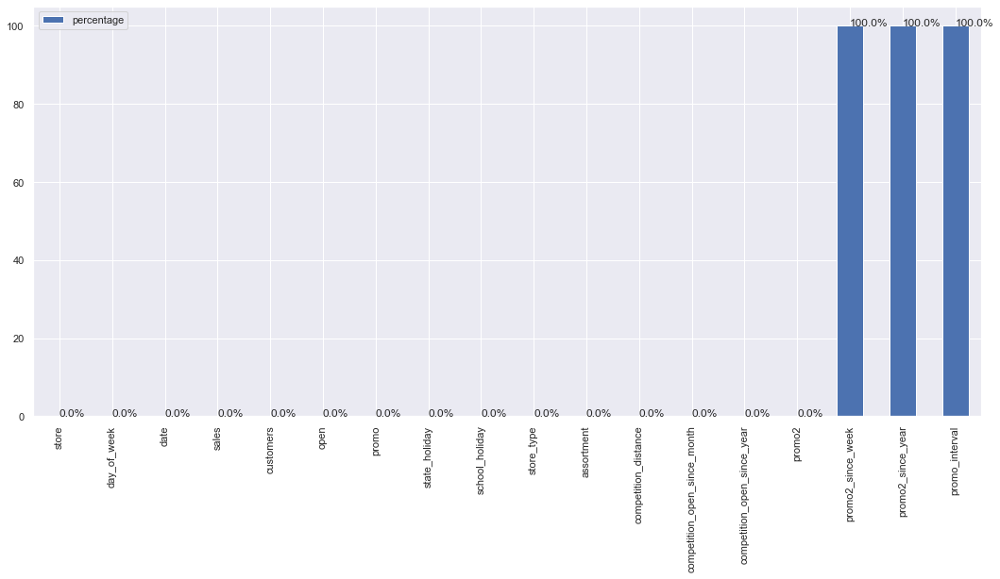

In [756]:
barchart = missing_df.plot.bar(y='percentage')
for index, percentage in enumerate( missing_percentage ):
    barchart.text( index, percentage, str(percentage)+'%')

In [757]:
#Let's drop the promo2_since_year,promo2_since_year,promo_interval
df_new_store25=df_new_store25.drop(['promo2_since_week', 'promo2_since_year','promo_interval'], axis = 1)

In [758]:
df_new_store25.columns

Index(['store', 'day_of_week', 'date', 'sales', 'customers', 'open', 'promo',
       'state_holiday', 'school_holiday', 'store_type', 'assortment',
       'competition_distance', 'competition_open_since_month',
       'competition_open_since_year', 'promo2'],
      dtype='object')

In [759]:
df_new_store25.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 942 entries, 24 to 1016119
Data columns (total 15 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   store                         942 non-null    int64         
 1   day_of_week                   942 non-null    int64         
 2   date                          942 non-null    datetime64[ns]
 3   sales                         942 non-null    int64         
 4   customers                     942 non-null    int64         
 5   open                          942 non-null    int64         
 6   promo                         942 non-null    int64         
 7   state_holiday                 942 non-null    object        
 8   school_holiday                942 non-null    int64         
 9   store_type                    942 non-null    object        
 10  assortment                    942 non-null    object        
 11  competition_distance       

In [760]:
#Change datatype
df_new_store25 = df_new_store25.astype({'competition_open_since_month':'int64', 'competition_open_since_year':'int64',})
df_new_store25.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 942 entries, 24 to 1016119
Data columns (total 15 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   store                         942 non-null    int64         
 1   day_of_week                   942 non-null    int64         
 2   date                          942 non-null    datetime64[ns]
 3   sales                         942 non-null    int64         
 4   customers                     942 non-null    int64         
 5   open                          942 non-null    int64         
 6   promo                         942 non-null    int64         
 7   state_holiday                 942 non-null    object        
 8   school_holiday                942 non-null    int64         
 9   store_type                    942 non-null    object        
 10  assortment                    942 non-null    object        
 11  competition_distance       

In [761]:
# Let's copy the dataset
df_store25 = df_new_store25.copy()

In [762]:
df_store25.head()

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year,promo2
24,25,5,2015-07-31,14180,1586,1,1,0,1,c,a,430.0,4,2003,0
1139,25,4,2015-07-30,11272,1422,1,1,0,1,c,a,430.0,4,2003,0
2254,25,3,2015-07-29,10527,1254,1,1,0,1,c,a,430.0,4,2003,0
3369,25,2,2015-07-28,10865,1363,1,1,0,1,c,a,430.0,4,2003,0
4484,25,1,2015-07-27,11806,1536,1,1,0,1,c,a,430.0,4,2003,0


**Descriptive Statistics**


In [763]:
df_store25.describe().T

,count,mean,std,min,25%,50%,75%,max
store,942.0,25.000000,0.000000,25.0,25.00,25.0,25.00,25.0
day_of_week,942.0,3.997877,1.998404,1.0,2.00,4.0,6.00,7.0
sales,942.0,8892.311040,5151.671996,0.0,7858.75,9806.0,12125.25,24882.0
customers,942.0,1250.288747,686.376385,0.0,1182.00,1456.5,1692.00,2835.0
open,942.0,0.798301,0.401481,0.0,1.00,1.0,1.00,1.0
promo,942.0,0.382166,0.486175,0.0,0.00,0.0,1.00,1.0
school_holiday,942.0,0.180467,0.384780,0.0,0.00,0.0,0.00,1.0
competition_distance,942.0,430.000000,0.000000,430.0,430.00,430.0,430.00,430.0
competition_open_since_month,942.0,4.000000,0.000000,4.0,4.00,4.0,4.00,4.0
competition_open_since_year,942.0,2003.000000,0.000000,2003.0,2003.00,2003.0,2003.00,2003.0


In [764]:
# separate numerical and categorical attributes
num_attributes = df_store25.select_dtypes( include = 'number')
cate_attributes = df_store25.select_dtypes( include = 'object')

**Numerical Attributes**


In [765]:
# Central Tendency - Mean, median
ct1 = pd.DataFrame( num_attributes.apply( np.mean ) ).T
ct2 = pd.DataFrame( num_attributes.apply( np.median ) ).T

# Dispersion - std, min, max, range, skew, kurtoisis
d1 = pd.DataFrame(num_attributes.apply( np.std )).T
d2 = pd.DataFrame(num_attributes.apply( min )).T
d3 = pd.DataFrame(num_attributes.apply( max )).T
d4 = pd.DataFrame(num_attributes.apply( lambda x: x.max() - x.min() )).T
d5 = pd.DataFrame(num_attributes.apply( lambda x: x.skew() )).T
d6 = pd.DataFrame(num_attributes.apply( lambda x: x.kurtosis() )).T

#concatenate
m = pd.concat( [d2, d3, d4, ct1, ct2, d1, d5, d6] ).T.reset_index()


m.columns = ['attributes', 'min', 'max', 'range', 'mean', 'median', 'std', 'skew', 'kurtosis']
m

,attributes,min,max,range,mean,median,std,skew,kurtosis
0,store,25.0,25.0,0.0,25.000000,25.0,0.000000,0.000000,0.000000
1,day_of_week,1.0,7.0,6.0,3.997877,4.0,1.997343,0.002127,-1.247185
2,sales,0.0,24882.0,24882.0,8892.311040,9806.0,5148.936837,-0.552010,-0.301213
3,customers,0.0,2835.0,2835.0,1250.288747,1456.5,686.011969,-0.932582,-0.372510
4,open,0.0,1.0,1.0,0.798301,1.0,0.401268,-1.489166,0.218073
5,promo,0.0,1.0,1.0,0.382166,0.0,0.485917,0.485772,-1.767783
6,school_holiday,0.0,1.0,1.0,0.180467,0.0,0.384576,1.664393,0.771837
7,competition_distance,430.0,430.0,0.0,430.000000,430.0,0.000000,0.000000,0.000000
8,competition_open_since_month,4.0,4.0,0.0,4.000000,4.0,0.000000,0.000000,0.000000
9,competition_open_since_year,2003.0,2003.0,0.0,2003.000000,2003.0,0.000000,0.000000,0.000000


**Categorical Attributes**


In [766]:
# check unique values of categorical features
cate_attributes.apply( lambda x: x.unique().shape[0])

state_holiday    5
store_type       1
assortment       1
dtype: int64

In [767]:
#Let's check the unique values
print(df_store25['state_holiday'].unique())
print(df_store25['store_type'].unique())
print(df_store25['assortment'].unique())

['0' 'a' 'b' 'c' 0]
['c']
['a']


# Exploratory data analysis(EDA)

Let’s perform EDA to gain insights into the given data.

**Univariate Analysis**

Response Variable (target)

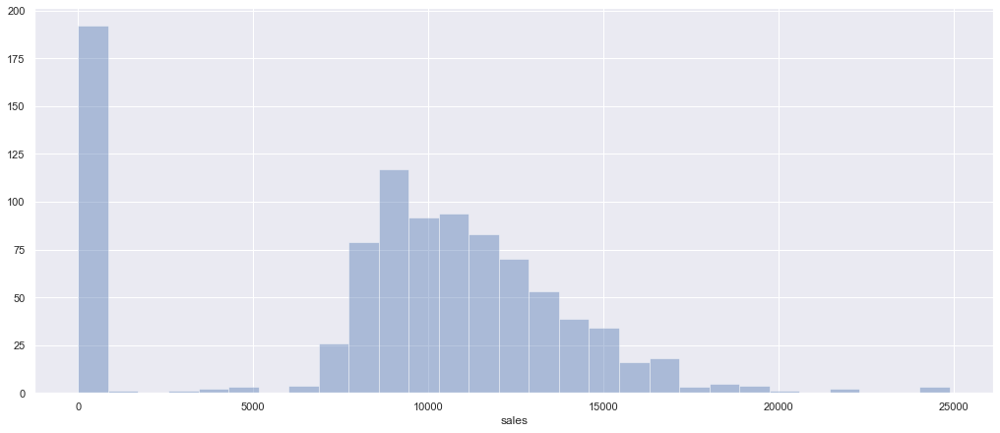

In [768]:
fig = plt.figure( figsize = (14, 6), constrained_layout=True)
sns.distplot(df_store25['sales'], kde = False);
plt.show()

 **Numerical Variable**


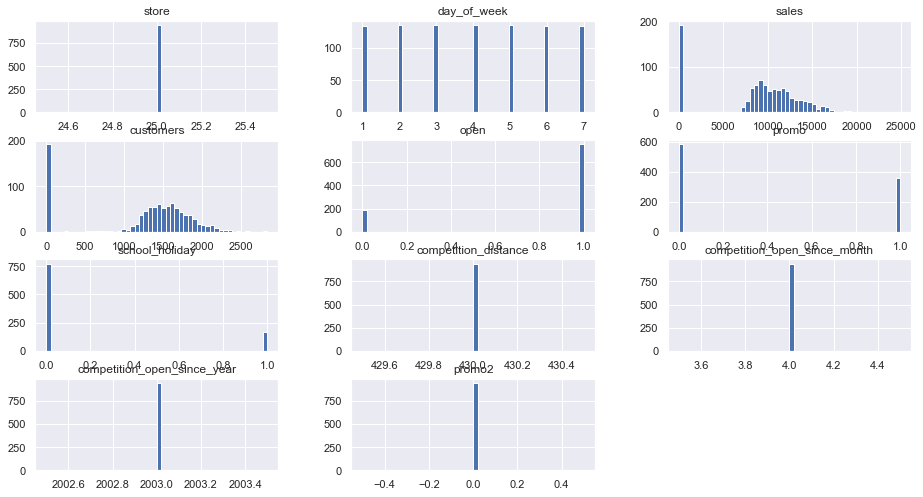

In [769]:
sns.set(rc={'figure.figsize':(15.7,8.27)})
num_attributes.hist(bins = 50);

In [770]:
df_store25['day_of_week'].value_counts()
#day of the week

5    135
4    135
3    135
2    135
7    134
6    134
1    134
Name: day_of_week, dtype: int64

In [771]:
df_store25['open'].value_counts()
# value count of store is open or not

1    752
0    190
Name: open, dtype: int64

In [772]:
df_store25['promo'].value_counts()
# value count of promo

0    582
1    360
Name: promo, dtype: int64

In [773]:
df_store25['state_holiday'].value_counts()
# value count of state_holiday

0    784
0    129
a     19
b      6
c      4
Name: state_holiday, dtype: int64

In [774]:
df_store25['store_type'].value_counts()
# value count of store_type

c    942
Name: store_type, dtype: int64

In [775]:
df_store25['assortment'].value_counts()
# value count of staassortment

a    942
Name: assortment, dtype: int64

In [776]:
df_store25['competition_distance'].value_counts()
# value count of competition_distance

430.0    942
Name: competition_distance, dtype: int64

In [777]:
df_store25['competition_open_since_month'].value_counts()
# value count of competition_open_since_month

4    942
Name: competition_open_since_month, dtype: int64

In [778]:
df_store25['competition_open_since_year'].value_counts()
# value count of competition_open_since_year

2003    942
Name: competition_open_since_year, dtype: int64

In [779]:
df_store25['promo2'].value_counts()
# value count of promo2

0    942
Name: promo2, dtype: int64

**Categorical Variable**

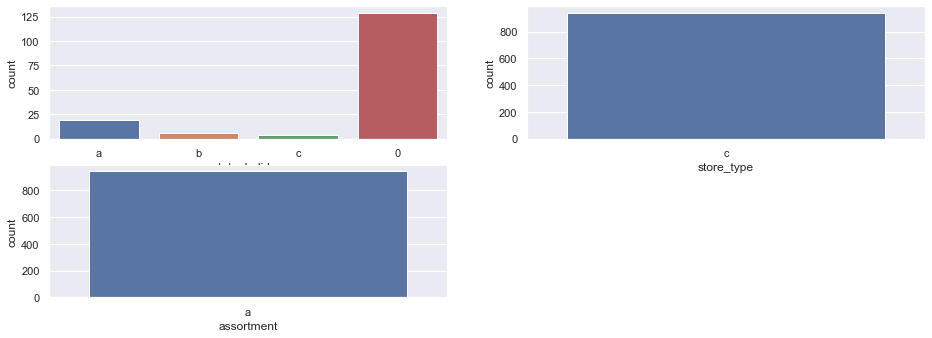

In [780]:
# state_holiday
plt.subplot(3, 2, 1)
a = df_store25[df_store25['state_holiday'] != '0']
sns.countplot(data = a, x = a['state_holiday'])

# store_type
plt.subplot(3, 2, 2)
sns.countplot(data = df_store25, x = df_store25['store_type'])

# assortment
plt.subplot(3, 2, 3)
sns.countplot(data = df_store25, x = df_store25['assortment'])

plt.show()

In [781]:
df_store25[df_store25['sales']==0]

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year,promo2
5599,25,7,2015-07-26,0,0,0,0,0,0,c,a,430.0,4,2003,0
13404,25,7,2015-07-19,0,0,0,0,0,0,c,a,430.0,4,2003,0
21209,25,7,2015-07-12,0,0,0,0,0,0,c,a,430.0,4,2003,0
29014,25,7,2015-07-05,0,0,0,0,0,0,c,a,430.0,4,2003,0
36819,25,7,2015-06-28,0,0,0,0,0,0,c,a,430.0,4,2003,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
987129,25,7,2013-01-27,0,0,0,0,0,0,c,a,430.0,4,2003,0
994934,25,7,2013-01-20,0,0,0,0,0,0,c,a,430.0,4,2003,0
1002739,25,7,2013-01-13,0,0,0,0,0,0,c,a,430.0,4,2003,0
1010544,25,7,2013-01-06,0,0,0,0,0,0,c,a,430.0,4,2003,0


In [782]:
df_store25.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 942 entries, 24 to 1016119
Data columns (total 15 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   store                         942 non-null    int64         
 1   day_of_week                   942 non-null    int64         
 2   date                          942 non-null    datetime64[ns]
 3   sales                         942 non-null    int64         
 4   customers                     942 non-null    int64         
 5   open                          942 non-null    int64         
 6   promo                         942 non-null    int64         
 7   state_holiday                 942 non-null    object        
 8   school_holiday                942 non-null    int64         
 9   store_type                    942 non-null    object        
 10  assortment                    942 non-null    object        
 11  competition_distance       


-    Sale  and customer colomns has zero values which has to be imputed

-    Store is open on 80% of days

-    80% are regular days

-    All the rows of column-store type belongs to 'c'

-    All the rows of column-assortment belongs to 'a'

-    All the rows of columns-competition_distance to 430

-    All the competition is opened since month-4

-    All the competition is opened since 2003

-    All the rows of promo2 belogs to 0

**Bivariate Analysis**

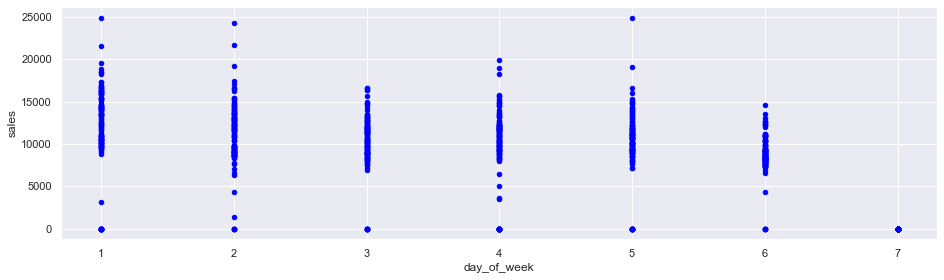

In [783]:
# lets draw a scatter plot between  Sales and day_of_week
sns.set(rc={'figure.figsize':(15.7,4.27)})
df_store25[['sales', 'day_of_week']].plot.scatter(x = 'day_of_week',y='sales',c='blue')
plt.show()

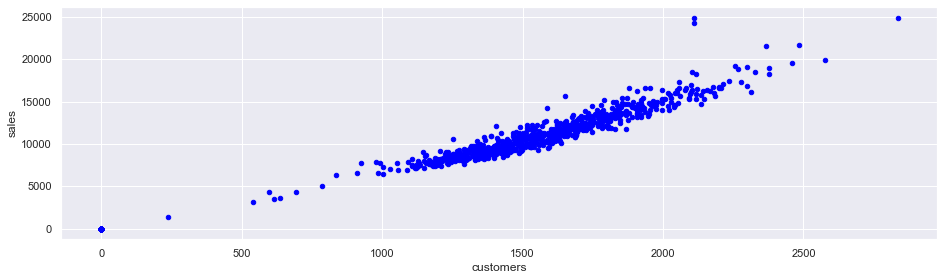

In [784]:
#Let's draw a scatter plot between Sales and Customers
df_store25[['sales', 'customers']].plot.scatter(x = 'customers',y='sales',c='blue')
plt.show()

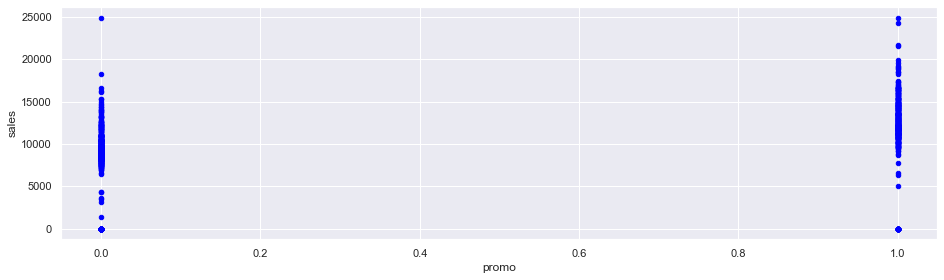

In [785]:
#Let's now draw a scatter plot between Sales and promo
df_store25[['sales', 'promo']].plot.scatter(x = 'promo',y='sales',c='blue')
plt.show()

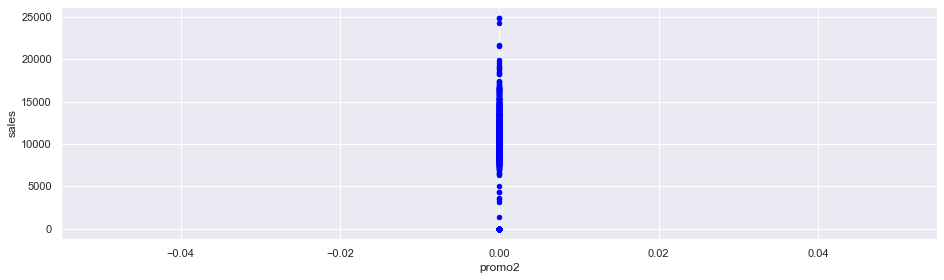

In [786]:
#Let's now draw a scatter plot between Sales and promo
df_store25[['sales', 'promo2']].plot.scatter(x = 'promo2',y='sales',c='blue')
plt.show()

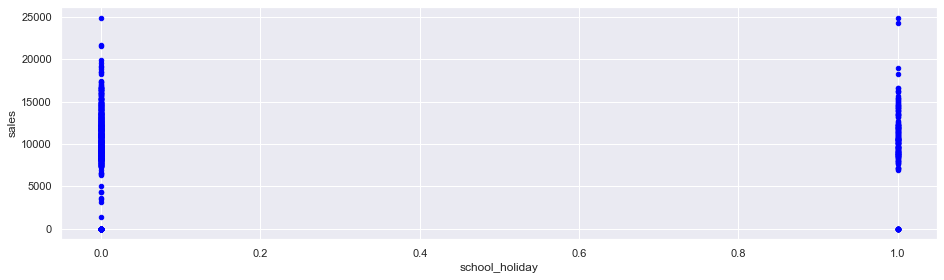

In [787]:
#lets now draw a scatter plot between  Sales and school_holiday
df_store25[['sales', 'school_holiday']].plot.scatter(x = 'school_holiday',y='sales',c='blue')
plt.show()

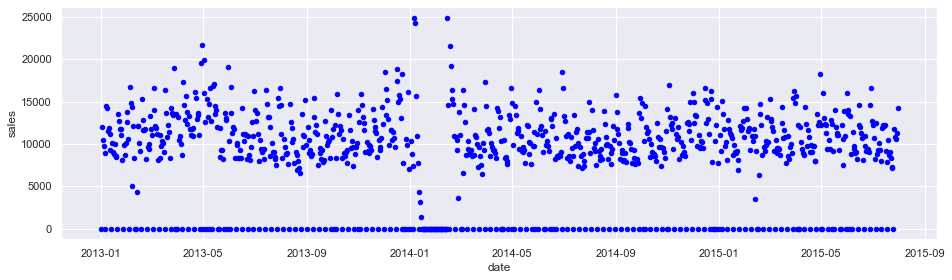

In [788]:
#lets now draw a scatter plot between Sales and date
df_store25[['sales', 'date']].plot.scatter(x = 'date',y='sales',c='blue')
plt.show()

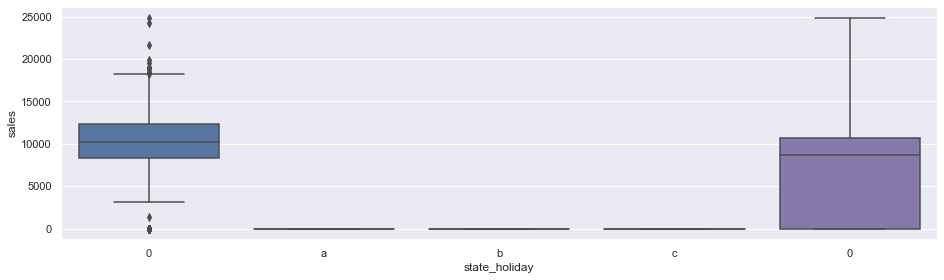

In [789]:
#Let's draw the boxplot between sales and state_holiday
sns.set(rc={'figure.figsize':(15.7,4.27)})
# create grouped boxplot 
sns.boxplot(x = df_store25['state_holiday'],
            y = df_store25['sales'])
plt.show()

**Multivariate Analysis**

**Numerical Attributes**

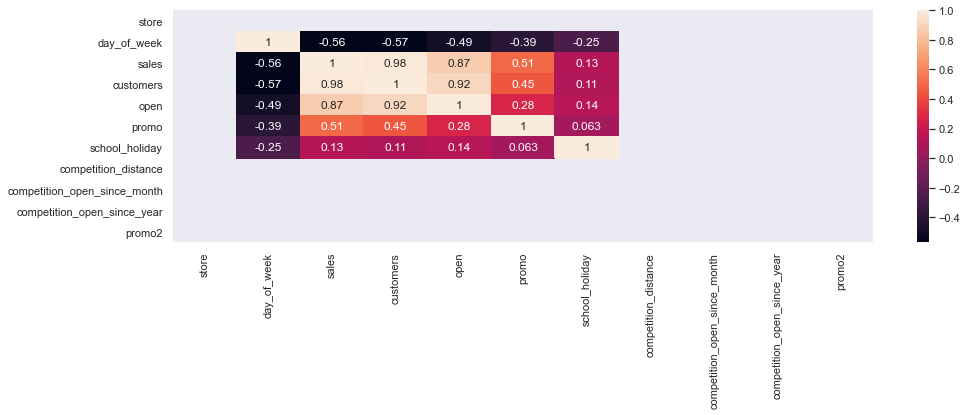

In [790]:
correlation = (num_attributes.corr( method = 'pearson' ))
sns.heatmap( correlation, annot = True );

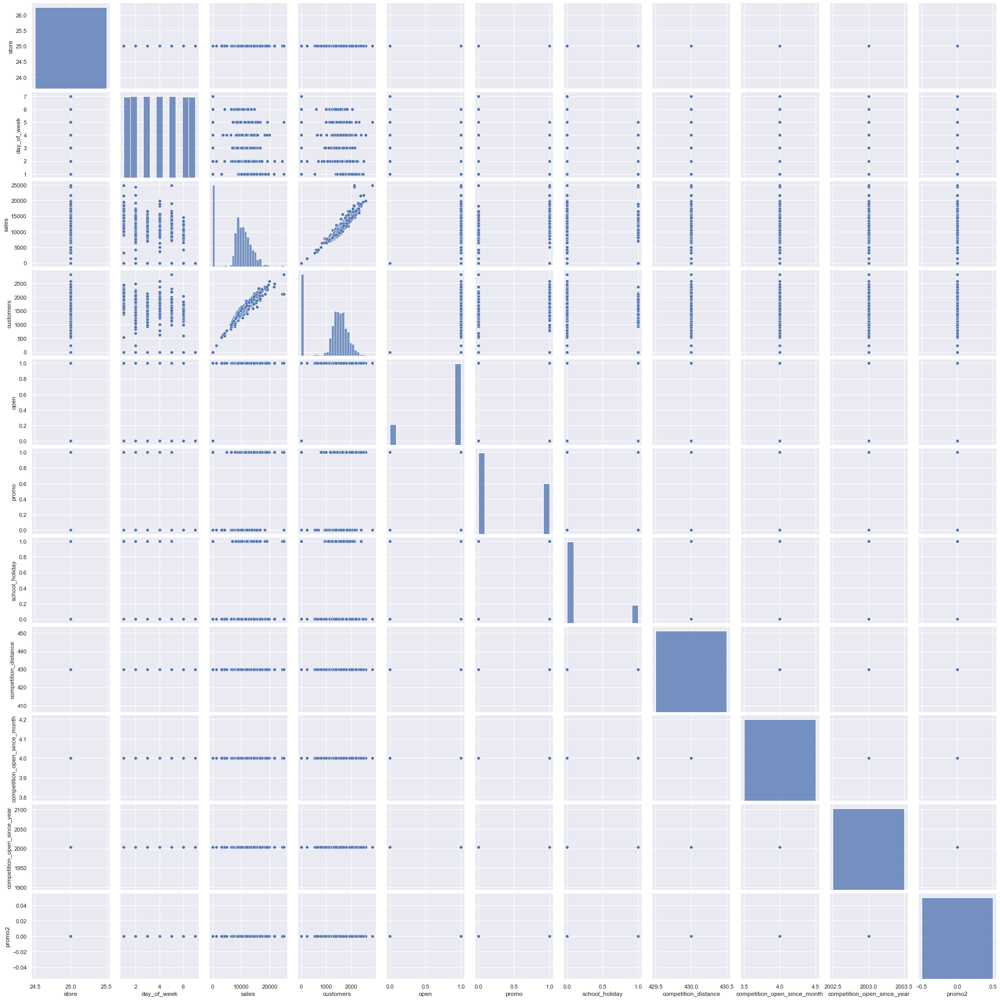

In [791]:
#pairplot with hue sales
sns.pairplot(df_store25)
# to show
plt.show()

**Some insights from EDA**

   - store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year are uncessary columns so we can remove them

   - Day1,Day2 and Day5 have higher sales than other days

   - promo is correlated to sales

   - Promo2 doesn't have any effect on sales becuase it's value is equal to 0

   - There is no sale on a = public holiday, b = Easter holiday, c = Christmas

   - There is some effect of school holiday on sales

In [792]:
# We can drop store_type,assortment,competition_distance,competition_open_since_month,promo2_since_week,promo2_since_year,promo_interval
#competition_open_since_year & promo2
df_store25_new=df_store25.drop(['store_type', 'assortment','competition_distance','competition_open_since_month','competition_open_since_year'], axis = 1)

In [793]:
df_store25_new.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 942 entries, 24 to 1016119
Data columns (total 10 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   store           942 non-null    int64         
 1   day_of_week     942 non-null    int64         
 2   date            942 non-null    datetime64[ns]
 3   sales           942 non-null    int64         
 4   customers       942 non-null    int64         
 5   open            942 non-null    int64         
 6   promo           942 non-null    int64         
 7   state_holiday   942 non-null    object        
 8   school_holiday  942 non-null    int64         
 9   promo2          942 non-null    int64         
dtypes: datetime64[ns](1), int64(8), object(1)
memory usage: 121.0+ KB


In [794]:
df_store25_new.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 942 entries, 24 to 1016119
Data columns (total 10 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   store           942 non-null    int64         
 1   day_of_week     942 non-null    int64         
 2   date            942 non-null    datetime64[ns]
 3   sales           942 non-null    int64         
 4   customers       942 non-null    int64         
 5   open            942 non-null    int64         
 6   promo           942 non-null    int64         
 7   state_holiday   942 non-null    object        
 8   school_holiday  942 non-null    int64         
 9   promo2          942 non-null    int64         
dtypes: datetime64[ns](1), int64(8), object(1)
memory usage: 121.0+ KB


In [795]:
df_store25_new.head()

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,promo2
24,25,5,2015-07-31,14180,1586,1,1,0,1,0
1139,25,4,2015-07-30,11272,1422,1,1,0,1,0
2254,25,3,2015-07-29,10527,1254,1,1,0,1,0
3369,25,2,2015-07-28,10865,1363,1,1,0,1,0
4484,25,1,2015-07-27,11806,1536,1,1,0,1,0


In [796]:
#reset index
df_store25_new=df_store25_new[::-1].reset_index()
df_store25_new.head()

,index,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,promo2
0,1016119,25,2,2013-01-01,0,0,0,0,a,1,0
1,1015004,25,3,2013-01-02,11944,1698,1,0,0,1,0
2,1013889,25,4,2013-01-03,10409,1587,1,0,0,1,0
3,1012774,25,5,2013-01-04,9729,1520,1,0,0,1,0
4,1011659,25,6,2013-01-05,8987,1381,1,0,0,0,0


In [797]:
#drop the index columns
df_store25_new=df_store25_new.drop(['index'], axis = 1)
df_store25_new.head()

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,promo2
0,25,2,2013-01-01,0,0,0,0,a,1,0
1,25,3,2013-01-02,11944,1698,1,0,0,1,0
2,25,4,2013-01-03,10409,1587,1,0,0,1,0
3,25,5,2013-01-04,9729,1520,1,0,0,1,0
4,25,6,2013-01-05,8987,1381,1,0,0,0,0


In [798]:
df_store25_new.info()
#No missing value

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 942 entries, 0 to 941
Data columns (total 10 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   store           942 non-null    int64         
 1   day_of_week     942 non-null    int64         
 2   date            942 non-null    datetime64[ns]
 3   sales           942 non-null    int64         
 4   customers       942 non-null    int64         
 5   open            942 non-null    int64         
 6   promo           942 non-null    int64         
 7   state_holiday   942 non-null    object        
 8   school_holiday  942 non-null    int64         
 9   promo2          942 non-null    int64         
dtypes: datetime64[ns](1), int64(8), object(1)
memory usage: 73.7+ KB


In [799]:
# transform datatype of the variable data to datetime
df_store25_new['date'] = pd.to_datetime(df_store25_new['date'])

In [800]:
indexed_df_store25_new = df_store25_new.set_index(['date'])
indexed_df_store25_new.head()
#Let set the date as index column

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2
date,,,,,,,,,
2013-01-01,25,2,0,0,0,0,a,1,0
2013-01-02,25,3,11944,1698,1,0,0,1,0
2013-01-03,25,4,10409,1587,1,0,0,1,0
2013-01-04,25,5,9729,1520,1,0,0,1,0
2013-01-05,25,6,8987,1381,1,0,0,0,0


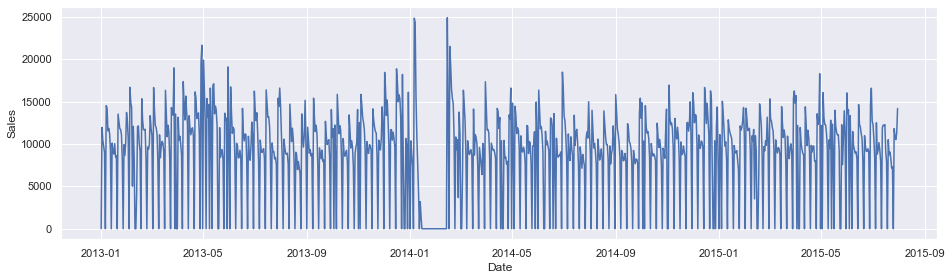

In [801]:
## plot graph
plt.xlabel('Date')
plt.ylabel('Sales')
plt.plot(indexed_df_store25_new['sales'])
plt.show()

In [802]:
#Let impute the zero values
(indexed_df_store25_new['sales']==0).sum()
# There are 192 zero value in sale column

192

In [803]:
indexed_df_store25_new['sales']=indexed_df_store25_new['sales'].replace(0, np.nan)

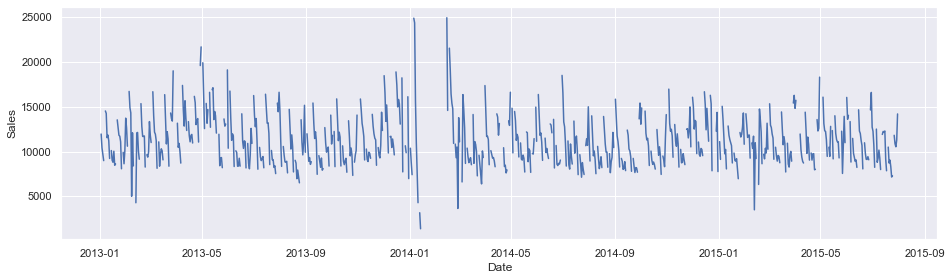

In [804]:
##plot graph
plt.xlabel('Date')
plt.ylabel('Sales')
plt.plot(indexed_df_store25_new['sales'])
plt.show()

In [805]:
#KNN imputer for filling NAN values
imputer = KNNImputer(n_neighbors=2)

In [806]:
indexed_df_store25_new['sales'] = imputer.fit_transform(np.array(indexed_df_store25_new['sales']).reshape(-1, 1))
indexed_df_store25_new['sales'].head()

date
2013-01-01    11168.742667
2013-01-02    11944.000000
2013-01-03    10409.000000
2013-01-04     9729.000000
2013-01-05     8987.000000
Name: sales, dtype: float64

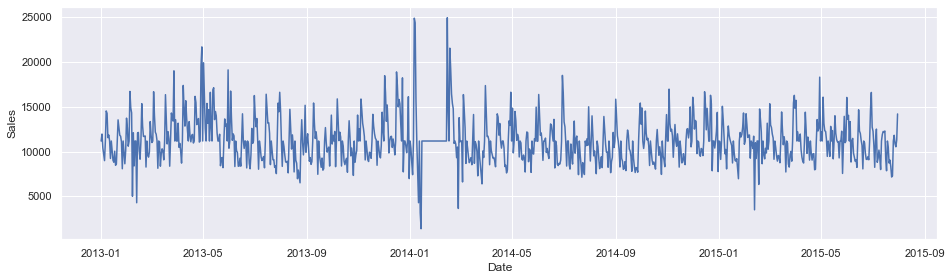

In [807]:
## plot graph
plt.xlabel('Date')
plt.ylabel('Sales')
plt.plot(indexed_df_store25_new['sales'])
plt.show()

In [808]:
(indexed_df_store25_new['sales']==25).sum()
# no missing value

0

**Outlier detection**

Box plot and interquartile range


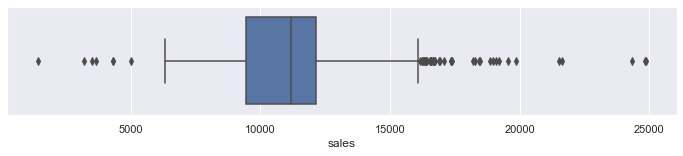

In [809]:
import seaborn as sns
fig = plt.subplots(figsize=(12, 2))
ax = sns.boxplot(x=indexed_df_store25_new['sales'],whis=1.5)
#Let treat the outliers

**Histogram**


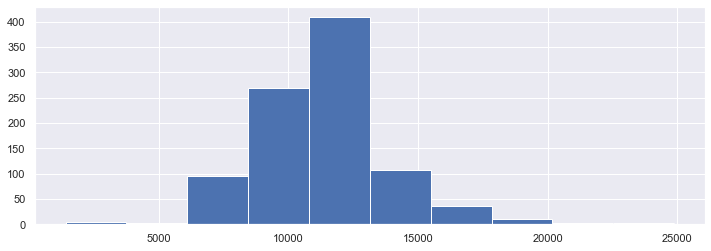

In [810]:
fig = indexed_df_store25_new['sales'].hist(figsize = (12,4))

In [811]:
percentile01 = indexed_df_store25_new['sales'].quantile(0.01)
percentile99 = indexed_df_store25_new['sales'].quantile(0.99)

In [812]:
upper_limit = percentile99
lower_limit = percentile01

In [813]:
upper_limit

18924.800000000003

In [814]:
lower_limit

6558.77

In [815]:
new_df = indexed_df_store25_new[indexed_df_store25_new['sales'] < upper_limit]
#new_df = indexed_df_store25_new[indexed_df_store25_new['sales'] > lower_limit]
new_df.shape

(932, 9)

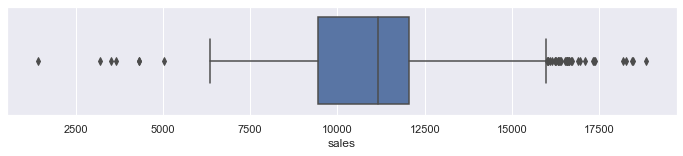

In [816]:
import seaborn as sns
fig = plt.subplots(figsize=(12, 2))
ax = sns.boxplot(x=new_df['sales'],whis=1.5)

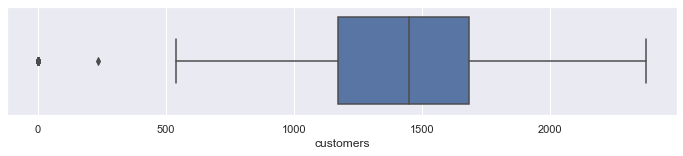

In [817]:
import seaborn as sns
fig = plt.subplots(figsize=(12, 2))
ax = sns.boxplot(x=new_df['customers'],whis=1.5)

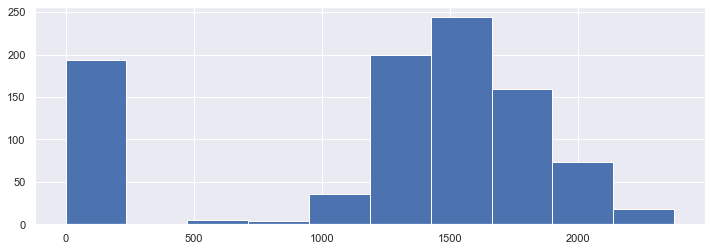

In [818]:
fig = new_df['customers'].hist(figsize = (12,4))

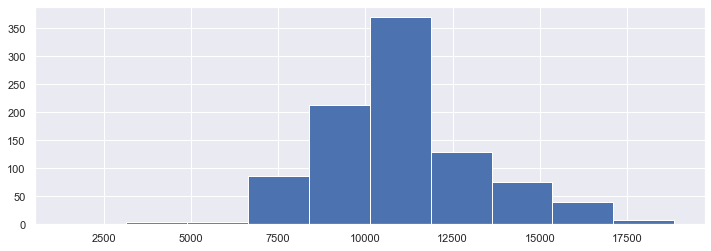

In [819]:
fig = new_df['sales'].hist(figsize = (12,4))

**ADF Stationary test**

In [820]:
def test_stationarity(timeseries):
    
    #Determine rolling statistics
    movingAverage = timeseries.rolling(window=12).mean()
    movingSTD = timeseries.rolling(window=12).std()
    
    #Plot rolling statistics
    orig = plt.plot(timeseries, color='blue', label='Original')
    mean = plt.plot(movingAverage, color='red', label='Rolling Mean')
    std = plt.plot(movingSTD, color='black', label='Rolling Std')
    plt.legend(loc='best')
    plt.title('Rolling Mean & Standard Deviation')
    plt.show(block=False)
    
    #Perform Dickey–Fuller test:
    print('Results of Dickey Fuller Test:')
    dftest = adfuller(indexed_df_store25_new['sales'], autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    for key,value in dftest[4].items():
        dfoutput['Critical Value (%s)'%key] = value
    print(dfoutput)

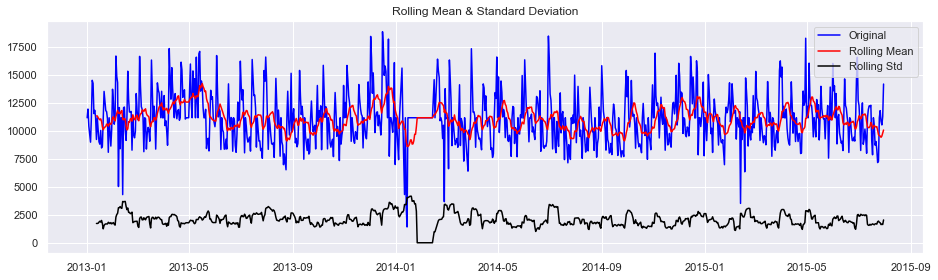

Results of Dickey Fuller Test:
Test Statistic                  -5.484273
p-value                          0.000002
#Lags Used                      22.000000
Number of Observations Used    919.000000
Critical Value (1%)             -3.437486
Critical Value (5%)             -2.864690
Critical Value (10%)            -2.568447
dtype: float64


In [821]:
test_stationarity(new_df['sales'])

- Null: Time Series is not stationary
- Alternate: Time Series is Stationary

**The p-value is less than 0.05 so The series is stationary**

In [822]:
from statsmodels.tsa.stattools import kpss
kpss_test = kpss(new_df['sales'])

print('KPSS Statistic: %f' % kpss_test[0])
print('Critical Values @ 0.05: %.2f' % kpss_test[3]['5%'])
print('p-value: %f' % kpss_test[1])

KPSS Statistic: 0.241224
Critical Values @ 0.05: 0.46
p-value: 0.100000


- Null: Time Series is not stationary
- Alternate: Time Series is Stationary
    
**The p-value is greater than 0.05 so The series is stationary**

# Let's take the log of sales to Standardize the sales values

In [823]:
new_df.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2
date,,,,,,,,,
2013-01-01,25,2,11168.742667,0,0,0,a,1,0
2013-01-02,25,3,11944.000000,1698,1,0,0,1,0
2013-01-03,25,4,10409.000000,1587,1,0,0,1,0
2013-01-04,25,5,9729.000000,1520,1,0,0,1,0
2013-01-05,25,6,8987.000000,1381,1,0,0,0,0


In [824]:
#Log Transformation
new_df['sales_log'] = np.log(new_df['sales'])
new_df

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log
date,,,,,,,,,,
2013-01-01,25,2,11168.742667,0,0,0,a,1,0,9.320874
2013-01-02,25,3,11944.000000,1698,1,0,0,1,0,9.387984
2013-01-03,25,4,10409.000000,1587,1,0,0,1,0,9.250426
2013-01-04,25,5,9729.000000,1520,1,0,0,1,0,9.182866
2013-01-05,25,6,8987.000000,1381,1,0,0,0,0,9.103534
...,...,...,...,...,...,...,...,...,...,...
2015-07-27,25,1,11806.000000,1536,1,1,0,1,0,9.376363
2015-07-28,25,2,10865.000000,1363,1,1,0,1,0,9.293302
2015-07-29,25,3,10527.000000,1254,1,1,0,1,0,9.261699


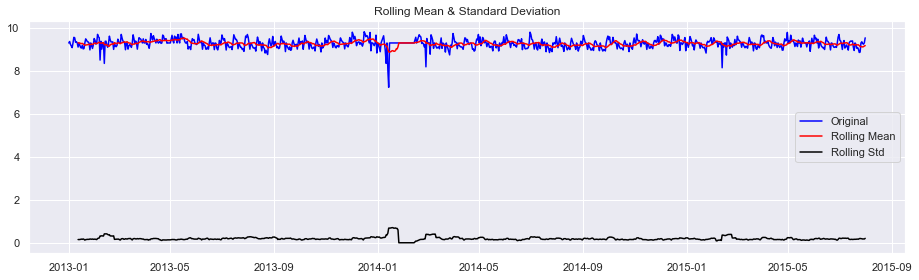

Results of Dickey Fuller Test:
Test Statistic                  -5.484273
p-value                          0.000002
#Lags Used                      22.000000
Number of Observations Used    919.000000
Critical Value (1%)             -3.437486
Critical Value (5%)             -2.864690
Critical Value (10%)            -2.568447
dtype: float64


In [825]:
test_stationarity(new_df['sales_log'])

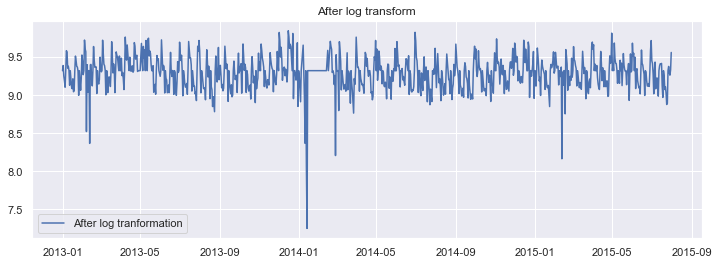

In [826]:
#After Log Transformation
plt.figure(figsize=(12,4))
plt.plot(new_df['sales_log'], label='After log tranformation')
plt.legend(loc='best')
plt.title('After log transform')
plt.show()

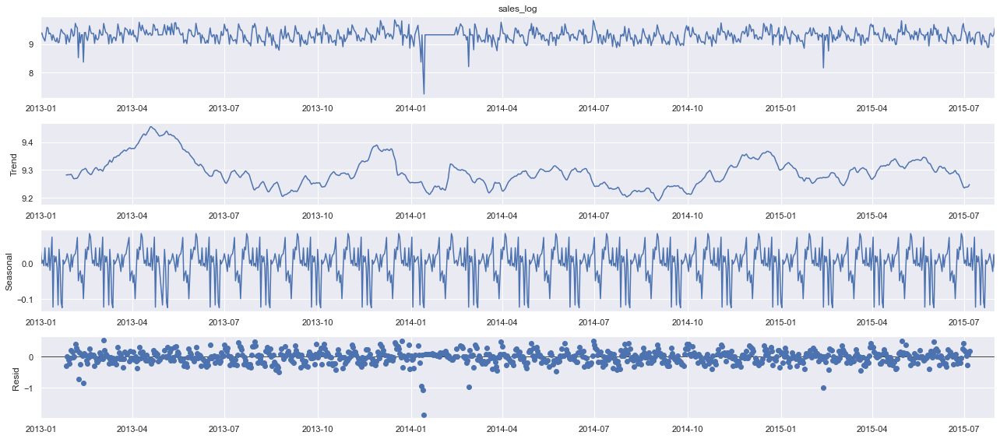

In [827]:
from matplotlib.pyplot import rcParams
rcParams['figure.figsize'] = 18,8
decomposition = sm.tsa.seasonal_decompose(new_df['sales_log'], model = "additive",period=50)
fig = decomposition.plot()

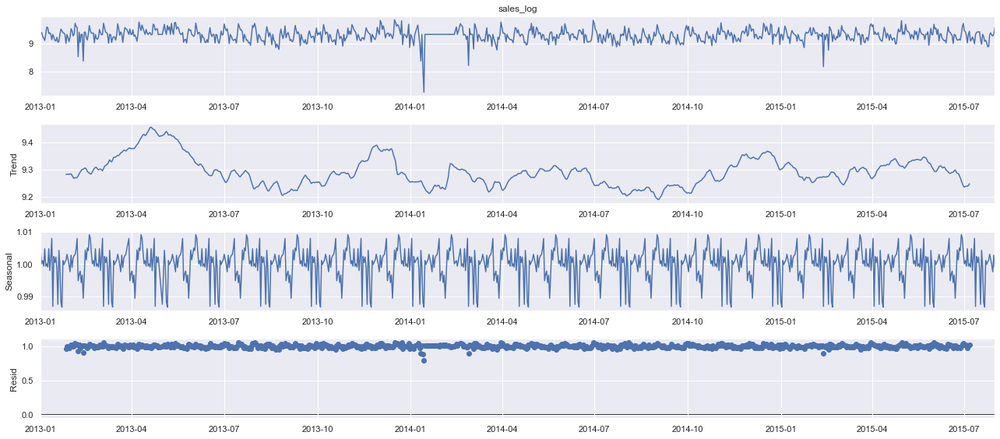

In [828]:
from matplotlib.pyplot import rcParams
rcParams['figure.figsize'] = 18,8
decomposition = sm.tsa.seasonal_decompose(new_df['sales_log'], model = "multiplicative",period=50)
fig = decomposition.plot()

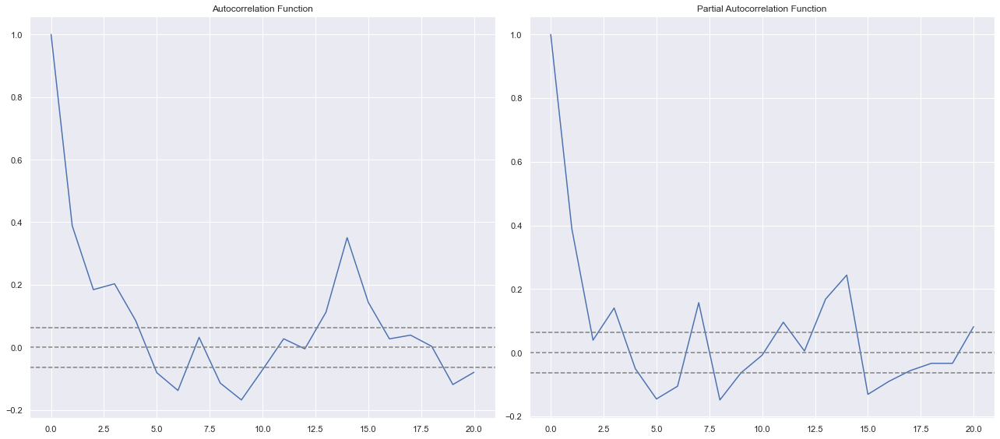

In [829]:
#ACF & PACF plots

lag_acf = acf(new_df['sales_log'], nlags=20) # MA 
lag_pacf = pacf(new_df['sales_log'], nlags=20, method='ols')  # AR 

#Plot ACF:
plt.subplot(121)
plt.plot(lag_acf)
plt.axhline(y=0, linestyle='--', color='gray')
plt.axhline(y=-1.96/np.sqrt(len(new_df['sales_log'])), linestyle='--', color='gray')
plt.axhline(y=1.96/np.sqrt(len(new_df['sales_log'])), linestyle='--', color='gray')
plt.title('Autocorrelation Function')            

#Plot PACF
plt.subplot(122)
plt.plot(lag_pacf)
plt.axhline(y=0, linestyle='--', color='gray')
plt.axhline(y=-1.96/np.sqrt(len(new_df['sales_log'])), linestyle='--', color='gray')
plt.axhline(y=1.96/np.sqrt(len(new_df['sales_log'])), linestyle='--', color='gray')
plt.title('Partial Autocorrelation Function')
            
plt.tight_layout() 

From the ACF graph, we see that curve touches y=0.0 line at x=4. Thus, from theory, Q = 4 From the PACF graph, we see that curve touches y=0.0 line at x=4. Thus, from theory, P = 4


**Build and evaluate time series forecast**

Split time series data into training and test set


In [830]:
train_len = 750
train = new_df['sales'][0:train_len] # first 750days as training set
test = new_df['sales'][train_len:] # last 182 days as out-of-time test set

In [831]:
print(train.shape)
print(test.shape)

(750,)
(182,)


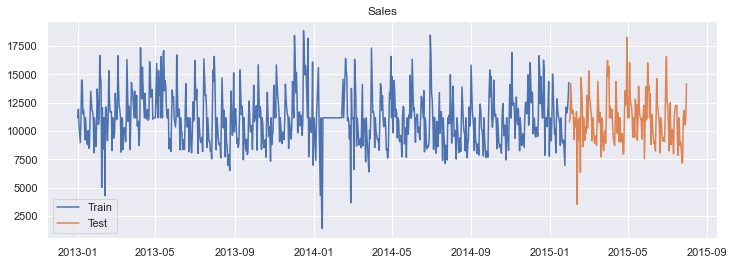

In [832]:
plt.figure(figsize=(12,4))
plt.plot(train, label='Train')
plt.plot(test, label='Test')
plt.legend(loc='best')
plt.title('Sales')
plt.show()

In [833]:
model = ARIMA(new_df['sales_log'], order=(2, 0, 2))
model_fit = model.fit()
print(model_fit.params)

const              9.288991
ar.L1.sales_log   -0.084259
ar.L2.sales_log    0.453973
ma.L1.sales_log    0.475716
ma.L2.sales_log   -0.293655
dtype: float64


In [834]:
new_df['ar_forecast_Log'] = model_fit.predict(new_df.index.min(), new_df.index.max())
new_df['arima_forecast'] = np.exp(new_df['ar_forecast_Log'])
new_df['arima_forecast']

date
2013-01-01    10818.258769
2013-01-02    10954.870688
2013-01-03    11245.970725
2013-01-04    10682.145202
2013-01-05    10497.741179
                  ...     
2015-07-27    10629.947277
2015-07-28    10778.683855
2015-07-29    10951.946526
2015-07-30    10636.845732
2015-07-31    11073.946302
Name: arima_forecast, Length: 932, dtype: float64

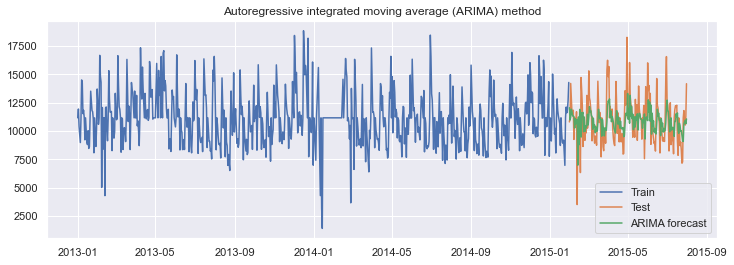

In [835]:
plt.figure(figsize=(12,4))
plt.plot(train, label='Train')
plt.plot(test, label='Test')
plt.plot(new_df['arima_forecast'][test.index.min():], label='ARIMA forecast')
plt.legend(loc='best')
plt.title('Autoregressive integrated moving average (ARIMA) method')
plt.show()

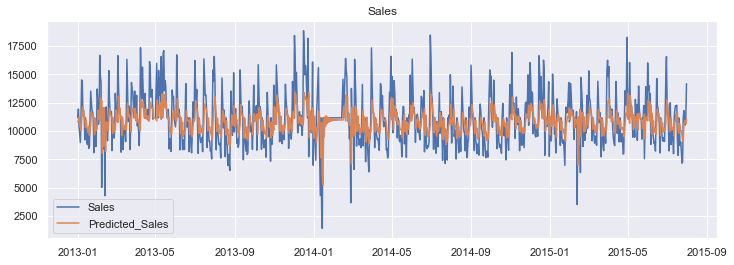

In [836]:
# plot the arima forecasting & Original series
plt.figure(figsize=(12,4))
plt.plot(new_df['sales'], label='Sales')
plt.plot(new_df['arima_forecast'], label='Predicted_Sales')
plt.legend(loc='best')
plt.title('Sales')
plt.show()

**Model Evalution**

In [837]:
from sklearn.metrics import mean_squared_error
rmse = np.sqrt(mean_squared_error(test, new_df['arima_forecast'][test.index.min():])).round(2)
mape = np.round(np.mean(np.abs(test-new_df['arima_forecast'][test.index.min():])/test)*100,2)
Results = pd.DataFrame({'Method':['ARIMA'], 'RMSE': [rmse],'MAPE': [mape] })
Results

,Method,RMSE,MAPE
0,ARIMA,1950.91,14.2


**VAR model**

In [838]:
#Load the dataset
new_df.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast
date,,,,,,,,,,,,
2013-01-01,25,2,11168.742667,0,0,0,a,1,0,9.320874,9.288991,10818.258769
2013-01-02,25,3,11944.000000,1698,1,0,0,1,0,9.387984,9.301539,10954.870688
2013-01-03,25,4,10409.000000,1587,1,0,0,1,0,9.250426,9.327765,11245.970725
2013-01-04,25,5,9729.000000,1520,1,0,0,1,0,9.182866,9.276329,10682.145202
2013-01-05,25,6,8987.000000,1381,1,0,0,0,0,9.103534,9.258915,10497.741179


**Split the dataset to training & testing**


In [839]:
#split the dataset
nobs = 182
train, test = new_df[0:-nobs], new_df[-nobs:]

# Check size
print(train.shape)
print(test.shape) 

(750, 12)
(182, 12)


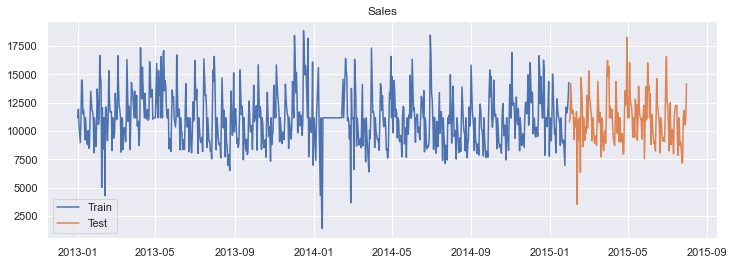

In [840]:
plt.figure(figsize=(12,4))
plt.plot(train['sales'], label='Train')
plt.plot(test['sales'], label='Test')
plt.legend(loc='best')
plt.title('Sales')
plt.show()

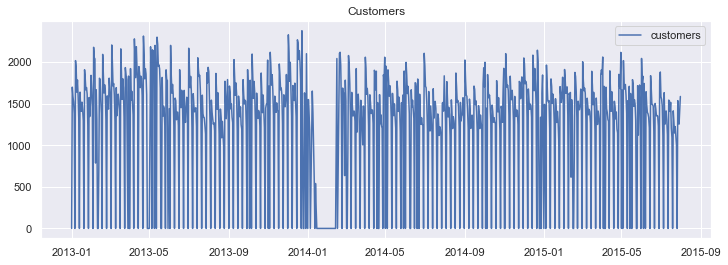

In [841]:
#plot the arima forecasting & Original series
plt.figure(figsize=(12,4))
plt.plot(new_df['customers'],label='customers')
plt.legend(loc='best')
plt.title('Customers')
plt.show()

In [842]:
(new_df['customers']==0).sum()

192

In [843]:
#impute the NAN values
new_df['customers']=new_df['customers'].replace(0, np.nan)

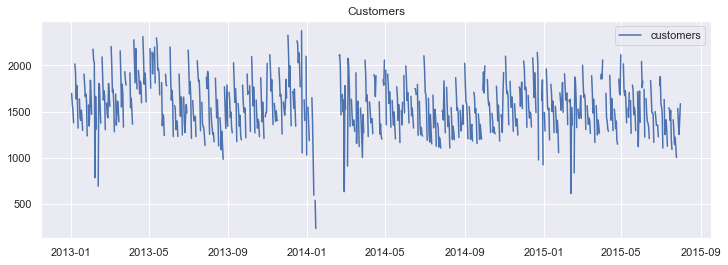

In [844]:
#plot the arima forecasting & Original series
plt.figure(figsize=(12,4))
plt.plot(new_df['customers'],label='customers')
plt.legend(loc='best')
plt.title('Customers')
plt.show()

In [845]:
#KNN imputer for filling NAN values
imputer = KNNImputer(n_neighbors=2)

In [846]:
new_df['customers'] = imputer.fit_transform(np.array(new_df['customers']).reshape(-1, 1))
new_df['customers'].head()

date
2013-01-01    1559.32027
2013-01-02    1698.00000
2013-01-03    1587.00000
2013-01-04    1520.00000
2013-01-05    1381.00000
Name: customers, dtype: float64

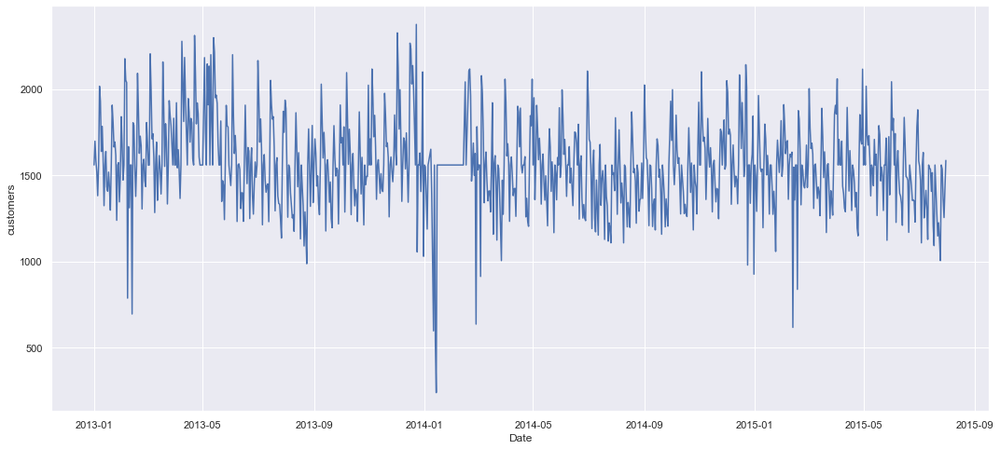

In [847]:
## plot graph
plt.xlabel('Date')
plt.ylabel('customers')
plt.plot(new_df['customers'])
plt.show()

In [848]:
new_df.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast
date,,,,,,,,,,,,
2013-01-01,25,2,11168.742667,1559.32027,0,0,a,1,0,9.320874,9.288991,10818.258769
2013-01-02,25,3,11944.000000,1698.00000,1,0,0,1,0,9.387984,9.301539,10954.870688
2013-01-03,25,4,10409.000000,1587.00000,1,0,0,1,0,9.250426,9.327765,11245.970725
2013-01-04,25,5,9729.000000,1520.00000,1,0,0,1,0,9.182866,9.276329,10682.145202
2013-01-05,25,6,8987.000000,1381.00000,1,0,0,0,0,9.103534,9.258915,10497.741179


**ADF test**


In [849]:
def test_stationarity(timeseries):
    
    #Determine rolling statistics
    movingAverage = timeseries.rolling(window=12).mean()
    movingSTD = timeseries.rolling(window=12).std()
    
    #Plot rolling statistics
    orig = plt.plot(timeseries, color='blue', label='Original')
    mean = plt.plot(movingAverage, color='red', label='Rolling Mean')
    std = plt.plot(movingSTD, color='black', label='Rolling Std')
    plt.legend(loc='best')
    plt.title('Rolling Mean & Standard Deviation')
    plt.show(block=False)
    
    #Perform Dickey–Fuller test:
    print('Results of Dickey Fuller Test:')
    dftest = adfuller(new_df['customers'], autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    for key,value in dftest[4].items():
        dfoutput['Critical Value (%s)'%key] = value
    print(dfoutput)

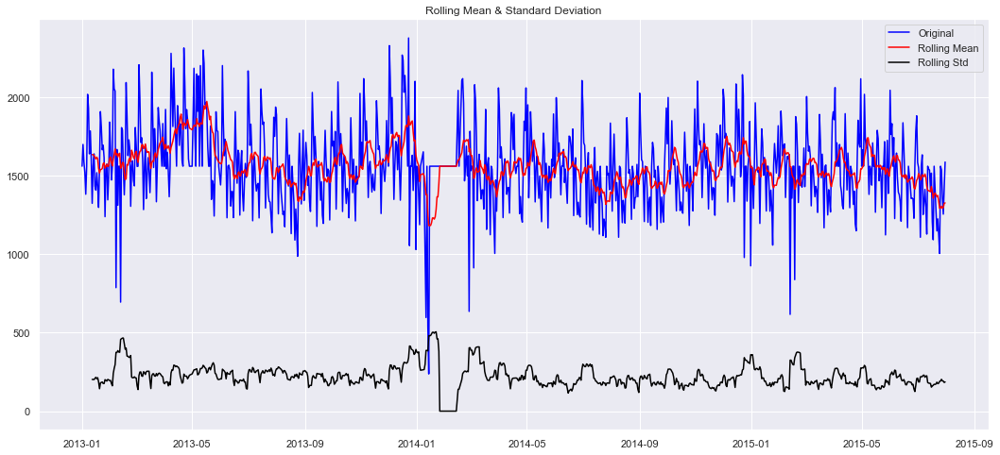

Results of Dickey Fuller Test:
Test Statistic                  -4.624408
p-value                          0.000116
#Lags Used                      21.000000
Number of Observations Used    910.000000
Critical Value (1%)             -3.437556
Critical Value (5%)             -2.864721
Critical Value (10%)            -2.568464
dtype: float64


In [850]:
test_stationarity(new_df['customers'])

- Null: Time Series is not stationary
- Alternate: Time Series is Stationary

**The p-value is less than 0.05 so The series is stationary**

In [851]:
from statsmodels.tsa.stattools import kpss
kpss_test = kpss(new_df['customers'])

print('KPSS Statistic: %f' % kpss_test[0])
print('Critical Values @ 0.05: %.2f' % kpss_test[3]['5%'])
print('p-value: %f' % kpss_test[1])

KPSS Statistic: 0.810743
Critical Values @ 0.05: 0.46
p-value: 0.010000


- Null: Time Series is not stationary
- Alternate: Time Series is Stationary

**The p-value is greater than 0.05 so The series is stationary**


**Let's use Log transformation to make mean & variance constant**


In [852]:
#Log Transformation
new_df['customers_log'] = np.log(new_df['customers'])
new_df

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast,customers_log
date,,,,,,,,,,,,,
2013-01-01,25,2,11168.742667,1559.32027,0,0,a,1,0,9.320874,9.288991,10818.258769,7.352005
2013-01-02,25,3,11944.000000,1698.00000,1,0,0,1,0,9.387984,9.301539,10954.870688,7.437206
2013-01-03,25,4,10409.000000,1587.00000,1,0,0,1,0,9.250426,9.327765,11245.970725,7.369601
2013-01-04,25,5,9729.000000,1520.00000,1,0,0,1,0,9.182866,9.276329,10682.145202,7.326466
2013-01-05,25,6,8987.000000,1381.00000,1,0,0,0,0,9.103534,9.258915,10497.741179,7.230563
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2015-07-27,25,1,11806.000000,1536.00000,1,1,0,1,0,9.376363,9.271431,10629.947277,7.336937
2015-07-28,25,2,10865.000000,1363.00000,1,1,0,1,0,9.293302,9.285326,10778.683855,7.217443
2015-07-29,25,3,10527.000000,1254.00000,1,1,0,1,0,9.261699,9.301272,10951.946526,7.134094


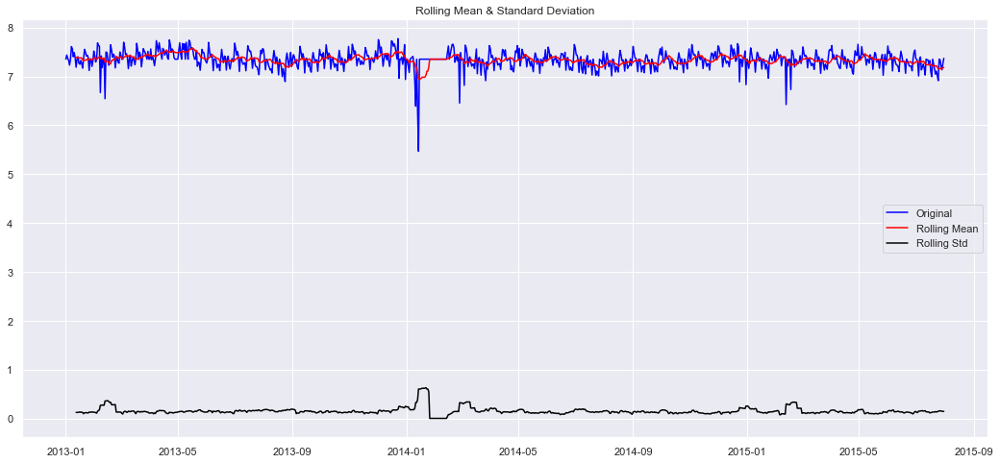

Results of Dickey Fuller Test:
Test Statistic                  -4.624408
p-value                          0.000116
#Lags Used                      21.000000
Number of Observations Used    910.000000
Critical Value (1%)             -3.437556
Critical Value (5%)             -2.864721
Critical Value (10%)            -2.568464
dtype: float64


In [853]:
test_stationarity(new_df['customers_log'])

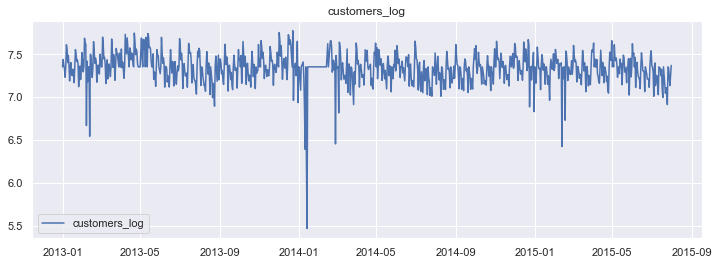

In [854]:
#plot the arima Log series
plt.figure(figsize=(12,4))
plt.plot(new_df['customers_log'],label='customers_log')
plt.legend(loc='best')
plt.title('customers_log')
plt.show()

In [855]:
#Let's check the info
new_df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 932 entries, 2013-01-01 to 2015-07-31
Data columns (total 13 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   store            932 non-null    int64  
 1   day_of_week      932 non-null    int64  
 2   sales            932 non-null    float64
 3   customers        932 non-null    float64
 4   open             932 non-null    int64  
 5   promo            932 non-null    int64  
 6   state_holiday    932 non-null    object 
 7   school_holiday   932 non-null    int64  
 8   promo2           932 non-null    int64  
 9   sales_log        932 non-null    float64
 10  ar_forecast_Log  932 non-null    float64
 11  arima_forecast   932 non-null    float64
 12  customers_log    932 non-null    float64
dtypes: float64(6), int64(6), object(1)
memory usage: 141.9+ KB


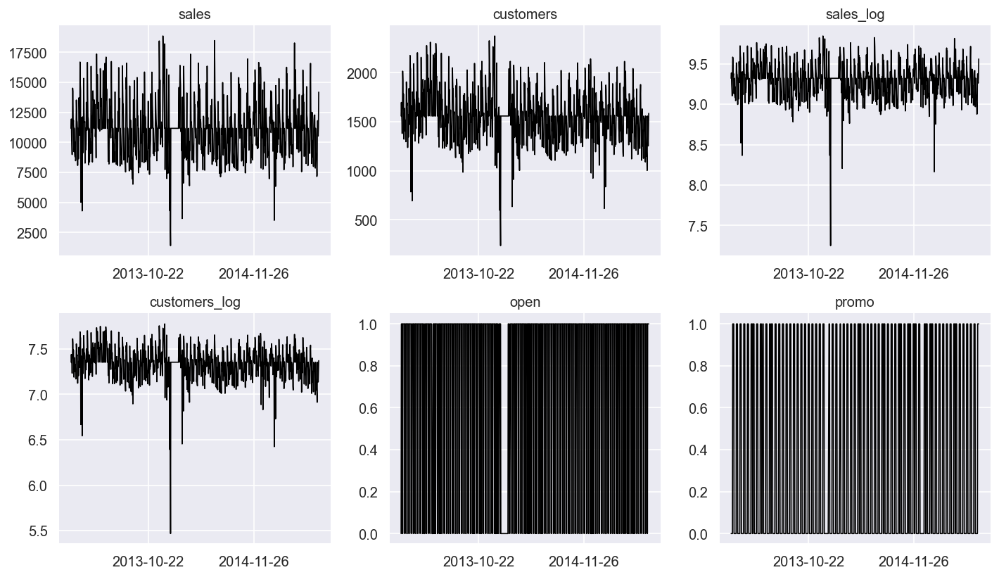

In [856]:
# Plot
ls=['sales','customers','sales_log','customers_log','open','promo','state_holiday','promo2','school_holiday']
df=new_df[ls]
fig, axes = plt.subplots(nrows=2, ncols=3, dpi=120, figsize=(12,7))
for i, ax in enumerate(axes.flatten()):
        ax.plot(df[df.columns[i]], color='black', linewidth=1)
        ax.xaxis.set_major_locator(plt.MaxNLocator(3))
        # Decorations
        ax.set_title(df.columns[i])
        ax.xaxis.set_ticks_position('none')
        ax.yaxis.set_ticks_position('none')
        ax.spines["top"].set_alpha(0)
        ax.tick_params(labelsize=12)

plt.tight_layout();

In [857]:
new_df.columns

Index(['store', 'day_of_week', 'sales', 'customers', 'open', 'promo',
       'state_holiday', 'school_holiday', 'promo2', 'sales_log',
       'ar_forecast_Log', 'arima_forecast', 'customers_log'],
      dtype='object')

In [858]:
new_df1=new_df[['sales_log', 'customers_log']]
new_df1

,sales_log,customers_log
date,,
2013-01-01,9.320874,7.352005
2013-01-02,9.387984,7.437206
2013-01-03,9.250426,7.369601
2013-01-04,9.182866,7.326466
2013-01-05,9.103534,7.230563
...,...,...
2015-07-27,9.376363,7.336937
2015-07-28,9.293302,7.217443
2015-07-29,9.261699,7.134094


In [859]:
#Let's create a model
model = VAR(new_df1)
for i in [1,2,3,4,5]:
    result = model.fit(i)
    print('Lag Order =', i)
    print('AIC : ', result.aic)
    print('BIC : ', result.bic)
    print('FPE : ', result.fpe)
    print('HQIC: ', result.hqic, '\n')

Lag Order = 1
AIC :  -9.512717230515774
BIC :  -9.481549071908187
FPE :  7.390595244920688e-05
HQIC:  -9.500830132435228 

Lag Order = 2
AIC :  -9.53071830414248
BIC :  -9.478727072033369
FPE :  7.258748042548126e-05
HQIC:  -9.510888551974064 

Lag Order = 3
AIC :  -9.614356947342923
BIC :  -9.541507084755846
FPE :  6.676334357508933e-05
HQIC:  -9.586570155286607 

Lag Order = 4
AIC :  -9.629585856106221
BIC :  -9.535841706116834
FPE :  6.575435589224836e-05
HQIC:  -9.593827596888415 

Lag Order = 5
AIC :  -9.64598823995727
BIC :  -9.531314045305221
FPE :  6.46846902005054e-05
HQIC:  -9.602244044667545 



In [860]:
x = model.select_order(maxlags=5)
x.summary()

,AIC,BIC,FPE,HQIC
0,-9.049,-9.038,0.0001175,-9.045
1,-9.508,-9.476,7.428e-05,-9.496
2,-9.528,-9.476,7.280e-05,-9.508
3,-9.612,-9.539*,6.695e-05,-9.584
4,-9.628,-9.534,6.589e-05,-9.592
5,-9.646*,-9.531,6.468e-05*,-9.602*


In [861]:
#Let's fit the model
model_fitted = model.fit()
model_fitted.summary()

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Mon, 17, Jan, 2022
Time:                     16:24:20
--------------------------------------------------------------------
No. of Equations:         2.00000    BIC:                   -9.48155
Nobs:                     931.000    HQIC:                  -9.50083
Log likelihood:           1792.11    FPE:                7.39060e-05
AIC:                     -9.51272    Det(Omega_mle):     7.34319e-05
--------------------------------------------------------------------
Results for equation sales_log
                      coefficient       std. error           t-stat            prob
-----------------------------------------------------------------------------------
const                    5.724988         0.274523           20.854           0.000
L1.sales_log             1.095451         0.107645           10.176           0.000
L1.customers_log        -0.901033         0.

In [862]:
# Get the lag order
lag_order = model_fitted.k_ar
print(lag_order)  #> 4

1


In [863]:
# Input data for forecasting
forecast_input = new_df1.values[-lag_order:]
forecast_input

array([[9.5595878, 7.3689704]])

In [864]:
# Input data for forecasting
forecast_input = new_df1.values[-lag_order:]
forecast_input

array([[9.5595878, 7.3689704]])

In [865]:
# Forecast
fc = model_fitted.forecast(y=forecast_input, steps=182)
df_forecast = pd.DataFrame(fc, index=new_df.index[-182:], columns=new_df1.columns + '_2d')
df_forecast

,sales_log_2d,customers_log_2d
date,,
2015-01-31,9.557358,7.461708
2015-02-01,9.471355,7.438128
2015-02-02,9.398390,7.402033
2015-02-03,9.350982,7.375314
2015-02-04,9.323125,7.358746
...,...,...
2015-07-27,9.289361,7.337869
2015-07-28,9.289361,7.337869
2015-07-29,9.289361,7.337869


In [866]:
df_forecast['VAR_forecast_Sales'] = np.exp(df_forecast['sales_log_2d'])
df_forecast['VAR_forecast_customers'] = np.exp(df_forecast['customers_log_2d'])
df_forecast

,sales_log_2d,customers_log_2d,VAR_forecast_Sales,VAR_forecast_customers
date,,,,
2015-01-31,9.557358,7.461708,14148.411948,1740.118078
2015-02-01,9.471355,7.438128,12982.463961,1699.565095
2015-02-02,9.398390,7.402033,12068.931627,1639.314342
2015-02-03,9.350982,7.375314,11510.125666,1596.092280
2015-02-04,9.323125,7.358746,11193.912308,1569.866482
...,...,...,...,...
2015-07-27,9.289361,7.337869,10822.268632,1537.432329
2015-07-28,9.289361,7.337869,10822.268632,1537.432329
2015-07-29,9.289361,7.337869,10822.268632,1537.432329


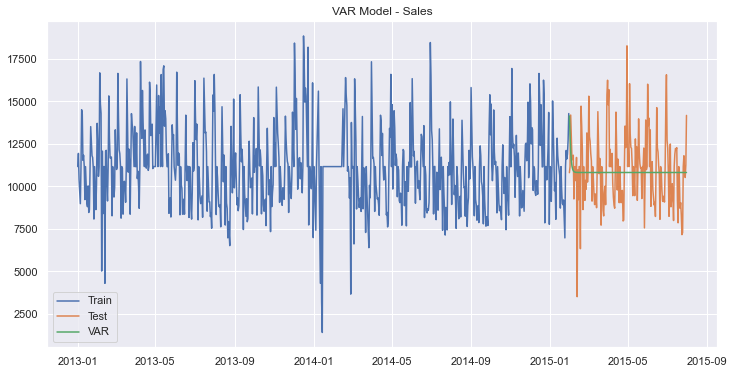

In [867]:
plt.figure(figsize=(12,6)) 
plt.plot(train['sales'], label='Train')
plt.plot(test['sales'], label='Test')
plt.plot(df_forecast['VAR_forecast_Sales'], label='VAR')
plt.legend(loc='best')
plt.title('VAR Model - Sales')
plt.show()

In [868]:
train_len = 750
train1 = new_df[0:train_len] # first 750days as training set
test1 = new_df[train_len:] # last 42 days as out-of-time test set

In [869]:
train1

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast,customers_log
date,,,,,,,,,,,,,
2013-01-01,25,2,11168.742667,1559.32027,0,0,a,1,0,9.320874,9.288991,10818.258769,7.352005
2013-01-02,25,3,11944.000000,1698.00000,1,0,0,1,0,9.387984,9.301539,10954.870688,7.437206
2013-01-03,25,4,10409.000000,1587.00000,1,0,0,1,0,9.250426,9.327765,11245.970725,7.369601
2013-01-04,25,5,9729.000000,1520.00000,1,0,0,1,0,9.182866,9.276329,10682.145202,7.326466
2013-01-05,25,6,8987.000000,1381.00000,1,0,0,0,0,9.103534,9.258915,10497.741179,7.230563
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2015-01-26,25,1,12118.000000,1704.00000,1,1,0,0,0,9.402447,9.273292,10649.757003,7.440734
2015-01-27,25,2,11614.000000,1611.00000,1,1,0,0,0,9.359967,9.295097,10884.518925,7.384610
2015-01-28,25,3,11906.000000,1516.00000,1,1,0,0,0,9.384798,9.327449,11242.416355,7.323831


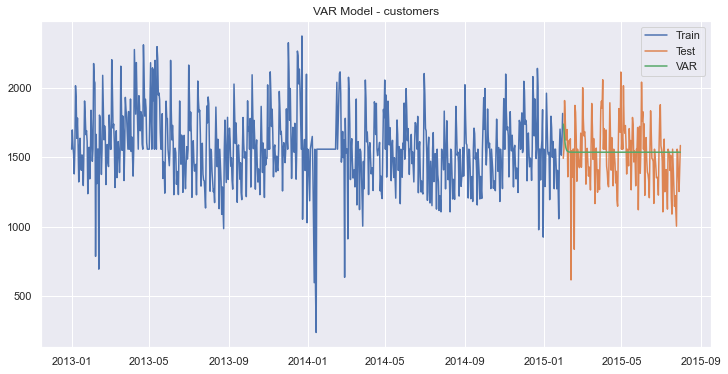

In [870]:
plt.figure(figsize=(12,6)) 
plt.plot(train1['customers'], label='Train')
plt.plot(test1['customers'], label='Test')
plt.plot(df_forecast['VAR_forecast_customers'], label='VAR')
plt.legend(loc='best')
plt.title('VAR Model - customers')
plt.show()

**Model Evalution**


In [871]:
# Let's calculate the rmse and MAPE
rmse = np.sqrt(mean_squared_error(test['sales'], df_forecast['VAR_forecast_Sales'])).round(2)
mape = np.round(np.mean(np.abs(test['sales']-df_forecast['VAR_forecast_Sales'])/test['sales'])*100,2)
tempResults = pd.DataFrame({'Method':['VAR'], 'RMSE': [rmse],'MAPE': [mape] })

In [872]:
tempResults

,Method,RMSE,MAPE
0,VAR,2093.97,15.23


In [873]:
results = pd.concat([Results , tempResults])
results = results[['Method', 'RMSE', 'MAPE']]
results

,Method,RMSE,MAPE
0,ARIMA,1950.91,14.20
0,VAR,2093.97,15.23


**Johansen-Impulse**


In [874]:
joh_model1 = coint_johansen(new_df[['sales','customers']],-1,1)

In [875]:
joh_model1

In [876]:
joh_model1.lr1

array([160.8017268 ,   3.18075708])

In [877]:
joh_model1.lr2

array([157.62096972,   3.18075708])

In [878]:
new_df[['sales','customers']].shape

(932, 2)

In [879]:
def joh_output(res):
    output = pd.DataFrame([res.lr2,res.lr1],
                          index=['max_eig_stat',"trace_stat"])
    print(output.T,'\n')
    print("Critical values(90%, 95%, 99%) of max_eig_stat\n",res.cvm,'\n')
    print("Critical values(90%, 95%, 99%) of trace_stat\n",res.cvt,'\n')

In [880]:
joh_output(joh_model1)

   max_eig_stat  trace_stat
0    157.620970  160.801727
1      3.180757    3.180757 

Critical values(90%, 95%, 99%) of max_eig_stat
 [[ 9.4748 11.2246 15.0923]
 [ 2.9762  4.1296  6.9406]] 

Critical values(90%, 95%, 99%) of trace_stat
 [[10.4741 12.3212 16.364 ]
 [ 2.9762  4.1296  6.9406]] 



In [881]:
from statsmodels.tsa.vector_ar.vecm import select_coint_rank

In [882]:
rank=select_coint_rank(new_df[['sales','customers']],-1,1)
print(rank.rank)

1


**Rank is one**

In [883]:
from statsmodels.tsa.stattools import coint

In [884]:
coint(new_df['sales'],new_df['customers'])#null hypothesis-There is not coint

(-3.3670212871767604,
 0.04614770256599787,
 array([-3.90824227, -3.34270081, -3.04900867]))

0.04614770256599787<.05

We can reject the null hypothesis

**Sales and customers are cointegration to each other**

**VARMAX MODEL**

In [885]:
#create dymmy variables
new_df=pd.get_dummies(new_df)
new_df.head()

,store,day_of_week,sales,customers,open,promo,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast,customers_log,state_holiday_0,state_holiday_0,state_holiday_a,state_holiday_b,state_holiday_c
date,,,,,,,,,,,,,,,,,
2013-01-01,25,2,11168.742667,1559.32027,0,0,1,0,9.320874,9.288991,10818.258769,7.352005,0,0,1,0,0
2013-01-02,25,3,11944.000000,1698.00000,1,0,1,0,9.387984,9.301539,10954.870688,7.437206,0,1,0,0,0
2013-01-03,25,4,10409.000000,1587.00000,1,0,1,0,9.250426,9.327765,11245.970725,7.369601,0,1,0,0,0
2013-01-04,25,5,9729.000000,1520.00000,1,0,1,0,9.182866,9.276329,10682.145202,7.326466,0,1,0,0,0
2013-01-05,25,6,8987.000000,1381.00000,1,0,0,0,9.103534,9.258915,10497.741179,7.230563,0,1,0,0,0


In [886]:
exog = new_df[['open','promo','school_holiday','promo2','state_holiday_0','state_holiday_a','state_holiday_b','state_holiday_c']]
mod = sm.tsa.VARMAX(new_df[['sales_log', 'customers_log']], order=(1,1), trend='n', exog=exog)
res = mod.fit(maxiter=1000, disp=False)
print(res.summary())

                                 Statespace Model Results                                 
Dep. Variable:     ['sales_log', 'customers_log']   No. Observations:                  932
Model:                                VARMAX(1,1)   Log Likelihood                1934.461
Date:                            Mon, 17 Jan 2022   AIC                          -3810.922
Time:                                    16:25:14   BIC                          -3670.640
Sample:                                         0   HQIC                         -3757.423
                                            - 932                                         
Covariance Type:                              opg                                         
Ljung-Box (L1) (Q):             0.02, 0.16   Jarque-Bera (JB):      7592.20, 279.49
Prob(Q):                        0.90, 0.69   Prob(JB):                   0.00, 0.00
Heteroskedasticity (H):         0.90, 1.37   Skew:                     -1.55, -0.61
Prob(H) (two-sided):

In [887]:
train_len = 750
train = new_df[0:train_len] # first 7500days as training set
test = new_df[train_len:] 

start_index = test.index.min()
end_index = test.index.max()

In [888]:
print(start_index)
print(end_index)

2015-01-31 00:00:00
2015-07-31 00:00:00


In [889]:
test.head()

,store,day_of_week,sales,customers,open,promo,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast,customers_log,state_holiday_0,state_holiday_0,state_holiday_a,state_holiday_b,state_holiday_c
date,,,,,,,,,,,,,,,,,
2015-01-31,25,6,10810.000000,1493.00000,1,0,0,0,9.288227,9.397882,12062.803482,7.308543,0,1,0,0,0
2015-02-01,25,7,11168.742667,1559.32027,0,0,0,0,9.320874,9.303400,10975.274492,7.352005,0,1,0,0,0
2015-02-02,25,1,14202.000000,1910.00000,1,1,0,0,9.561138,9.326471,11231.424091,7.554859,0,1,0,0,0
2015-02-03,25,2,12976.000000,1788.00000,1,1,0,0,9.470857,9.387038,11932.698771,7.488853,0,1,0,0,0
2015-02-04,25,3,11565.000000,1625.00000,1,1,0,0,9.355739,9.368177,11709.750249,7.393263,0,1,0,0,0


In [890]:
predictions = mod.fit().predict(start=start_index, end=end_index, exog=test[['open','promo','school_holiday','promo2','state_holiday_0','state_holiday_a','state_holiday_b','state_holiday_c']])

In [891]:
predictions

,sales_log,customers_log
date,,
2015-01-31,9.319844,7.355295
2015-02-01,9.370704,7.385560
2015-02-02,9.395660,7.414598
2015-02-03,9.463564,7.473426
2015-02-04,9.434495,7.452444
...,...,...
2015-07-27,9.383246,7.384325
2015-07-28,9.427746,7.399429
2015-07-29,9.428833,7.380810


In [892]:
predictions['VARMAX_forecast_Sales'] = np.exp(predictions['sales_log'])
predictions['VARMAX_forecast_customers'] = np.exp(predictions['customers_log'])
predictions

,sales_log,customers_log,VARMAX_forecast_Sales,VARMAX_forecast_customers
date,,,,
2015-01-31,9.319844,7.355295,11157.244642,1564.458624
2015-02-01,9.370704,7.385560,11739.381577,1612.531235
2015-02-02,9.395660,7.414598,12036.026049,1660.041787
2015-02-03,9.463564,7.473426,12881.707155,1760.627459
2015-02-04,9.434495,7.452444,12512.644718,1724.071531
...,...,...,...,...
2015-07-27,9.383246,7.384325,11887.534998,1610.540057
2015-07-28,9.427746,7.399429,12428.477730,1635.050772
2015-07-29,9.428833,7.380810,12442.004584,1604.889753


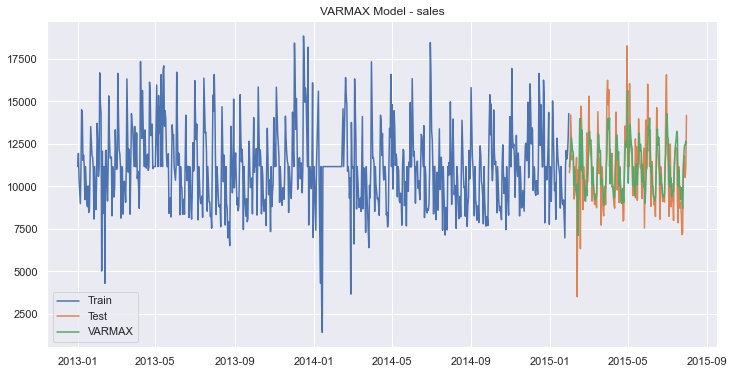

In [893]:
plt.figure(figsize=(12,6)) 
plt.plot(train['sales'], label='Train')
plt.plot(test['sales'], label='Test')
plt.plot(predictions['VARMAX_forecast_Sales'], label='VARMAX')
plt.legend(loc='best')
plt.title('VARMAX Model - sales')
plt.show()

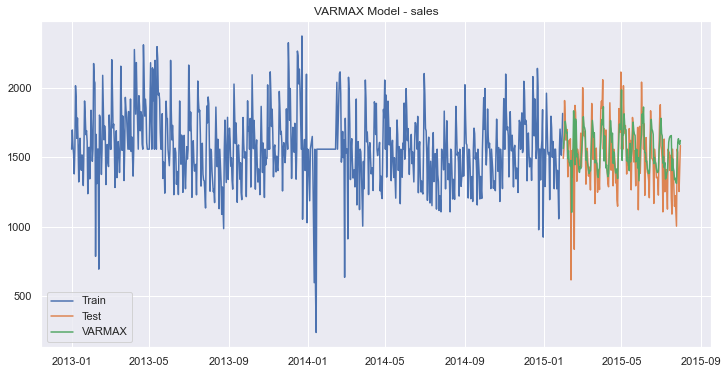

In [894]:
plt.figure(figsize=(12,6)) 
plt.plot(train['customers'], label='Train')
plt.plot(test['customers'], label='Test')
plt.plot(predictions['VARMAX_forecast_customers'], label='VARMAX')
plt.legend(loc='best')
plt.title('VARMAX Model - sales')
plt.show()

**Model evalution**


In [895]:
# Let's calculate the rmse and MAPE
rmse = np.sqrt(mean_squared_error(test['sales'], predictions['VARMAX_forecast_Sales'])).round(2)
mape = np.round(np.mean(np.abs(test['sales']-predictions['VARMAX_forecast_Sales'])/test['sales'])*100,2)
tempResults = pd.DataFrame({'Method':['VARMAX'], 'RMSE': [rmse],'MAPE': [mape] })

In [896]:
results = pd.concat([results  , tempResults])
results = results[['Method', 'RMSE', 'MAPE']]
results

,Method,RMSE,MAPE
0,ARIMA,1950.91,14.20
0,VAR,2093.97,15.23
0,VARMAX,1694.38,11.51


**VARMAX is the best model**


# Model- Store-29

In [897]:
df_new[df_new['store']==29].head()

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year,promo2,promo2_since_week,promo2_since_year,promo_interval
28,29,5,2015-07-31,9411,737,1,1,0,1,d,c,2170.0,NaN,NaN,0,NaN,NaN,NaN
1143,29,4,2015-07-30,8039,661,1,1,0,1,d,c,2170.0,NaN,NaN,0,NaN,NaN,NaN
2258,29,3,2015-07-29,7564,614,1,1,0,1,d,c,2170.0,NaN,NaN,0,NaN,NaN,NaN
3373,29,2,2015-07-28,8450,697,1,1,0,1,d,c,2170.0,NaN,NaN,0,NaN,NaN,NaN
4488,29,1,2015-07-27,11659,889,1,1,0,1,d,c,2170.0,NaN,NaN,0,NaN,NaN,NaN


In [898]:
#Store_29
df_new_store29=df_new[df_new['store']==29]

In [899]:
# transform datatype of the variable data to datetime
df_new_store29['date'] = pd.to_datetime( df_new_store29['date'])

In [900]:
df_new_store29.info()
#Let's check the info

<class 'pandas.core.frame.DataFrame'>
Int64Index: 942 entries, 28 to 1016123
Data columns (total 18 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   store                         942 non-null    int64         
 1   day_of_week                   942 non-null    int64         
 2   date                          942 non-null    datetime64[ns]
 3   sales                         942 non-null    int64         
 4   customers                     942 non-null    int64         
 5   open                          942 non-null    int64         
 6   promo                         942 non-null    int64         
 7   state_holiday                 942 non-null    object        
 8   school_holiday                942 non-null    int64         
 9   store_type                    942 non-null    object        
 10  assortment                    942 non-null    object        
 11  competition_distance       

In [901]:
# Check NAN values
missing_count = df_new_store29.isnull().sum() # the count of missing values
value_count = df_new_store29.isnull().count() # the count of all values

missing_percentage = round(missing_count/value_count *100, 2) # the percentage of missing values
missing_df = pd.DataFrame({'missing values count': missing_count, 'percentage': missing_percentage})
missing_df

,missing values count,percentage
store,0,0.0
day_of_week,0,0.0
date,0,0.0
sales,0,0.0
customers,0,0.0
open,0,0.0
promo,0,0.0
state_holiday,0,0.0
school_holiday,0,0.0
store_type,0,0.0


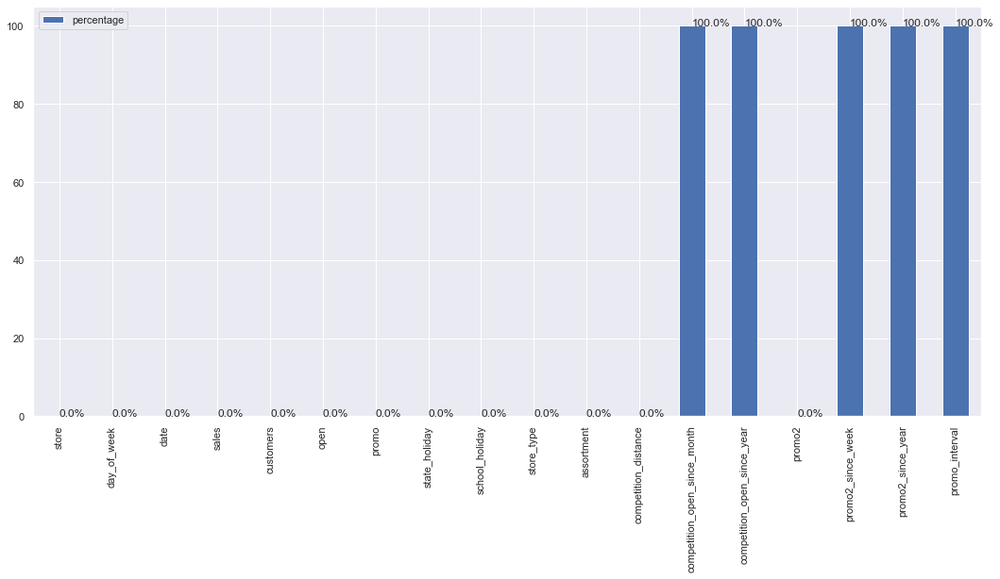

In [902]:
barchart = missing_df.plot.bar(y='percentage')
for index, percentage in enumerate( missing_percentage ):
    barchart.text( index, percentage, str(percentage)+'%')

In [903]:
#Let's drop the promo2_since_year,promo2_since_year,promo_interval
df_new_store29=df_new_store29.drop(['competition_open_since_month', 'competition_open_since_year','promo2_since_week','promo2_since_year','promo_interval'], axis = 1)

In [904]:
df_new_store29.columns

Index(['store', 'day_of_week', 'date', 'sales', 'customers', 'open', 'promo',
       'state_holiday', 'school_holiday', 'store_type', 'assortment',
       'competition_distance', 'promo2'],
      dtype='object')

In [905]:
df_new_store29.head()

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,store_type,assortment,competition_distance,promo2
28,29,5,2015-07-31,9411,737,1,1,0,1,d,c,2170.0,0
1143,29,4,2015-07-30,8039,661,1,1,0,1,d,c,2170.0,0
2258,29,3,2015-07-29,7564,614,1,1,0,1,d,c,2170.0,0
3373,29,2,2015-07-28,8450,697,1,1,0,1,d,c,2170.0,0
4488,29,1,2015-07-27,11659,889,1,1,0,1,d,c,2170.0,0


In [906]:
df_new_store29.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 942 entries, 28 to 1016123
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   store                 942 non-null    int64         
 1   day_of_week           942 non-null    int64         
 2   date                  942 non-null    datetime64[ns]
 3   sales                 942 non-null    int64         
 4   customers             942 non-null    int64         
 5   open                  942 non-null    int64         
 6   promo                 942 non-null    int64         
 7   state_holiday         942 non-null    object        
 8   school_holiday        942 non-null    int64         
 9   store_type            942 non-null    object        
 10  assortment            942 non-null    object        
 11  competition_distance  942 non-null    float64       
 12  promo2                942 non-null    int64         
dtypes: datetime64[n

In [907]:
# Let's copy the dataset
df_store29 = df_new_store29.copy()

In [908]:
df_store29.head()

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,store_type,assortment,competition_distance,promo2
28,29,5,2015-07-31,9411,737,1,1,0,1,d,c,2170.0,0
1143,29,4,2015-07-30,8039,661,1,1,0,1,d,c,2170.0,0
2258,29,3,2015-07-29,7564,614,1,1,0,1,d,c,2170.0,0
3373,29,2,2015-07-28,8450,697,1,1,0,1,d,c,2170.0,0
4488,29,1,2015-07-27,11659,889,1,1,0,1,d,c,2170.0,0


**Descriptive Statistics**

In [909]:
df_store29.describe().T

,count,mean,std,min,25%,50%,75%,max
store,942.0,29.000000,0.000000,29.0,29.0,29.0,29.0,29.0
day_of_week,942.0,3.997877,1.998404,1.0,2.0,4.0,6.0,7.0
sales,942.0,6090.403397,3433.366553,0.0,4972.5,6361.5,8072.0,15758.0
customers,942.0,540.587049,277.347395,0.0,498.5,598.0,703.0,1153.0
open,942.0,0.826964,0.378479,0.0,1.0,1.0,1.0,1.0
promo,942.0,0.382166,0.486175,0.0,0.0,0.0,1.0,1.0
school_holiday,942.0,0.180467,0.384780,0.0,0.0,0.0,0.0,1.0
competition_distance,942.0,2170.000000,0.000000,2170.0,2170.0,2170.0,2170.0,2170.0
promo2,942.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0


In [910]:
# separate numerical and categorical attributes
num_attributes = df_store29.select_dtypes( include = 'number')
cate_attributes = df_store29.select_dtypes( include = 'object')

**Numerical Attributes**


In [911]:
# Central Tendency - Mean, median
ct1 = pd.DataFrame( num_attributes.apply( np.mean ) ).T
ct2 = pd.DataFrame( num_attributes.apply( np.median ) ).T

# Dispersion - std, min, max, range, skew, kurtoisis
d1 = pd.DataFrame(num_attributes.apply( np.std )).T
d2 = pd.DataFrame(num_attributes.apply( min )).T
d3 = pd.DataFrame(num_attributes.apply( max )).T
d4 = pd.DataFrame(num_attributes.apply( lambda x: x.max() - x.min() )).T
d5 = pd.DataFrame(num_attributes.apply( lambda x: x.skew() )).T
d6 = pd.DataFrame(num_attributes.apply( lambda x: x.kurtosis() )).T

#concatenate
m = pd.concat( [d2, d3, d4, ct1, ct2, d1, d5, d6] ).T.reset_index()


m.columns = ['attributes', 'min', 'max', 'range', 'mean', 'median', 'std', 'skew', 'kurtosis']
m

,attributes,min,max,range,mean,median,std,skew,kurtosis
0,store,29.0,29.0,0.0,29.000000,29.0,0.000000,0.000000,0.000000
1,day_of_week,1.0,7.0,6.0,3.997877,4.0,1.997343,0.002127,-1.247185
2,sales,0.0,15758.0,15758.0,6090.403397,6361.5,3431.543688,-0.308371,-0.055581
3,customers,0.0,1153.0,1153.0,540.587049,598.0,277.200144,-0.885889,0.082139
4,open,0.0,1.0,1.0,0.826964,1.0,0.378278,-1.731453,1.000047
5,promo,0.0,1.0,1.0,0.382166,0.0,0.485917,0.485772,-1.767783
6,school_holiday,0.0,1.0,1.0,0.180467,0.0,0.384576,1.664393,0.771837
7,competition_distance,2170.0,2170.0,0.0,2170.000000,2170.0,0.000000,0.000000,0.000000
8,promo2,0.0,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.000000


**Categorical Attributes**


In [912]:
# check unique values of categorical features
cate_attributes.apply( lambda x: x.unique().shape[0])

state_holiday    5
store_type       1
assortment       1
dtype: int64

In [913]:
#Let's check the unique values
print(df_store29['state_holiday'].unique())
print(df_store29['store_type'].unique())
print(df_store29['assortment'].unique())

['0' 'a' 'b' 'c' 0]
['d']
['c']


In [914]:
df_store29.columns

Index(['store', 'day_of_week', 'date', 'sales', 'customers', 'open', 'promo',
       'state_holiday', 'school_holiday', 'store_type', 'assortment',
       'competition_distance', 'promo2'],
      dtype='object')

# Exploratory data analysis(EDA)

Let’s perform EDA to gain insights into the given data.

**Univariate Analysis**

Response Variable (target)

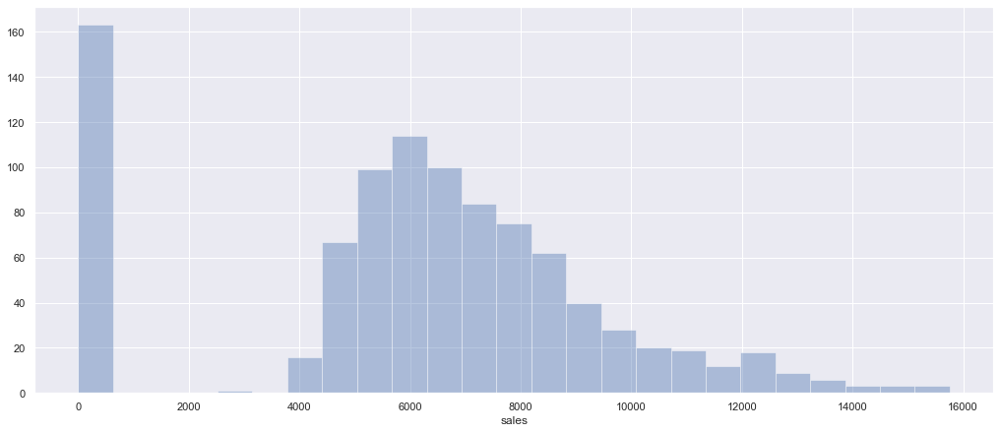

In [915]:
fig = plt.figure( figsize = (14, 6), constrained_layout=True)
sns.distplot(df_store29['sales'], kde = False);
plt.show()

**Numerical Variable**

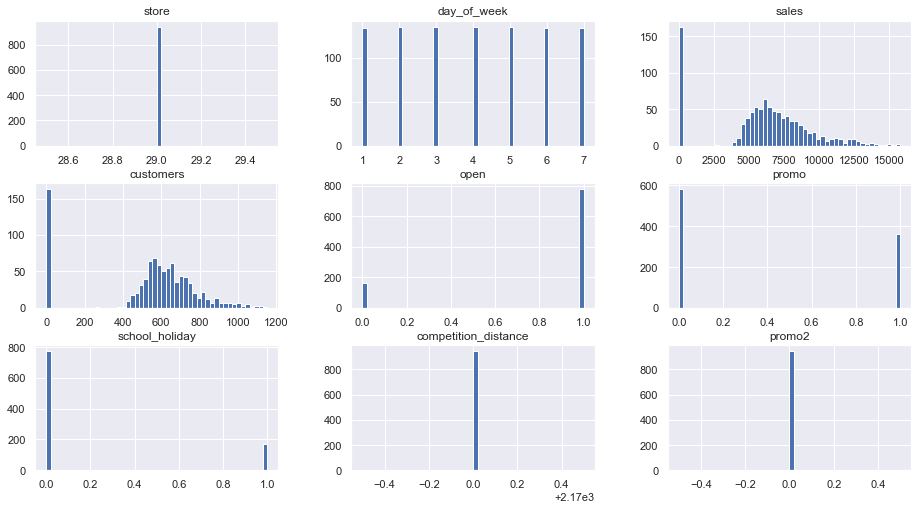

In [916]:
sns.set(rc={'figure.figsize':(15.7,8.27)})
num_attributes.hist(bins = 50);

In [917]:
df_store29['day_of_week'].value_counts()
#day of the week

5    135
4    135
3    135
2    135
7    134
6    134
1    134
Name: day_of_week, dtype: int64

In [918]:
df_store29['open'].value_counts()
# value count of store is open or not

1    779
0    163
Name: open, dtype: int64

In [919]:
df_store29['school_holiday'].value_counts()
# value count of state_holiday

0    772
1    170
Name: school_holiday, dtype: int64

In [920]:
df_store29['state_holiday'].value_counts()
# value count of state_holiday

0    784
0    129
a     19
b      6
c      4
Name: state_holiday, dtype: int64

In [921]:
df_store29['assortment'].value_counts()
# value count of state_holiday

c    942
Name: assortment, dtype: int64

In [922]:
df_store29['competition_distance'].value_counts()
# value count of competition_distance

2170.0    942
Name: competition_distance, dtype: int64

In [923]:
df_store29['promo2'].value_counts()

# value count of promo2

0    942
Name: promo2, dtype: int64

**Categorical Variable**

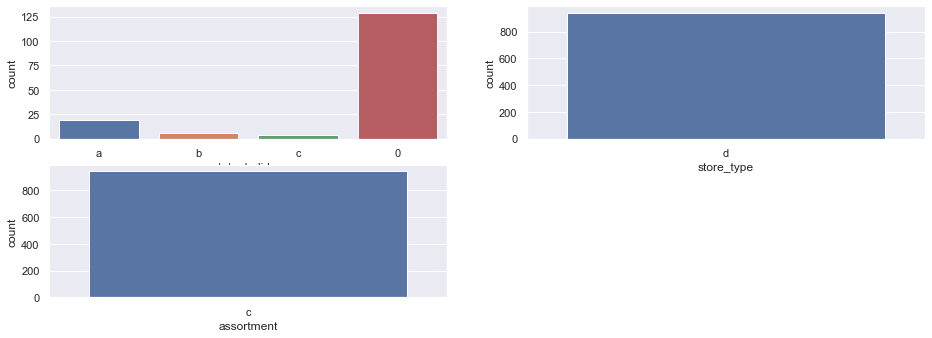

In [924]:
# state_holiday
plt.subplot(3, 2, 1)
a = df_store29[df_store29['state_holiday'] != '0']
sns.countplot(data = a, x = a['state_holiday'])

# store_type
plt.subplot(3, 2, 2)
sns.countplot(data = df_store29, x = df_store29['store_type'])

# assortment
plt.subplot(3, 2, 3)
sns.countplot(data = df_store29, x = df_store29['assortment'])

plt.show()

In [925]:
# Zero values in sales 
df_store29[df_store29['sales']==0]

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,store_type,assortment,competition_distance,promo2
5603,29,7,2015-07-26,0,0,0,0,0,0,d,c,2170.0,0
13408,29,7,2015-07-19,0,0,0,0,0,0,d,c,2170.0,0
21213,29,7,2015-07-12,0,0,0,0,0,0,d,c,2170.0,0
29018,29,7,2015-07-05,0,0,0,0,0,0,d,c,2170.0,0
36823,29,7,2015-06-28,0,0,0,0,0,0,d,c,2170.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
987133,29,7,2013-01-27,0,0,0,0,0,0,d,c,2170.0,0
994938,29,7,2013-01-20,0,0,0,0,0,0,d,c,2170.0,0
1002743,29,7,2013-01-13,0,0,0,0,0,0,d,c,2170.0,0
1010548,29,7,2013-01-06,0,0,0,0,0,0,d,c,2170.0,0


In [926]:
df_store29.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 942 entries, 28 to 1016123
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   store                 942 non-null    int64         
 1   day_of_week           942 non-null    int64         
 2   date                  942 non-null    datetime64[ns]
 3   sales                 942 non-null    int64         
 4   customers             942 non-null    int64         
 5   open                  942 non-null    int64         
 6   promo                 942 non-null    int64         
 7   state_holiday         942 non-null    object        
 8   school_holiday        942 non-null    int64         
 9   store_type            942 non-null    object        
 10  assortment            942 non-null    object        
 11  competition_distance  942 non-null    float64       
 12  promo2                942 non-null    int64         
dtypes: datetime64[n


-    Sale  and customer colomns has zero values which has to be imputed

-    Store is open on 80% of days

-    80% are regular days

-    All the rows of column-store type belongs to 'd'

-    All the rows of column-assortment belongs to 'c'

-    All the rows of columns-competition_distance to 2170

-    All the rows of promo2 belogs to 0

**Bivariate Analysis**

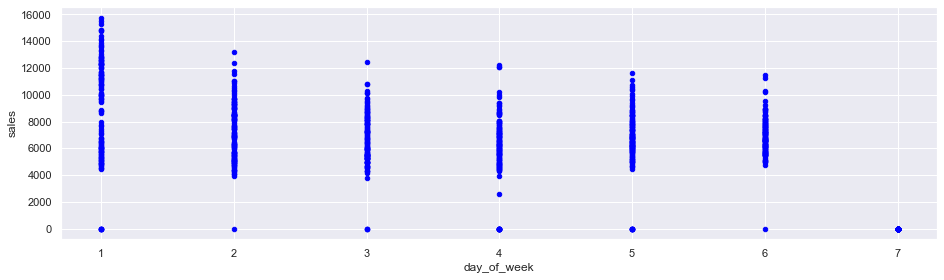

In [927]:
# lets draw a scatter plot between  Sales and day_of_week
sns.set(rc={'figure.figsize':(15.7,4.27)})
df_store29[['sales', 'day_of_week']].plot.scatter(x = 'day_of_week',y='sales',c='blue')
plt.show()

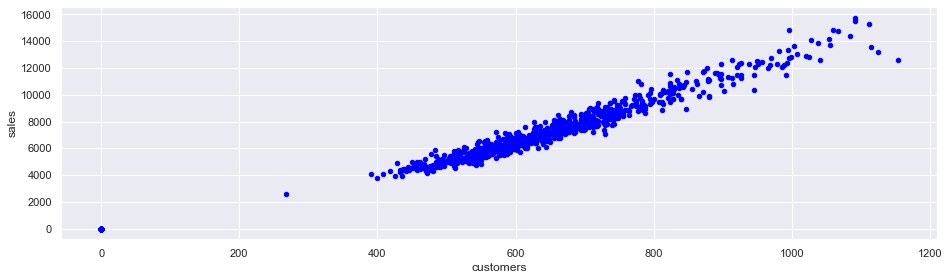

In [928]:
#Let's draw a scatter plot between Sales and Customers
df_store29[['sales', 'customers']].plot.scatter(x = 'customers',y='sales',c='blue')
plt.show()

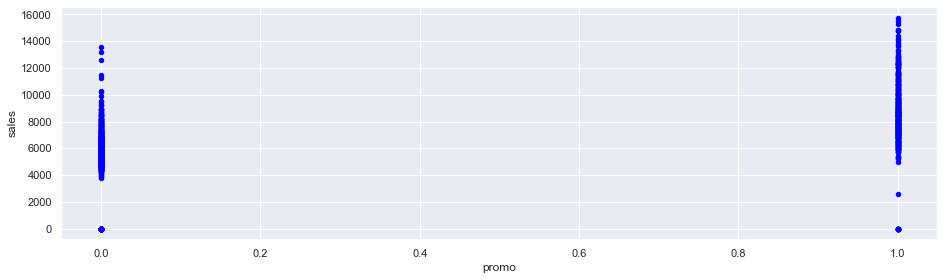

In [929]:
#Let's now draw a scatter plot between Sales and promo
df_store29[['sales', 'promo']].plot.scatter(x = 'promo',y='sales',c='blue')
plt.show()

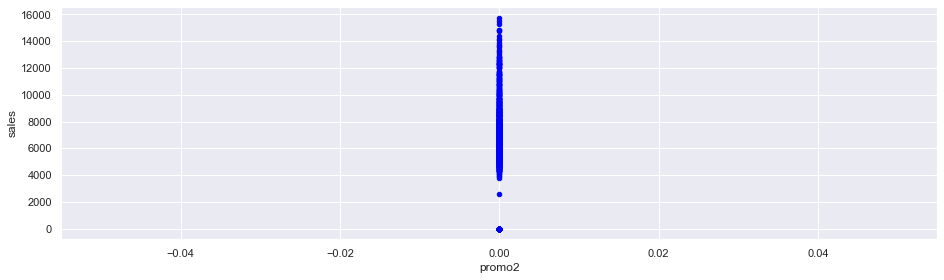

In [930]:
#Let's now draw a scatter plot between Sales and promo
df_store29[['sales', 'promo2']].plot.scatter(x = 'promo2',y='sales',c='blue')
plt.show()

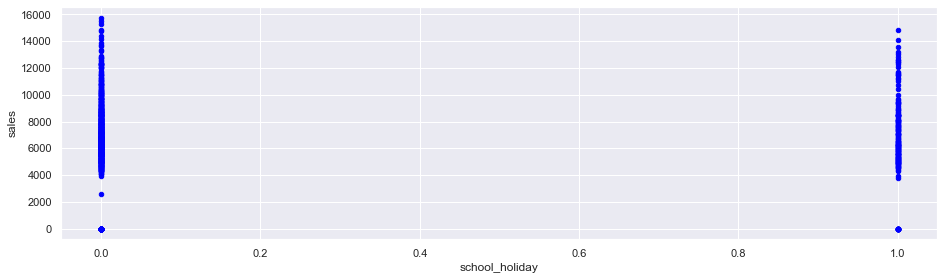

In [931]:
#lets now draw a scatter plot between  Sales and school_holiday
df_store29[['sales', 'school_holiday']].plot.scatter(x = 'school_holiday',y='sales',c='blue')
plt.show()

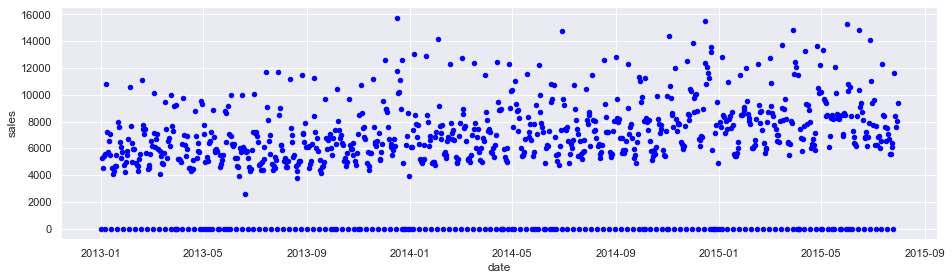

In [932]:
#lets now draw a scatter plot between Sales and date
df_store29[['sales', 'date']].plot.scatter(x = 'date',y='sales',c='blue')
plt.show()

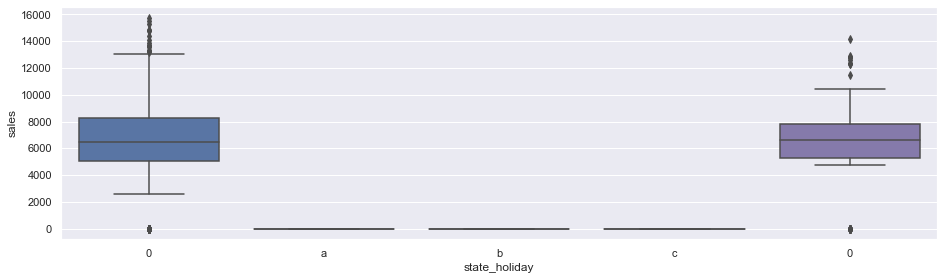

In [933]:
#Let's draw the boxplot between sales and state_holiday
sns.set(rc={'figure.figsize':(15.7,4.27)})
# create grouped boxplot 
sns.boxplot(x = df_store29['state_holiday'],
            y = df_store29['sales'])
plt.show()

**Multivariate Analysis**

**Numerical Attributes**

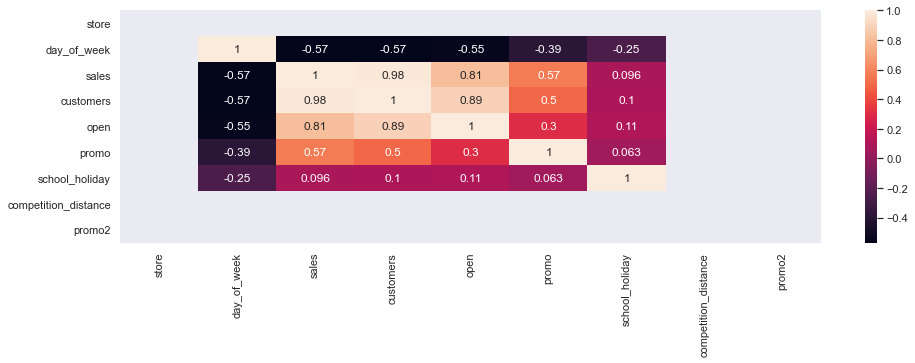

In [934]:
correlation = (num_attributes.corr( method = 'pearson' ))
sns.heatmap( correlation, annot = True );

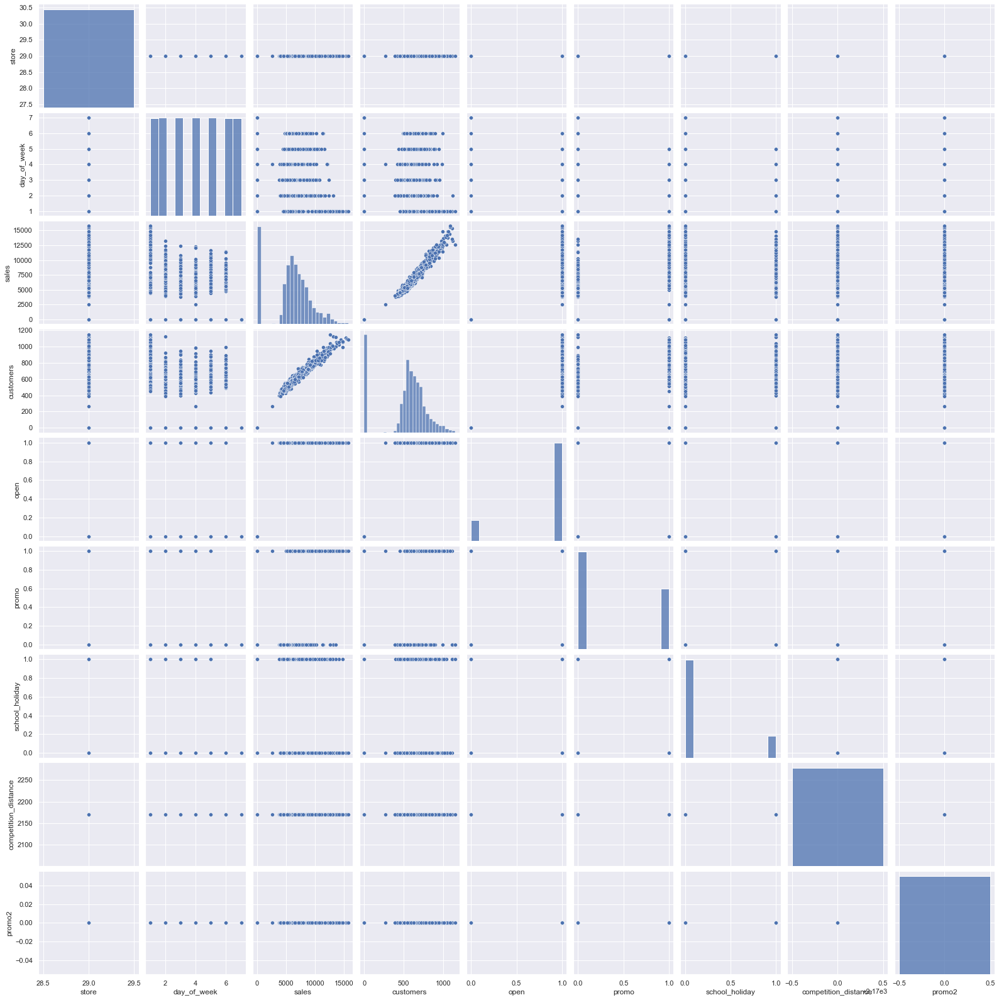

In [935]:
#pairplot with hue sales
sns.pairplot(df_store29)
# to show
plt.show()

**Some insights from EDA**

   - store_type,assortment,competition_distance are uncessary columns so we have to remove it

   - Day1 and Day2 have higher sales than other days

   - promo is correlated to sales

   - Promo2 doesn't have any effect on sales becuase it's value is equal to 1

   - There is no sale on a = public holiday, b = Easter holiday, c = Christmas

   - There is some effect of school holiday on sales

In [936]:
df_store29.columns

Index(['store', 'day_of_week', 'date', 'sales', 'customers', 'open', 'promo',
       'state_holiday', 'school_holiday', 'store_type', 'assortment',
       'competition_distance', 'promo2'],
      dtype='object')

In [937]:
#We can drop store_type,assortment,competition_distance,competition_open_since_month,promo2_since_week,promo2_since_year,promo_interval
#competition_open_since_year & promo2
df_store29_new=df_store29.drop(['store_type', 'assortment','competition_distance'], axis = 1)
df_store29_new.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 942 entries, 28 to 1016123
Data columns (total 10 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   store           942 non-null    int64         
 1   day_of_week     942 non-null    int64         
 2   date            942 non-null    datetime64[ns]
 3   sales           942 non-null    int64         
 4   customers       942 non-null    int64         
 5   open            942 non-null    int64         
 6   promo           942 non-null    int64         
 7   state_holiday   942 non-null    object        
 8   school_holiday  942 non-null    int64         
 9   promo2          942 non-null    int64         
dtypes: datetime64[ns](1), int64(8), object(1)
memory usage: 121.0+ KB


In [938]:
df_store29_new.columns

Index(['store', 'day_of_week', 'date', 'sales', 'customers', 'open', 'promo',
       'state_holiday', 'school_holiday', 'promo2'],
      dtype='object')

In [939]:
df_store29_new.head()

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,promo2
28,29,5,2015-07-31,9411,737,1,1,0,1,0
1143,29,4,2015-07-30,8039,661,1,1,0,1,0
2258,29,3,2015-07-29,7564,614,1,1,0,1,0
3373,29,2,2015-07-28,8450,697,1,1,0,1,0
4488,29,1,2015-07-27,11659,889,1,1,0,1,0


In [940]:
df_store29_new=df_store29_new[::-1].reset_index()
df_store29_new.head()

,index,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,promo2
0,1016123,29,2,2013-01-01,0,0,0,0,a,1,0
1,1015008,29,3,2013-01-02,5269,550,1,0,0,1,0
2,1013893,29,4,2013-01-03,4554,456,1,0,0,1,0
3,1012778,29,5,2013-01-04,5411,505,1,0,0,1,0
4,1011663,29,6,2013-01-05,5564,537,1,0,0,0,0


In [941]:
df_store29_new=df_store29_new.drop(['index'], axis = 1)
df_store29_new.head()
#Let drop the index column

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,promo2
0,29,2,2013-01-01,0,0,0,0,a,1,0
1,29,3,2013-01-02,5269,550,1,0,0,1,0
2,29,4,2013-01-03,4554,456,1,0,0,1,0
3,29,5,2013-01-04,5411,505,1,0,0,1,0
4,29,6,2013-01-05,5564,537,1,0,0,0,0


In [942]:
df_store29_new.info()
#No missing value

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 942 entries, 0 to 941
Data columns (total 10 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   store           942 non-null    int64         
 1   day_of_week     942 non-null    int64         
 2   date            942 non-null    datetime64[ns]
 3   sales           942 non-null    int64         
 4   customers       942 non-null    int64         
 5   open            942 non-null    int64         
 6   promo           942 non-null    int64         
 7   state_holiday   942 non-null    object        
 8   school_holiday  942 non-null    int64         
 9   promo2          942 non-null    int64         
dtypes: datetime64[ns](1), int64(8), object(1)
memory usage: 73.7+ KB


In [943]:
# transform datatype of the variable data to datetime
df_store29_new['date'] = pd.to_datetime(df_store29_new['date'])

In [944]:
indexed_df_store29_new = df_store29_new.set_index(['date'])
indexed_df_store29_new.head()
#Let set the date as index column

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2
date,,,,,,,,,
2013-01-01,29,2,0,0,0,0,a,1,0
2013-01-02,29,3,5269,550,1,0,0,1,0
2013-01-03,29,4,4554,456,1,0,0,1,0
2013-01-04,29,5,5411,505,1,0,0,1,0
2013-01-05,29,6,5564,537,1,0,0,0,0


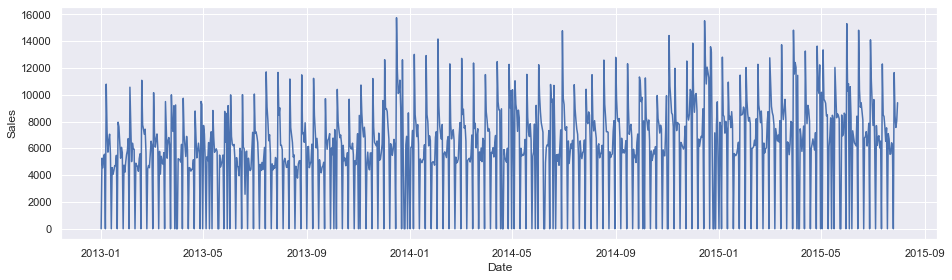

In [945]:
## plot graph
plt.xlabel('Date')
plt.ylabel('Sales')
plt.plot(indexed_df_store29_new['sales'])
plt.show()

In [946]:
#Let impute the zero values
(indexed_df_store29_new['sales']==0).sum()
# There are 163 zero value in sale column

163

In [947]:
indexed_df_store29_new['sales']=indexed_df_store29_new['sales'].replace(0, np.nan)

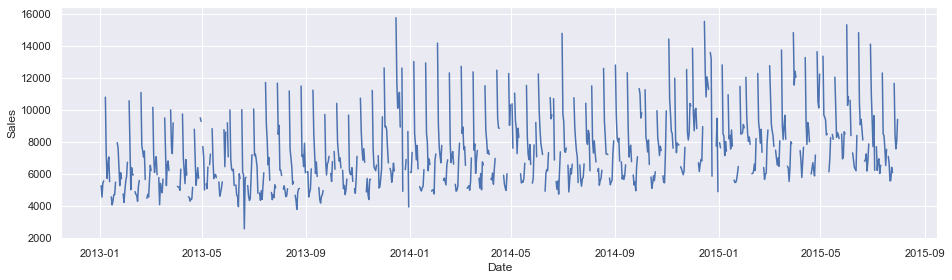

In [948]:
##plot graph
plt.xlabel('Date')
plt.ylabel('Sales')
plt.plot(indexed_df_store29_new['sales'])
plt.show()

In [949]:
#KNN imputer for filling NAN values
imputer = KNNImputer(n_neighbors=2)

In [950]:
indexed_df_store29_new['sales'] = imputer.fit_transform(np.array(indexed_df_store29_new['sales']).reshape(-1, 1))
indexed_df_store29_new['sales'].head()

date
2013-01-01    7364.775353
2013-01-02    5269.000000
2013-01-03    4554.000000
2013-01-04    5411.000000
2013-01-05    5564.000000
Name: sales, dtype: float64

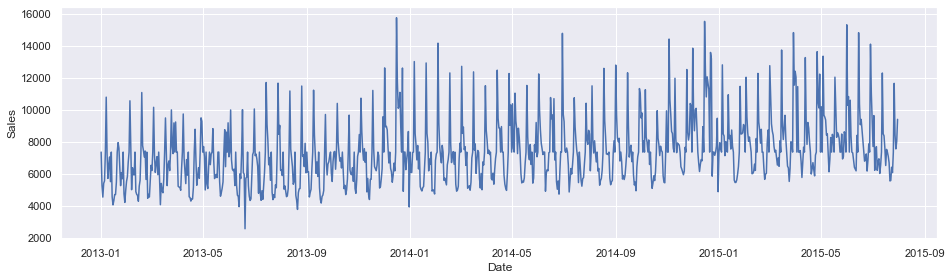

In [951]:
## plot graph
plt.xlabel('Date')
plt.ylabel('Sales')
plt.plot(indexed_df_store29_new['sales'])
plt.show()

In [952]:
(indexed_df_store29_new['sales']==0).sum()
# no missing value

0

**Outlier detection**

Box plot and interquartile range

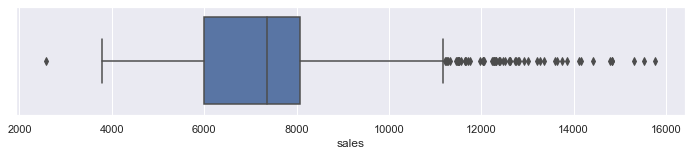

In [953]:
import seaborn as sns
fig = plt.subplots(figsize=(12, 2))
ax = sns.boxplot(x=indexed_df_store29_new['sales'],whis=1.5)
#Let treat the outliers

**Histogram**

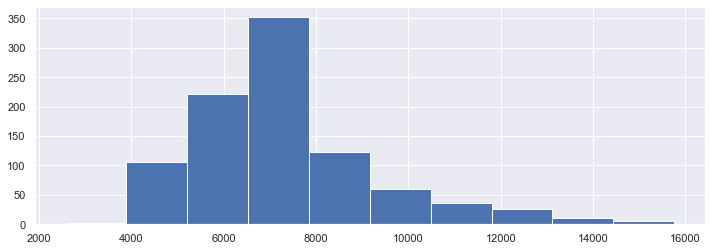

In [954]:
fig = indexed_df_store29_new['sales'].hist(figsize = (12,4))

In [955]:
percentile01 = indexed_df_store29_new['sales'].quantile(0.01)
percentile99 = indexed_df_store29_new['sales'].quantile(0.99)

In [956]:
upper_limit = percentile99
lower_limit = percentile01

In [957]:
upper_limit

13808.260000000004

In [958]:
lower_limit

4317.53

In [959]:
new_df = indexed_df_store29_new[indexed_df_store29_new['sales'] < upper_limit]
new_df.shape

(932, 9)

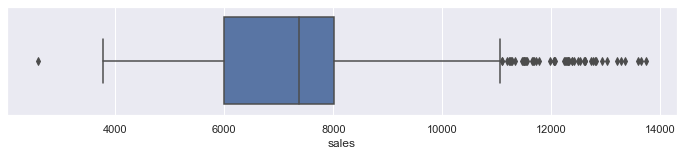

In [960]:
import seaborn as sns
fig = plt.subplots(figsize=(12, 2))
ax = sns.boxplot(x=new_df['sales'],whis=1.5)

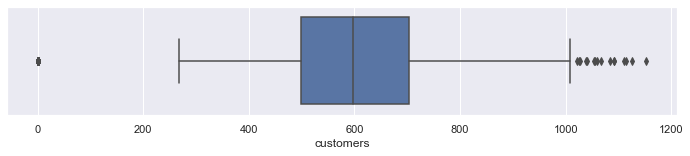

In [961]:
import seaborn as sns
fig = plt.subplots(figsize=(12, 2))
ax = sns.boxplot(x=indexed_df_store29_new['customers'],whis=1.5)

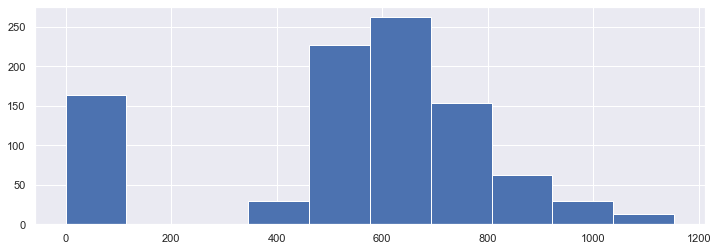

In [962]:
fig = indexed_df_store29_new['customers'].hist(figsize = (12,4))

**ADF Stationary**

In [963]:
def test_stationarity(timeseries):
    
    #Determine rolling statistics
    movingAverage = timeseries.rolling(window=12).mean()
    movingSTD = timeseries.rolling(window=12).std()
    
    #Plot rolling statistics
    orig = plt.plot(timeseries, color='blue', label='Original')
    mean = plt.plot(movingAverage, color='red', label='Rolling Mean')
    std = plt.plot(movingSTD, color='black', label='Rolling Std')
    plt.legend(loc='best')
    plt.title('Rolling Mean & Standard Deviation')
    plt.show(block=False)
    
    #Perform Dickey–Fuller test:
    print('Results of Dickey Fuller Test:')
    dftest = adfuller(indexed_df_store29_new['sales'], autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    for key,value in dftest[4].items():
        dfoutput['Critical Value (%s)'%key] = value
    print(dfoutput)

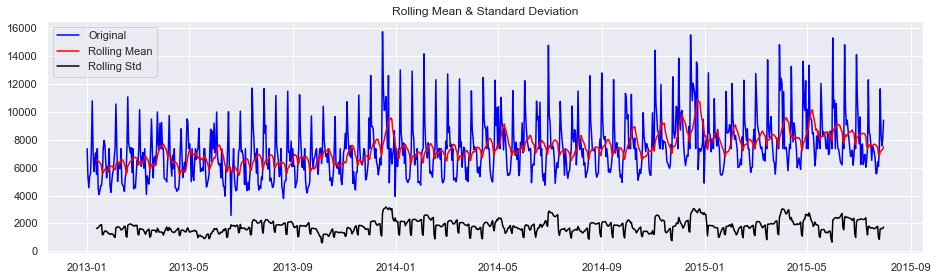

Results of Dickey Fuller Test:
Test Statistic                  -3.329632
p-value                          0.013605
#Lags Used                      21.000000
Number of Observations Used    920.000000
Critical Value (1%)             -3.437478
Critical Value (5%)             -2.864687
Critical Value (10%)            -2.568445
dtype: float64


In [964]:
test_stationarity(indexed_df_store29_new['sales'])

- Null: Time Series is not stationary
- Alternate: Time Series is Stationary

**The p-value is less than 0.05 so The series is stationary**

In [965]:
from statsmodels.tsa.stattools import kpss
kpss_test = kpss(indexed_df_store29_new['sales'])

print('KPSS Statistic: %f' % kpss_test[0])
print('Critical Values @ 0.05: %.2f' % kpss_test[3]['5%'])
print('p-value: %f' % kpss_test[1])

KPSS Statistic: 2.909372
Critical Values @ 0.05: 0.46
p-value: 0.010000


- Null: Time Series is not stationary
- Alternate: Time Series is Stationary
    
**The p-value is less than 0.05 so The series is non-stationary**

# Let's take the log of sales to Standardize the sales values

In [966]:
new_df=indexed_df_store29_new.copy()
new_df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 942 entries, 2013-01-01 to 2015-07-31
Data columns (total 9 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   store           942 non-null    int64  
 1   day_of_week     942 non-null    int64  
 2   sales           942 non-null    float64
 3   customers       942 non-null    int64  
 4   open            942 non-null    int64  
 5   promo           942 non-null    int64  
 6   state_holiday   942 non-null    object 
 7   school_holiday  942 non-null    int64  
 8   promo2          942 non-null    int64  
dtypes: float64(1), int64(7), object(1)
memory usage: 73.6+ KB


**Log transformation has made mean & variance constant**

In [967]:
#Log Transformation
new_df['sales_log'] = np.log(new_df['sales'])
new_df.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log
date,,,,,,,,,,
2013-01-01,29,2,7364.775353,0,0,0,a,1,0,8.904464
2013-01-02,29,3,5269.000000,550,1,0,0,1,0,8.569596
2013-01-03,29,4,4554.000000,456,1,0,0,1,0,8.423761
2013-01-04,29,5,5411.000000,505,1,0,0,1,0,8.596189
2013-01-05,29,6,5564.000000,537,1,0,0,0,0,8.624073


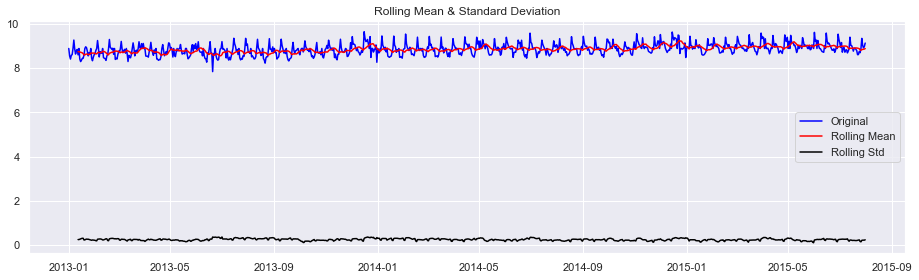

Results of Dickey Fuller Test:
Test Statistic                  -3.329632
p-value                          0.013605
#Lags Used                      21.000000
Number of Observations Used    920.000000
Critical Value (1%)             -3.437478
Critical Value (5%)             -2.864687
Critical Value (10%)            -2.568445
dtype: float64


In [968]:
test_stationarity(new_df['sales_log'])

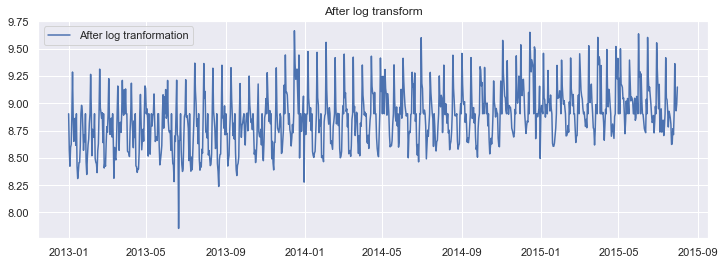

In [969]:
#After Log Transformation
plt.figure(figsize=(12,4))
plt.plot(new_df['sales_log'], label='After log tranformation')
plt.legend(loc='best')
plt.title('After log transform')
plt.show()

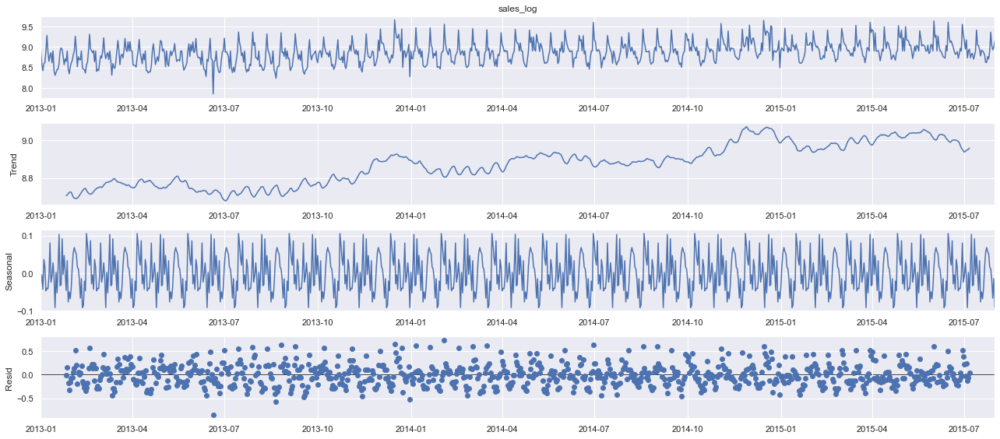

In [970]:
from matplotlib.pyplot import rcParams
rcParams['figure.figsize'] = 18,8
decomposition = sm.tsa.seasonal_decompose(new_df['sales_log'], model = "additive",period=50)
fig = decomposition.plot()

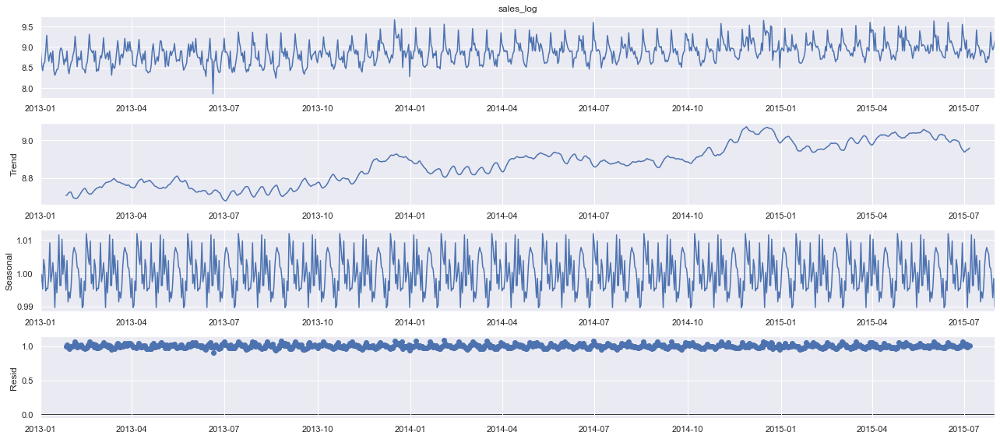

In [971]:
from matplotlib.pyplot import rcParams
rcParams['figure.figsize'] = 18,8
decomposition = sm.tsa.seasonal_decompose(new_df['sales_log'], model = "multiplicative",period=50)
fig = decomposition.plot()

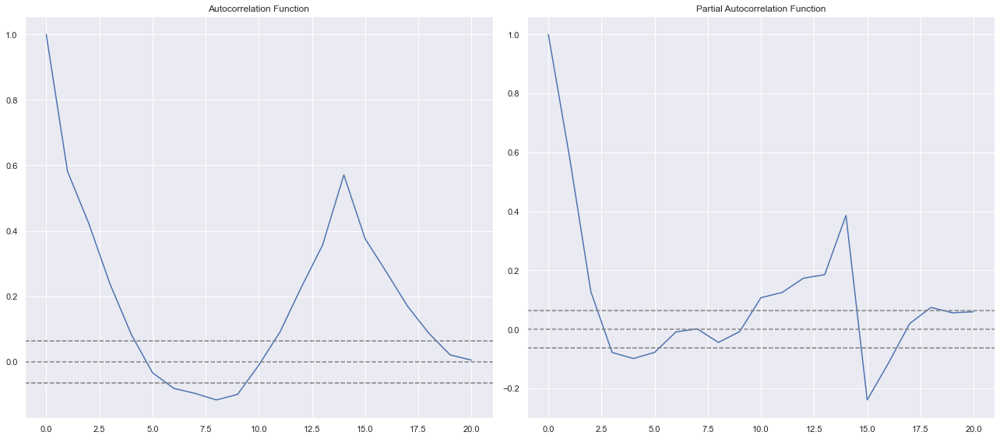

In [972]:
#ACF & PACF plots

lag_acf = acf(new_df['sales_log'], nlags=20) # MA 
lag_pacf = pacf(new_df['sales_log'], nlags=20, method='ols')  # AR 

#Plot ACF:
plt.subplot(121)
plt.plot(lag_acf)
plt.axhline(y=0, linestyle='--', color='gray')
plt.axhline(y=-1.96/np.sqrt(len(new_df['sales_log'])), linestyle='--', color='gray')
plt.axhline(y=1.96/np.sqrt(len(new_df['sales_log'])), linestyle='--', color='gray')
plt.title('Autocorrelation Function')            

#Plot PACF
plt.subplot(122)
plt.plot(lag_pacf)
plt.axhline(y=0, linestyle='--', color='gray')
plt.axhline(y=-1.96/np.sqrt(len(new_df['sales_log'])), linestyle='--', color='gray')
plt.axhline(y=1.96/np.sqrt(len(new_df['sales_log'])), linestyle='--', color='gray')
plt.title('Partial Autocorrelation Function')
            
plt.tight_layout() 

From the ACF graph, we see that curve touches y=0.0 line at x=4. Thus, from theory, Q = 4 From the PACF graph, we see that curve touches y=0.0 line at x=3. Thus, from theory, P = 3


**Build and evaluate time series forecast**

Split time series data into training and test set


In [973]:
train_len = 750
train = new_df['sales'][0:train_len] # first 750days as training set
test = new_df['sales'][train_len:] # last 182 days as out-of-time test set

In [974]:
print(train.shape)
print(test.shape)

(750,)
(192,)


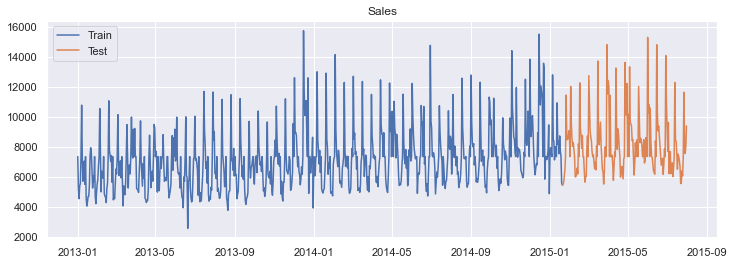

In [975]:
plt.figure(figsize=(12,4))
plt.plot(train, label='Train')
plt.plot(test, label='Test')
plt.legend(loc='best')
plt.title('Sales')
plt.show()

In [976]:
# Model training
model = ARIMA(new_df['sales_log'], order=(3, 0, 4))
model_fit = model.fit()
print(model_fit.params)

const              8.870950
ar.L1.sales_log    0.732493
ar.L2.sales_log    0.771157
ar.L3.sales_log   -0.896238
ma.L1.sales_log   -0.281556
ma.L2.sales_log   -0.839161
ma.L3.sales_log    0.574690
ma.L4.sales_log    0.237589
dtype: float64


In [977]:
new_df['ar_forecast_Log'] = model_fit.predict(new_df.index.min(), new_df.index.max())
new_df['arima_forecast'] = np.exp(new_df['ar_forecast_Log'])
new_df['arima_forecast']

date
2013-01-01    7122.046976
2013-01-02    7255.476338
2013-01-03    6119.407958
2013-01-04    5521.447458
2013-01-05    5896.273056
                 ...     
2015-07-27    7628.113406
2015-07-28    9015.415463
2015-07-29    8462.412083
2015-07-30    7810.932505
2015-07-31    8123.448289
Name: arima_forecast, Length: 942, dtype: float64

In [978]:
new_df['ar_forecast_Log'] = model_fit.predict(new_df.index.min(), new_df.index.max())
new_df['arima_forecast'] = np.exp(new_df['ar_forecast_Log'])
new_df['arima_forecast']

date
2013-01-01    7122.046976
2013-01-02    7255.476338
2013-01-03    6119.407958
2013-01-04    5521.447458
2013-01-05    5896.273056
                 ...     
2015-07-27    7628.113406
2015-07-28    9015.415463
2015-07-29    8462.412083
2015-07-30    7810.932505
2015-07-31    8123.448289
Name: arima_forecast, Length: 942, dtype: float64

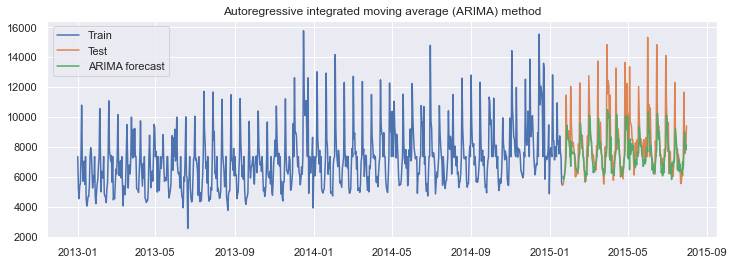

In [979]:
plt.figure(figsize=(12,4))
plt.plot(train, label='Train')
plt.plot(test, label='Test')
plt.plot(new_df['arima_forecast'][test.index.min():], label='ARIMA forecast')
plt.legend(loc='best')
plt.title('Autoregressive integrated moving average (ARIMA) method')
plt.show()

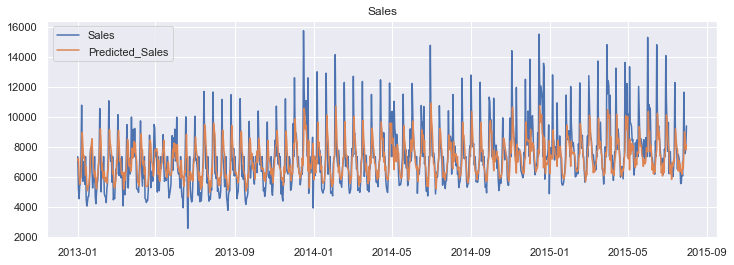

In [980]:
# plot the arima forecasting & Original series
plt.figure(figsize=(12,4))
plt.plot(new_df['sales'], label='Sales')
plt.plot(new_df['arima_forecast'], label='Predicted_Sales')
plt.legend(loc='best')
plt.title('Sales')
plt.show()

**Model Evalution**

In [981]:
from sklearn.metrics import mean_squared_error
rmse = np.sqrt(mean_squared_error(test, new_df['arima_forecast'][test.index.min():])).round(2)
mape = np.round(np.mean(np.abs(test-new_df['arima_forecast'][test.index.min():])/test)*100,2)
Results = pd.DataFrame({'Method':['ARIMA'], 'RMSE': [rmse],'MAPE': [mape] })
Results

,Method,RMSE,MAPE
0,ARIMA,1847.92,11.58


**VAR model**

In [982]:
#Load the dataset
new_df.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast
date,,,,,,,,,,,,
2013-01-01,29,2,7364.775353,0,0,0,a,1,0,8.904464,8.870950,7122.046976
2013-01-02,29,3,5269.000000,550,1,0,0,1,0,8.569596,8.889512,7255.476338
2013-01-03,29,4,4554.000000,456,1,0,0,1,0,8.423761,8.719221,6119.407958
2013-01-04,29,5,5411.000000,505,1,0,0,1,0,8.596189,8.616395,5521.447458
2013-01-05,29,6,5564.000000,537,1,0,0,0,0,8.624073,8.682076,5896.273056


**Split the dataset to training & testing**

In [983]:
#split the dataset
nobs = 192
train, test = new_df[0:-nobs], new_df[-nobs:]

# Check size
print(train.shape)
print(test.shape)

(750, 12)
(192, 12)


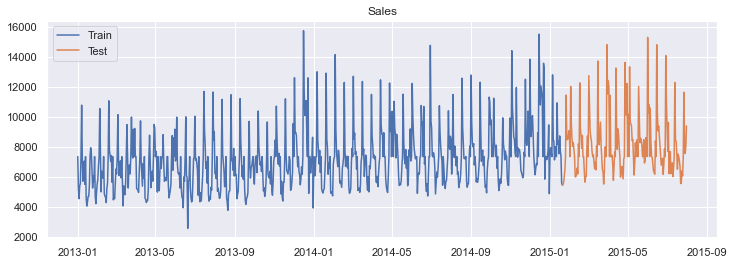

In [984]:
plt.figure(figsize=(12,4))
plt.plot(train['sales'], label='Train')
plt.plot(test['sales'], label='Test')
plt.legend(loc='best')
plt.title('Sales')
plt.show()

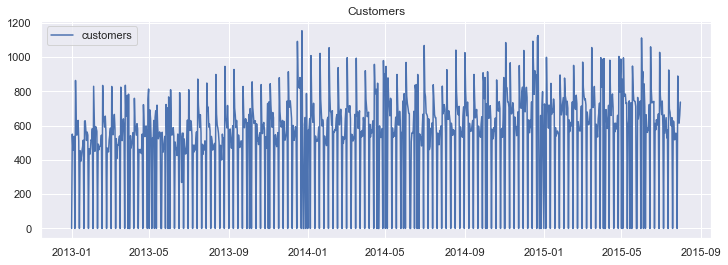

In [985]:
#plot the arima forecasting & Original series
plt.figure(figsize=(12,4))
plt.plot(new_df['customers'],label='customers')
plt.legend(loc='best')
plt.title('Customers')
plt.show()

In [986]:
(new_df['customers']==0).sum()

163

In [987]:
#impute the NAN values
new_df['customers']=new_df['customers'].replace(0, np.nan)

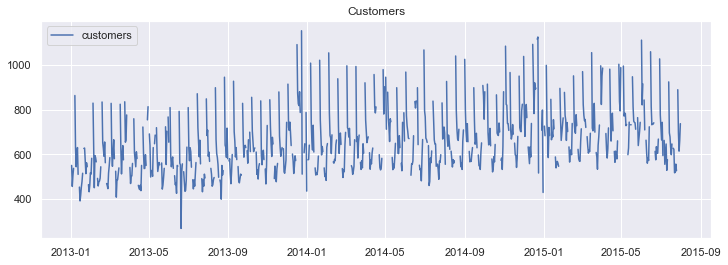

In [988]:
#plot the arima forecasting & Original series
plt.figure(figsize=(12,4))
plt.plot(new_df['customers'],label='customers')
plt.legend(loc='best')
plt.title('Customers')
plt.show()

In [989]:
#KNN imputer for filling NAN values
imputer = KNNImputer(n_neighbors=2)

In [990]:
new_df['customers'] = imputer.fit_transform(np.array(new_df['customers']).reshape(-1, 1))
new_df['customers'].head()

date
2013-01-01    653.700899
2013-01-02    550.000000
2013-01-03    456.000000
2013-01-04    505.000000
2013-01-05    537.000000
Name: customers, dtype: float64

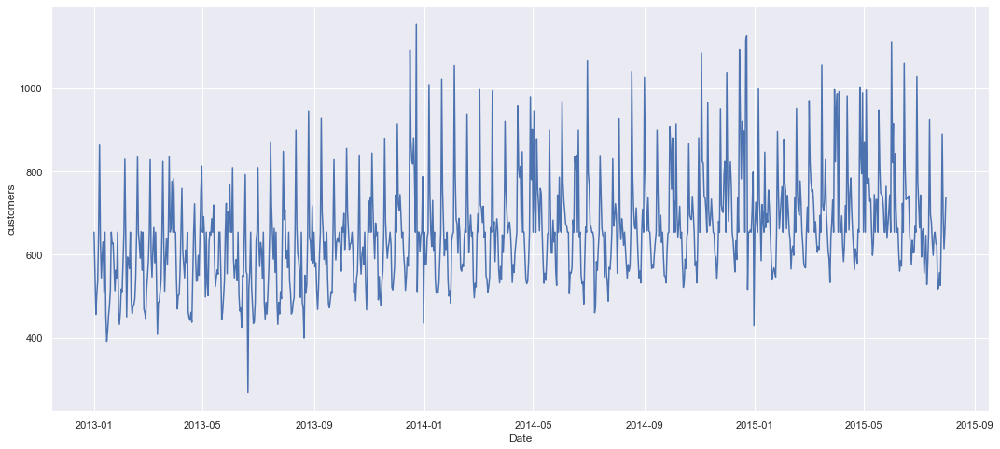

In [991]:
## plot graph
plt.xlabel('Date')
plt.ylabel('customers')
plt.plot(new_df['customers'])
plt.show()

In [992]:
new_df.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast
date,,,,,,,,,,,,
2013-01-01,29,2,7364.775353,653.700899,0,0,a,1,0,8.904464,8.870950,7122.046976
2013-01-02,29,3,5269.000000,550.000000,1,0,0,1,0,8.569596,8.889512,7255.476338
2013-01-03,29,4,4554.000000,456.000000,1,0,0,1,0,8.423761,8.719221,6119.407958
2013-01-04,29,5,5411.000000,505.000000,1,0,0,1,0,8.596189,8.616395,5521.447458
2013-01-05,29,6,5564.000000,537.000000,1,0,0,0,0,8.624073,8.682076,5896.273056


**ADF test**

In [993]:
def test_stationarity(timeseries):
    
    #Determine rolling statistics
    movingAverage = timeseries.rolling(window=12).mean()
    movingSTD = timeseries.rolling(window=12).std()
    
    #Plot rolling statistics
    orig = plt.plot(timeseries, color='blue', label='Original')
    mean = plt.plot(movingAverage, color='red', label='Rolling Mean')
    std = plt.plot(movingSTD, color='black', label='Rolling Std')
    plt.legend(loc='best')
    plt.title('Rolling Mean & Standard Deviation')
    plt.show(block=False)
    
    #Perform Dickey–Fuller test:
    print('Results of Dickey Fuller Test:')
    dftest = adfuller(new_df['customers'], autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    for key,value in dftest[4].items():
        dfoutput['Critical Value (%s)'%key] = value
    print(dfoutput)

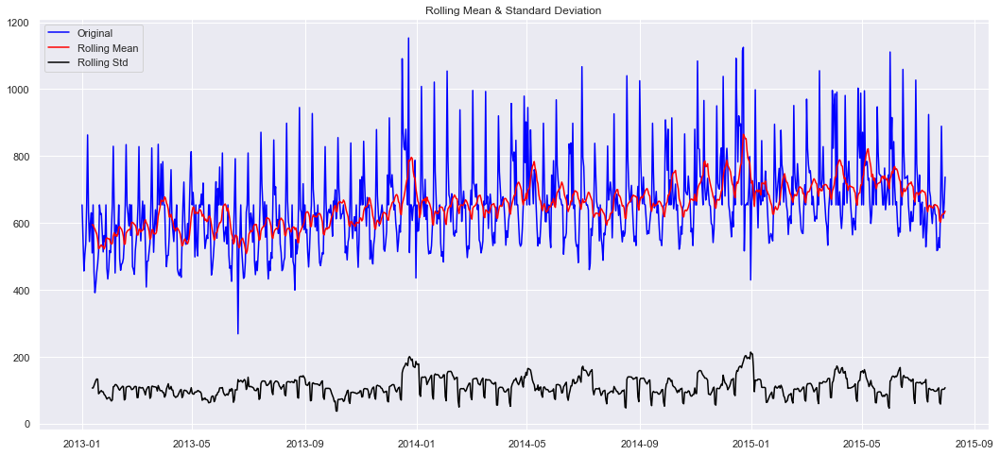

Results of Dickey Fuller Test:
Test Statistic                  -3.253264
p-value                          0.017101
#Lags Used                      20.000000
Number of Observations Used    921.000000
Critical Value (1%)             -3.437470
Critical Value (5%)             -2.864683
Critical Value (10%)            -2.568444
dtype: float64


In [994]:
test_stationarity(new_df['customers'])

- Null: Time Series is not stationary
- Alternate: Time Series is Stationary

**The p-value is less than 0.05 so The series is stationary**

In [995]:
from statsmodels.tsa.stattools import kpss
kpss_test = kpss(new_df['customers'])

print('KPSS Statistic: %f' % kpss_test[0])
print('Critical Values @ 0.05: %.2f' % kpss_test[3]['5%'])
print('p-value: %f' % kpss_test[1])

KPSS Statistic: 2.863809
Critical Values @ 0.05: 0.46
p-value: 0.010000


- Null: Time Series is not stationary
- Alternate: Time Series is Stationary

**The p-value is less than 0.05 so The series is non-stationary**

**Log transformation has made mean & variance constant**

In [996]:
#Log Transformation
new_df['customers_log'] = np.log(new_df['customers'])
new_df.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast,customers_log
date,,,,,,,,,,,,,
2013-01-01,29,2,7364.775353,653.700899,0,0,a,1,0,8.904464,8.870950,7122.046976,6.482650
2013-01-02,29,3,5269.000000,550.000000,1,0,0,1,0,8.569596,8.889512,7255.476338,6.309918
2013-01-03,29,4,4554.000000,456.000000,1,0,0,1,0,8.423761,8.719221,6119.407958,6.122493
2013-01-04,29,5,5411.000000,505.000000,1,0,0,1,0,8.596189,8.616395,5521.447458,6.224558
2013-01-05,29,6,5564.000000,537.000000,1,0,0,0,0,8.624073,8.682076,5896.273056,6.285998


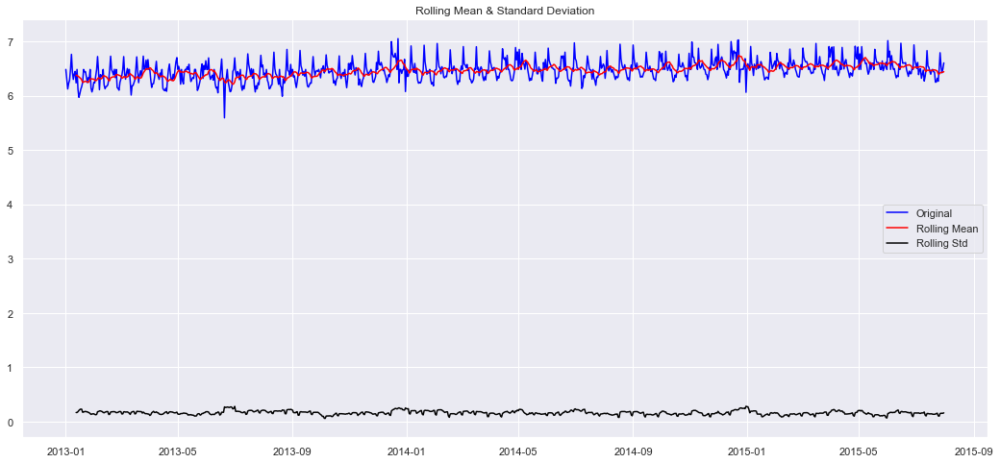

Results of Dickey Fuller Test:
Test Statistic                  -3.253264
p-value                          0.017101
#Lags Used                      20.000000
Number of Observations Used    921.000000
Critical Value (1%)             -3.437470
Critical Value (5%)             -2.864683
Critical Value (10%)            -2.568444
dtype: float64


In [997]:
test_stationarity(new_df['customers_log'])

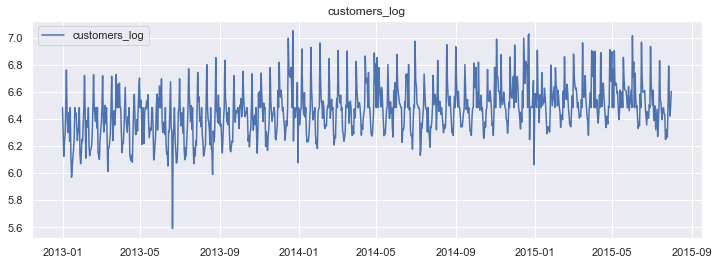

In [998]:
#plot the arima Log series
plt.figure(figsize=(12,4))
plt.plot(new_df['customers_log'],label='customers_log')
plt.legend(loc='best')
plt.title('customers_log')
plt.show()

In [999]:
#Let's check the info
new_df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 942 entries, 2013-01-01 to 2015-07-31
Data columns (total 13 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   store            942 non-null    int64  
 1   day_of_week      942 non-null    int64  
 2   sales            942 non-null    float64
 3   customers        942 non-null    float64
 4   open             942 non-null    int64  
 5   promo            942 non-null    int64  
 6   state_holiday    942 non-null    object 
 7   school_holiday   942 non-null    int64  
 8   promo2           942 non-null    int64  
 9   sales_log        942 non-null    float64
 10  ar_forecast_Log  942 non-null    float64
 11  arima_forecast   942 non-null    float64
 12  customers_log    942 non-null    float64
dtypes: float64(6), int64(6), object(1)
memory usage: 143.0+ KB


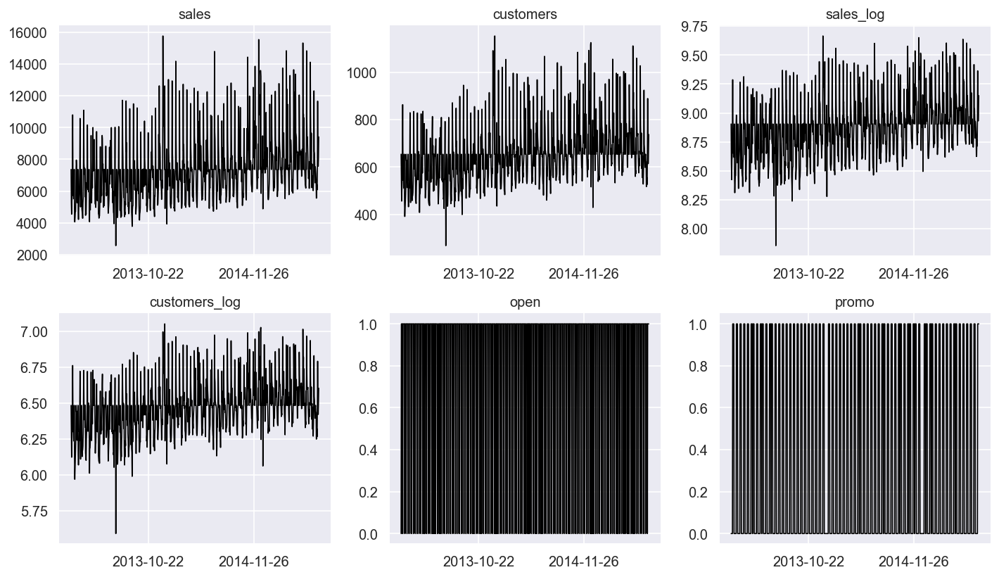

In [1000]:
# Plot
ls=['sales','customers','sales_log','customers_log','open','promo','state_holiday','promo2','school_holiday']
df=new_df[ls]
fig, axes = plt.subplots(nrows=2, ncols=3, dpi=120, figsize=(12,7))
for i, ax in enumerate(axes.flatten()):
        ax.plot(df[df.columns[i]], color='black', linewidth=1)
        ax.xaxis.set_major_locator(plt.MaxNLocator(3))
        # Decorations
        ax.set_title(df.columns[i])
        ax.xaxis.set_ticks_position('none')
        ax.yaxis.set_ticks_position('none')
        ax.spines["top"].set_alpha(0)
        ax.tick_params(labelsize=12)

plt.tight_layout();

In [1001]:
new_df.columns

Index(['store', 'day_of_week', 'sales', 'customers', 'open', 'promo',
       'state_holiday', 'school_holiday', 'promo2', 'sales_log',
       'ar_forecast_Log', 'arima_forecast', 'customers_log'],
      dtype='object')

In [1002]:
new_df1=new_df[['sales_log', 'customers_log']]
new_df1

,sales_log,customers_log
date,,
2013-01-01,8.904464,6.482650
2013-01-02,8.569596,6.309918
2013-01-03,8.423761,6.122493
2013-01-04,8.596189,6.224558
2013-01-05,8.624073,6.285998
...,...,...
2015-07-27,9.363834,6.790097
2015-07-28,9.041922,6.546785
2015-07-29,8.931155,6.419995


In [1003]:
#Let's create a model
model = VAR(new_df1)
for i in [1,2,3,4,5]:
    result = model.fit(i)
    print('Lag Order =', i)
    print('AIC : ', result.aic)
    print('BIC : ', result.bic)
    print('FPE : ', result.fpe)
    print('HQIC: ', result.hqic, '\n')

Lag Order = 1
AIC :  -9.631665437772886
BIC :  -9.600760380559802
FPE :  6.561767944640572e-05
HQIC:  -9.619884749623976 

Lag Order = 2
AIC :  -9.662916539184382
BIC :  -9.611364625617743
FPE :  6.359877565449702e-05
HQIC:  -9.643264475498212 

Lag Order = 3
AIC :  -9.68802785825137
BIC :  -9.615794187634847
FPE :  6.202163353135304e-05
HQIC:  -9.660490305495205 

Lag Order = 4
AIC :  -9.720389521188444
BIC :  -9.62743909572777
FPE :  6.00466772898824e-05
HQIC:  -9.684952325554795 

Lag Order = 5
AIC :  -9.732937451561748
BIC :  -9.619235175991582
FPE :  5.929798133279188e-05
HQIC:  -9.68958641881144 



In [1004]:
x = model.select_order(maxlags=5)
x.summary()

,AIC,BIC,FPE,HQIC
0,-9.154,-9.144,0.0001058,-9.150
1,-9.633,-9.602,6.555e-05,-9.621
2,-9.661,-9.610,6.370e-05,-9.642
3,-9.686,-9.614,6.214e-05,-9.659
4,-9.718,-9.625*,6.017e-05,-9.683
5,-9.733*,-9.619,5.930e-05*,-9.690*


In [1005]:
#Let's fit the model
model_fitted = model.fit()
model_fitted.summary()

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Mon, 17, Jan, 2022
Time:                     16:29:23
--------------------------------------------------------------------
No. of Equations:         2.00000    BIC:                   -9.60076
Nobs:                     941.000    HQIC:                  -9.61988
Log likelihood:           1867.26    FPE:                6.56177e-05
AIC:                     -9.63167    Det(Omega_mle):     6.52013e-05
--------------------------------------------------------------------
Results for equation sales_log
                      coefficient       std. error           t-stat            prob
-----------------------------------------------------------------------------------
const                    3.827637         0.237784           16.097           0.000
L1.sales_log             0.956601         0.121268            7.888           0.000
L1.customers_log        -0.532448         0.

In [1006]:
# Get the lag order
lag_order = model_fitted.k_ar
print(lag_order)  #> 4

1


In [1007]:
# Input data for forecasting
forecast_input = new_df1.values[-lag_order:]
forecast_input

array([[9.1496345 , 6.60258789]])

In [1008]:
# Forecast
fc = model_fitted.forecast(y=forecast_input, steps=192)
df_forecast = pd.DataFrame(fc, index=new_df.index[-192:], columns=new_df1.columns + '_2d')
df_forecast

,sales_log_2d,customers_log_2d
date,,
2015-01-21,9.064654,6.585678
2015-01-22,8.992365,6.545713
2015-01-23,8.944492,6.515146
2015-01-24,8.914973,6.495454
2015-01-25,8.897219,6.483424
...,...,...
2015-07-27,8.871226,6.465677
2015-07-28,8.871226,6.465677
2015-07-29,8.871226,6.465677


In [1009]:
df_forecast['VAR_forecast_Sales'] = np.exp(df_forecast['sales_log_2d'])
df_forecast['VAR_forecast_customers'] = np.exp(df_forecast['customers_log_2d'])
df_forecast

,sales_log_2d,customers_log_2d,VAR_forecast_Sales,VAR_forecast_customers
date,,,,
2015-01-21,9.064654,6.585678,8644.285481,724.642144
2015-01-22,8.992365,6.545713,8041.450264,696.252619
2015-01-23,8.944492,6.515146,7665.557017,675.292714
2015-01-24,8.914973,6.495454,7442.579390,662.124740
2015-01-25,8.897219,6.483424,7311.613816,654.207257
...,...,...,...,...
2015-07-27,8.871226,6.465677,7124.012050,642.699043
2015-07-28,8.871226,6.465677,7124.012050,642.699043
2015-07-29,8.871226,6.465677,7124.012050,642.699043


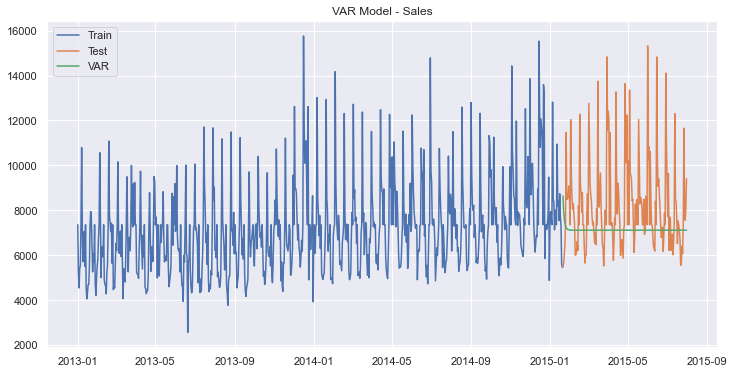

In [1010]:
plt.figure(figsize=(12,6)) 
plt.plot(train['sales'], label='Train')
plt.plot(test['sales'], label='Test')
plt.plot(df_forecast['VAR_forecast_Sales'], label='VAR')
plt.legend(loc='best')
plt.title('VAR Model - Sales')
plt.show()

In [1011]:
train_len = 750
train1 = new_df[0:train_len] # first 750days as training set
test1 = new_df[train_len:] # last 42 days as out-of-time test set

In [1012]:
train1.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast,customers_log
date,,,,,,,,,,,,,
2013-01-01,29,2,7364.775353,653.700899,0,0,a,1,0,8.904464,8.870950,7122.046976,6.482650
2013-01-02,29,3,5269.000000,550.000000,1,0,0,1,0,8.569596,8.889512,7255.476338,6.309918
2013-01-03,29,4,4554.000000,456.000000,1,0,0,1,0,8.423761,8.719221,6119.407958,6.122493
2013-01-04,29,5,5411.000000,505.000000,1,0,0,1,0,8.596189,8.616395,5521.447458,6.224558
2013-01-05,29,6,5564.000000,537.000000,1,0,0,0,0,8.624073,8.682076,5896.273056,6.285998


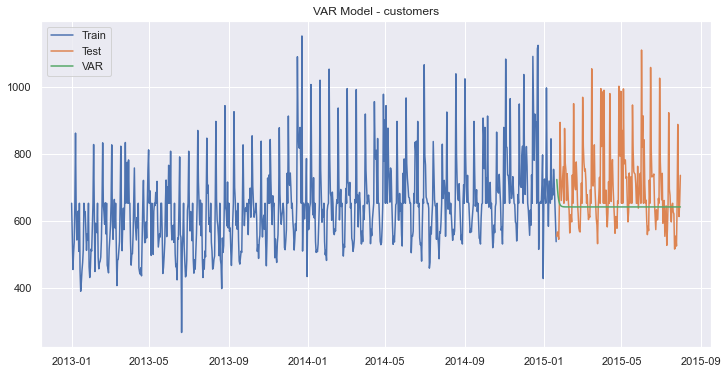

In [1013]:
plt.figure(figsize=(12,6)) 
plt.plot(train1['customers'], label='Train')
plt.plot(test1['customers'], label='Test')
plt.plot(df_forecast['VAR_forecast_customers'], label='VAR')
plt.legend(loc='best')
plt.title('VAR Model - customers')
plt.show()

**Model Evalution**


In [1014]:
# Let's calculate the rmse and MAPE
rmse = np.sqrt(mean_squared_error(test1['sales'], df_forecast['VAR_forecast_Sales'])).round(2)
mape = np.round(np.mean(np.abs(test1['sales']-df_forecast['VAR_forecast_Sales'])/test1['sales'])*100,2)
tempResults = pd.DataFrame({'Method':['VAR'], 'RMSE': [rmse],'MAPE': [mape] })

In [1015]:
tempResults

,Method,RMSE,MAPE
0,VAR,2299.54,16.51


In [1016]:
results = pd.concat([Results , tempResults])
results = results[['Method', 'RMSE', 'MAPE']]
results

,Method,RMSE,MAPE
0,ARIMA,1847.92,11.58
0,VAR,2299.54,16.51


**Johansen-Impulse**

In [1017]:
joh_model1 = coint_johansen(new_df[['sales','customers']],-1,1)

In [1018]:
joh_model1

In [1019]:
joh_model1.lr1

array([170.93024957,   1.87906465])

In [1020]:
joh_model1.lr2

array([169.05118492,   1.87906465])

In [1021]:
new_df[['sales','customers']].shape

(942, 2)

In [1022]:
def joh_output(res):
    output = pd.DataFrame([res.lr2,res.lr1],
                          index=['max_eig_stat',"trace_stat"])
    print(output.T,'\n')
    print("Critical values(90%, 95%, 99%) of max_eig_stat\n",res.cvm,'\n')
    print("Critical values(90%, 95%, 99%) of trace_stat\n",res.cvt,'\n')

In [1023]:
joh_output(joh_model1)

   max_eig_stat  trace_stat
0    169.051185  170.930250
1      1.879065    1.879065 

Critical values(90%, 95%, 99%) of max_eig_stat
 [[ 9.4748 11.2246 15.0923]
 [ 2.9762  4.1296  6.9406]] 

Critical values(90%, 95%, 99%) of trace_stat
 [[10.4741 12.3212 16.364 ]
 [ 2.9762  4.1296  6.9406]] 



In [1024]:
from statsmodels.tsa.vector_ar.vecm import select_coint_rank

In [1025]:
rank=select_coint_rank(new_df[['sales','customers']],-1,1)
print(rank.rank)

1


**Rank is one**


In [1026]:
from statsmodels.tsa.stattools import coint

In [1027]:
coint(new_df['sales'],new_df['customers'])#null hypothesis-There is not coint

(-3.8975102835426023,
 0.009998134852943664,
 array([-3.90811644, -3.3426309 , -3.04896019]))

0.009998134852943664<.05

We can reject the null hypothesis

**Sales and customers are cointegration to each other**

**VARMAX MODEL**


In [1028]:
#create dymmy variables
new_df=pd.get_dummies(new_df)
new_df.head()

,store,day_of_week,sales,customers,open,promo,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast,customers_log,state_holiday_0,state_holiday_0,state_holiday_a,state_holiday_b,state_holiday_c
date,,,,,,,,,,,,,,,,,
2013-01-01,29,2,7364.775353,653.700899,0,0,1,0,8.904464,8.870950,7122.046976,6.482650,0,0,1,0,0
2013-01-02,29,3,5269.000000,550.000000,1,0,1,0,8.569596,8.889512,7255.476338,6.309918,0,1,0,0,0
2013-01-03,29,4,4554.000000,456.000000,1,0,1,0,8.423761,8.719221,6119.407958,6.122493,0,1,0,0,0
2013-01-04,29,5,5411.000000,505.000000,1,0,1,0,8.596189,8.616395,5521.447458,6.224558,0,1,0,0,0
2013-01-05,29,6,5564.000000,537.000000,1,0,0,0,8.624073,8.682076,5896.273056,6.285998,0,1,0,0,0


In [1029]:
new_df.head()

,store,day_of_week,sales,customers,open,promo,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast,customers_log,state_holiday_0,state_holiday_0,state_holiday_a,state_holiday_b,state_holiday_c
date,,,,,,,,,,,,,,,,,
2013-01-01,29,2,7364.775353,653.700899,0,0,1,0,8.904464,8.870950,7122.046976,6.482650,0,0,1,0,0
2013-01-02,29,3,5269.000000,550.000000,1,0,1,0,8.569596,8.889512,7255.476338,6.309918,0,1,0,0,0
2013-01-03,29,4,4554.000000,456.000000,1,0,1,0,8.423761,8.719221,6119.407958,6.122493,0,1,0,0,0
2013-01-04,29,5,5411.000000,505.000000,1,0,1,0,8.596189,8.616395,5521.447458,6.224558,0,1,0,0,0
2013-01-05,29,6,5564.000000,537.000000,1,0,0,0,8.624073,8.682076,5896.273056,6.285998,0,1,0,0,0


In [1030]:
#VARMAX model training
exog = new_df[['open','promo','school_holiday','promo2','state_holiday_0','state_holiday_a','state_holiday_b','state_holiday_c']]
mod = sm.tsa.VARMAX(new_df[['sales_log', 'customers_log']], order=(1,1), trend='n', exog=exog)
res = mod.fit(maxiter=1000, disp=False)
print(res.summary())

                                 Statespace Model Results                                 
Dep. Variable:     ['sales_log', 'customers_log']   No. Observations:                  942
Model:                                VARMAX(1,1)   Log Likelihood                1993.626
Date:                            Mon, 17 Jan 2022   AIC                          -3929.251
Time:                                    16:32:24   BIC                          -3788.659
Sample:                                01-01-2013   HQIC                         -3875.662
                                     - 07-31-2015                                         
Covariance Type:                              opg                                         
Ljung-Box (L1) (Q):             0.24, 0.06   Jarque-Bera (JB):        221.33, 45.25
Prob(Q):                        0.62, 0.80   Prob(JB):                   0.00, 0.00
Heteroskedasticity (H):         1.03, 0.97   Skew:                      0.53, -0.11
Prob(H) (two-sided):

In [1031]:
train_len = 750
train = new_df[0:train_len] # first 750days as training set
test = new_df[train_len:] 

start_index = test.index.min()
end_index = test.index.max()

In [1032]:
print(start_index)
print(end_index)

2015-01-21 00:00:00
2015-07-31 00:00:00


In [1033]:
test.head()

,store,day_of_week,sales,customers,open,promo,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast,customers_log,state_holiday_0,state_holiday_0,state_holiday_a,state_holiday_b,state_holiday_c
date,,,,,,,,,,,,,,,,,
2015-01-21,29,3,5470.000000,555.000000,1,0,0,0,8.607034,8.707797,6049.899891,6.318968,0,1,0,0,0
2015-01-22,29,4,5626.000000,568.000000,1,0,0,0,8.635154,8.678721,5876.525924,6.342121,0,1,0,0,0
2015-01-23,29,5,5997.000000,560.000000,1,0,0,0,8.699015,8.688136,5932.115287,6.327937,0,1,0,0,0
2015-01-24,29,6,6461.000000,546.000000,1,0,0,0,8.773539,8.742732,6264.988354,6.302619,0,1,0,0,0
2015-01-25,29,7,7364.775353,653.700899,0,0,0,0,8.904464,8.811557,6711.361584,6.482650,0,1,0,0,0


In [1034]:
#Prediction
predictions = mod.fit().predict(start=start_index, end=end_index, exog=test[['open','promo','school_holiday','promo2','state_holiday_0','state_holiday_a','state_holiday_b','state_holiday_c']])

In [1035]:
predictions

,sales_log,customers_log
2015-01-21,8.665449,6.331553
2015-01-22,8.665674,6.337925
2015-01-23,8.675651,6.345579
2015-01-24,8.700561,6.349387
2015-01-25,8.888454,6.445632
...,...,...
2015-07-27,8.977995,6.529782
2015-07-28,9.150119,6.644484
2015-07-29,9.036986,6.563806
2015-07-30,8.993642,6.522870


In [1036]:
#Inverse of log
predictions['VARMAX_forecast_Sales'] = np.exp(predictions['sales_log'])
predictions['VARMAX_forecast_customers'] = np.exp(predictions['customers_log'])
predictions

,sales_log,customers_log,VARMAX_forecast_Sales,VARMAX_forecast_customers
2015-01-21,8.665449,6.331553,5799.045507,562.028850
2015-01-22,8.665674,6.337925,5800.353253,565.621522
2015-01-23,8.675651,6.345579,5858.512537,569.967401
2015-01-24,8.700561,6.349387,6006.281776,572.142006
2015-01-25,8.888454,6.445632,7247.804473,629.944701
...,...,...,...,...
2015-07-27,8.977995,6.529782,7926.725602,685.248823
2015-07-28,9.150119,6.644484,9415.559066,768.533243
2015-07-29,9.036986,6.563806,8408.392382,708.964794
2015-07-30,8.993642,6.522870,8051.730459,680.529000


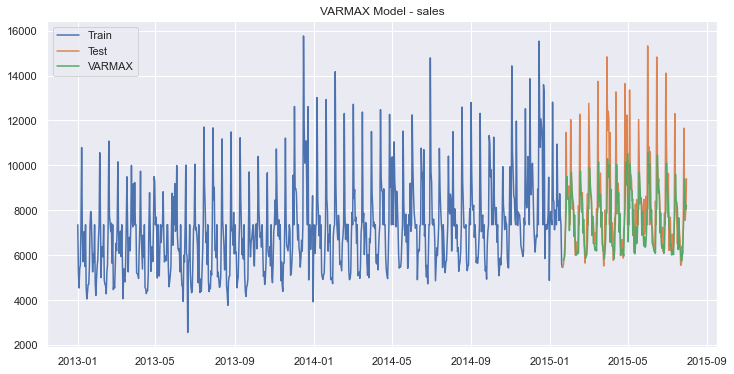

In [1037]:
plt.figure(figsize=(12,6)) 
plt.plot(train['sales'], label='Train')
plt.plot(test['sales'], label='Test')
plt.plot(predictions['VARMAX_forecast_Sales'], label='VARMAX')
plt.legend(loc='best')
plt.title('VARMAX Model - sales')
plt.show()

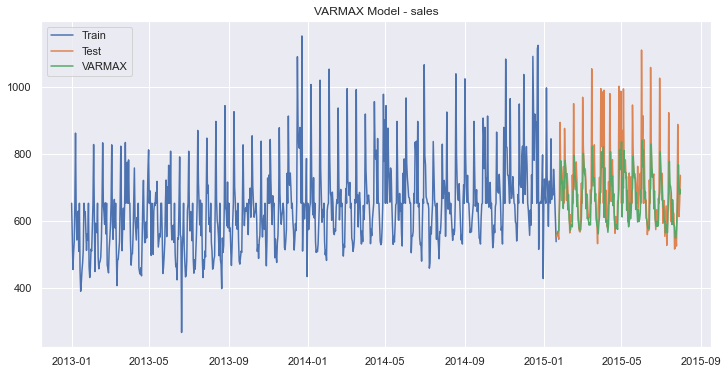

In [1038]:
plt.figure(figsize=(12,6)) 
plt.plot(train['customers'], label='Train')
plt.plot(test['customers'], label='Test')
plt.plot(predictions['VARMAX_forecast_customers'], label='VARMAX')
plt.legend(loc='best')
plt.title('VARMAX Model - sales')
plt.show()

**Model Evalution**


In [1039]:
# Let's calculate the rmse and MAPE
rmse = np.sqrt(mean_squared_error(test['sales'], predictions['VARMAX_forecast_Sales'])).round(2)
mape = np.round(np.mean(np.abs(test['sales']-predictions['VARMAX_forecast_Sales'])/test['sales'])*100,2)
tempResults = pd.DataFrame({'Method':['VARMAX'], 'RMSE': [rmse],'MAPE': [mape] })

In [1040]:
results = pd.concat([results  , tempResults])
results = results[['Method', 'RMSE', 'MAPE']]
results

,Method,RMSE,MAPE
0,ARIMA,1847.92,11.58
0,VAR,2299.54,16.51
0,VARMAX,1813.45,11.93


**VARMAX is the best model**


# Model-Store-31

In [1041]:
df_new[df_new['store']==31].head()

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year,promo2,promo2_since_week,promo2_since_year,promo_interval
30,31,5,2015-07-31,7248,645,1,1,0,1,d,c,9800.0,7.0,2012.0,0,NaN,NaN,NaN
1145,31,4,2015-07-30,6712,582,1,1,0,1,d,c,9800.0,7.0,2012.0,0,NaN,NaN,NaN
2260,31,3,2015-07-29,5982,570,1,1,0,1,d,c,9800.0,7.0,2012.0,0,NaN,NaN,NaN
3375,31,2,2015-07-28,5736,492,1,1,0,1,d,c,9800.0,7.0,2012.0,0,NaN,NaN,NaN
4490,31,1,2015-07-27,8054,684,1,1,0,1,d,c,9800.0,7.0,2012.0,0,NaN,NaN,NaN


In [1042]:
#Store_31
df_new_store31=df_new[df_new['store']==31]

In [1043]:
# transform datatype of the variable data to datetime
df_new_store31['date'] = pd.to_datetime(df_new_store31['date'])

In [1044]:
df_new_store31.info()
#Let's check the info

<class 'pandas.core.frame.DataFrame'>
Int64Index: 942 entries, 30 to 1016125
Data columns (total 18 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   store                         942 non-null    int64         
 1   day_of_week                   942 non-null    int64         
 2   date                          942 non-null    datetime64[ns]
 3   sales                         942 non-null    int64         
 4   customers                     942 non-null    int64         
 5   open                          942 non-null    int64         
 6   promo                         942 non-null    int64         
 7   state_holiday                 942 non-null    object        
 8   school_holiday                942 non-null    int64         
 9   store_type                    942 non-null    object        
 10  assortment                    942 non-null    object        
 11  competition_distance       

In [1045]:
# Check NAN values
missing_count = df_new_store31.isnull().sum() # the count of missing values
value_count = df_new_store31.isnull().count() # the count of all values

missing_percentage = round(missing_count/value_count *100, 2) # the percentage of missing values
missing_df = pd.DataFrame({'missing values count': missing_count, 'percentage': missing_percentage})
missing_df

,missing values count,percentage
store,0,0.0
day_of_week,0,0.0
date,0,0.0
sales,0,0.0
customers,0,0.0
open,0,0.0
promo,0,0.0
state_holiday,0,0.0
school_holiday,0,0.0
store_type,0,0.0


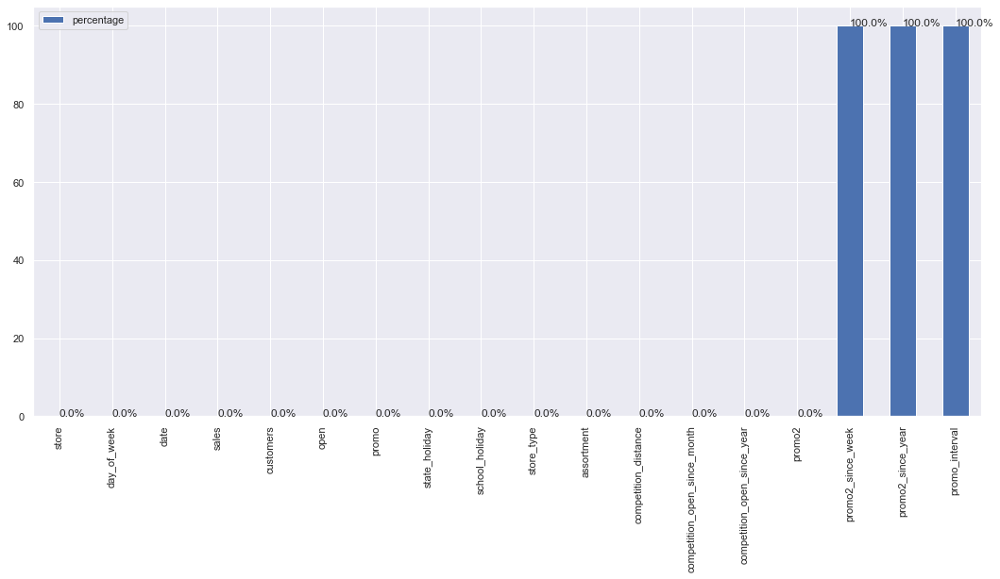

In [1046]:
barchart = missing_df.plot.bar(y='percentage')
for index, percentage in enumerate( missing_percentage ):
    barchart.text( index, percentage, str(percentage)+'%')

In [1047]:
#Let's drop the promo2_since_year,promo2_since_year,promo_interval
df_new_store31=df_new_store31.drop(['promo2_since_week','promo2_since_year','promo_interval'], axis = 1)

In [1048]:
df_new_store31.columns

Index(['store', 'day_of_week', 'date', 'sales', 'customers', 'open', 'promo',
       'state_holiday', 'school_holiday', 'store_type', 'assortment',
       'competition_distance', 'competition_open_since_month',
       'competition_open_since_year', 'promo2'],
      dtype='object')

In [1049]:
df_new_store31.head()

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year,promo2
30,31,5,2015-07-31,7248,645,1,1,0,1,d,c,9800.0,7.0,2012.0,0
1145,31,4,2015-07-30,6712,582,1,1,0,1,d,c,9800.0,7.0,2012.0,0
2260,31,3,2015-07-29,5982,570,1,1,0,1,d,c,9800.0,7.0,2012.0,0
3375,31,2,2015-07-28,5736,492,1,1,0,1,d,c,9800.0,7.0,2012.0,0
4490,31,1,2015-07-27,8054,684,1,1,0,1,d,c,9800.0,7.0,2012.0,0


In [1050]:
df_new_store31.head()

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year,promo2
30,31,5,2015-07-31,7248,645,1,1,0,1,d,c,9800.0,7.0,2012.0,0
1145,31,4,2015-07-30,6712,582,1,1,0,1,d,c,9800.0,7.0,2012.0,0
2260,31,3,2015-07-29,5982,570,1,1,0,1,d,c,9800.0,7.0,2012.0,0
3375,31,2,2015-07-28,5736,492,1,1,0,1,d,c,9800.0,7.0,2012.0,0
4490,31,1,2015-07-27,8054,684,1,1,0,1,d,c,9800.0,7.0,2012.0,0


In [1051]:
df_new_store31.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 942 entries, 30 to 1016125
Data columns (total 15 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   store                         942 non-null    int64         
 1   day_of_week                   942 non-null    int64         
 2   date                          942 non-null    datetime64[ns]
 3   sales                         942 non-null    int64         
 4   customers                     942 non-null    int64         
 5   open                          942 non-null    int64         
 6   promo                         942 non-null    int64         
 7   state_holiday                 942 non-null    object        
 8   school_holiday                942 non-null    int64         
 9   store_type                    942 non-null    object        
 10  assortment                    942 non-null    object        
 11  competition_distance       

In [1052]:
# Let's copy the dataset
df_store31 = df_new_store31.copy()

**Descriptive Statistics**

In [1053]:
df_store31.describe().T

,count,mean,std,min,25%,50%,75%,max
store,942.0,31.000000,0.000000,31.0,31.00,31.0,31.0,31.0
day_of_week,942.0,3.997877,1.998404,1.0,2.00,4.0,6.0,7.0
sales,942.0,4879.132696,2506.671454,0.0,4370.25,5403.0,6316.0,13252.0
customers,942.0,487.753715,234.178009,0.0,485.00,558.0,614.0,1310.0
open,942.0,0.832272,0.373823,0.0,1.00,1.0,1.0,1.0
promo,942.0,0.382166,0.486175,0.0,0.00,0.0,1.0,1.0
school_holiday,942.0,0.168790,0.374765,0.0,0.00,0.0,0.0,1.0
competition_distance,942.0,9800.000000,0.000000,9800.0,9800.00,9800.0,9800.0,9800.0
competition_open_since_month,942.0,7.000000,0.000000,7.0,7.00,7.0,7.0,7.0
competition_open_since_year,942.0,2012.000000,0.000000,2012.0,2012.00,2012.0,2012.0,2012.0


In [1054]:
# separate numerical and categorical attributes
num_attributes = df_store31.select_dtypes( include = 'number')
cate_attributes = df_store31.select_dtypes( include = 'object')

**Numerical Attributes**

In [1055]:
# Central Tendency - Mean, median
ct1 = pd.DataFrame( num_attributes.apply( np.mean ) ).T
ct2 = pd.DataFrame( num_attributes.apply( np.median ) ).T

# Dispersion - std, min, max, range, skew, kurtoisis
d1 = pd.DataFrame(num_attributes.apply( np.std )).T
d2 = pd.DataFrame(num_attributes.apply( min )).T
d3 = pd.DataFrame(num_attributes.apply( max )).T
d4 = pd.DataFrame(num_attributes.apply( lambda x: x.max() - x.min() )).T
d5 = pd.DataFrame(num_attributes.apply( lambda x: x.skew() )).T
d6 = pd.DataFrame(num_attributes.apply( lambda x: x.kurtosis() )).T

#concatenate
m = pd.concat( [d2, d3, d4, ct1, ct2, d1, d5, d6] ).T.reset_index()


m.columns = ['attributes', 'min', 'max', 'range', 'mean', 'median', 'std', 'skew', 'kurtosis']
m

,attributes,min,max,range,mean,median,std,skew,kurtosis
0,store,31.0,31.0,0.0,31.000000,31.0,0.000000,0.000000,0.000000
1,day_of_week,1.0,7.0,6.0,3.997877,4.0,1.997343,0.002127,-1.247185
2,sales,0.0,13252.0,13252.0,4879.132696,5403.0,2505.340596,-0.757594,0.286002
3,customers,0.0,1310.0,1310.0,487.753715,558.0,234.053678,-1.222017,0.651901
4,open,0.0,1.0,1.0,0.832272,1.0,0.373625,-1.781477,1.176152
5,promo,0.0,1.0,1.0,0.382166,0.0,0.485917,0.485772,-1.767783
6,school_holiday,0.0,1.0,1.0,0.168790,0.0,0.374566,1.771322,1.139998
7,competition_distance,9800.0,9800.0,0.0,9800.000000,9800.0,0.000000,0.000000,0.000000
8,competition_open_since_month,7.0,7.0,0.0,7.000000,7.0,0.000000,0.000000,0.000000
9,competition_open_since_year,2012.0,2012.0,0.0,2012.000000,2012.0,0.000000,0.000000,0.000000


**Categorical Attributes**


In [1056]:
# check unique values of categorical features
cate_attributes.apply( lambda x: x.unique().shape[0])

state_holiday    5
store_type       1
assortment       1
dtype: int64

In [1057]:
#Let's check the unique values
print(df_store31['state_holiday'].unique())
print(df_store31['store_type'].unique())
print(df_store31['assortment'].unique())

['0' 'a' 'b' 'c' 0]
['d']
['c']


In [1058]:
df_store31.columns

Index(['store', 'day_of_week', 'date', 'sales', 'customers', 'open', 'promo',
       'state_holiday', 'school_holiday', 'store_type', 'assortment',
       'competition_distance', 'competition_open_since_month',
       'competition_open_since_year', 'promo2'],
      dtype='object')

# Exploratory data analysis(EDA)

Let’s perform EDA to gain insights into the given data.

**Univariate Analysis**

Response Variable (target)

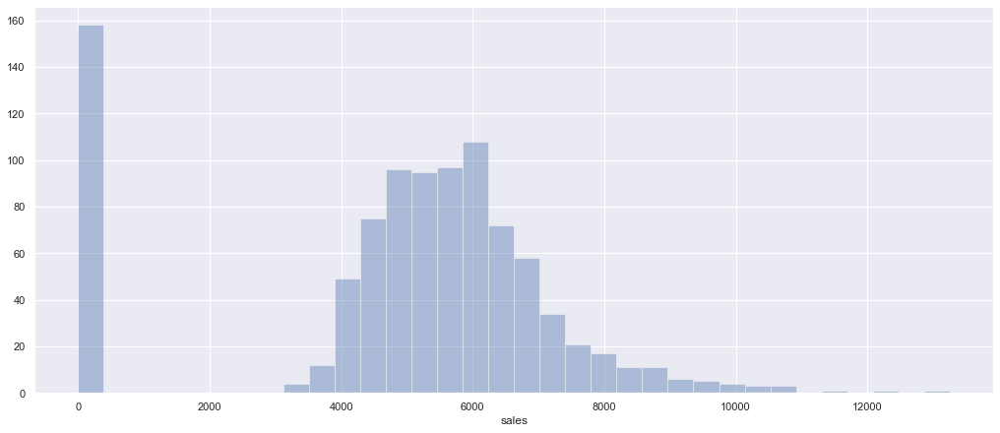

In [1059]:
fig = plt.figure( figsize = (14, 6), constrained_layout=True)
sns.distplot(df_store31['sales'], kde = False);
plt.show()

**Numerical Variable**

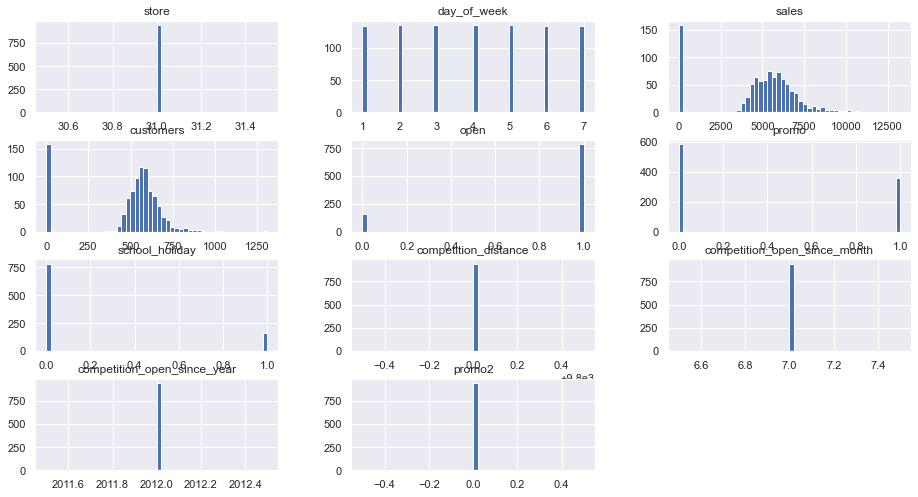

In [1060]:
sns.set(rc={'figure.figsize':(15.7,8.27)})
num_attributes.hist(bins = 50);

In [1061]:
df_store31['day_of_week'].value_counts()
#day of the week

5    135
4    135
3    135
2    135
7    134
6    134
1    134
Name: day_of_week, dtype: int64

In [1062]:
df_store31['open'].value_counts()
# value count of store is open or not

1    784
0    158
Name: open, dtype: int64

In [1063]:
df_store31['school_holiday'].value_counts()
# value count of state_holiday

0    783
1    159
Name: school_holiday, dtype: int64

In [1064]:
df_store31['store_type'].value_counts()
# value count of Store_type

d    942
Name: store_type, dtype: int64

In [1065]:
df_store31['assortment'].value_counts()
# value count of assortment

c    942
Name: assortment, dtype: int64

In [1066]:
df_store31['competition_distance'].value_counts()
# value count of competition distance

9800.0    942
Name: competition_distance, dtype: int64

In [1067]:
df_store31['competition_open_since_month'].value_counts()
# value count of competition_open_since_month

7.0    942
Name: competition_open_since_month, dtype: int64

In [1068]:
df_store31['competition_open_since_year'].value_counts()
# value count of competition open since year

2012.0    942
Name: competition_open_since_year, dtype: int64

In [1069]:
df_store31['promo2'].value_counts()
# value count of promo2

0    942
Name: promo2, dtype: int64

In [1070]:
df_store31.columns

Index(['store', 'day_of_week', 'date', 'sales', 'customers', 'open', 'promo',
       'state_holiday', 'school_holiday', 'store_type', 'assortment',
       'competition_distance', 'competition_open_since_month',
       'competition_open_since_year', 'promo2'],
      dtype='object')

**Categorical Variable**

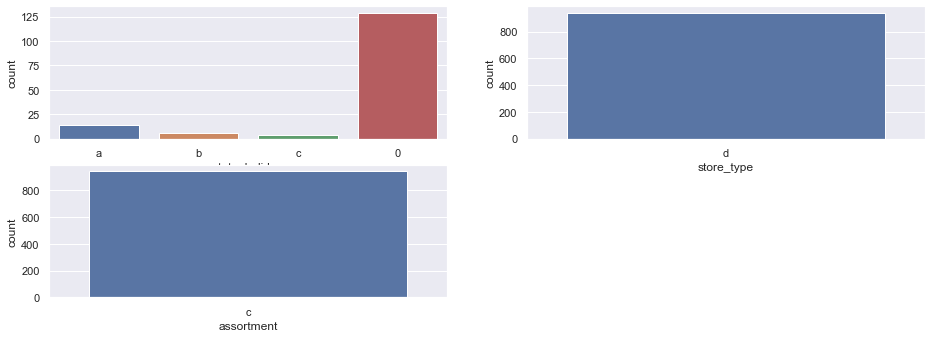

In [1071]:
# state_holiday
plt.subplot(3, 2, 1)
a = df_store31[df_store31['state_holiday'] != '0']
sns.countplot(data = a, x = a['state_holiday'])

# store_type
plt.subplot(3, 2, 2)
sns.countplot(data = df_store31, x = df_store31['store_type'])

# assortment
plt.subplot(3, 2, 3)
sns.countplot(data = df_store31, x = df_store31['assortment'])

plt.show()

In [1072]:
# Zero values in sales 
df_store31[df_store31['sales']==0]

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year,promo2
5605,31,7,2015-07-26,0,0,0,0,0,0,d,c,9800.0,7.0,2012.0,0
13410,31,7,2015-07-19,0,0,0,0,0,0,d,c,9800.0,7.0,2012.0,0
21215,31,7,2015-07-12,0,0,0,0,0,0,d,c,9800.0,7.0,2012.0,0
29020,31,7,2015-07-05,0,0,0,0,0,0,d,c,9800.0,7.0,2012.0,0
36825,31,7,2015-06-28,0,0,0,0,0,0,d,c,9800.0,7.0,2012.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
987135,31,7,2013-01-27,0,0,0,0,0,0,d,c,9800.0,7.0,2012.0,0
994940,31,7,2013-01-20,0,0,0,0,0,0,d,c,9800.0,7.0,2012.0,0
1002745,31,7,2013-01-13,0,0,0,0,0,0,d,c,9800.0,7.0,2012.0,0
1010550,31,7,2013-01-06,0,0,0,0,0,0,d,c,9800.0,7.0,2012.0,0


In [1073]:
df_store31.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 942 entries, 30 to 1016125
Data columns (total 15 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   store                         942 non-null    int64         
 1   day_of_week                   942 non-null    int64         
 2   date                          942 non-null    datetime64[ns]
 3   sales                         942 non-null    int64         
 4   customers                     942 non-null    int64         
 5   open                          942 non-null    int64         
 6   promo                         942 non-null    int64         
 7   state_holiday                 942 non-null    object        
 8   school_holiday                942 non-null    int64         
 9   store_type                    942 non-null    object        
 10  assortment                    942 non-null    object        
 11  competition_distance       


-    Sale  and customer colomns has zero values which has to be imputed

-    Store is open on 80% of days

-    80% are regular days

-    All the rows of column-store type belongs to 'd'

-    All the rows of column-assortment belongs to 'c'

-    All the rows of columns-competition_distance to 9800

-    All the rows of promo2 belogs to 0

**Bivariate Analysis**


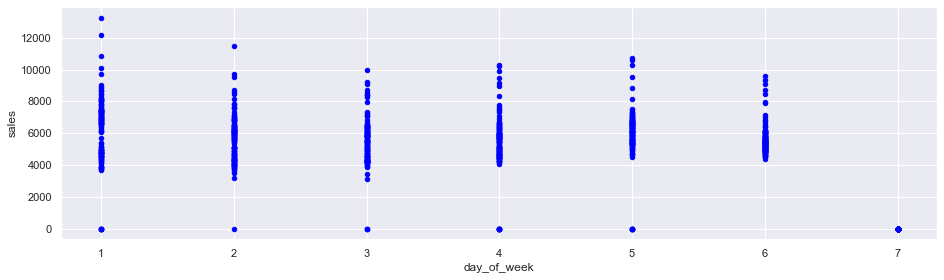

In [1074]:
# lets draw a scatter plot between  Sales and day_of_week
sns.set(rc={'figure.figsize':(15.7,4.27)})
df_store31[['sales', 'day_of_week']].plot.scatter(x = 'day_of_week',y='sales',c='blue')
plt.show()

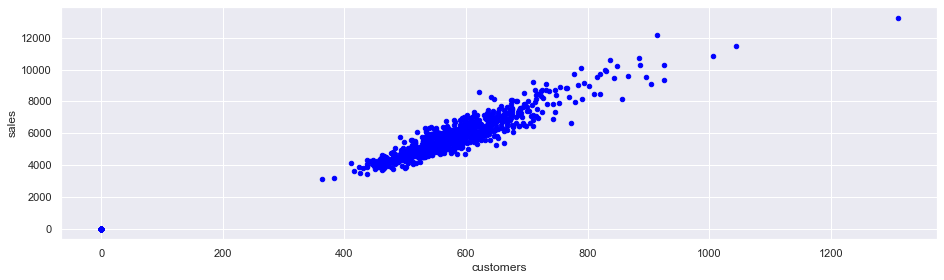

In [1075]:
#Let's draw a scatter plot between Sales and Customers
df_store31[['sales', 'customers']].plot.scatter(x = 'customers',y='sales',c='blue')
plt.show()

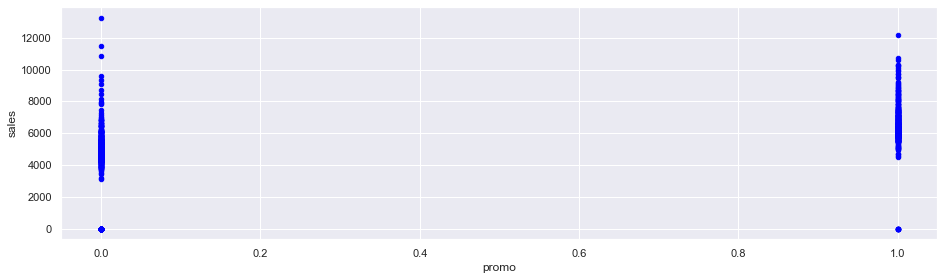

In [1076]:
#Let's now draw a scatter plot between Sales and promo
df_store31[['sales', 'promo']].plot.scatter(x = 'promo',y='sales',c='blue')
plt.show()

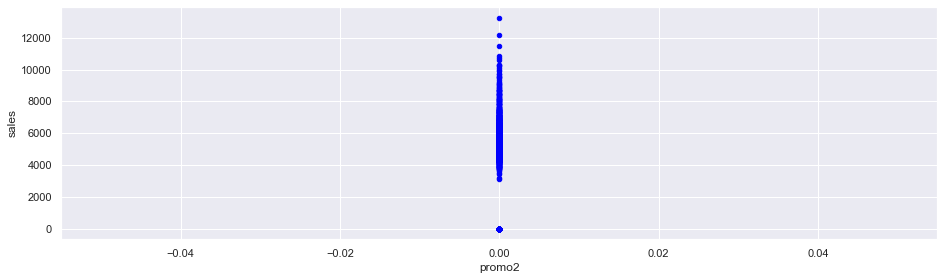

In [1077]:
#Let's now draw a scatter plot between Sales and promo
df_store31[['sales', 'promo2']].plot.scatter(x = 'promo2',y='sales',c='blue')
plt.show()

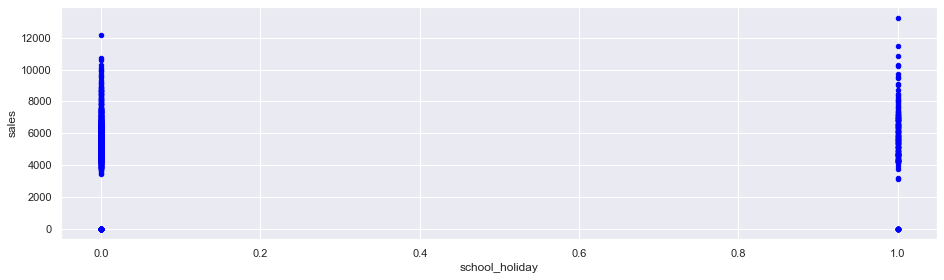

In [1078]:
#lets now draw a scatter plot between  Sales and school_holiday
df_store31[['sales', 'school_holiday']].plot.scatter(x = 'school_holiday',y='sales',c='blue')
plt.show()

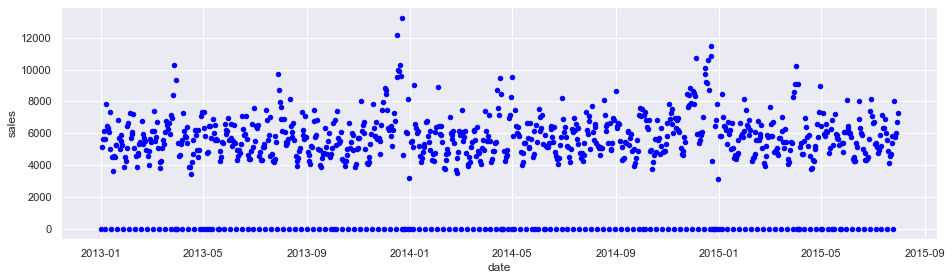

In [1079]:
#lets now draw a scatter plot between Sales and date
df_store31[['sales', 'date']].plot.scatter(x = 'date',y='sales',c='blue')
plt.show()

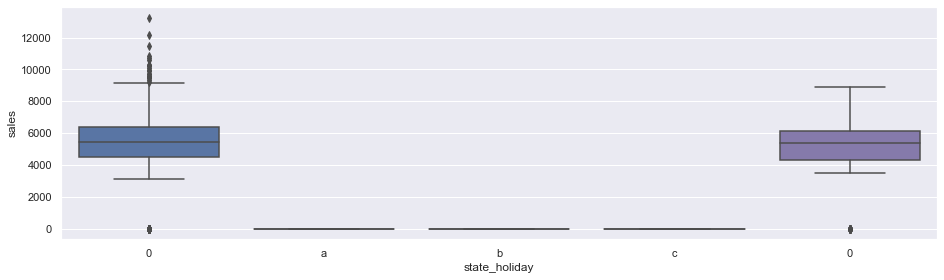

In [1080]:
#Let's draw the boxplot between sales and state_holiday
sns.set(rc={'figure.figsize':(15.7,4.27)})
# create grouped boxplot 
sns.boxplot(x = df_store31['state_holiday'],
            y = df_store31['sales'])
plt.show()

**Multivariate Analysis**

**Numerical Attributes**

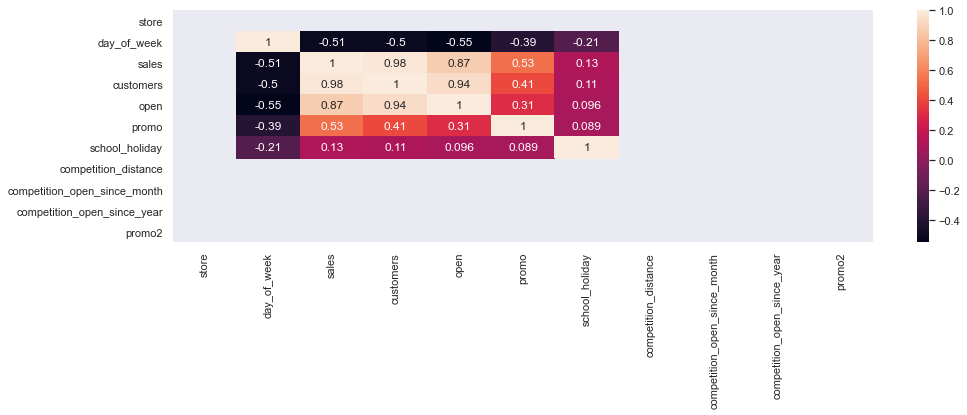

In [1081]:
correlation = (num_attributes.corr( method = 'pearson' ))
sns.heatmap( correlation, annot = True );

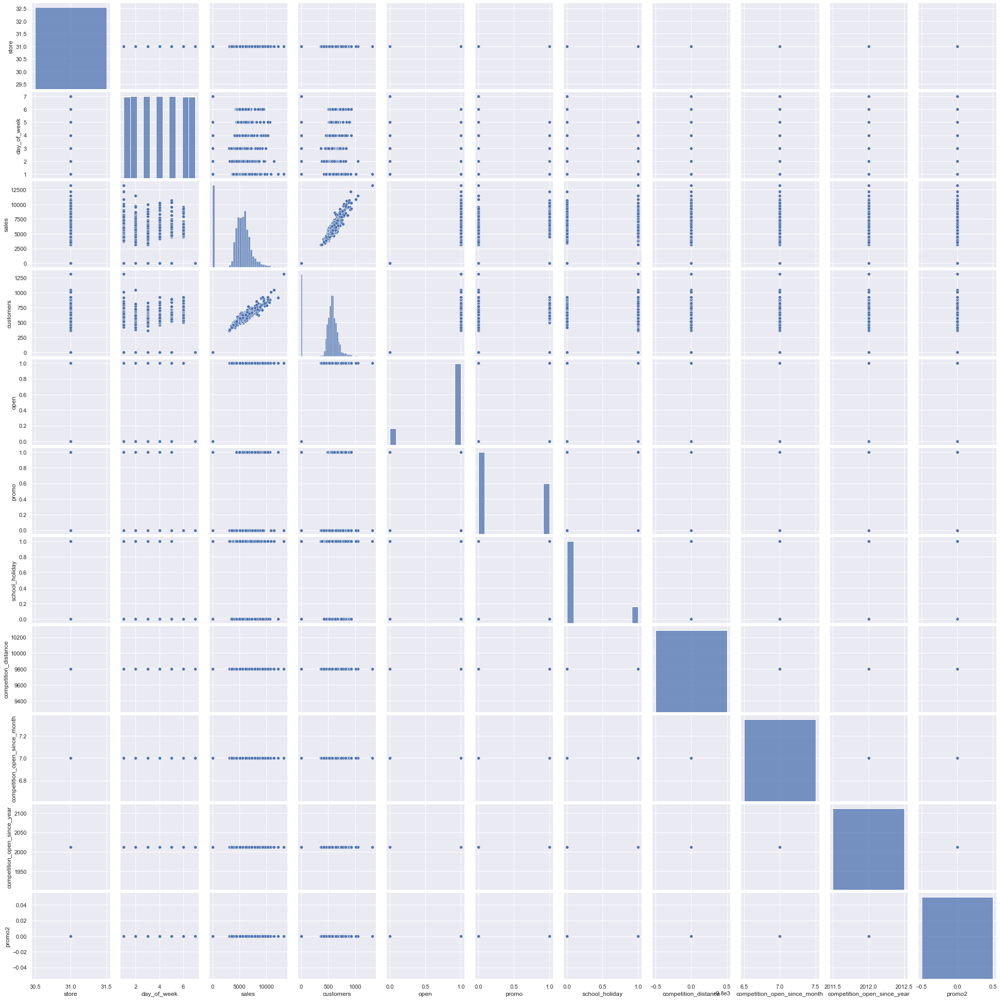

In [1082]:
#pairplot with hue sales
sns.pairplot(df_store31)
# to show
plt.show()

**Some insights from EDA**

   - store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year are uncessary columns becuase it doesn't have any effect on sales(target variable)

   - Day1 and Day2 have higher sales than other days

   - promo is correlated to sales

   - Promo2 doesn't have any effect on sales becuase it's value is equal to 1

   - There is no sale on a = public holiday, b = Easter holiday, c = Christmas

   - There is some effect of school holiday on sales

In [1083]:
df_store31.columns

Index(['store', 'day_of_week', 'date', 'sales', 'customers', 'open', 'promo',
       'state_holiday', 'school_holiday', 'store_type', 'assortment',
       'competition_distance', 'competition_open_since_month',
       'competition_open_since_year', 'promo2'],
      dtype='object')

In [1084]:
#We can drop store_type,assortment,competition_distance,competition_open_since_month,promo2_since_week,promo2_since_year,promo_interval
#competition_open_since_year & promo2
df_store31_new=df_store31.drop(['store_type', 'assortment','competition_distance','competition_open_since_month','competition_open_since_year'], axis = 1)
df_store31_new.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 942 entries, 30 to 1016125
Data columns (total 10 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   store           942 non-null    int64         
 1   day_of_week     942 non-null    int64         
 2   date            942 non-null    datetime64[ns]
 3   sales           942 non-null    int64         
 4   customers       942 non-null    int64         
 5   open            942 non-null    int64         
 6   promo           942 non-null    int64         
 7   state_holiday   942 non-null    object        
 8   school_holiday  942 non-null    int64         
 9   promo2          942 non-null    int64         
dtypes: datetime64[ns](1), int64(8), object(1)
memory usage: 121.0+ KB


In [1085]:
#We can drop store_type,assortment,competition_distance,competition_open_since_month,promo2_since_week,promo2_since_year,promo_interval
#competition_open_since_year & promo2
df_store31_new=df_store31.drop(['store_type', 'assortment','competition_distance','competition_open_since_month','competition_open_since_year'], axis = 1)
df_store31_new.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 942 entries, 30 to 1016125
Data columns (total 10 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   store           942 non-null    int64         
 1   day_of_week     942 non-null    int64         
 2   date            942 non-null    datetime64[ns]
 3   sales           942 non-null    int64         
 4   customers       942 non-null    int64         
 5   open            942 non-null    int64         
 6   promo           942 non-null    int64         
 7   state_holiday   942 non-null    object        
 8   school_holiday  942 non-null    int64         
 9   promo2          942 non-null    int64         
dtypes: datetime64[ns](1), int64(8), object(1)
memory usage: 121.0+ KB


In [1086]:
df_store31_new.columns

Index(['store', 'day_of_week', 'date', 'sales', 'customers', 'open', 'promo',
       'state_holiday', 'school_holiday', 'promo2'],
      dtype='object')

In [1087]:
df_store31_new.head()

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,promo2
30,31,5,2015-07-31,7248,645,1,1,0,1,0
1145,31,4,2015-07-30,6712,582,1,1,0,1,0
2260,31,3,2015-07-29,5982,570,1,1,0,1,0
3375,31,2,2015-07-28,5736,492,1,1,0,1,0
4490,31,1,2015-07-27,8054,684,1,1,0,1,0


In [1088]:
df_store31_new=df_store31_new[::-1].reset_index()
df_store31_new.head()

,index,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,promo2
0,1016125,31,2,2013-01-01,0,0,0,0,a,1,0
1,1015010,31,3,2013-01-02,5122,567,1,0,0,1,0
2,1013895,31,4,2013-01-03,5623,578,1,0,0,1,0
3,1012780,31,5,2013-01-04,6140,633,1,0,0,1,0
4,1011665,31,6,2013-01-05,5607,624,1,0,0,0,0


In [1089]:
df_store31_new=df_store31_new.drop(['index'], axis = 1)
df_store31_new.head()
#Let drop the index column

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,promo2
0,31,2,2013-01-01,0,0,0,0,a,1,0
1,31,3,2013-01-02,5122,567,1,0,0,1,0
2,31,4,2013-01-03,5623,578,1,0,0,1,0
3,31,5,2013-01-04,6140,633,1,0,0,1,0
4,31,6,2013-01-05,5607,624,1,0,0,0,0


In [1090]:
df_store31_new.info()
#No missing value

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 942 entries, 0 to 941
Data columns (total 10 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   store           942 non-null    int64         
 1   day_of_week     942 non-null    int64         
 2   date            942 non-null    datetime64[ns]
 3   sales           942 non-null    int64         
 4   customers       942 non-null    int64         
 5   open            942 non-null    int64         
 6   promo           942 non-null    int64         
 7   state_holiday   942 non-null    object        
 8   school_holiday  942 non-null    int64         
 9   promo2          942 non-null    int64         
dtypes: datetime64[ns](1), int64(8), object(1)
memory usage: 73.7+ KB


In [1091]:
# transform datatype of the variable data to datetime
df_store31_new['date'] = pd.to_datetime(df_store31_new['date'])

In [1092]:
indexed_df_store31_new = df_store31_new.set_index(['date'])
indexed_df_store31_new.head()
#Let set the date as index column

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2
date,,,,,,,,,
2013-01-01,31,2,0,0,0,0,a,1,0
2013-01-02,31,3,5122,567,1,0,0,1,0
2013-01-03,31,4,5623,578,1,0,0,1,0
2013-01-04,31,5,6140,633,1,0,0,1,0
2013-01-05,31,6,5607,624,1,0,0,0,0


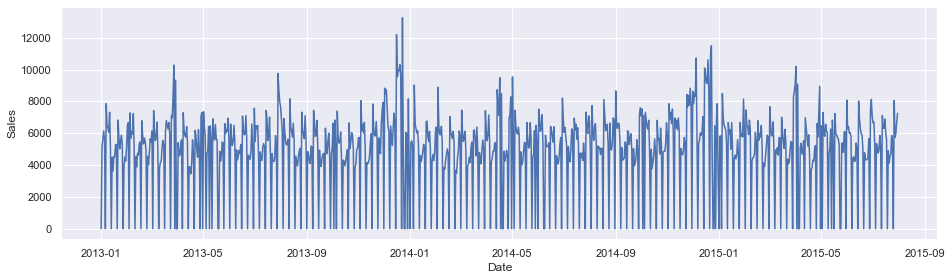

In [1093]:
## plot graph
plt.xlabel('Date')
plt.ylabel('Sales')
plt.plot(indexed_df_store31_new['sales'])
plt.show()

In [1094]:
#Let impute the zero values
(indexed_df_store31_new['sales']==0).sum()
# There are 158 zero value in sale column

158

In [1095]:
indexed_df_store31_new['sales']=indexed_df_store31_new['sales'].replace(0, np.nan)

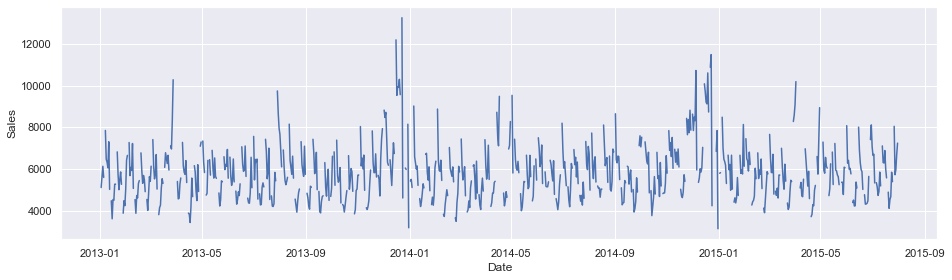

In [1096]:
##plot graph
plt.xlabel('Date')
plt.ylabel('Sales')
plt.plot(indexed_df_store31_new['sales'])
plt.show()

In [1097]:
#KNN imputer for filling NAN values
imputer = KNNImputer(n_neighbors=2)

In [1098]:
indexed_df_store31_new['sales'] = imputer.fit_transform(np.array(indexed_df_store31_new['sales']).reshape(-1, 1))
indexed_df_store31_new['sales'].head()

date
2013-01-01    5862.427296
2013-01-02    5122.000000
2013-01-03    5623.000000
2013-01-04    6140.000000
2013-01-05    5607.000000
Name: sales, dtype: float64

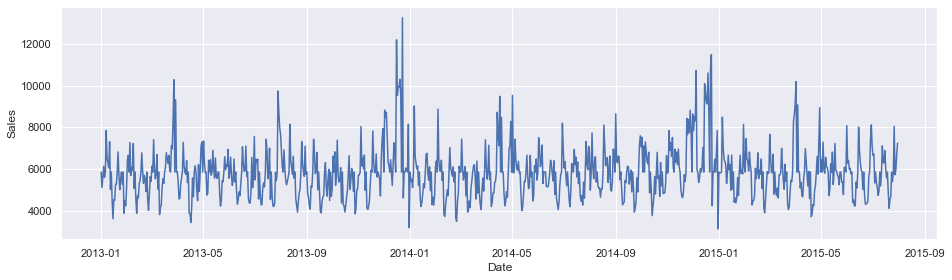

In [1099]:
## plot graph
plt.xlabel('Date')
plt.ylabel('Sales')
plt.plot(indexed_df_store31_new['sales'])
plt.show()

In [1100]:
(indexed_df_store31_new['sales']==0).sum()
# no missing value

0

**Outlier detection**

Box plot and interquartile range

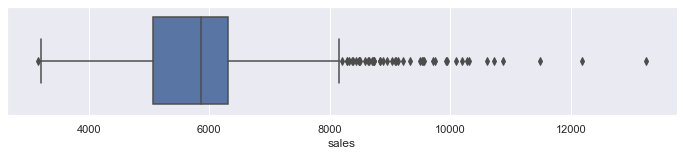

In [1101]:
import seaborn as sns
fig = plt.subplots(figsize=(12, 2))
ax = sns.boxplot(x=indexed_df_store31_new['sales'],whis=1.5)
#Let treat the outliers

**Histogram**


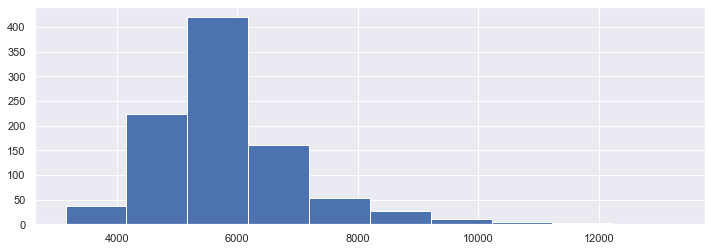

In [1102]:
fig = indexed_df_store31_new['sales'].hist(figsize = (12,4))

In [1103]:
percentile01 = indexed_df_store31_new['sales'].quantile(0.01)
percentile99 = indexed_df_store31_new['sales'].quantile(0.99)

In [1104]:
upper_limit = percentile99
lower_limit = percentile01

In [1105]:
upper_limit

10030.550000000005

In [1106]:
lower_limit

3831.15

In [1107]:
new_df = indexed_df_store31_new[indexed_df_store31_new['sales'] < upper_limit]
new_df.shape

(932, 9)

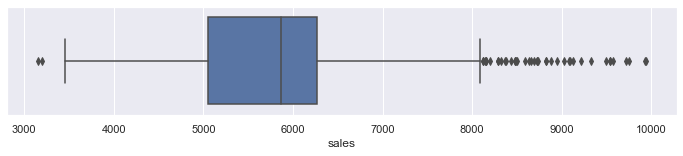

In [1108]:
import seaborn as sns
fig = plt.subplots(figsize=(12, 2))
ax = sns.boxplot(x=new_df['sales'],whis=1.5)

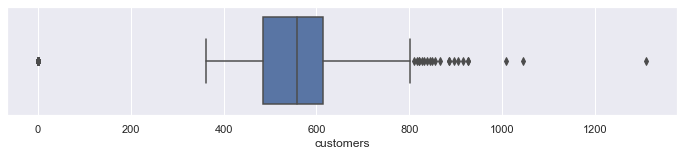

In [1109]:
import seaborn as sns
fig = plt.subplots(figsize=(12, 2))
ax = sns.boxplot(x=indexed_df_store31_new['customers'],whis=1.5)

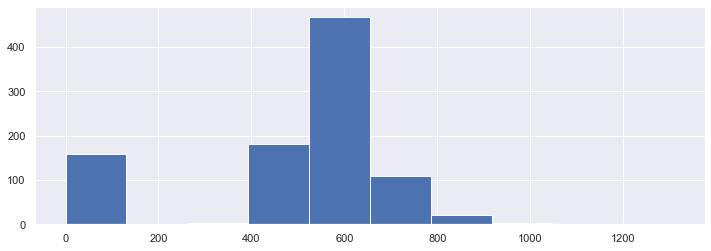

In [1110]:
fig = indexed_df_store31_new['customers'].hist(figsize = (12,4))

**ADF Stationary**

In [1111]:
def test_stationarity(timeseries):
    
    #Determine rolling statistics
    movingAverage = timeseries.rolling(window=12).mean()
    movingSTD = timeseries.rolling(window=12).std()
    
    #Plot rolling statistics
    orig = plt.plot(timeseries, color='blue', label='Original')
    mean = plt.plot(movingAverage, color='red', label='Rolling Mean')
    std = plt.plot(movingSTD, color='black', label='Rolling Std')
    plt.legend(loc='best')
    plt.title('Rolling Mean & Standard Deviation')
    plt.show(block=False)
    
    #Perform Dickey–Fuller test:
    print('Results of Dickey Fuller Test:')
    dftest = adfuller(indexed_df_store31_new['sales'], autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    for key,value in dftest[4].items():
        dfoutput['Critical Value (%s)'%key] = value
    print(dfoutput)

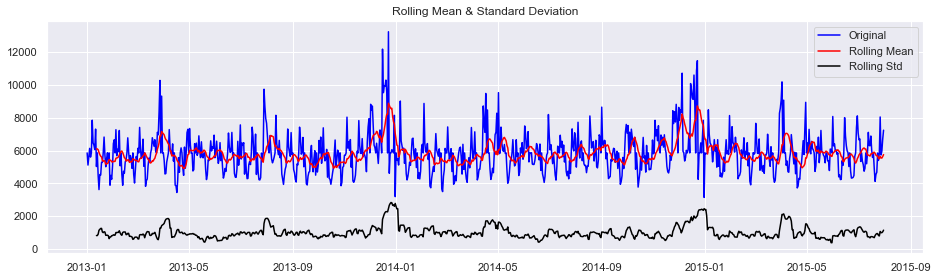

Results of Dickey Fuller Test:
Test Statistic                  -5.305838
p-value                          0.000005
#Lags Used                      17.000000
Number of Observations Used    924.000000
Critical Value (1%)             -3.437447
Critical Value (5%)             -2.864673
Critical Value (10%)            -2.568438
dtype: float64


In [1112]:
test_stationarity(indexed_df_store31_new['sales'])

- Null: Time Series is not stationary
- Alternate: Time Series is Stationary

**The p-value is less than 0.05 so The series is stationary**

In [1113]:
from statsmodels.tsa.stattools import kpss
kpss_test = kpss(indexed_df_store31_new['sales'])

print('KPSS Statistic: %f' % kpss_test[0])
print('Critical Values @ 0.05: %.2f' % kpss_test[3]['5%'])
print('p-value: %f' % kpss_test[1])

KPSS Statistic: 0.211425
Critical Values @ 0.05: 0.46
p-value: 0.100000


- Null: Time Series is not stationary
- Alternate: Time Series is Stationary
    
**The p-value is greater than 0.05 so The series is stationary**

# Let's take the log of sales to Standardize the sales values

In [1114]:
new_df=indexed_df_store31_new.copy()
new_df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 942 entries, 2013-01-01 to 2015-07-31
Data columns (total 9 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   store           942 non-null    int64  
 1   day_of_week     942 non-null    int64  
 2   sales           942 non-null    float64
 3   customers       942 non-null    int64  
 4   open            942 non-null    int64  
 5   promo           942 non-null    int64  
 6   state_holiday   942 non-null    object 
 7   school_holiday  942 non-null    int64  
 8   promo2          942 non-null    int64  
dtypes: float64(1), int64(7), object(1)
memory usage: 73.6+ KB


In [1115]:
#Log Transformation
new_df['sales_log'] = np.log(new_df['sales'])
new_df.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log
date,,,,,,,,,,
2013-01-01,31,2,5862.427296,0,0,0,a,1,0,8.676319
2013-01-02,31,3,5122.000000,567,1,0,0,1,0,8.541300
2013-01-03,31,4,5623.000000,578,1,0,0,1,0,8.634621
2013-01-04,31,5,6140.000000,633,1,0,0,1,0,8.722580
2013-01-05,31,6,5607.000000,624,1,0,0,0,0,8.631771


**Log transformation has made mean & variance constant**


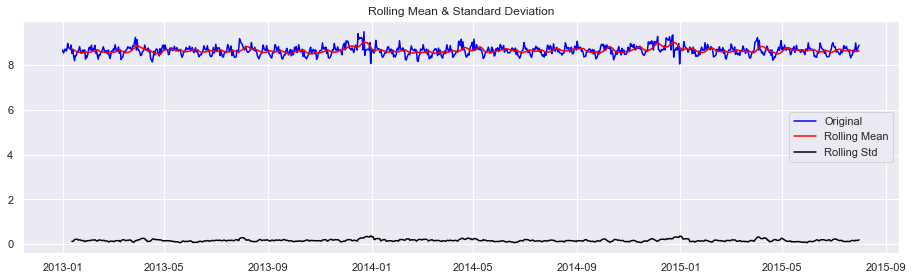

Results of Dickey Fuller Test:
Test Statistic                  -5.305838
p-value                          0.000005
#Lags Used                      17.000000
Number of Observations Used    924.000000
Critical Value (1%)             -3.437447
Critical Value (5%)             -2.864673
Critical Value (10%)            -2.568438
dtype: float64


In [1116]:
test_stationarity(new_df['sales_log'])

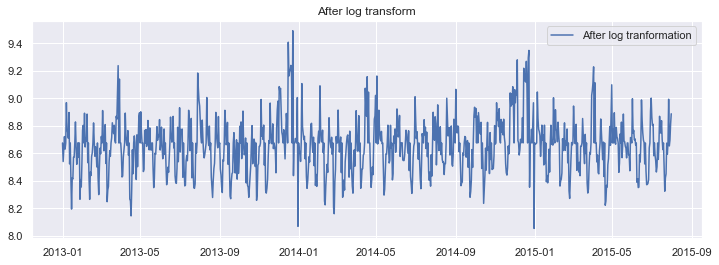

In [1117]:
#After Log Transformation
plt.figure(figsize=(12,4))
plt.plot(new_df['sales_log'], label='After log tranformation')
plt.legend(loc='best')
plt.title('After log transform')
plt.show()

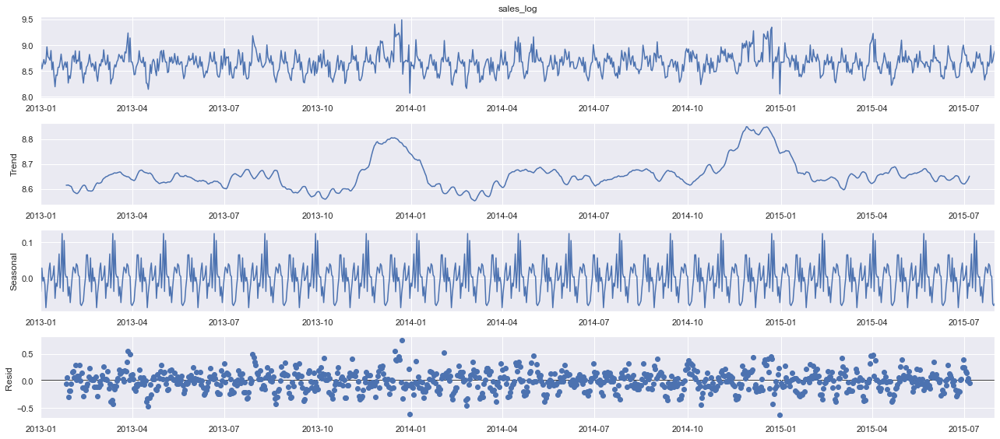

In [1118]:
from matplotlib.pyplot import rcParams
rcParams['figure.figsize'] = 18,8
decomposition = sm.tsa.seasonal_decompose(new_df['sales_log'], model = "additive",period=50)
fig = decomposition.plot()

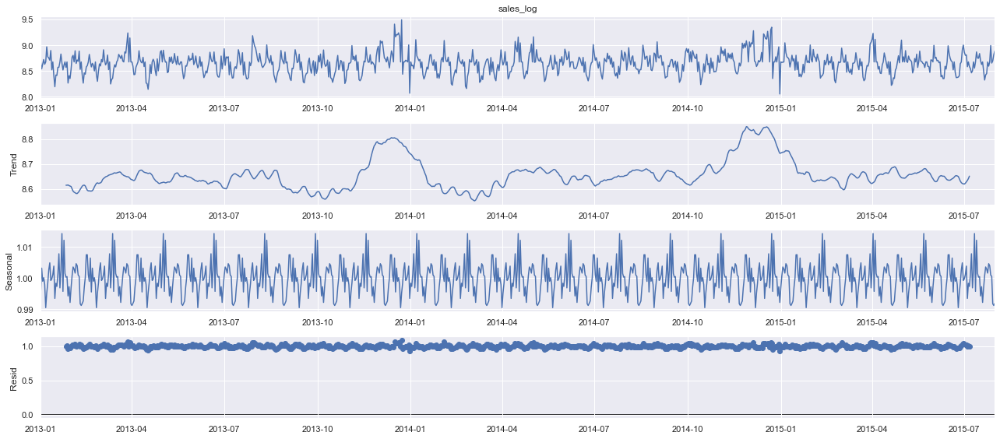

In [1119]:
from matplotlib.pyplot import rcParams
rcParams['figure.figsize'] = 18,8
decomposition = sm.tsa.seasonal_decompose(new_df['sales_log'], model = "multiplicative",period=50)
fig = decomposition.plot()

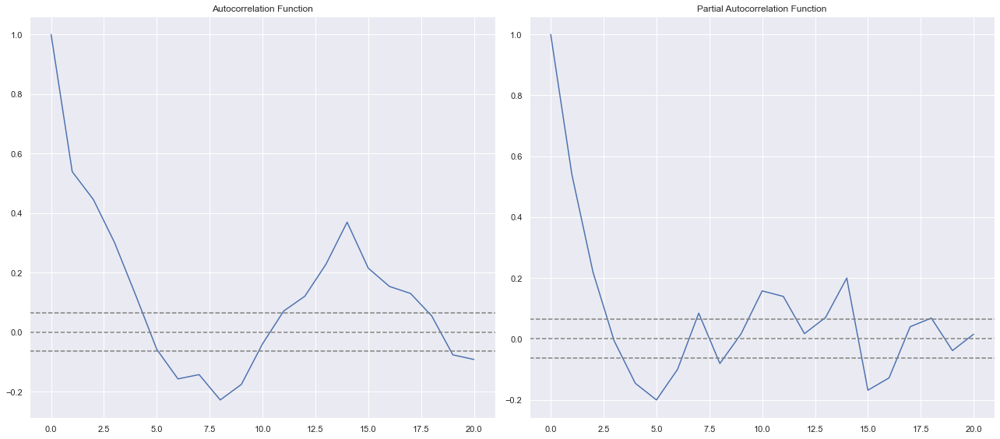

In [1120]:
#ACF & PACF plots

lag_acf = acf(new_df['sales_log'], nlags=20) # MA 
lag_pacf = pacf(new_df['sales_log'], nlags=20, method='ols')  # AR 

#Plot ACF:
plt.subplot(121)
plt.plot(lag_acf)
plt.axhline(y=0, linestyle='--', color='gray')
plt.axhline(y=-1.96/np.sqrt(len(new_df['sales_log'])), linestyle='--', color='gray')
plt.axhline(y=1.96/np.sqrt(len(new_df['sales_log'])), linestyle='--', color='gray')
plt.title('Autocorrelation Function')            

#Plot PACF
plt.subplot(122)
plt.plot(lag_pacf)
plt.axhline(y=0, linestyle='--', color='gray')
plt.axhline(y=-1.96/np.sqrt(len(new_df['sales_log'])), linestyle='--', color='gray')
plt.axhline(y=1.96/np.sqrt(len(new_df['sales_log'])), linestyle='--', color='gray')
plt.title('Partial Autocorrelation Function')
            
plt.tight_layout() 

From the ACF graph, we see that curve touches y=0.0 line at x=4. Thus, from theory, Q = 4 From the PACF graph, we see that curve touches y=0.0 line at x=3. Thus, from theory, P = 3

**Build and evaluate time series forecast**

Split time series data into training and test set

In [1121]:
train_len = 750
train = new_df['sales'][0:train_len] # first 750days as training set
test = new_df['sales'][train_len:] # last 182 days as out-of-time test set

In [1122]:
print(train.shape)
print(test.shape)

(750,)
(192,)


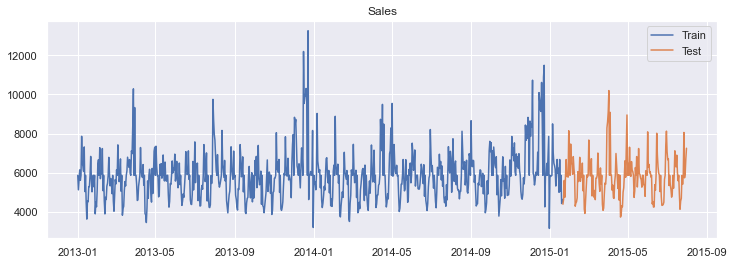

In [1123]:
plt.figure(figsize=(12,4))
plt.plot(train, label='Train')
plt.plot(test, label='Test')
plt.legend(loc='best')
plt.title('Sales')
plt.show()

In [1124]:
#ARIMA model building
model = ARIMA(new_df['sales_log'], order=(3, 0, 4))
model_fit = model.fit()
print(model_fit.params)

const              8.656665
ar.L1.sales_log    0.678037
ar.L2.sales_log    0.780713
ar.L3.sales_log   -0.842180
ma.L1.sales_log   -0.322014
ma.L2.sales_log   -0.681140
ma.L3.sales_log    0.639017
ma.L4.sales_log    0.070642
dtype: float64


In [1125]:
new_df['ar_forecast_Log'] = model_fit.predict(new_df.index.min(), new_df.index.max())
new_df['arima_forecast'] = np.exp(new_df['ar_forecast_Log'])
new_df['arima_forecast']

date
2013-01-01    5748.331141
2013-01-02    5809.086369
2013-01-03    5491.219931
2013-01-04    5560.027497
2013-01-05    5845.552293
                 ...     
2015-07-27    6222.729793
2015-07-28    7045.304065
2015-07-29    6595.419089
2015-07-30    6214.863684
2015-07-31    6143.948883
Name: arima_forecast, Length: 942, dtype: float64

In [1126]:
new_df['ar_forecast_Log'] = model_fit.predict(new_df.index.min(), new_df.index.max())
new_df['arima_forecast'] = np.exp(new_df['ar_forecast_Log'])
new_df['arima_forecast']

date
2013-01-01    5748.331141
2013-01-02    5809.086369
2013-01-03    5491.219931
2013-01-04    5560.027497
2013-01-05    5845.552293
                 ...     
2015-07-27    6222.729793
2015-07-28    7045.304065
2015-07-29    6595.419089
2015-07-30    6214.863684
2015-07-31    6143.948883
Name: arima_forecast, Length: 942, dtype: float64

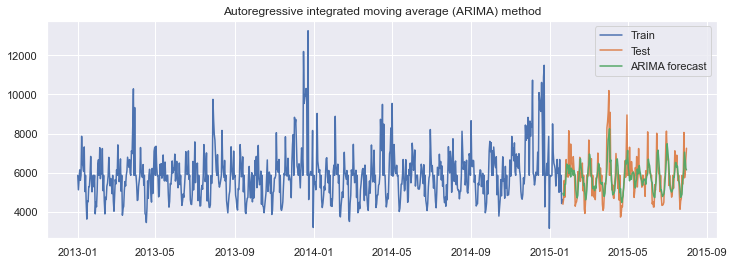

In [1127]:
plt.figure(figsize=(12,4))
plt.plot(train, label='Train')
plt.plot(test, label='Test')
plt.plot(new_df['arima_forecast'][test.index.min():], label='ARIMA forecast')
plt.legend(loc='best')
plt.title('Autoregressive integrated moving average (ARIMA) method')
plt.show()

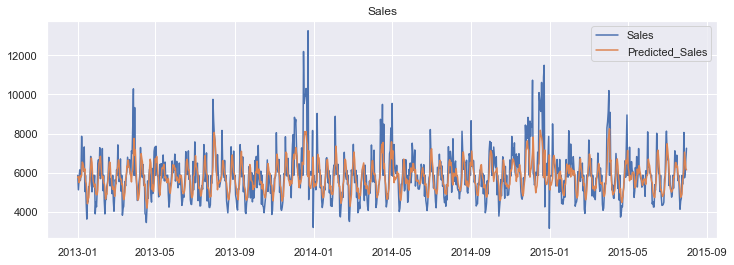

In [1128]:
# plot the arima forecasting & Original series
plt.figure(figsize=(12,4))
plt.plot(new_df['sales'], label='Sales')
plt.plot(new_df['arima_forecast'], label='Predicted_Sales')
plt.legend(loc='best')
plt.title('Sales')
plt.show()

**Model Evalution**


In [1129]:
from sklearn.metrics import mean_squared_error
rmse = np.sqrt(mean_squared_error(test, new_df['arima_forecast'][test.index.min():])).round(2)
mape = np.round(np.mean(np.abs(test-new_df['arima_forecast'][test.index.min():])/test)*100,2)
Results = pd.DataFrame({'Method':['ARIMA'], 'RMSE': [rmse],'MAPE': [mape] })
Results

,Method,RMSE,MAPE
0,ARIMA,804.7,10.32


**VAR model**


In [1130]:
#Load the dataset
new_df.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast
date,,,,,,,,,,,,
2013-01-01,31,2,5862.427296,0,0,0,a,1,0,8.676319,8.656665,5748.331141
2013-01-02,31,3,5122.000000,567,1,0,0,1,0,8.541300,8.667179,5809.086369
2013-01-03,31,4,5623.000000,578,1,0,0,1,0,8.634621,8.610906,5491.219931
2013-01-04,31,5,6140.000000,633,1,0,0,1,0,8.722580,8.623358,5560.027497
2013-01-05,31,6,5607.000000,624,1,0,0,0,0,8.631771,8.673436,5845.552293


**Split the dataset to training & testing**


In [1131]:
#split the dataset
nobs = 192
train, test = new_df[0:-nobs], new_df[-nobs:]

# Check size
print(train.shape)
print(test.shape) 

(750, 12)
(192, 12)


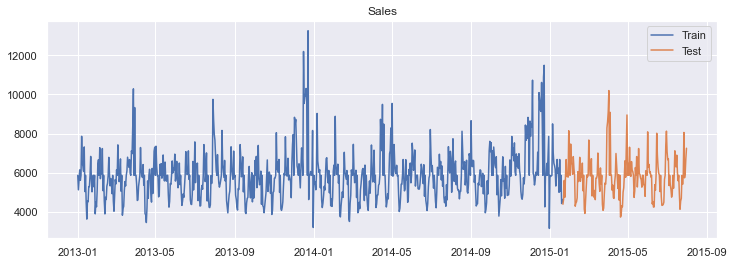

In [1132]:
plt.figure(figsize=(12,4))
plt.plot(train['sales'], label='Train')
plt.plot(test['sales'], label='Test')
plt.legend(loc='best')
plt.title('Sales')
plt.show()

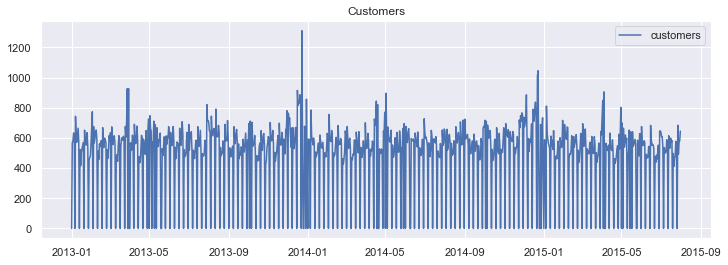

In [1133]:
#plot the arima forecasting & Original series
plt.figure(figsize=(12,4))
plt.plot(new_df['customers'],label='customers')
plt.legend(loc='best')
plt.title('Customers')
plt.show()

In [1134]:
(new_df['customers']==0).sum()

158

In [1135]:
#impute the NAN values
new_df['customers']=new_df['customers'].replace(0, np.nan)

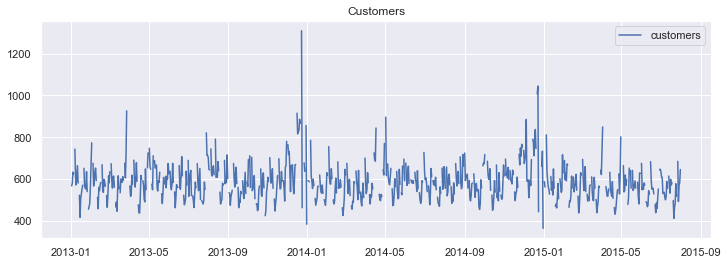

In [1136]:
#plot the arima forecasting & Original series
plt.figure(figsize=(12,4))
plt.plot(new_df['customers'],label='customers')
plt.legend(loc='best')
plt.title('Customers')
plt.show()

In [1137]:
#KNN imputer for filling NAN values
imputer = KNNImputer(n_neighbors=2)

In [1138]:
new_df['customers'] = imputer.fit_transform(np.array(new_df['customers']).reshape(-1, 1))
new_df['customers'].head()

date
2013-01-01    586.05102
2013-01-02    567.00000
2013-01-03    578.00000
2013-01-04    633.00000
2013-01-05    624.00000
Name: customers, dtype: float64

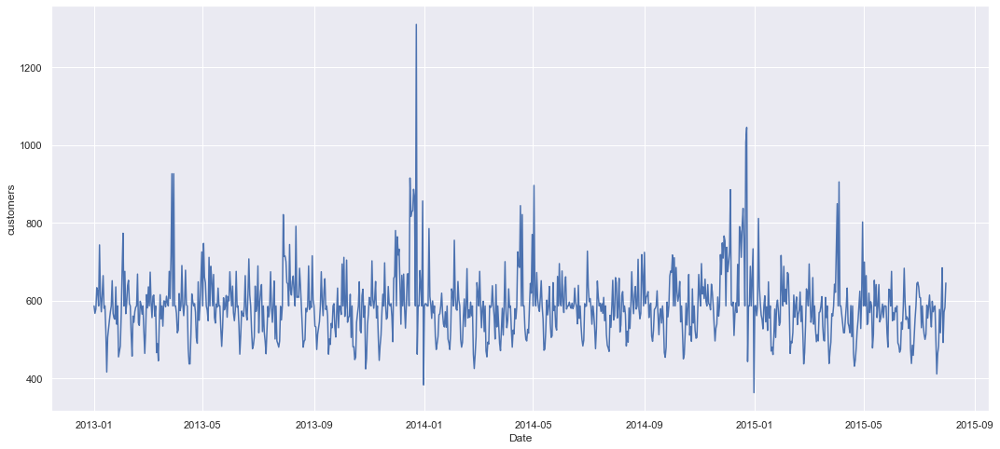

In [1139]:
## plot graph
plt.xlabel('Date')
plt.ylabel('customers')
plt.plot(new_df['customers'])
plt.show()

In [1140]:
new_df.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast
date,,,,,,,,,,,,
2013-01-01,31,2,5862.427296,586.05102,0,0,a,1,0,8.676319,8.656665,5748.331141
2013-01-02,31,3,5122.000000,567.00000,1,0,0,1,0,8.541300,8.667179,5809.086369
2013-01-03,31,4,5623.000000,578.00000,1,0,0,1,0,8.634621,8.610906,5491.219931
2013-01-04,31,5,6140.000000,633.00000,1,0,0,1,0,8.722580,8.623358,5560.027497
2013-01-05,31,6,5607.000000,624.00000,1,0,0,0,0,8.631771,8.673436,5845.552293


**ADF test**


In [1141]:
def test_stationarity(timeseries):
    
    #Determine rolling statistics
    movingAverage = timeseries.rolling(window=12).mean()
    movingSTD = timeseries.rolling(window=12).std()
    
    #Plot rolling statistics
    orig = plt.plot(timeseries, color='blue', label='Original')
    mean = plt.plot(movingAverage, color='red', label='Rolling Mean')
    std = plt.plot(movingSTD, color='black', label='Rolling Std')
    plt.legend(loc='best')
    plt.title('Rolling Mean & Standard Deviation')
    plt.show(block=False)
    
    #Perform Dickey–Fuller test:
    print('Results of Dickey Fuller Test:')
    dftest = adfuller(new_df['customers'], autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    for key,value in dftest[4].items():
        dfoutput['Critical Value (%s)'%key] = value
    print(dfoutput)

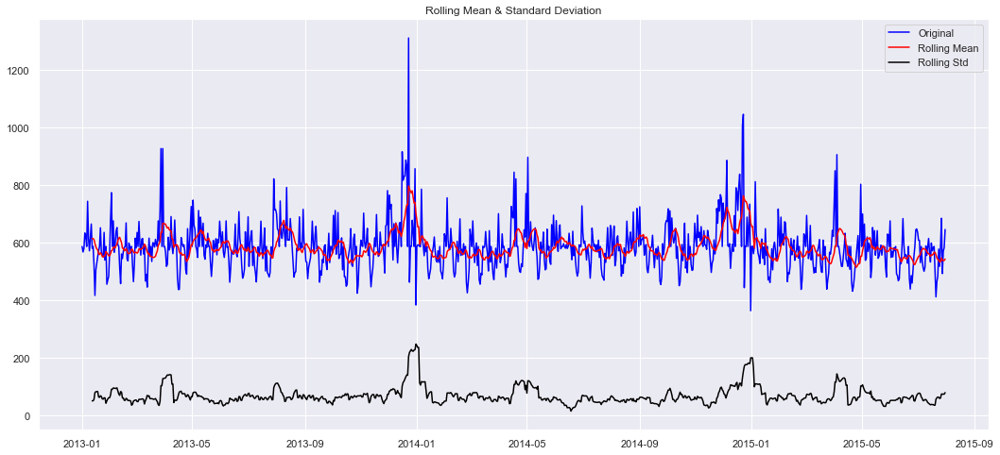

Results of Dickey Fuller Test:
Test Statistic                -6.366521e+00
p-value                        2.402381e-08
#Lags Used                     1.600000e+01
Number of Observations Used    9.250000e+02
Critical Value (1%)           -3.437439e+00
Critical Value (5%)           -2.864670e+00
Critical Value (10%)          -2.568436e+00
dtype: float64


In [1142]:
test_stationarity(new_df['customers'])

- Null: Time Series is not stationary
- Alternate: Time Series is Stationary

**The p-value is less than 0.05 so The series is stationary**

In [1143]:
from statsmodels.tsa.stattools import kpss
kpss_test = kpss(new_df['customers'])

print('KPSS Statistic: %f' % kpss_test[0])
print('Critical Values @ 0.05: %.2f' % kpss_test[3]['5%'])
print('p-value: %f' % kpss_test[1])

KPSS Statistic: 0.097017
Critical Values @ 0.05: 0.46
p-value: 0.100000


- Null: Time Series is not stationary
- Alternate: Time Series is Stationary

**The p-value is less than 0.05 so The series is non-stationary**

**Log transformation has made mean & variance constant**

In [1144]:
#Log Transformation
new_df['customers_log'] = np.log(new_df['customers'])
new_df.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast,customers_log
date,,,,,,,,,,,,,
2013-01-01,31,2,5862.427296,586.05102,0,0,a,1,0,8.676319,8.656665,5748.331141,6.373407
2013-01-02,31,3,5122.000000,567.00000,1,0,0,1,0,8.541300,8.667179,5809.086369,6.340359
2013-01-03,31,4,5623.000000,578.00000,1,0,0,1,0,8.634621,8.610906,5491.219931,6.359574
2013-01-04,31,5,6140.000000,633.00000,1,0,0,1,0,8.722580,8.623358,5560.027497,6.450470
2013-01-05,31,6,5607.000000,624.00000,1,0,0,0,0,8.631771,8.673436,5845.552293,6.436150


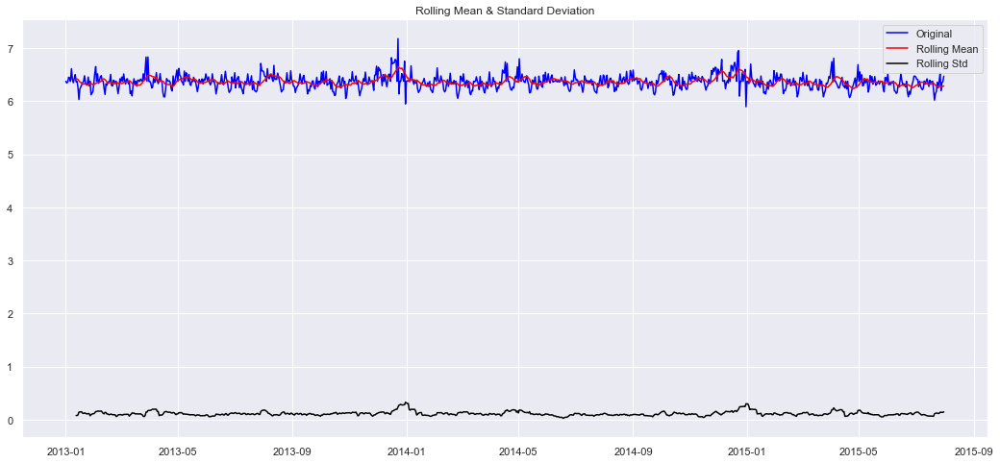

Results of Dickey Fuller Test:
Test Statistic                -6.366521e+00
p-value                        2.402381e-08
#Lags Used                     1.600000e+01
Number of Observations Used    9.250000e+02
Critical Value (1%)           -3.437439e+00
Critical Value (5%)           -2.864670e+00
Critical Value (10%)          -2.568436e+00
dtype: float64


In [1145]:
test_stationarity(new_df['customers_log'])

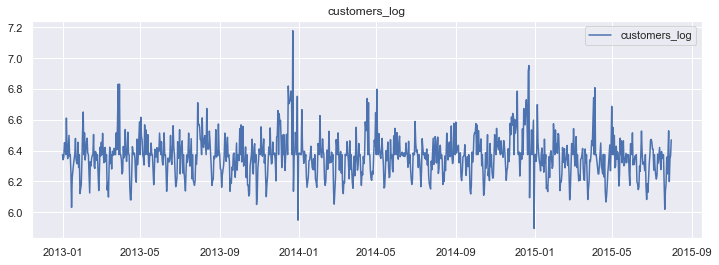

In [1146]:
#plot the arima Log series
plt.figure(figsize=(12,4))
plt.plot(new_df['customers_log'],label='customers_log')
plt.legend(loc='best')
plt.title('customers_log')
plt.show()

In [1147]:
#Let's check the info
new_df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 942 entries, 2013-01-01 to 2015-07-31
Data columns (total 13 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   store            942 non-null    int64  
 1   day_of_week      942 non-null    int64  
 2   sales            942 non-null    float64
 3   customers        942 non-null    float64
 4   open             942 non-null    int64  
 5   promo            942 non-null    int64  
 6   state_holiday    942 non-null    object 
 7   school_holiday   942 non-null    int64  
 8   promo2           942 non-null    int64  
 9   sales_log        942 non-null    float64
 10  ar_forecast_Log  942 non-null    float64
 11  arima_forecast   942 non-null    float64
 12  customers_log    942 non-null    float64
dtypes: float64(6), int64(6), object(1)
memory usage: 143.0+ KB


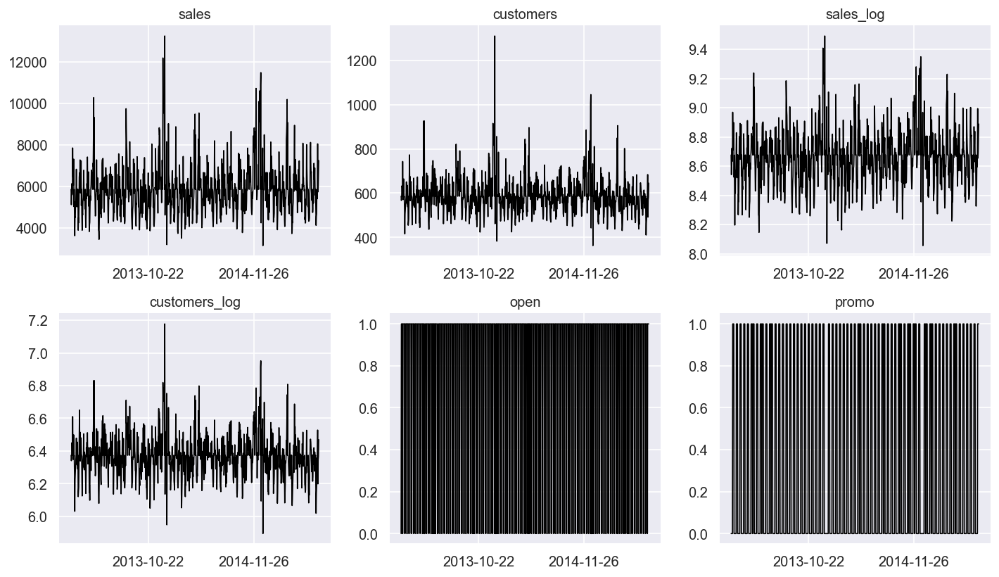

In [1148]:
# Plot
ls=['sales','customers','sales_log','customers_log','open','promo','state_holiday','promo2','school_holiday']
df=new_df[ls]
fig, axes = plt.subplots(nrows=2, ncols=3, dpi=120, figsize=(12,7))
for i, ax in enumerate(axes.flatten()):
        ax.plot(df[df.columns[i]], color='black', linewidth=1)
        ax.xaxis.set_major_locator(plt.MaxNLocator(3))
        # Decorations
        ax.set_title(df.columns[i])
        ax.xaxis.set_ticks_position('none')
        ax.yaxis.set_ticks_position('none')
        ax.spines["top"].set_alpha(0)
        ax.tick_params(labelsize=12)

plt.tight_layout();

In [1149]:
new_df.columns

Index(['store', 'day_of_week', 'sales', 'customers', 'open', 'promo',
       'state_holiday', 'school_holiday', 'promo2', 'sales_log',
       'ar_forecast_Log', 'arima_forecast', 'customers_log'],
      dtype='object')

In [1150]:
new_df1=new_df[['sales_log', 'customers_log']]
new_df1

,sales_log,customers_log
date,,
2013-01-01,8.676319,6.373407
2013-01-02,8.541300,6.340359
2013-01-03,8.634621,6.359574
2013-01-04,8.722580,6.450470
2013-01-05,8.631771,6.436150
...,...,...
2015-07-27,8.993924,6.527958
2015-07-28,8.654517,6.198479
2015-07-29,8.696510,6.345636


In [1151]:
#Let's create a model
model = VAR(new_df1)
for i in [1,2,3,4,5]:
    result = model.fit(i)
    print('Lag Order =', i)
    print('AIC : ', result.aic)
    print('BIC : ', result.bic)
    print('FPE : ', result.fpe)
    print('HQIC: ', result.hqic, '\n')

Lag Order = 1
AIC :  -9.704219594160252
BIC :  -9.673314536947167
FPE :  6.102545102097867e-05
HQIC:  -9.692438906011342 

Lag Order = 2
AIC :  -9.754021196129575
BIC :  -9.702469282562936
FPE :  5.80607317872574e-05
HQIC:  -9.734369132443405 

Lag Order = 3
AIC :  -9.776204745400246
BIC :  -9.703971074783723
FPE :  5.678693973016495e-05
HQIC:  -9.748667192644081 

Lag Order = 4
AIC :  -9.791573310026125
BIC :  -9.69862288456545
FPE :  5.592091306027979e-05
HQIC:  -9.756136114392476 

Lag Order = 5
AIC :  -9.87384667261164
BIC :  -9.760144397041474
FPE :  5.150433829032107e-05
HQIC:  -9.830495639861331 



In [1152]:
x = model.select_order(maxlags=5)
x.summary()

,AIC,BIC,FPE,HQIC
0,-9.187,-9.177,0.0001023,-9.183
1,-9.702,-9.671,6.118e-05,-9.690
2,-9.751,-9.700,5.822e-05,-9.732
3,-9.776,-9.704,5.679e-05,-9.749
4,-9.793,-9.700,5.585e-05,-9.757
5,-9.874*,-9.760*,5.150e-05*,-9.830*


In [1153]:
#Let's fit the model
model_fitted = model.fit()
model_fitted.summary()

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Mon, 17, Jan, 2022
Time:                     16:37:01
--------------------------------------------------------------------
No. of Equations:         2.00000    BIC:                   -9.67331
Nobs:                     941.000    HQIC:                  -9.69244
Log likelihood:           1901.39    FPE:                6.10255e-05
AIC:                     -9.70422    Det(Omega_mle):     6.06382e-05
--------------------------------------------------------------------
Results for equation sales_log
                      coefficient       std. error           t-stat            prob
-----------------------------------------------------------------------------------
const                    4.453885         0.256031           17.396           0.000
L1.sales_log             0.840915         0.069655           12.073           0.000
L1.customers_log        -0.483410         0.

In [1154]:
# Get the lag order
lag_order = model_fitted.k_ar
print(lag_order)  #> 4

1


In [1155]:
# Input data for forecasting
forecast_input = new_df1.values[-lag_order:]
forecast_input

array([[8.88848085, 6.46925032]])

In [1156]:
# Forecast
fc = model_fitted.forecast(y=forecast_input, steps=192)
df_forecast = pd.DataFrame(fc, index=new_df.index[-192:], columns=new_df1.columns + '_2d')
df_forecast

,sales_log_2d,customers_log_2d
date,,
2015-01-21,8.801039,6.433293
2015-01-22,8.744891,6.407426
2015-01-23,8.710179,6.390735
2015-01-24,8.689058,6.380396
2015-01-25,8.676295,6.374099
...,...,...
2015-07-27,8.657009,6.364541
2015-07-28,8.657009,6.364541
2015-07-29,8.657009,6.364541


In [1157]:
df_forecast['VAR_forecast_Sales'] = np.exp(df_forecast['sales_log_2d'])
df_forecast['VAR_forecast_customers'] = np.exp(df_forecast['customers_log_2d'])
df_forecast

,sales_log_2d,customers_log_2d,VAR_forecast_Sales,VAR_forecast_customers
date,,,,
2015-01-21,8.801039,6.433293,6641.143546,622.219636
2015-01-22,8.744891,6.407426,6278.527332,606.331051
2015-01-23,8.710179,6.390735,6064.326772,596.294696
2015-01-24,8.689058,6.380396,5937.584632,590.161291
2015-01-25,8.676295,6.374099,5862.284677,586.457083
...,...,...,...,...
2015-07-27,8.657009,6.364541,5750.310480,580.877949
2015-07-28,8.657009,6.364541,5750.310480,580.877949
2015-07-29,8.657009,6.364541,5750.310480,580.877949


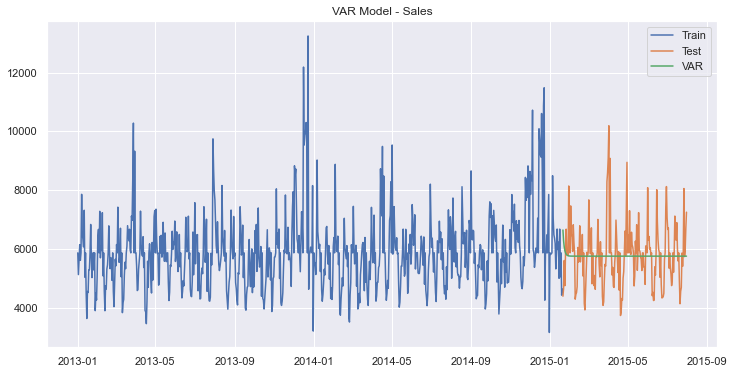

In [1158]:
plt.figure(figsize=(12,6)) 
plt.plot(train['sales'], label='Train')
plt.plot(test['sales'], label='Test')
plt.plot(df_forecast['VAR_forecast_Sales'], label='VAR')
plt.legend(loc='best')
plt.title('VAR Model - Sales')
plt.show()

In [1159]:
train_len = 750
train1 = new_df[0:train_len] # first 890days as training set
test1 = new_df[train_len:] # last 42 days as out-of-time test set

In [1160]:
train1.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast,customers_log
date,,,,,,,,,,,,,
2013-01-01,31,2,5862.427296,586.05102,0,0,a,1,0,8.676319,8.656665,5748.331141,6.373407
2013-01-02,31,3,5122.000000,567.00000,1,0,0,1,0,8.541300,8.667179,5809.086369,6.340359
2013-01-03,31,4,5623.000000,578.00000,1,0,0,1,0,8.634621,8.610906,5491.219931,6.359574
2013-01-04,31,5,6140.000000,633.00000,1,0,0,1,0,8.722580,8.623358,5560.027497,6.450470
2013-01-05,31,6,5607.000000,624.00000,1,0,0,0,0,8.631771,8.673436,5845.552293,6.436150


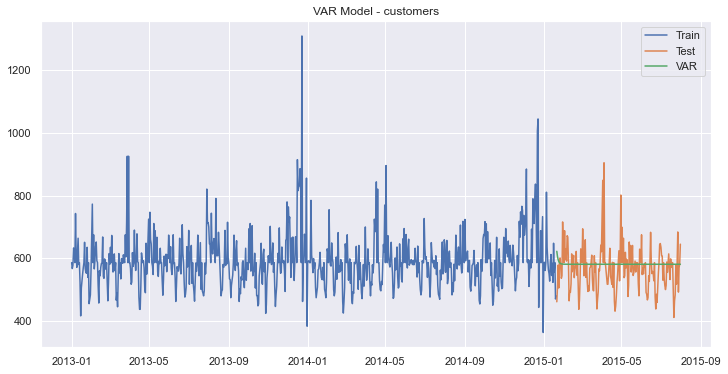

In [1161]:
plt.figure(figsize=(12,6)) 
plt.plot(train1['customers'], label='Train')
plt.plot(test1['customers'], label='Test')
plt.plot(df_forecast['VAR_forecast_customers'], label='VAR')
plt.legend(loc='best')
plt.title('VAR Model - customers')
plt.show()

**Model Evalution**


In [1162]:
# Let's calculate the rmse and MAPE
rmse = np.sqrt(mean_squared_error(test1['sales'], df_forecast['VAR_forecast_Sales'])).round(2)
mape = np.round(np.mean(np.abs(test1['sales']-df_forecast['VAR_forecast_Sales'])/test1['sales'])*100,2)
tempResults = pd.DataFrame({'Method':['VAR'], 'RMSE': [rmse],'MAPE': [mape] })

In [1163]:
tempResults

,Method,RMSE,MAPE
0,VAR,1075.4,13.44


In [1164]:
results = pd.concat([Results , tempResults])
results = results[['Method', 'RMSE', 'MAPE']]
results

,Method,RMSE,MAPE
0,ARIMA,804.7,10.32
0,VAR,1075.4,13.44


**Johansen-Impulse**


In [1165]:
joh_model1 = coint_johansen(new_df[['sales','customers']],-1,1)

In [1166]:
joh_model1

In [1167]:
joh_model1.lr1

array([132.08936448,   1.78363634])

In [1168]:
joh_model1.lr2

array([130.30572814,   1.78363634])

In [1169]:
new_df[['sales','customers']].shape

(942, 2)

In [1170]:
def joh_output(res):
    output = pd.DataFrame([res.lr2,res.lr1],
                          index=['max_eig_stat',"trace_stat"])
    print(output.T,'\n')
    print("Critical values(90%, 95%, 99%) of max_eig_stat\n",res.cvm,'\n')
    print("Critical values(90%, 95%, 99%) of trace_stat\n",res.cvt,'\n')

In [1171]:
joh_output(joh_model1)

   max_eig_stat  trace_stat
0    130.305728  132.089364
1      1.783636    1.783636 

Critical values(90%, 95%, 99%) of max_eig_stat
 [[ 9.4748 11.2246 15.0923]
 [ 2.9762  4.1296  6.9406]] 

Critical values(90%, 95%, 99%) of trace_stat
 [[10.4741 12.3212 16.364 ]
 [ 2.9762  4.1296  6.9406]] 



In [1172]:
from statsmodels.tsa.vector_ar.vecm import select_coint_rank

In [1173]:
rank=select_coint_rank(new_df[['sales','customers']],-1,1)
print(rank.rank)

1


**Rank is one**

In [1174]:
from statsmodels.tsa.stattools import coint

In [1175]:
coint(new_df['sales'],new_df['customers'])#null hypothesis-There is not coint

(-3.285066238599613,
 0.0568160505695867,
 array([-3.90811644, -3.3426309 , -3.04896019]))

0.0568160505695867>.05

We can't reject the null hypothesis

**Sales and customers aren't cointegration to each other**

**VARMAX MODEL**


In [1176]:
#create dymmy variables
new_df=pd.get_dummies(new_df)
new_df.head()

,store,day_of_week,sales,customers,open,promo,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast,customers_log,state_holiday_0,state_holiday_0,state_holiday_a,state_holiday_b,state_holiday_c
date,,,,,,,,,,,,,,,,,
2013-01-01,31,2,5862.427296,586.05102,0,0,1,0,8.676319,8.656665,5748.331141,6.373407,0,0,1,0,0
2013-01-02,31,3,5122.000000,567.00000,1,0,1,0,8.541300,8.667179,5809.086369,6.340359,0,1,0,0,0
2013-01-03,31,4,5623.000000,578.00000,1,0,1,0,8.634621,8.610906,5491.219931,6.359574,0,1,0,0,0
2013-01-04,31,5,6140.000000,633.00000,1,0,1,0,8.722580,8.623358,5560.027497,6.450470,0,1,0,0,0
2013-01-05,31,6,5607.000000,624.00000,1,0,0,0,8.631771,8.673436,5845.552293,6.436150,0,1,0,0,0


In [1177]:
new_df.head()

,store,day_of_week,sales,customers,open,promo,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast,customers_log,state_holiday_0,state_holiday_0,state_holiday_a,state_holiday_b,state_holiday_c
date,,,,,,,,,,,,,,,,,
2013-01-01,31,2,5862.427296,586.05102,0,0,1,0,8.676319,8.656665,5748.331141,6.373407,0,0,1,0,0
2013-01-02,31,3,5122.000000,567.00000,1,0,1,0,8.541300,8.667179,5809.086369,6.340359,0,1,0,0,0
2013-01-03,31,4,5623.000000,578.00000,1,0,1,0,8.634621,8.610906,5491.219931,6.359574,0,1,0,0,0
2013-01-04,31,5,6140.000000,633.00000,1,0,1,0,8.722580,8.623358,5560.027497,6.450470,0,1,0,0,0
2013-01-05,31,6,5607.000000,624.00000,1,0,0,0,8.631771,8.673436,5845.552293,6.436150,0,1,0,0,0


In [1178]:
# VARMAX model
exog = new_df[['open','promo','school_holiday','promo2','state_holiday_0','state_holiday_a','state_holiday_b','state_holiday_c']]
mod = sm.tsa.VARMAX(new_df[['sales_log', 'customers_log']], order=(1,1), trend='n', exog=exog)
res = mod.fit(maxiter=1000, disp=False)
print(res.summary())

                                 Statespace Model Results                                 
Dep. Variable:     ['sales_log', 'customers_log']   No. Observations:                  942
Model:                                VARMAX(1,1)   Log Likelihood                2122.801
Date:                            Mon, 17 Jan 2022   AIC                          -4187.602
Time:                                    16:39:02   BIC                          -4047.010
Sample:                                01-01-2013   HQIC                         -4134.013
                                     - 07-31-2015                                         
Covariance Type:                              opg                                         
Ljung-Box (L1) (Q):             1.56, 2.28   Jarque-Bera (JB):        589.56, 21.46
Prob(Q):                        0.21, 0.13   Prob(JB):                   0.00, 0.00
Heteroskedasticity (H):         1.40, 0.95   Skew:                       0.60, 0.07
Prob(H) (two-sided):

In [1179]:
train_len = 750
train = new_df[0:train_len] # first 7500days as training set
test = new_df[train_len:] 

start_index = test.index.min()
end_index = test.index.max()

In [1180]:
print(start_index)
print(end_index)

2015-01-21 00:00:00
2015-07-31 00:00:00


In [1181]:
test.head()

,store,day_of_week,sales,customers,open,promo,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast,customers_log,state_holiday_0,state_holiday_0,state_holiday_a,state_holiday_b,state_holiday_c
date,,,,,,,,,,,,,,,,,
2015-01-21,31,3,4386.000000,461.00000,1,0,0,0,8.386173,8.506002,4944.356012,6.133398,0,1,0,0,0
2015-01-22,31,4,4639.000000,506.00000,1,0,0,0,8.442254,8.483736,4835.482612,6.226537,0,1,0,0,0
2015-01-23,31,5,5602.000000,578.00000,1,0,0,0,8.630879,8.484281,4838.118975,6.359574,0,1,0,0,0
2015-01-24,31,6,4744.000000,505.00000,1,0,0,0,8.464636,8.595787,5408.825356,6.224558,0,1,0,0,0
2015-01-25,31,7,5862.427296,586.05102,0,0,0,0,8.676319,8.594309,5400.837686,6.373407,0,1,0,0,0


In [1182]:
#prediction 
predictions = mod.fit().predict(start=start_index, end=end_index, exog=test[['open','promo','school_holiday','promo2','state_holiday_0','state_holiday_a','state_holiday_b','state_holiday_c']])

In [1183]:
predictions

,sales_log,customers_log
2015-01-21,8.484211,6.264615
2015-01-22,8.467398,6.254476
2015-01-23,8.485753,6.280059
2015-01-24,8.548005,6.316377
2015-01-25,8.624092,6.329605
...,...,...
2015-07-27,8.779164,6.419834
2015-07-28,8.889691,6.466020
2015-07-29,8.785909,6.382367
2015-07-30,8.797164,6.420604


In [1184]:
#inverse of log
predictions['VARMAX_forecast_Sales'] = np.exp(predictions['sales_log'])
predictions['VARMAX_forecast_customers'] = np.exp(predictions['customers_log'])
predictions

,sales_log,customers_log,VARMAX_forecast_Sales,VARMAX_forecast_customers
2015-01-21,8.484211,6.264615,4837.779928,525.639301
2015-01-22,8.467398,6.254476,4757.121269,520.336544
2015-01-23,8.485753,6.280059,4845.245718,533.819959
2015-01-24,8.548005,6.316377,5156.456537,553.563670
2015-01-25,8.624092,6.329605,5564.106731,560.935168
...,...,...,...,...
2015-07-27,8.779164,6.419834,6497.445695,613.900914
2015-07-28,8.889691,6.466020,7256.772893,642.919788
2015-07-29,8.785909,6.382367,6541.414389,591.325604
2015-07-30,8.797164,6.420604,6615.459236,614.374319


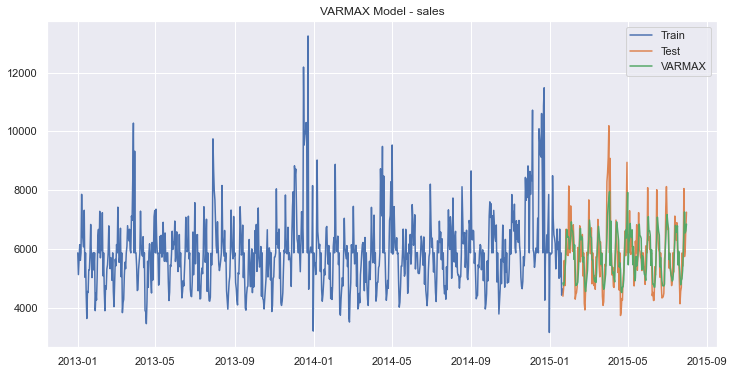

In [1185]:
plt.figure(figsize=(12,6)) 
plt.plot(train['sales'], label='Train')
plt.plot(test['sales'], label='Test')
plt.plot(predictions['VARMAX_forecast_Sales'], label='VARMAX')
plt.legend(loc='best')
plt.title('VARMAX Model - sales')
plt.show()

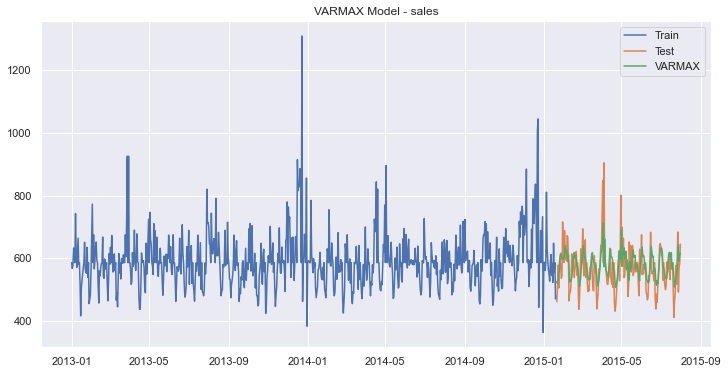

In [1186]:
plt.figure(figsize=(12,6)) 
plt.plot(train['customers'], label='Train')
plt.plot(test['customers'], label='Test')
plt.plot(predictions['VARMAX_forecast_customers'], label='VARMAX')
plt.legend(loc='best')
plt.title('VARMAX Model - sales')
plt.show()

**Model Evalution**

In [1187]:
# Let's calculate the rmse and MAPE
rmse = np.sqrt(mean_squared_error(test['sales'], predictions['VARMAX_forecast_Sales'])).round(2)
mape = np.round(np.mean(np.abs(test['sales']-predictions['VARMAX_forecast_Sales'])/test['sales'])*100,2)
tempResults = pd.DataFrame({'Method':['VARMAX'], 'RMSE': [rmse],'MAPE': [mape] })

In [1188]:
results = pd.concat([results  , tempResults])
results = results[['Method', 'RMSE', 'MAPE']]
results

,Method,RMSE,MAPE
0,ARIMA,804.70,10.32
0,VAR,1075.40,13.44
0,VARMAX,781.54,9.74


**VARMAX is the best model**

# Model-Store-46

In [1189]:
df_new[df_new['store']==46].head()

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year,promo2,promo2_since_week,promo2_since_year,promo_interval
45,46,5,2015-07-31,7628,775,1,1,0,0,c,a,1200.0,9.0,2005.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
1160,46,4,2015-07-30,7057,760,1,1,0,0,c,a,1200.0,9.0,2005.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
2275,46,3,2015-07-29,6955,716,1,1,0,0,c,a,1200.0,9.0,2005.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
3390,46,2,2015-07-28,6385,714,1,1,0,0,c,a,1200.0,9.0,2005.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
4505,46,1,2015-07-27,10068,896,1,1,0,0,c,a,1200.0,9.0,2005.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"


In [1190]:
#Store_46
df_new_store46=df_new[df_new['store']==46]

In [1191]:
df_new_store46.head()

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year,promo2,promo2_since_week,promo2_since_year,promo_interval
45,46,5,2015-07-31,7628,775,1,1,0,0,c,a,1200.0,9.0,2005.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
1160,46,4,2015-07-30,7057,760,1,1,0,0,c,a,1200.0,9.0,2005.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
2275,46,3,2015-07-29,6955,716,1,1,0,0,c,a,1200.0,9.0,2005.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
3390,46,2,2015-07-28,6385,714,1,1,0,0,c,a,1200.0,9.0,2005.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
4505,46,1,2015-07-27,10068,896,1,1,0,0,c,a,1200.0,9.0,2005.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"


In [1192]:
#transform datatype of the variable data to datetime
df_new_store46['date'] = pd.to_datetime(df_new_store46['date'])

In [1193]:
df_new_store46.info()
#Let's check the info

<class 'pandas.core.frame.DataFrame'>
Int64Index: 758 entries, 45 to 1016140
Data columns (total 18 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   store                         758 non-null    int64         
 1   day_of_week                   758 non-null    int64         
 2   date                          758 non-null    datetime64[ns]
 3   sales                         758 non-null    int64         
 4   customers                     758 non-null    int64         
 5   open                          758 non-null    int64         
 6   promo                         758 non-null    int64         
 7   state_holiday                 758 non-null    object        
 8   school_holiday                758 non-null    int64         
 9   store_type                    758 non-null    object        
 10  assortment                    758 non-null    object        
 11  competition_distance       

In [1194]:
# Check NAN values
missing_count = df_new_store46.isnull().sum() # the count of missing values
value_count = df_new_store46.isnull().count() # the count of all values

missing_percentage = round(missing_count/value_count *100, 2) # the percentage of missing values
missing_df = pd.DataFrame({'missing values count': missing_count, 'percentage': missing_percentage})
missing_df

,missing values count,percentage
store,0,0.0
day_of_week,0,0.0
date,0,0.0
sales,0,0.0
customers,0,0.0
open,0,0.0
promo,0,0.0
state_holiday,0,0.0
school_holiday,0,0.0
store_type,0,0.0


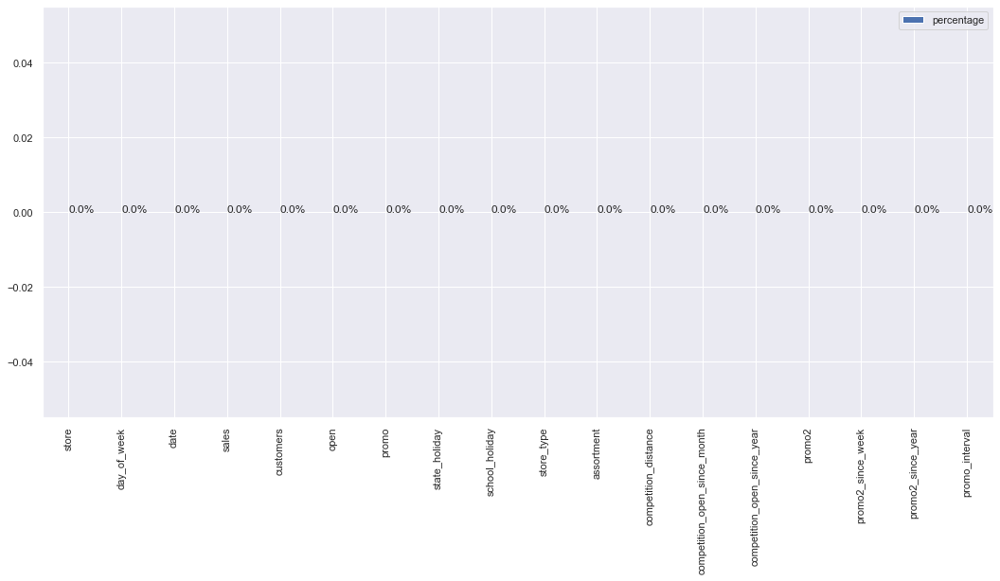

In [1195]:
barchart = missing_df.plot.bar(y='percentage')
for index, percentage in enumerate( missing_percentage ):
    barchart.text( index, percentage, str(percentage)+'%')

In [1196]:
df_new_store46.head()

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year,promo2,promo2_since_week,promo2_since_year,promo_interval
45,46,5,2015-07-31,7628,775,1,1,0,0,c,a,1200.0,9.0,2005.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
1160,46,4,2015-07-30,7057,760,1,1,0,0,c,a,1200.0,9.0,2005.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
2275,46,3,2015-07-29,6955,716,1,1,0,0,c,a,1200.0,9.0,2005.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
3390,46,2,2015-07-28,6385,714,1,1,0,0,c,a,1200.0,9.0,2005.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
4505,46,1,2015-07-27,10068,896,1,1,0,0,c,a,1200.0,9.0,2005.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"


In [1197]:
df_new_store46.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 758 entries, 45 to 1016140
Data columns (total 18 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   store                         758 non-null    int64         
 1   day_of_week                   758 non-null    int64         
 2   date                          758 non-null    datetime64[ns]
 3   sales                         758 non-null    int64         
 4   customers                     758 non-null    int64         
 5   open                          758 non-null    int64         
 6   promo                         758 non-null    int64         
 7   state_holiday                 758 non-null    object        
 8   school_holiday                758 non-null    int64         
 9   store_type                    758 non-null    object        
 10  assortment                    758 non-null    object        
 11  competition_distance       

In [1198]:
# Let's copy the dataset
df_store46 = df_new_store46.copy()

In [1199]:
df_store46.head()

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year,promo2,promo2_since_week,promo2_since_year,promo_interval
45,46,5,2015-07-31,7628,775,1,1,0,0,c,a,1200.0,9.0,2005.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
1160,46,4,2015-07-30,7057,760,1,1,0,0,c,a,1200.0,9.0,2005.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
2275,46,3,2015-07-29,6955,716,1,1,0,0,c,a,1200.0,9.0,2005.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
3390,46,2,2015-07-28,6385,714,1,1,0,0,c,a,1200.0,9.0,2005.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
4505,46,1,2015-07-27,10068,896,1,1,0,0,c,a,1200.0,9.0,2005.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"


**Descriptive Statistics**

In [1200]:
df_store46.describe().T

,count,mean,std,min,25%,50%,75%,max
store,758.0,46.000000,0.000000,46.0,46.00,46.0,46.0,46.0
day_of_week,758.0,4.001319,1.999009,1.0,2.00,4.0,6.0,7.0
sales,758.0,4391.985488,2503.576765,0.0,3525.25,4657.5,5996.0,12250.0
customers,758.0,541.994723,275.786887,0.0,512.00,620.5,711.0,1092.0
open,758.0,0.820580,0.383957,0.0,1.00,1.0,1.0,1.0
promo,758.0,0.377309,0.485033,0.0,0.00,0.0,1.0,1.0
school_holiday,758.0,0.163588,0.370146,0.0,0.00,0.0,0.0,1.0
competition_distance,758.0,1200.000000,0.000000,1200.0,1200.00,1200.0,1200.0,1200.0
competition_open_since_month,758.0,9.000000,0.000000,9.0,9.00,9.0,9.0,9.0
competition_open_since_year,758.0,2005.000000,0.000000,2005.0,2005.00,2005.0,2005.0,2005.0


In [1201]:
# separate numerical and categorical attributes
num_attributes = df_store46.select_dtypes( include = 'number')
cate_attributes = df_store46.select_dtypes( include = 'object')

**Numerical Attributes**


In [1202]:
# Central Tendency - Mean, median
ct1 = pd.DataFrame( num_attributes.apply( np.mean ) ).T
ct2 = pd.DataFrame( num_attributes.apply( np.median ) ).T

# Dispersion - std, min, max, range, skew, kurtoisis
d1 = pd.DataFrame(num_attributes.apply( np.std )).T
d2 = pd.DataFrame(num_attributes.apply( min )).T
d3 = pd.DataFrame(num_attributes.apply( max )).T
d4 = pd.DataFrame(num_attributes.apply( lambda x: x.max() - x.min() )).T
d5 = pd.DataFrame(num_attributes.apply( lambda x: x.skew() )).T
d6 = pd.DataFrame(num_attributes.apply( lambda x: x.kurtosis() )).T

#concatenate
m = pd.concat( [d2, d3, d4, ct1, ct2, d1, d5, d6] ).T.reset_index()


m.columns = ['attributes', 'min', 'max', 'range', 'mean', 'median', 'std', 'skew', 'kurtosis']
m

,attributes,min,max,range,mean,median,std,skew,kurtosis
0,store,46.0,46.0,0.0,46.000000,46.0,0.000000,0.000000,0.000000
1,day_of_week,1.0,7.0,6.0,4.001319,4.0,1.997690,-0.001819,-1.246747
2,sales,0.0,12250.0,12250.0,4391.985488,4657.5,2501.924784,-0.353074,-0.167786
3,customers,0.0,1092.0,1092.0,541.994723,620.5,275.604909,-1.059088,0.063006
4,open,0.0,1.0,1.0,0.820580,1.0,0.383703,-1.674297,0.805387
5,promo,0.0,1.0,1.0,0.377309,0.0,0.484713,0.507247,-1.747318
6,school_holiday,0.0,1.0,1.0,0.163588,0.0,0.369902,1.822533,1.325117
7,competition_distance,1200.0,1200.0,0.0,1200.000000,1200.0,0.000000,0.000000,0.000000
8,competition_open_since_month,9.0,9.0,0.0,9.000000,9.0,0.000000,0.000000,0.000000
9,competition_open_since_year,2005.0,2005.0,0.0,2005.000000,2005.0,0.000000,0.000000,0.000000


**Categorical Attributes**


In [1203]:
# check unique values of categorical features
cate_attributes.apply( lambda x: x.unique().shape[0])

state_holiday     5
store_type        1
assortment        1
promo_interval    1
dtype: int64

In [1204]:
#Let's check the unique values
print(df_store46['state_holiday'].unique())
print(df_store46['store_type'].unique())
print(df_store46['assortment'].unique())
print(df_store46['promo_interval'].unique())

['0' 'a' 'b' 0 'c']
['c']
['a']
['Jan,Apr,Jul,Oct']


In [1205]:
df_store46.columns

Index(['store', 'day_of_week', 'date', 'sales', 'customers', 'open', 'promo',
       'state_holiday', 'school_holiday', 'store_type', 'assortment',
       'competition_distance', 'competition_open_since_month',
       'competition_open_since_year', 'promo2', 'promo2_since_week',
       'promo2_since_year', 'promo_interval'],
      dtype='object')

# Exploratory data analysis(EDA)

Let’s perform EDA to gain insights into the given data.

**Univariate Analysis**

Response Variable (target)

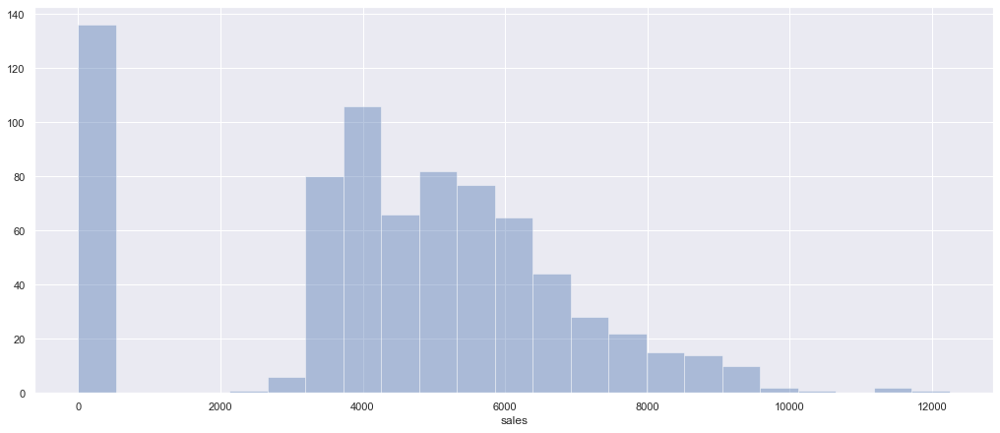

In [1206]:
fig = plt.figure( figsize = (14, 6), constrained_layout=True)
sns.distplot(df_store46['sales'], kde = False);
plt.show()

**Numerical Variable**


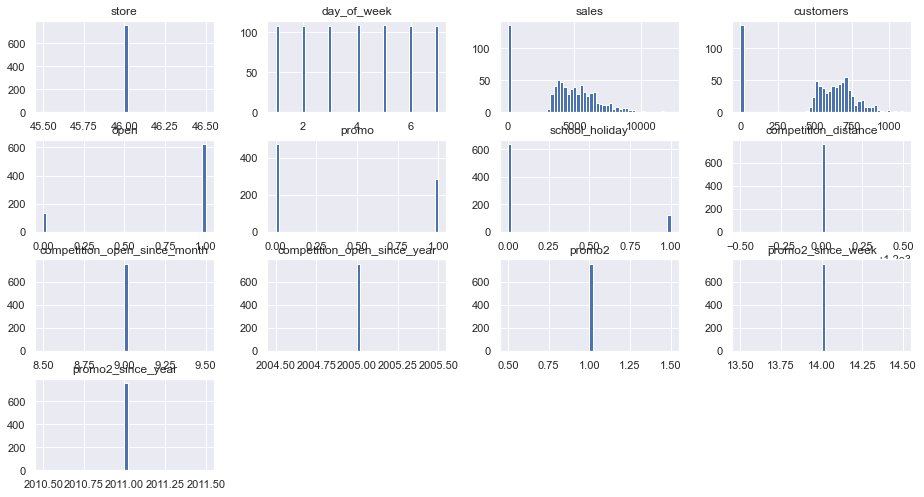

In [1207]:
sns.set(rc={'figure.figsize':(15.7,8.27)})
num_attributes.hist(bins = 50);

In [1208]:
df_store46['day_of_week'].value_counts()
#day of the week

5    109
4    109
7    108
6    108
3    108
2    108
1    108
Name: day_of_week, dtype: int64

In [1209]:
df_store46['open'].value_counts()
# value count of store is open or not

1    622
0    136
Name: open, dtype: int64

In [1210]:
df_store46['school_holiday'].value_counts()
# value count of state_holiday

0    634
1    124
Name: school_holiday, dtype: int64

In [1211]:
df_store46['store_type'].value_counts()
# value count of Store_type

c    758
Name: store_type, dtype: int64

In [1212]:
df_store46['assortment'].value_counts()
# value count of assortment

a    758
Name: assortment, dtype: int64

In [1213]:
df_store46['competition_distance'].value_counts()
# value count of competition distance

1200.0    758
Name: competition_distance, dtype: int64

In [1214]:
df_store46['competition_open_since_month'].value_counts()
# value count of competition_open_since_month

9.0    758
Name: competition_open_since_month, dtype: int64

In [1215]:
df_store46['competition_open_since_year'].value_counts()
# value count of competition open since year

2005.0    758
Name: competition_open_since_year, dtype: int64

In [1216]:
df_store46['promo2'].value_counts()
# value count of promo2

1    758
Name: promo2, dtype: int64

In [1217]:
df_store46['promo2_since_week'].value_counts()
# value count of promo2_since_week

14.0    758
Name: promo2_since_week, dtype: int64

In [1218]:
df_store46['promo2_since_year'].value_counts()
# value count of promo2_since_year

2011.0    758
Name: promo2_since_year, dtype: int64

In [1219]:
df_store46['promo_interval'].value_counts()
# value count of promo_interval

Jan,Apr,Jul,Oct    758
Name: promo_interval, dtype: int64

In [1220]:
df_store46.columns

Index(['store', 'day_of_week', 'date', 'sales', 'customers', 'open', 'promo',
       'state_holiday', 'school_holiday', 'store_type', 'assortment',
       'competition_distance', 'competition_open_since_month',
       'competition_open_since_year', 'promo2', 'promo2_since_week',
       'promo2_since_year', 'promo_interval'],
      dtype='object')

**Categorical Variable**

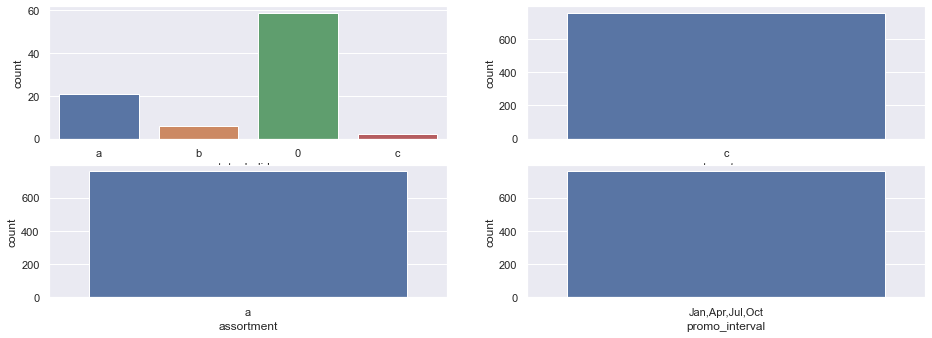

In [1221]:
# state_holiday
plt.subplot(3, 2, 1)
a = df_store46[df_store46['state_holiday'] != '0']
sns.countplot(data = a, x = a['state_holiday'])

# store_type
plt.subplot(3, 2, 2)
sns.countplot(data = df_store46, x = df_store46['store_type'])

# assortment
plt.subplot(3, 2, 3)
sns.countplot(data = df_store46, x = df_store46['assortment'])

#promo_interval
plt.subplot(3, 2, 4)
sns.countplot(data = df_store46, x = df_store46['promo_interval'])
plt.show()

In [1222]:
# Zero values in sales 
df_store46[df_store46['sales']==0]

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year,promo2,promo2_since_week,promo2_since_year,promo_interval
5620,46,7,2015-07-26,0,0,0,0,0,0,c,a,1200.0,9.0,2005.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
13425,46,7,2015-07-19,0,0,0,0,0,0,c,a,1200.0,9.0,2005.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
21230,46,7,2015-07-12,0,0,0,0,0,0,c,a,1200.0,9.0,2005.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
29035,46,7,2015-07-05,0,0,0,0,0,0,c,a,1200.0,9.0,2005.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
36840,46,7,2015-06-28,0,0,0,0,0,0,c,a,1200.0,9.0,2005.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
987150,46,7,2013-01-27,0,0,0,0,0,0,c,a,1200.0,9.0,2005.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
994955,46,7,2013-01-20,0,0,0,0,0,0,c,a,1200.0,9.0,2005.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
1002760,46,7,2013-01-13,0,0,0,0,0,0,c,a,1200.0,9.0,2005.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
1010565,46,7,2013-01-06,0,0,0,0,a,0,c,a,1200.0,9.0,2005.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"


In [1223]:
df_store46.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 758 entries, 45 to 1016140
Data columns (total 18 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   store                         758 non-null    int64         
 1   day_of_week                   758 non-null    int64         
 2   date                          758 non-null    datetime64[ns]
 3   sales                         758 non-null    int64         
 4   customers                     758 non-null    int64         
 5   open                          758 non-null    int64         
 6   promo                         758 non-null    int64         
 7   state_holiday                 758 non-null    object        
 8   school_holiday                758 non-null    int64         
 9   store_type                    758 non-null    object        
 10  assortment                    758 non-null    object        
 11  competition_distance       


-    Sale  and customer colomns has zero values which has to be imputed

-    Store is open on 80% of days

-    80% are regular days

-    All the rows of column-store type belongs to 'c'

-    All the rows of column-assortment belongs to 'a'

-    All the rows of columns-competition_distance to 1200

-    All the rows of promo2 belogs to 1

**Bivariate Analysis**

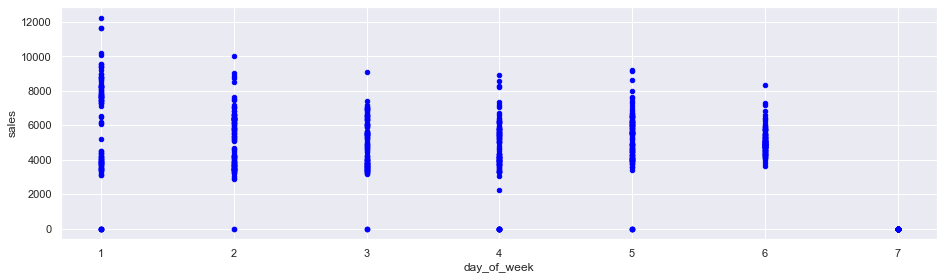

In [1224]:
#Let's draw a scatter plot between Sales and day_of_week
sns.set(rc={'figure.figsize':(15.7,4.27)})
df_store46[['sales', 'day_of_week']].plot.scatter(x = 'day_of_week',y='sales',c='blue')
plt.show()

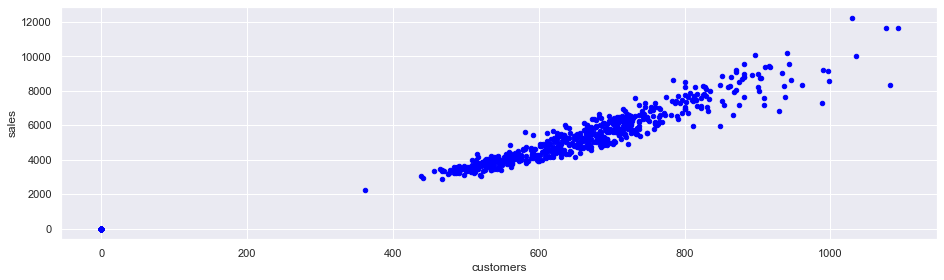

In [1225]:
#Let's draw a scatter plot between Sales and Customers
df_store46[['sales', 'customers']].plot.scatter(x = 'customers',y='sales',c='blue')
plt.show()

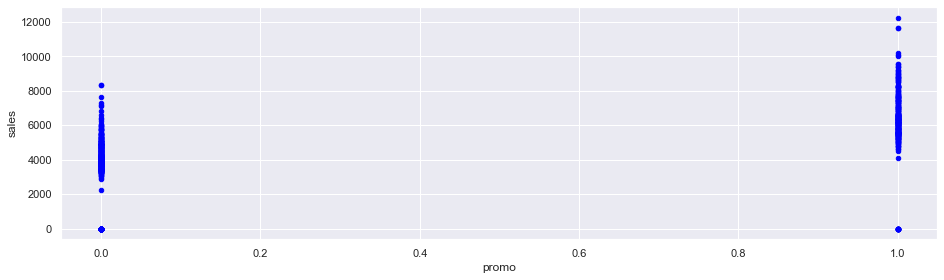

In [1226]:
#Let's draw a scatter plot between Sales and promo
df_store46[['sales', 'promo']].plot.scatter(x = 'promo',y='sales',c='blue')
plt.show()

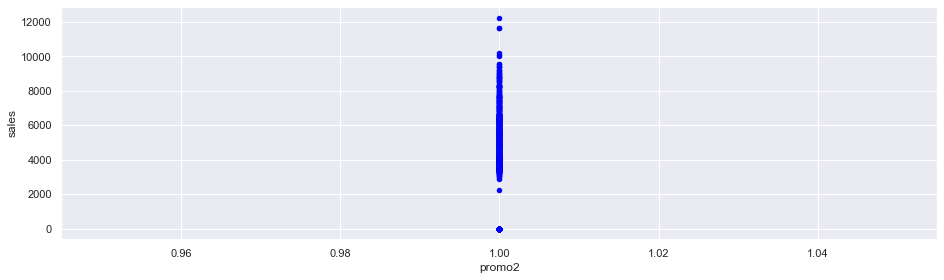

In [1227]:
#Let's now draw a scatter plot between Sales and promo
df_store46[['sales', 'promo2']].plot.scatter(x = 'promo2',y='sales',c='blue')
plt.show()

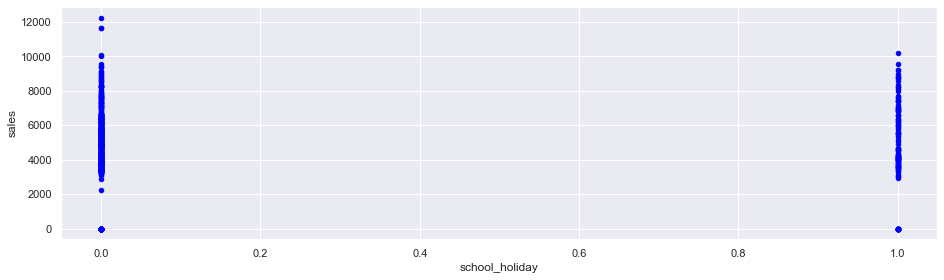

In [1228]:
#lets now draw a scatter plot between  Sales and school_holiday
df_store46[['sales', 'school_holiday']].plot.scatter(x = 'school_holiday',y='sales',c='blue')
plt.show()

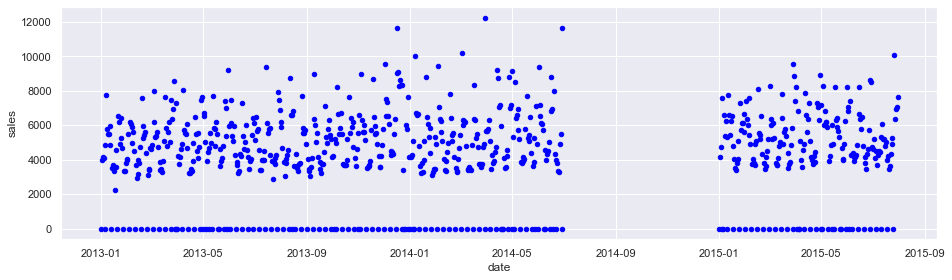

In [1229]:
#lets now draw a scatter plot between Sales and date
df_store46[['sales', 'date']].plot.scatter(x = 'date',y='sales',c='blue')
plt.show()

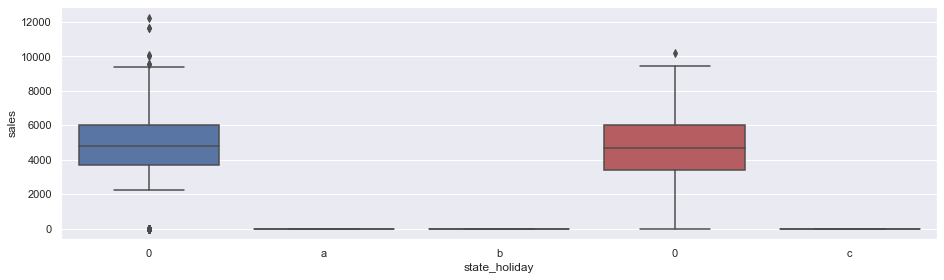

In [1230]:
#Let's draw the boxplot between sales and state_holiday
sns.set(rc={'figure.figsize':(15.7,4.27)})
# create grouped boxplot 
sns.boxplot(x = df_store46['state_holiday'],
            y = df_store46['sales'])
plt.show()

**Multivariate Analysis**

**Numerical Attributes**

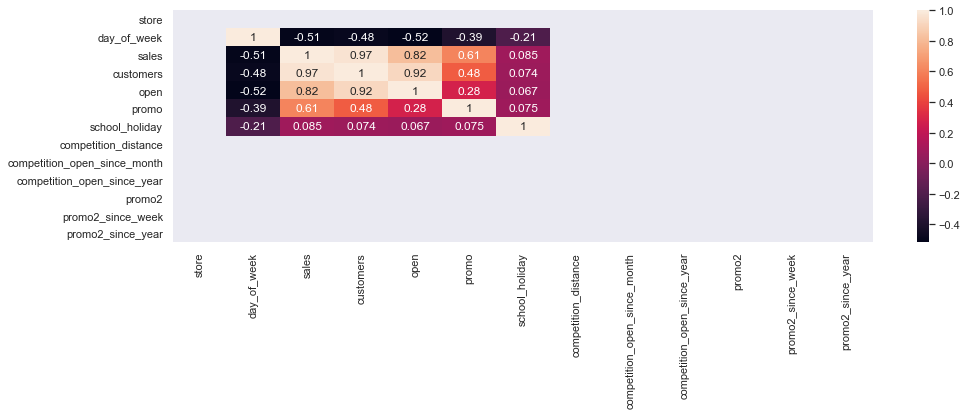

In [1231]:
correlation = (num_attributes.corr( method = 'pearson' ))
sns.heatmap( correlation, annot = True );

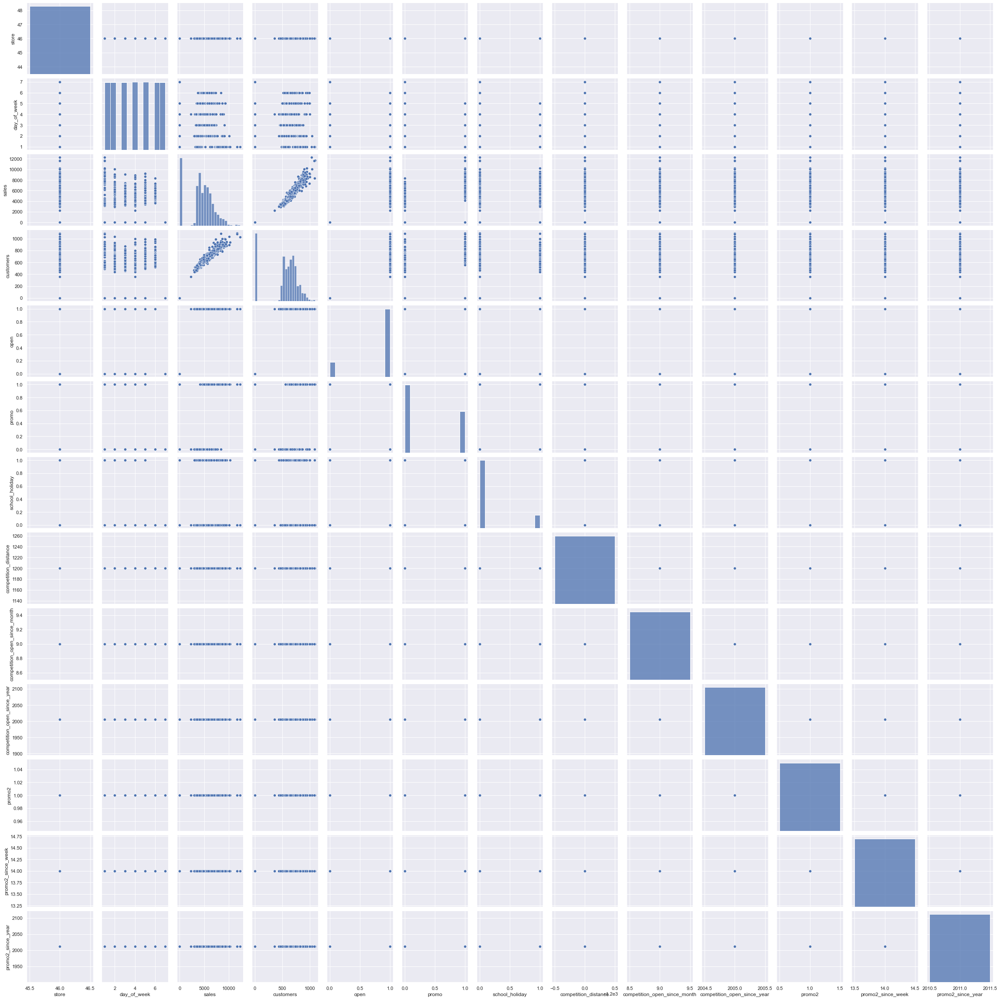

In [1232]:
#pairplot with hue sales
sns.pairplot(df_store46)
# to show
plt.show()

**Some insights from EDA**

   - store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year,promo2_since_week,promo2_since_year and promo_interval are uncessary columns becuase it doesn't have any effect on sales(target variable)

   - Day1 and Day2 have higher sales than other days

   - promo is correlated to sales

   - Promo2 doesn't have any effect on sales becuase it's value is equal to 1

   - There is no sale on a = public holiday, b = Easter holiday, c = Christmas

   - There is some effect of school holiday on sales

In [1233]:
df_store46.columns

Index(['store', 'day_of_week', 'date', 'sales', 'customers', 'open', 'promo',
       'state_holiday', 'school_holiday', 'store_type', 'assortment',
       'competition_distance', 'competition_open_since_month',
       'competition_open_since_year', 'promo2', 'promo2_since_week',
       'promo2_since_year', 'promo_interval'],
      dtype='object')

In [1234]:
#We can drop store_type,assortment,competition_distance,competition_open_since_month,promo2_since_week,promo2_since_year,promo_interval
#competition_open_since_year & promo2
df_store46_new=df_store46.drop(['store_type', 'assortment','competition_distance','competition_open_since_month','competition_open_since_year','promo2_since_week','promo2_since_year','promo_interval'], axis = 1)
df_store46_new.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 758 entries, 45 to 1016140
Data columns (total 10 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   store           758 non-null    int64         
 1   day_of_week     758 non-null    int64         
 2   date            758 non-null    datetime64[ns]
 3   sales           758 non-null    int64         
 4   customers       758 non-null    int64         
 5   open            758 non-null    int64         
 6   promo           758 non-null    int64         
 7   state_holiday   758 non-null    object        
 8   school_holiday  758 non-null    int64         
 9   promo2          758 non-null    int64         
dtypes: datetime64[ns](1), int64(8), object(1)
memory usage: 85.1+ KB


In [1235]:
df_store46_new.columns

Index(['store', 'day_of_week', 'date', 'sales', 'customers', 'open', 'promo',
       'state_holiday', 'school_holiday', 'promo2'],
      dtype='object')

In [1236]:
df_store46_new.head()

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,promo2
45,46,5,2015-07-31,7628,775,1,1,0,0,1
1160,46,4,2015-07-30,7057,760,1,1,0,0,1
2275,46,3,2015-07-29,6955,716,1,1,0,0,1
3390,46,2,2015-07-28,6385,714,1,1,0,0,1
4505,46,1,2015-07-27,10068,896,1,1,0,0,1


In [1237]:
df_store46_new=df_store46_new[::-1].reset_index()
df_store46_new.head()

,index,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,promo2
0,1016140,46,2,2013-01-01,0,0,0,0,a,1,1
1,1015025,46,3,2013-01-02,4016,582,1,0,0,1,1
2,1013910,46,4,2013-01-03,4177,553,1,0,0,1,1
3,1012795,46,5,2013-01-04,4125,569,1,0,0,1,1
4,1011680,46,6,2013-01-05,4848,651,1,0,0,0,1


In [1238]:
df_store46_new=df_store46_new.drop(['index'], axis = 1)
df_store46_new.head()
#Let drop the index column

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,promo2
0,46,2,2013-01-01,0,0,0,0,a,1,1
1,46,3,2013-01-02,4016,582,1,0,0,1,1
2,46,4,2013-01-03,4177,553,1,0,0,1,1
3,46,5,2013-01-04,4125,569,1,0,0,1,1
4,46,6,2013-01-05,4848,651,1,0,0,0,1


In [1239]:
df_store46_new.info()
#No missing value

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 758 entries, 0 to 757
Data columns (total 10 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   store           758 non-null    int64         
 1   day_of_week     758 non-null    int64         
 2   date            758 non-null    datetime64[ns]
 3   sales           758 non-null    int64         
 4   customers       758 non-null    int64         
 5   open            758 non-null    int64         
 6   promo           758 non-null    int64         
 7   state_holiday   758 non-null    object        
 8   school_holiday  758 non-null    int64         
 9   promo2          758 non-null    int64         
dtypes: datetime64[ns](1), int64(8), object(1)
memory usage: 59.3+ KB


In [1240]:
#transform datatype of the variable data to datetime
df_store46_new['date'] = pd.to_datetime(df_store46_new['date'])

In [1241]:
indexed_df_store46_new = df_store46_new.set_index(['date'])
indexed_df_store46_new.head()
#Let's set the date as index column

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2
date,,,,,,,,,
2013-01-01,46,2,0,0,0,0,a,1,1
2013-01-02,46,3,4016,582,1,0,0,1,1
2013-01-03,46,4,4177,553,1,0,0,1,1
2013-01-04,46,5,4125,569,1,0,0,1,1
2013-01-05,46,6,4848,651,1,0,0,0,1


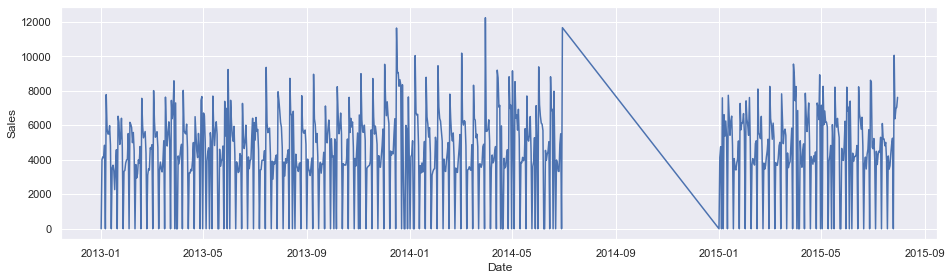

In [1242]:
#plot graph
plt.xlabel('Date')
plt.ylabel('Sales')
plt.plot(indexed_df_store46_new['sales'])
plt.show()

In [1243]:
#Let impute the zero values
(indexed_df_store46_new['sales']==0).sum()
# There are 136 zero value in sale column

136

In [1244]:
indexed_df_store46_new['sales']=indexed_df_store46_new['sales'].replace(0, np.nan)

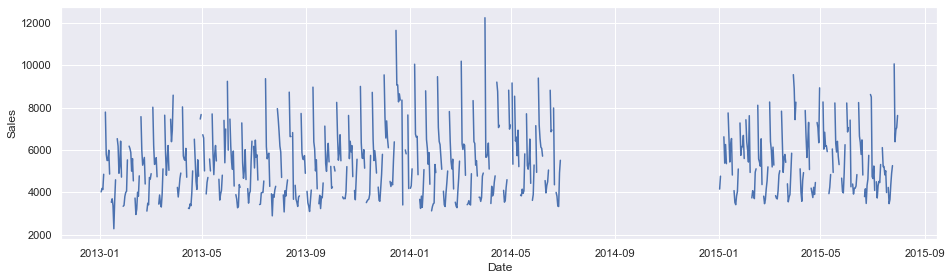

In [1245]:
#plot graph
plt.xlabel('Date')
plt.ylabel('Sales')
plt.plot(indexed_df_store46_new['sales'])
plt.show()

In [1246]:
#KNN imputer for filling NAN values
imputer = KNNImputer(n_neighbors=2)

In [1247]:
indexed_df_store46_new['sales'] = imputer.fit_transform(np.array(indexed_df_store46_new['sales']).reshape(-1, 1))
indexed_df_store46_new['sales'].head()

date
2013-01-01    5352.290997
2013-01-02    4016.000000
2013-01-03    4177.000000
2013-01-04    4125.000000
2013-01-05    4848.000000
Name: sales, dtype: float64

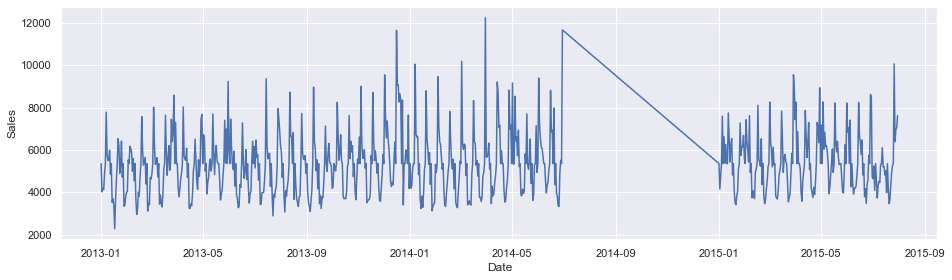

In [1248]:
## plot graph
plt.xlabel('Date')
plt.ylabel('Sales')
plt.plot(indexed_df_store46_new['sales'])
plt.show()

In [1249]:
(indexed_df_store46_new['sales']==0).sum()
# no missing value

0

In [1250]:
indexed_df_store46_new1=indexed_df_store46_new[:546]

In [1251]:
indexed_df_store46_new1.tail()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2
date,,,,,,,,,
2014-06-26,46,4,3323.000000,488,1,0,0,0,1
2014-06-27,46,5,4918.000000,606,1,0,0,0,1
2014-06-28,46,6,5509.000000,712,1,0,0,0,1
2014-06-29,46,7,5352.290997,0,0,0,0,0,1
2014-06-30,46,1,11673.000000,1092,1,1,0,0,1



**6 Month data from 1/07/2014 to 31/12/2014 is missing so we can keep data till 30/06/2014 to make the model**

**Outlier detection**

Box plot and interquartile range

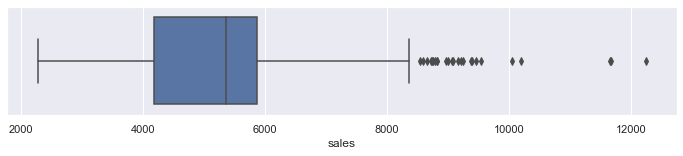

In [1252]:
import seaborn as sns
fig = plt.subplots(figsize=(12, 2))
ax = sns.boxplot(x=indexed_df_store46_new1['sales'],whis=1.5)
#Let treat the outliers

**Histogram**


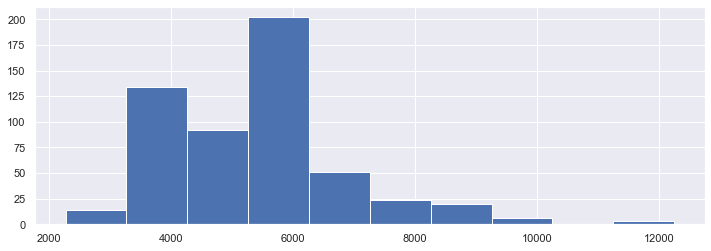

In [1253]:
fig = indexed_df_store46_new1['sales'].hist(figsize = (12,4))

In [1254]:
percentile01 = indexed_df_store46_new1['sales'].quantile(0.01)
percentile99 = indexed_df_store46_new1['sales'].quantile(0.99)

In [1255]:
upper_limit = percentile99
lower_limit = percentile01

In [1256]:
upper_limit

9508.749999999996

In [1257]:
lower_limit

3111.5

In [1258]:
#Let's keep the data till 99 percentile
new_df = indexed_df_store46_new1[indexed_df_store46_new1['sales'] < upper_limit]
new_df.shape

(540, 9)

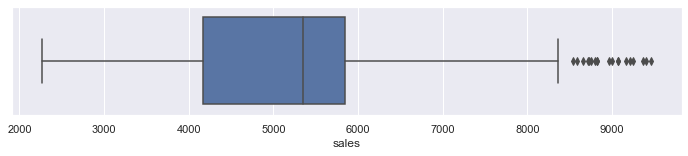

In [1259]:
import seaborn as sns
fig = plt.subplots(figsize=(12, 2))
ax = sns.boxplot(x=new_df['sales'],whis=1.5)

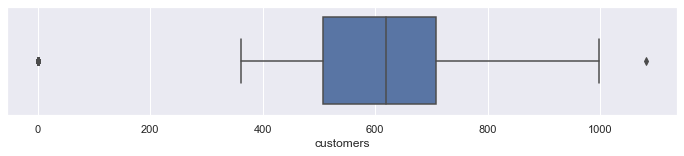

In [1260]:
import seaborn as sns
fig = plt.subplots(figsize=(12, 2))
ax = sns.boxplot(x=new_df['customers'],whis=1.5)

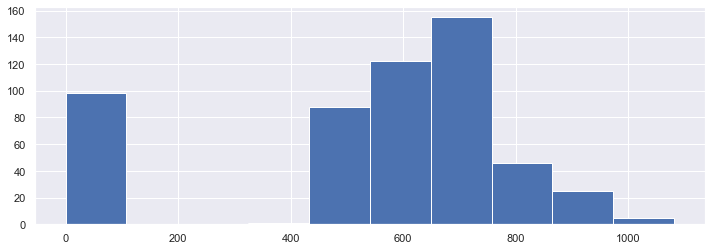

In [1261]:
fig = new_df['customers'].hist(figsize = (12,4))

**ADF Stationary**

In [1262]:
def test_stationarity(timeseries):
    
    #Determine rolling statistics
    movingAverage = timeseries.rolling(window=12).mean()
    movingSTD = timeseries.rolling(window=12).std()
    
    #Plot rolling statistics
    orig = plt.plot(timeseries, color='blue', label='Original')
    mean = plt.plot(movingAverage, color='red', label='Rolling Mean')
    std = plt.plot(movingSTD, color='black', label='Rolling Std')
    plt.legend(loc='best')
    plt.title('Rolling Mean & Standard Deviation')
    plt.show(block=False)
    
    #Perform Dickey–Fuller test:
    print('Results of Dickey Fuller Test:')
    dftest = adfuller(indexed_df_store46_new1['sales'], autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    for key,value in dftest[4].items():
        dfoutput['Critical Value (%s)'%key] = value
    print(dfoutput)

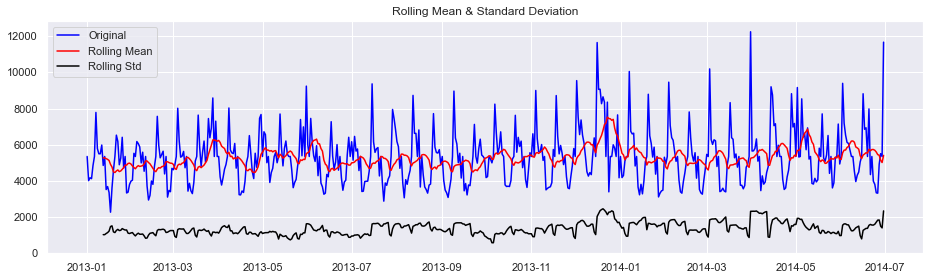

Results of Dickey Fuller Test:
Test Statistic                  -4.870578
p-value                          0.000040
#Lags Used                      15.000000
Number of Observations Used    530.000000
Critical Value (1%)             -3.442749
Critical Value (5%)             -2.867009
Critical Value (10%)            -2.569683
dtype: float64


In [1263]:
#ADF test to check the stationary
test_stationarity(indexed_df_store46_new1['sales'])

- Null: Time Series is not stationary
- Alternate: Time Series is Stationary

**The p-value is less than 0.05 so The series is stationary**

In [1264]:
from statsmodels.tsa.stattools import kpss
kpss_test = kpss(indexed_df_store46_new1['sales'])

print('KPSS Statistic: %f' % kpss_test[0])
print('Critical Values @ 0.05: %.2f' % kpss_test[3]['5%'])
print('p-value: %f' % kpss_test[1])

KPSS Statistic: 0.483116
Critical Values @ 0.05: 0.46
p-value: 0.045469


- Null: Time Series is not stationary
- Alternate: Time Series is Stationary
    
**The p-value is less than 0.05 so The series is non-stationary**

# Let's take the log of sales to Standardize the sales values

In [1265]:
new_df=indexed_df_store46_new1.copy()
new_df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 546 entries, 2013-01-01 to 2014-06-30
Data columns (total 9 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   store           546 non-null    int64  
 1   day_of_week     546 non-null    int64  
 2   sales           546 non-null    float64
 3   customers       546 non-null    int64  
 4   open            546 non-null    int64  
 5   promo           546 non-null    int64  
 6   state_holiday   546 non-null    object 
 7   school_holiday  546 non-null    int64  
 8   promo2          546 non-null    int64  
dtypes: float64(1), int64(7), object(1)
memory usage: 42.7+ KB


**Log transformation has made mean & variance constant**

In [1266]:
#Log Transformation
new_df['sales_log'] = np.log(new_df['sales'])
new_df.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log
date,,,,,,,,,,
2013-01-01,46,2,5352.290997,0,0,0,a,1,1,8.585280
2013-01-02,46,3,4016.000000,582,1,0,0,1,1,8.298042
2013-01-03,46,4,4177.000000,553,1,0,0,1,1,8.337349
2013-01-04,46,5,4125.000000,569,1,0,0,1,1,8.324821
2013-01-05,46,6,4848.000000,651,1,0,0,0,1,8.486322


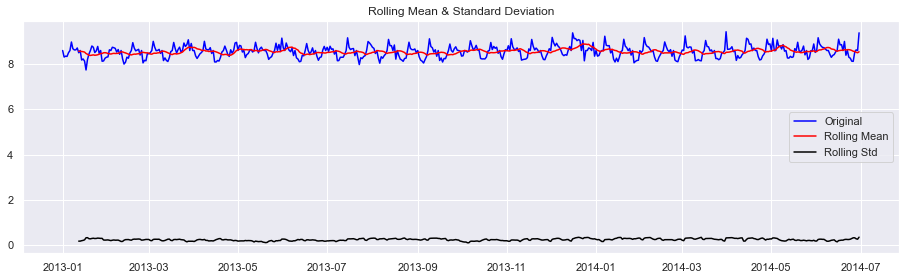

Results of Dickey Fuller Test:
Test Statistic                  -4.870578
p-value                          0.000040
#Lags Used                      15.000000
Number of Observations Used    530.000000
Critical Value (1%)             -3.442749
Critical Value (5%)             -2.867009
Critical Value (10%)            -2.569683
dtype: float64


In [1267]:
test_stationarity(new_df['sales_log'])

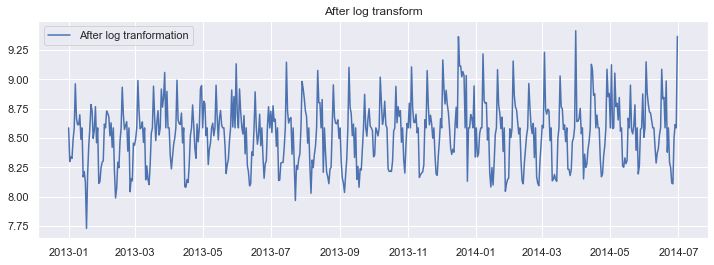

In [1268]:
#After Log Transformation
plt.figure(figsize=(12,4))
plt.plot(new_df['sales_log'], label='After log tranformation')
plt.legend(loc='best')
plt.title('After log transform')
plt.show()

**Decomposition of time-series**


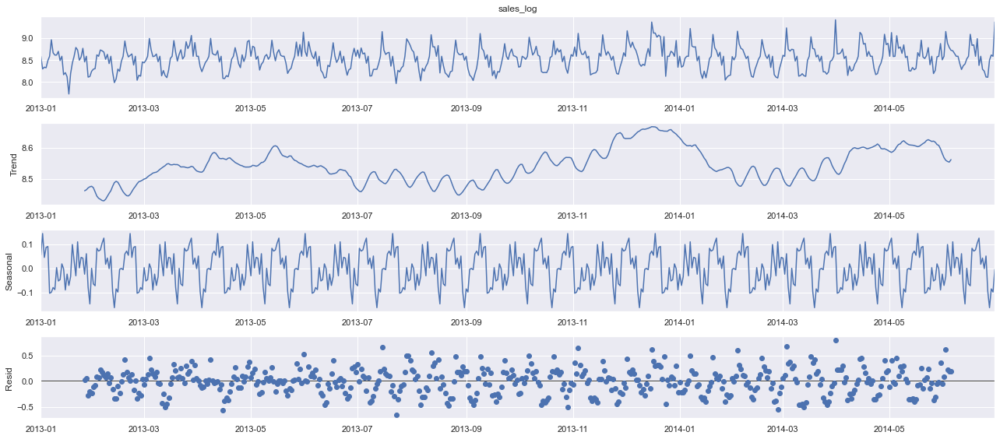

In [1269]:
from matplotlib.pyplot import rcParams
rcParams['figure.figsize'] = 18,8
decomposition = sm.tsa.seasonal_decompose(new_df['sales_log'], model = "additive",period=50)
fig = decomposition.plot()

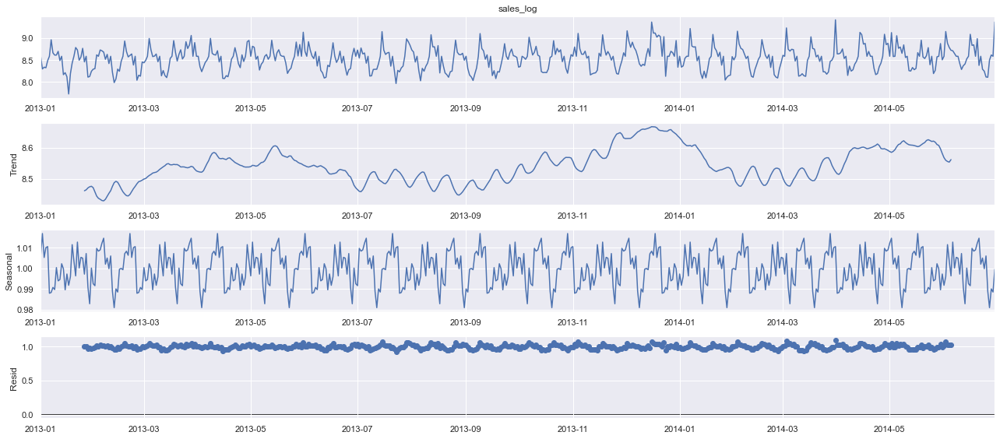

In [1270]:
from matplotlib.pyplot import rcParams
rcParams['figure.figsize'] = 18,8
decomposition = sm.tsa.seasonal_decompose(new_df['sales_log'], model = "multiplicative",period=50)
fig = decomposition.plot()

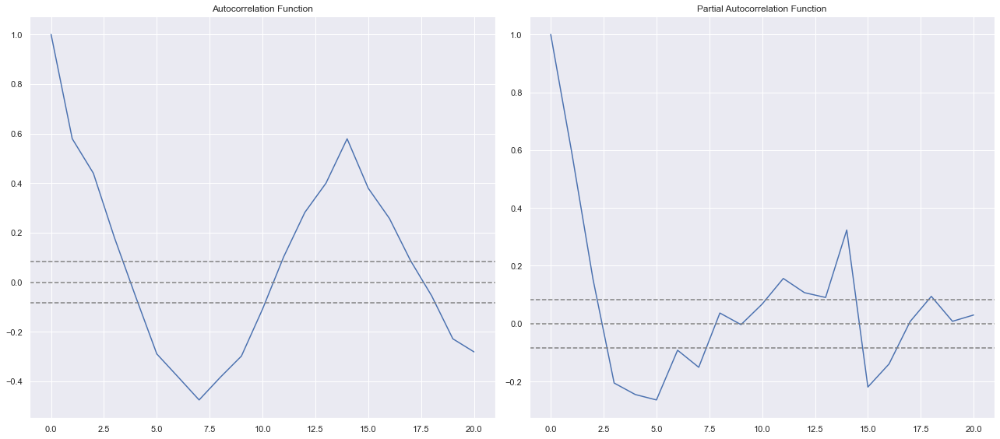

In [1271]:
#ACF & PACF plots

lag_acf = acf(new_df['sales_log'], nlags=20) # MA 
lag_pacf = pacf(new_df['sales_log'], nlags=20, method='ols')  # AR 

#Plot ACF:
plt.subplot(121)
plt.plot(lag_acf)
plt.axhline(y=0, linestyle='--', color='gray')
plt.axhline(y=-1.96/np.sqrt(len(new_df['sales_log'])), linestyle='--', color='gray')
plt.axhline(y=1.96/np.sqrt(len(new_df['sales_log'])), linestyle='--', color='gray')
plt.title('Autocorrelation Function')            

#Plot PACF
plt.subplot(122)
plt.plot(lag_pacf)
plt.axhline(y=0, linestyle='--', color='gray')
plt.axhline(y=-1.96/np.sqrt(len(new_df['sales_log'])), linestyle='--', color='gray')
plt.axhline(y=1.96/np.sqrt(len(new_df['sales_log'])), linestyle='--', color='gray')
plt.title('Partial Autocorrelation Function')
            
plt.tight_layout() 

From the ACF graph, we see that curve touches y=0.0 line at x=3. Thus, from theory, Q = 4 From the PACF graph, we see that curve touches y=0.0 line at x=3. Thus, from theory, P = 2

**Build and evaluate time series forecast**

Split time series data into training and test set

In [1272]:
train_len = 446
train = new_df['sales'][0:train_len] # first 446days as training set
test = new_df['sales'][train_len:] # last 100 days as out-of-time test set

In [1273]:
print(train.shape)
print(test.shape)

(446,)
(100,)


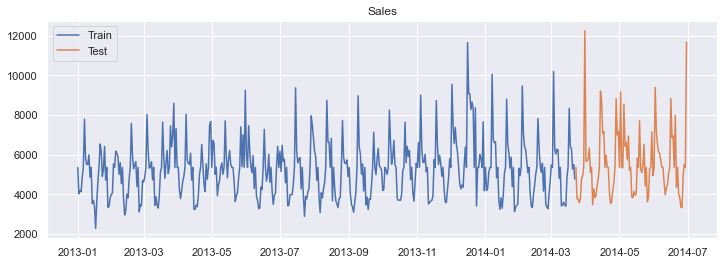

In [1274]:
#Let's plot the graph
plt.figure(figsize=(12,4))
plt.plot(train, label='Train')
plt.plot(test, label='Test')
plt.legend(loc='best')
plt.title('Sales')
plt.show()

In [1275]:
#Arima Modelling
model = ARIMA(new_df['sales_log'], order=(2, 0, 4))
model_fit = model.fit()
print(model_fit.params)

const              8.543252
ar.L1.sales_log    1.761099
ar.L2.sales_log   -0.960988
ma.L1.sales_log   -1.434476
ma.L2.sales_log    0.745305
ma.L3.sales_log   -0.119551
ma.L4.sales_log    0.100905
dtype: float64


In [1276]:
# Predictions
new_df['ar_forecast_Log'] = model_fit.predict(new_df.index.min(), new_df.index.max())
new_df['arima_forecast'] = np.exp(new_df['ar_forecast_Log'])
new_df['arima_forecast']

date
2013-01-01    5132.006597
2013-01-02    5262.036058
2013-01-03    4560.893112
2013-01-04    4270.034057
2013-01-05    4359.565976
                 ...     
2014-06-26    3898.505313
2014-06-27    4017.608612
2014-06-28    4856.280099
2014-06-29    5892.837498
2014-06-30    6253.272919
Name: arima_forecast, Length: 546, dtype: float64

In [1277]:
new_df['ar_forecast_Log'] = model_fit.predict(new_df.index.min(), new_df.index.max())
new_df['arima_forecast'] = np.exp(new_df['ar_forecast_Log'])
new_df['arima_forecast']

date
2013-01-01    5132.006597
2013-01-02    5262.036058
2013-01-03    4560.893112
2013-01-04    4270.034057
2013-01-05    4359.565976
                 ...     
2014-06-26    3898.505313
2014-06-27    4017.608612
2014-06-28    4856.280099
2014-06-29    5892.837498
2014-06-30    6253.272919
Name: arima_forecast, Length: 546, dtype: float64

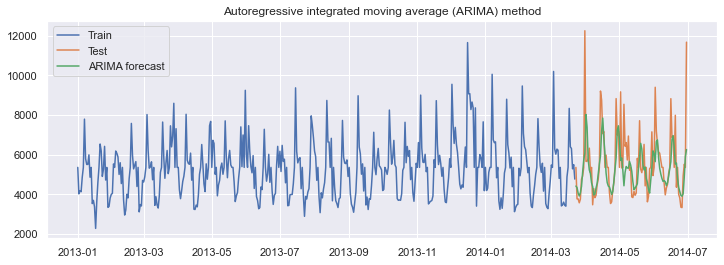

In [1278]:
plt.figure(figsize=(12,4))
plt.plot(train, label='Train')
plt.plot(test, label='Test')
plt.plot(new_df['arima_forecast'][test.index.min():], label='ARIMA forecast')
plt.legend(loc='best')
plt.title('Autoregressive integrated moving average (ARIMA) method')
plt.show()

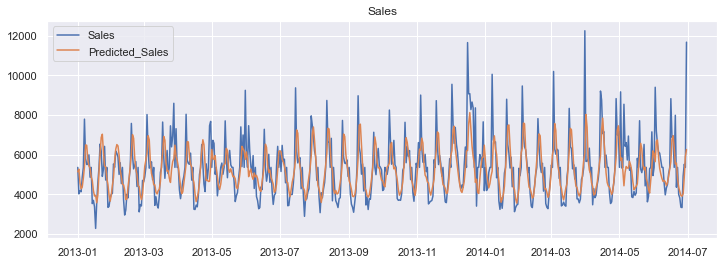

In [1279]:
#plot the arima forecasting & Original series
plt.figure(figsize=(12,4))
plt.plot(new_df['sales'], label='Sales')
plt.plot(new_df['arima_forecast'], label='Predicted_Sales')
plt.legend(loc='best')
plt.title('Sales')
plt.show()

In [1280]:
#Let's predict the sale after 6 weeks
from pandas.tseries.offsets import DateOffset
future_dates2=[new_df.index[-1]+DateOffset(days=x)for x in range(0,42)]
future_datest_df=pd.DataFrame(index=future_dates2[1:],columns=new_df.columns)

In [1281]:
future_datest_df.tail()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast
2014-08-06,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2014-08-07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2014-08-08,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2014-08-09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2014-08-10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [1282]:
future_df=pd.concat([new_df,future_datest_df])
future_df.shape

(587, 12)

In [1283]:
new_df.shape

(546, 12)

In [1284]:
print(future_df.index.min())
print(future_df.index.max())

2013-01-01 00:00:00
2014-08-10 00:00:00


In [1285]:
future_df['forecast'] = model_fit.predict(start = future_df.index.min(), end = future_df.index.max())
future_df['arima_forecast'] = np.exp(future_df['forecast'])
future_df['arima_forecast']

2013-01-01    5132.006597
2013-01-02    5262.036058
2013-01-03    4560.893112
2013-01-04    4270.034057
2013-01-05    4359.565976
                 ...     
2014-08-06    4217.521503
2014-08-07    4463.894120
2014-08-08    4847.485873
2014-08-09    5307.303138
2014-08-10    5751.486557
Name: arima_forecast, Length: 587, dtype: float64

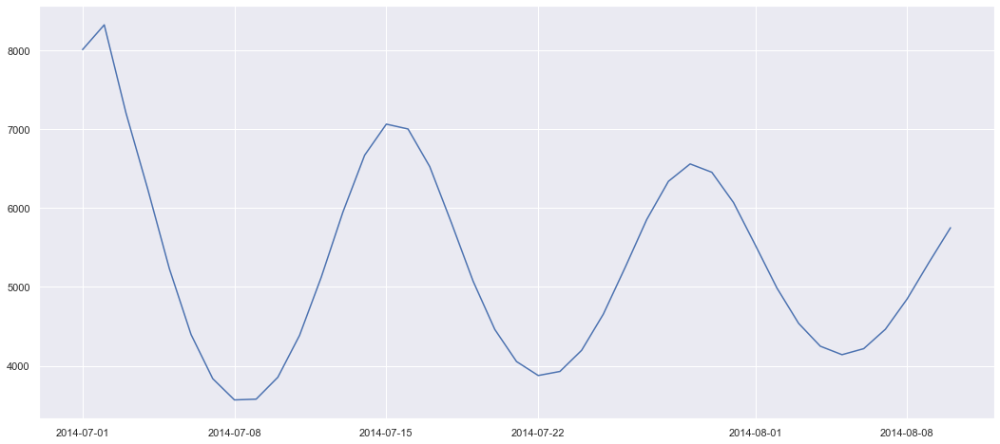

In [1286]:
plt.plot(future_df['arima_forecast'][546:], label='Predicted_Sales')
plt.show()

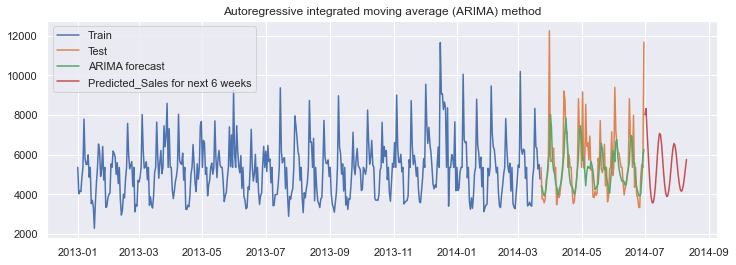

In [1287]:
plt.figure(figsize=(12,4))
plt.plot(train, label='Train')
plt.plot(test, label='Test')
plt.plot(new_df['arima_forecast'][test.index.min():], label='ARIMA forecast')
plt.plot(future_df['arima_forecast'][546:], label='Predicted_Sales for next 6 weeks')
plt.legend(loc='best')
plt.title('Autoregressive integrated moving average (ARIMA) method')
plt.show()

In [1288]:
new_df.columns

Index(['store', 'day_of_week', 'sales', 'customers', 'open', 'promo',
       'state_holiday', 'school_holiday', 'promo2', 'sales_log',
       'ar_forecast_Log', 'arima_forecast'],
      dtype='object')

In [1289]:
future_df

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast,forecast
2013-01-01,46,2,5352.290997,0,0,0,a,1,1,8.585280,8.543252,5132.006597,8.543252
2013-01-02,46,3,4016.000000,582,1,0,0,1,1,8.298042,8.568273,5262.036058,8.568273
2013-01-03,46,4,4177.000000,553,1,0,0,1,1,8.337349,8.425274,4560.893112,8.425274
2013-01-04,46,5,4125.000000,569,1,0,0,1,1,8.324821,8.359377,4270.034057,8.359377
2013-01-05,46,6,4848.000000,651,1,0,0,0,1,8.486322,8.380128,4359.565976,8.380128
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2014-08-06,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4217.521503,8.347003
2014-08-07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4463.894120,8.403777
2014-08-08,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4847.485873,8.486215
2014-08-09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5307.303138,8.576839


**Model Evalution** 

In [1290]:
from sklearn.metrics import mean_squared_error
rmse = np.sqrt(mean_squared_error(test, new_df['arima_forecast'][test.index.min():])).round(2)
mape = np.round(np.mean(np.abs(test-new_df['arima_forecast'][test.index.min():])/test)*100,2)
Results = pd.DataFrame({'Method':['ARIMA'], 'RMSE': [rmse],'MAPE': [mape] })
Results

,Method,RMSE,MAPE
0,ARIMA,1431.82,14.62


**VAR model**

In [1291]:
#Load the dataset
new_df.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast
date,,,,,,,,,,,,
2013-01-01,46,2,5352.290997,0,0,0,a,1,1,8.585280,8.543252,5132.006597
2013-01-02,46,3,4016.000000,582,1,0,0,1,1,8.298042,8.568273,5262.036058
2013-01-03,46,4,4177.000000,553,1,0,0,1,1,8.337349,8.425274,4560.893112
2013-01-04,46,5,4125.000000,569,1,0,0,1,1,8.324821,8.359377,4270.034057
2013-01-05,46,6,4848.000000,651,1,0,0,0,1,8.486322,8.380128,4359.565976


**Split the dataset to training & testing**

In [1292]:
#split the dataset
nobs = 100
train, test = new_df[0:-nobs], new_df[-nobs:]

# Check size
print(train.shape)
print(test.shape)  

(446, 12)
(100, 12)


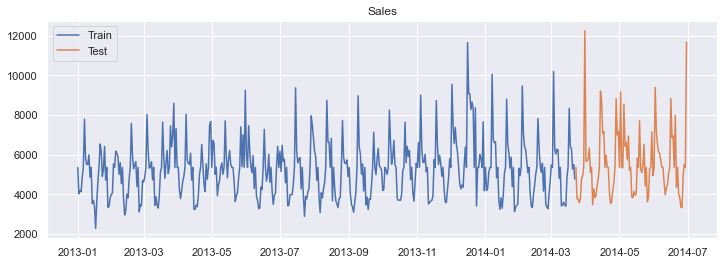

In [1293]:
plt.figure(figsize=(12,4))
plt.plot(train['sales'], label='Train')
plt.plot(test['sales'], label='Test')
plt.legend(loc='best')
plt.title('Sales')
plt.show()

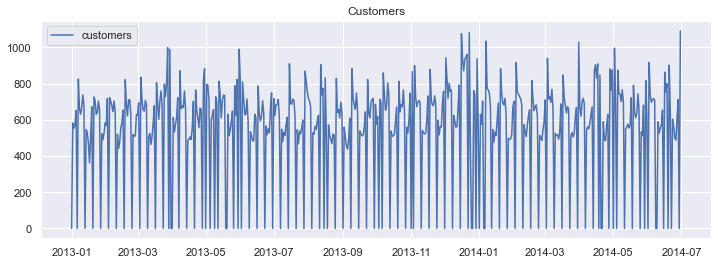

In [1294]:
#plot the arima forecasting & Original series
plt.figure(figsize=(12,4))
plt.plot(new_df['customers'],label='customers')
plt.legend(loc='best')
plt.title('Customers')
plt.show()

In [1295]:
(new_df['customers']==0).sum()

98

In [1296]:
#impute the NAN values
new_df['customers']=new_df['customers'].replace(0, np.nan)

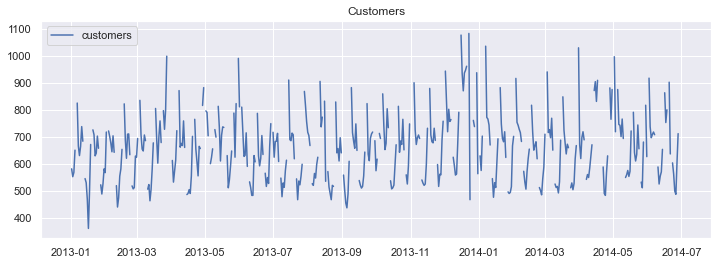

In [1297]:
#plot the arima forecasting & Original series
plt.figure(figsize=(12,4))
plt.plot(new_df['customers'],label='customers')
plt.legend(loc='best')
plt.title('Customers')
plt.show()

In [1298]:
#KNN imputer for filling NAN values
imputer = KNNImputer(n_neighbors=2)

In [1299]:
new_df['customers'] = imputer.fit_transform(np.array(new_df['customers']).reshape(-1, 1))
new_df['customers'].head()

date
2013-01-01    661.848214
2013-01-02    582.000000
2013-01-03    553.000000
2013-01-04    569.000000
2013-01-05    651.000000
Name: customers, dtype: float64

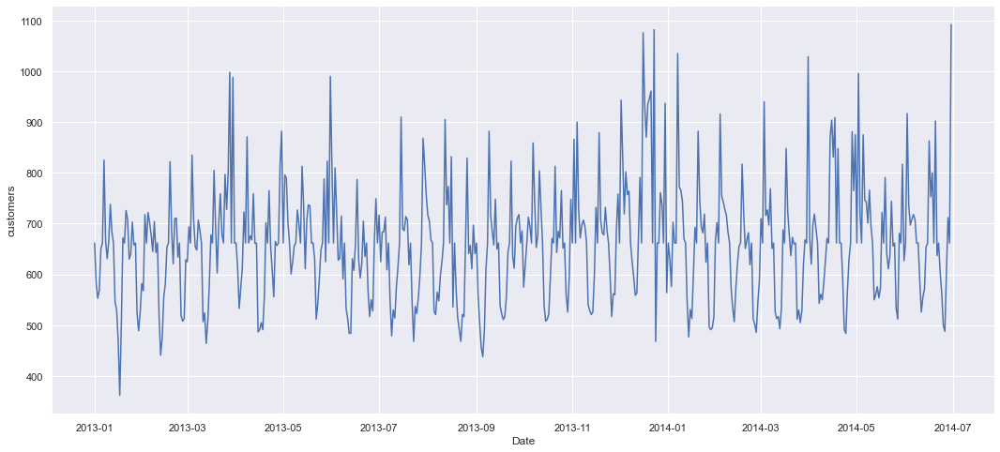

In [1300]:
## plot graph
plt.xlabel('Date')
plt.ylabel('customers')
plt.plot(new_df['customers'])
plt.show()

In [1301]:
new_df.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast
date,,,,,,,,,,,,
2013-01-01,46,2,5352.290997,661.848214,0,0,a,1,1,8.585280,8.543252,5132.006597
2013-01-02,46,3,4016.000000,582.000000,1,0,0,1,1,8.298042,8.568273,5262.036058
2013-01-03,46,4,4177.000000,553.000000,1,0,0,1,1,8.337349,8.425274,4560.893112
2013-01-04,46,5,4125.000000,569.000000,1,0,0,1,1,8.324821,8.359377,4270.034057
2013-01-05,46,6,4848.000000,651.000000,1,0,0,0,1,8.486322,8.380128,4359.565976


**ADF test**

In [1302]:
def test_stationarity(timeseries):
    
    #Determine rolling statistics
    movingAverage = timeseries.rolling(window=12).mean()
    movingSTD = timeseries.rolling(window=12).std()
    
    #Plot rolling statistics
    orig = plt.plot(timeseries, color='blue', label='Original')
    mean = plt.plot(movingAverage, color='red', label='Rolling Mean')
    std = plt.plot(movingSTD, color='black', label='Rolling Std')
    plt.legend(loc='best')
    plt.title('Rolling Mean & Standard Deviation')
    plt.show(block=False)
    
    #Perform Dickey–Fuller test:
    print('Results of Dickey Fuller Test:')
    dftest = adfuller(new_df['customers'], autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    for key,value in dftest[4].items():
        dfoutput['Critical Value (%s)'%key] = value
    print(dfoutput)

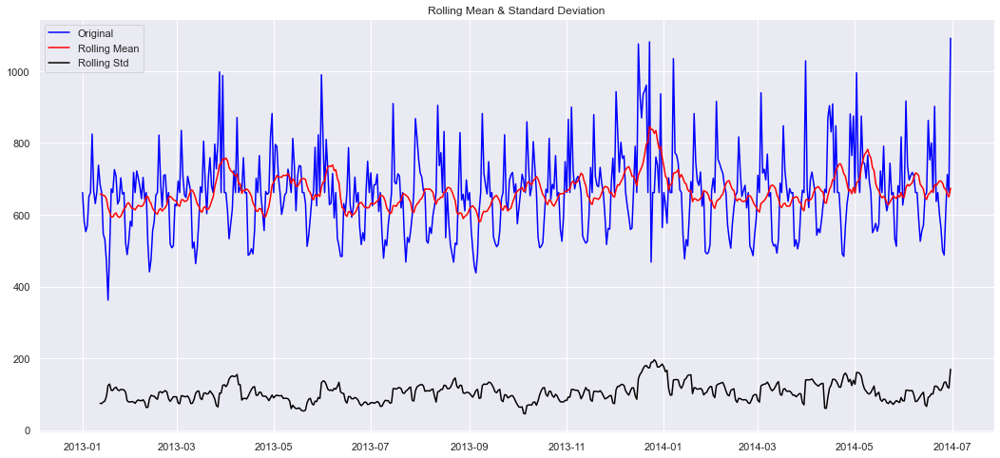

Results of Dickey Fuller Test:
Test Statistic                  -4.678127
p-value                          0.000092
#Lags Used                      15.000000
Number of Observations Used    530.000000
Critical Value (1%)             -3.442749
Critical Value (5%)             -2.867009
Critical Value (10%)            -2.569683
dtype: float64


In [1303]:
test_stationarity(new_df['customers'])

- Null: Time Series is not stationary
- Alternate: Time Series is Stationary

**The p-value is less than 0.05 so The series is stationary**

In [1304]:
from statsmodels.tsa.stattools import kpss
kpss_test = kpss(new_df['customers'])

print('KPSS Statistic: %f' % kpss_test[0])
print('Critical Values @ 0.05: %.2f' % kpss_test[3]['5%'])
print('p-value: %f' % kpss_test[1])

KPSS Statistic: 0.338694
Critical Values @ 0.05: 0.46
p-value: 0.100000


- Null: Time Series is not stationary
- Alternate: Time Series is Stationary

**The p-value is greater than 0.05 so The series is stationary**

**Log transformation has made mean & variance constant**


In [1305]:
#Log Transformation
new_df['customers_log'] = np.log(new_df['customers'])
new_df.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast,customers_log
date,,,,,,,,,,,,,
2013-01-01,46,2,5352.290997,661.848214,0,0,a,1,1,8.585280,8.543252,5132.006597,6.495036
2013-01-02,46,3,4016.000000,582.000000,1,0,0,1,1,8.298042,8.568273,5262.036058,6.366470
2013-01-03,46,4,4177.000000,553.000000,1,0,0,1,1,8.337349,8.425274,4560.893112,6.315358
2013-01-04,46,5,4125.000000,569.000000,1,0,0,1,1,8.324821,8.359377,4270.034057,6.343880
2013-01-05,46,6,4848.000000,651.000000,1,0,0,0,1,8.486322,8.380128,4359.565976,6.478510


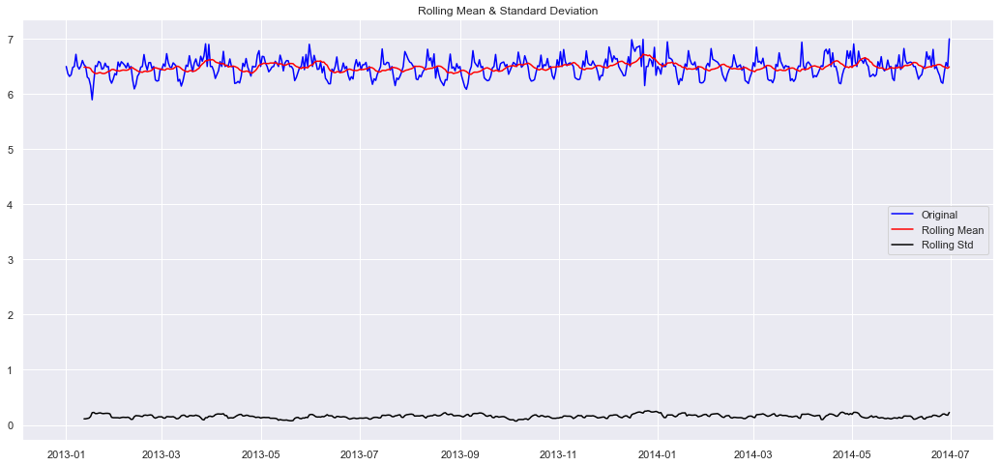

Results of Dickey Fuller Test:
Test Statistic                  -4.678127
p-value                          0.000092
#Lags Used                      15.000000
Number of Observations Used    530.000000
Critical Value (1%)             -3.442749
Critical Value (5%)             -2.867009
Critical Value (10%)            -2.569683
dtype: float64


In [1306]:
test_stationarity(new_df['customers_log'])

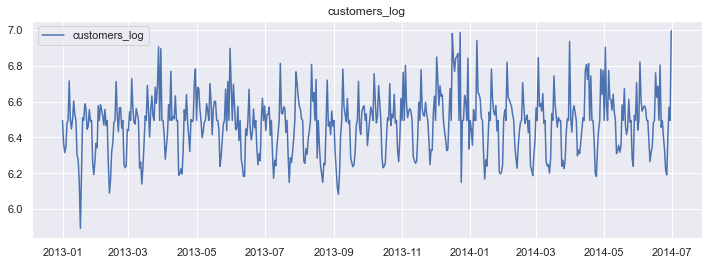

In [1307]:
#plot the arima Log series
plt.figure(figsize=(12,4))
plt.plot(new_df['customers_log'],label='customers_log')
plt.legend(loc='best')
plt.title('customers_log')
plt.show()

In [1308]:
#Let's check the info
new_df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 546 entries, 2013-01-01 to 2014-06-30
Data columns (total 13 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   store            546 non-null    int64  
 1   day_of_week      546 non-null    int64  
 2   sales            546 non-null    float64
 3   customers        546 non-null    float64
 4   open             546 non-null    int64  
 5   promo            546 non-null    int64  
 6   state_holiday    546 non-null    object 
 7   school_holiday   546 non-null    int64  
 8   promo2           546 non-null    int64  
 9   sales_log        546 non-null    float64
 10  ar_forecast_Log  546 non-null    float64
 11  arima_forecast   546 non-null    float64
 12  customers_log    546 non-null    float64
dtypes: float64(6), int64(6), object(1)
memory usage: 79.7+ KB


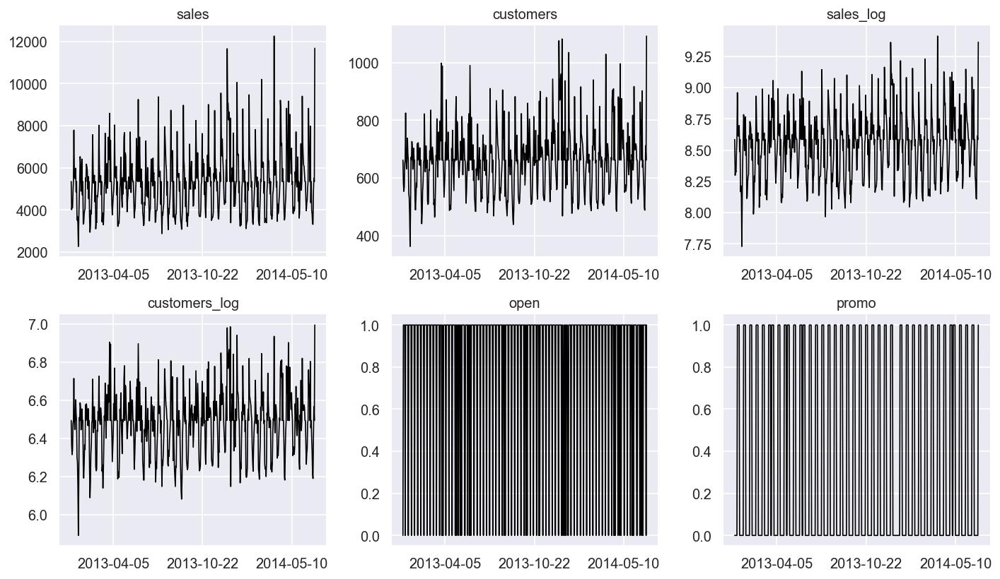

In [1309]:
# Plot
ls=['sales','customers','sales_log','customers_log','open','promo','state_holiday','promo2','school_holiday']
df=new_df[ls]
fig, axes = plt.subplots(nrows=2, ncols=3, dpi=120, figsize=(12,7))
for i, ax in enumerate(axes.flatten()):
        ax.plot(df[df.columns[i]], color='black', linewidth=1)
        ax.xaxis.set_major_locator(plt.MaxNLocator(3))
        # Decorations
        ax.set_title(df.columns[i])
        ax.xaxis.set_ticks_position('none')
        ax.yaxis.set_ticks_position('none')
        ax.spines["top"].set_alpha(0)
        ax.tick_params(labelsize=12)

plt.tight_layout();

In [1310]:
new_df.columns

Index(['store', 'day_of_week', 'sales', 'customers', 'open', 'promo',
       'state_holiday', 'school_holiday', 'promo2', 'sales_log',
       'ar_forecast_Log', 'arima_forecast', 'customers_log'],
      dtype='object')

In [1311]:
new_df1=new_df[['sales_log', 'customers_log']]
new_df1

,sales_log,customers_log
date,,
2013-01-01,8.585280,6.495036
2013-01-02,8.298042,6.366470
2013-01-03,8.337349,6.315358
2013-01-04,8.324821,6.343880
2013-01-05,8.486322,6.478510
...,...,...
2014-06-26,8.108623,6.190315
2014-06-27,8.500657,6.406880
2014-06-28,8.614138,6.568078


In [1312]:
#Let's create a model
model = VAR(new_df1)
for i in [1,2,3,4,5]:
    result = model.fit(i)
    print('Lag Order =', i)
    print('AIC : ', result.aic)
    print('BIC : ', result.bic)
    print('FPE : ', result.fpe)
    print('HQIC: ', result.hqic, '\n')

Lag Order = 1
AIC :  -9.244445314777083
BIC :  -9.197097214285376
FPE :  9.664702901748683e-05
HQIC:  -9.225935053751078 

Lag Order = 2
AIC :  -9.281741553708391
BIC :  -9.202716751376482
FPE :  9.310892455537175e-05
HQIC:  -9.250845126014504 

Lag Order = 3
AIC :  -9.35363823157594
BIC :  -9.242847199386116
FPE :  8.664984117120851e-05
HQIC:  -9.310318637985123 

Lag Order = 4
AIC :  -9.448759749739041
BIC :  -9.306112539359127
FPE :  7.878770162956451e-05
HQIC:  -9.392979813921203 

Lag Order = 5
AIC :  -9.58446659441288
BIC :  -9.409872834459788
FPE :  6.878977909597517e-05
HQIC:  -9.516188961776459 



In [1313]:
x = model.select_order(maxlags=5)
x.summary()

,AIC,BIC,FPE,HQIC
0,-8.817,-8.801,0.0001482,-8.810
1,-9.237,-9.189,9.736e-05,-9.218
2,-9.274,-9.195,9.381e-05,-9.243
3,-9.349,-9.238,8.709e-05,-9.305
4,-9.447,-9.304,7.893e-05,-9.391
5,-9.584*,-9.410*,6.879e-05*,-9.516*


In [1314]:
#Let's fit the model
model_fitted = model.fit()
model_fitted.summary()

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Mon, 17, Jan, 2022
Time:                     16:43:58
--------------------------------------------------------------------
No. of Equations:         2.00000    BIC:                   -9.19710
Nobs:                     545.000    HQIC:                  -9.22594
Log likelihood:           978.468    FPE:                9.66470e-05
AIC:                     -9.24445    Det(Omega_mle):     9.55917e-05
--------------------------------------------------------------------
Results for equation sales_log
                      coefficient       std. error           t-stat            prob
-----------------------------------------------------------------------------------
const                    3.689080         0.391284            9.428           0.000
L1.sales_log             0.679197         0.126965            5.349           0.000
L1.customers_log        -0.146301         0.

In [1315]:
# Get the lag order
lag_order = model_fitted.k_ar
print(lag_order)  #> 4

1


In [1316]:
# Input data for forecasting
forecast_input = new_df1.values[-lag_order:]
forecast_input

array([[9.36503376, 6.99576616]])

In [1317]:
# Forecast
fc = model_fitted.forecast(y=forecast_input, steps=100)
df_forecast = pd.DataFrame(fc, index=future_df.index[-100:], columns=new_df1.columns + '_2d')
df_forecast

,sales_log_2d,customers_log_2d
2014-05-03,9.026298,6.782316
2014-05-04,8.827457,6.658519
2014-05-05,8.710517,6.585902
2014-05-06,8.641716,6.543201
2014-05-07,8.601233,6.518079
...,...,...
2014-08-06,8.543359,6.482165
2014-08-07,8.543359,6.482165
2014-08-08,8.543359,6.482165
2014-08-09,8.543359,6.482165


In [1318]:
df_forecast['VAR_forecast_Sales'] = np.exp(df_forecast['sales_log_2d'])
df_forecast['VAR_forecast_customers'] = np.exp(df_forecast['customers_log_2d'])
df_forecast

,sales_log_2d,customers_log_2d,VAR_forecast_Sales,VAR_forecast_customers
2014-05-03,9.026298,6.782316,8319.005180,882.109428
2014-05-04,8.827457,6.658519,6818.927404,779.396081
2014-05-05,8.710517,6.585902,6066.378781,724.804180
2014-05-06,8.641716,6.543201,5663.037178,694.505898
2014-05-07,8.601233,6.518079,5438.361058,677.275777
...,...,...,...,...
2014-08-06,8.543359,6.482165,5132.556238,653.384005
2014-08-07,8.543359,6.482165,5132.556238,653.384005
2014-08-08,8.543359,6.482165,5132.556238,653.384005
2014-08-09,8.543359,6.482165,5132.556238,653.384005


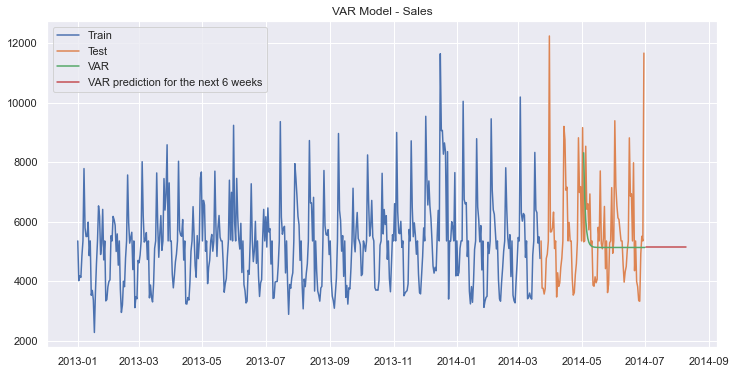

In [1319]:
plt.figure(figsize=(12,6)) 
plt.plot(train['sales'], label='Train')
plt.plot(test['sales'], label='Test')
plt.plot(df_forecast['VAR_forecast_Sales'][:60], label='VAR')
plt.plot(df_forecast['VAR_forecast_Sales'][60:], label='VAR prediction for the next 6 weeks')
plt.legend(loc='best')
plt.title('VAR Model - Sales')
plt.show()

In [1320]:
train_len = 446
train1 = new_df[0:train_len] # first 446days as training set
test1 = new_df[train_len:] # last 100 days as out-of-time test set

In [1321]:
train1.head()

,store,day_of_week,sales,customers,open,promo,state_holiday,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast,customers_log
date,,,,,,,,,,,,,
2013-01-01,46,2,5352.290997,661.848214,0,0,a,1,1,8.585280,8.543252,5132.006597,6.495036
2013-01-02,46,3,4016.000000,582.000000,1,0,0,1,1,8.298042,8.568273,5262.036058,6.366470
2013-01-03,46,4,4177.000000,553.000000,1,0,0,1,1,8.337349,8.425274,4560.893112,6.315358
2013-01-04,46,5,4125.000000,569.000000,1,0,0,1,1,8.324821,8.359377,4270.034057,6.343880
2013-01-05,46,6,4848.000000,651.000000,1,0,0,0,1,8.486322,8.380128,4359.565976,6.478510


**Model Evalution**

In [1322]:
# Let's calculate the rmse and MAPE
rmse = np.sqrt(mean_squared_error(test1['sales'], df_forecast['VAR_forecast_Sales'])).round(2)
mape = np.round(np.mean(np.abs(test1['sales']-df_forecast['VAR_forecast_Sales'])/test1['sales'])*100,2)
tempResults = pd.DataFrame({'Method':['VAR'], 'RMSE': [rmse],'MAPE': [mape] })

In [1323]:
tempResults

,Method,RMSE,MAPE
0,VAR,1812.73,19.78


In [1324]:
results = pd.concat([Results , tempResults])
results = results[['Method', 'RMSE', 'MAPE']]
results

,Method,RMSE,MAPE
0,ARIMA,1431.82,14.62
0,VAR,1812.73,19.78


**Johansen-Impulse**

In [1325]:
joh_model1 = coint_johansen(new_df[['sales','customers']],-1,1)

In [1326]:
joh_model1

In [1327]:
joh_model1.lr1

array([112.42478612,   0.72064466])

In [1328]:
joh_model1.lr2

array([111.70414146,   0.72064466])

In [1329]:
new_df[['sales','customers']].shape

(546, 2)

In [1330]:
def joh_output(res):
    output = pd.DataFrame([res.lr2,res.lr1],
                          index=['max_eig_stat',"trace_stat"])
    print(output.T,'\n')
    print("Critical values(90%, 95%, 99%) of max_eig_stat\n",res.cvm,'\n')
    print("Critical values(90%, 95%, 99%) of trace_stat\n",res.cvt,'\n')

In [1331]:
joh_output(joh_model1)

   max_eig_stat  trace_stat
0    111.704141  112.424786
1      0.720645    0.720645 

Critical values(90%, 95%, 99%) of max_eig_stat
 [[ 9.4748 11.2246 15.0923]
 [ 2.9762  4.1296  6.9406]] 

Critical values(90%, 95%, 99%) of trace_stat
 [[10.4741 12.3212 16.364 ]
 [ 2.9762  4.1296  6.9406]] 



In [1332]:
from statsmodels.tsa.vector_ar.vecm import select_coint_rank

In [1333]:
rank=select_coint_rank(new_df[['sales','customers']],-1,1)
print(rank.rank)

1


**Rank is one**


In [1334]:
from statsmodels.tsa.stattools import coint

In [1335]:
coint(new_df['sales'],new_df['customers'])#null hypothesis-There is not coint

(-5.2899007251031565,
 4.6611524040865076e-05,
 array([-3.91664811, -3.34736416, -3.05224118]))

4.6611524040865076e-05<.05

We can reject the null hypothesis

**Sales and customers are cointegration to each other**

**VARMAX MODEL**


In [1336]:
#create dymmy variables
new_df=pd.get_dummies(new_df)
new_df.head()

,store,day_of_week,sales,customers,open,promo,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast,customers_log,state_holiday_0,state_holiday_0,state_holiday_a,state_holiday_b,state_holiday_c
date,,,,,,,,,,,,,,,,,
2013-01-01,46,2,5352.290997,661.848214,0,0,1,1,8.585280,8.543252,5132.006597,6.495036,0,0,1,0,0
2013-01-02,46,3,4016.000000,582.000000,1,0,1,1,8.298042,8.568273,5262.036058,6.366470,0,1,0,0,0
2013-01-03,46,4,4177.000000,553.000000,1,0,1,1,8.337349,8.425274,4560.893112,6.315358,0,1,0,0,0
2013-01-04,46,5,4125.000000,569.000000,1,0,1,1,8.324821,8.359377,4270.034057,6.343880,0,1,0,0,0
2013-01-05,46,6,4848.000000,651.000000,1,0,0,1,8.486322,8.380128,4359.565976,6.478510,0,1,0,0,0


In [1337]:
new_df.head()

,store,day_of_week,sales,customers,open,promo,school_holiday,promo2,sales_log,ar_forecast_Log,arima_forecast,customers_log,state_holiday_0,state_holiday_0,state_holiday_a,state_holiday_b,state_holiday_c
date,,,,,,,,,,,,,,,,,
2013-01-01,46,2,5352.290997,661.848214,0,0,1,1,8.585280,8.543252,5132.006597,6.495036,0,0,1,0,0
2013-01-02,46,3,4016.000000,582.000000,1,0,1,1,8.298042,8.568273,5262.036058,6.366470,0,1,0,0,0
2013-01-03,46,4,4177.000000,553.000000,1,0,1,1,8.337349,8.425274,4560.893112,6.315358,0,1,0,0,0
2013-01-04,46,5,4125.000000,569.000000,1,0,1,1,8.324821,8.359377,4270.034057,6.343880,0,1,0,0,0
2013-01-05,46,6,4848.000000,651.000000,1,0,0,1,8.486322,8.380128,4359.565976,6.478510,0,1,0,0,0


In [1338]:
from pandas.tseries.offsets import DateOffset
future_dates3=[new_df.index[-1]+ DateOffset(days=x)for x in range(0,42)]
future_datest_df1=pd.DataFrame(index=future_dates3[1:],columns=new_df.columns)

future_df=pd.concat([new_df,future_datest_df1])

In [1339]:
#Let's fill random values for future forecasting
future_df['open'][546:]=future_df['open'][505:546]
future_df['promo'][546:]=future_df['promo'][505:546]
future_df['school_holiday'][546:]=future_df['school_holiday'][505:546]
future_df['promo2'][546:]=future_df['promo2'][505:546]
future_df['state_holiday_0'][546:]=future_df['state_holiday_0'][505:546]
future_df['state_holiday_a'][546:]=future_df['state_holiday_a'][505:546]
future_df['state_holiday_b'][546:]=future_df['state_holiday_b'][505:546]
future_df['state_holiday_c'][546:]=future_df['state_holiday_c'][505:546]

In [1340]:
#Varmax model building
exog = new_df[['open','promo','school_holiday','promo2','state_holiday_0','state_holiday_a','state_holiday_b','state_holiday_c']]
mod = sm.tsa.VARMAX(new_df[['sales_log', 'customers_log']], order=(1,1), trend='n', exog=exog)
res = mod.fit(maxiter=1000, disp=False)
print(res.summary())

                                 Statespace Model Results                                 
Dep. Variable:     ['sales_log', 'customers_log']   No. Observations:                  546
Model:                                VARMAX(1,1)   Log Likelihood                1193.534
Date:                            Mon, 17 Jan 2022   AIC                          -2329.069
Time:                                    16:46:06   BIC                          -2204.293
Sample:                                01-01-2013   HQIC                         -2280.293
                                     - 06-30-2014                                         
Covariance Type:                              opg                                         
Ljung-Box (L1) (Q):             0.08, 8.37   Jarque-Bera (JB):         92.60, 20.60
Prob(Q):                        0.78, 0.00   Prob(JB):                   0.00, 0.00
Heteroskedasticity (H):         1.24, 1.18   Skew:                       0.75, 0.34
Prob(H) (two-sided):

In [1341]:
train_len = 505
train = new_df[0:train_len] # first 446 days as training set
test = new_df[train_len:] 

start_index = test.index.min()
end_index = test.index.max()

In [1342]:
print(start_index)
print(end_index)

2014-05-21 00:00:00
2014-06-30 00:00:00


In [1343]:
print(test.shape)
print(train.shape)

(41, 17)
(505, 17)


In [1344]:
print(future_df.index.min())
print(future_df.index.max())

2013-01-01 00:00:00
2014-08-10 00:00:00


In [1345]:
predictions1 = mod.fit().predict(future_df.index.min(),future_df.index.max(),exog=test[['open','promo','school_holiday','promo2','state_holiday_0','state_holiday_a','state_holiday_b','state_holiday_c']])

In [1346]:
#inverse of log
predictions1['VARMAX_forecast_Sales'] = np.exp(predictions1['sales_log'])
predictions1['VARMAX_forecast_customers'] = np.exp(predictions1['customers_log'])
predictions1   

,sales_log,customers_log,VARMAX_forecast_Sales,VARMAX_forecast_customers
2013-01-01,8.334825,6.348037,4166.474285,571.370038
2013-01-02,8.404267,6.396578,4466.084396,599.788849
2013-01-03,8.335218,6.352139,4168.110095,573.718669
2013-01-04,8.323001,6.337778,4117.498218,565.538087
2013-01-05,8.330709,6.368147,4149.357893,582.976504
...,...,...,...,...
2014-08-06,8.345861,6.379694,4212.706578,589.747402
2014-08-07,8.345183,6.379157,4209.852527,589.430660
2014-08-08,8.344976,6.378993,4208.983165,589.334168
2014-08-09,8.524285,6.450197,5035.583042,632.826726


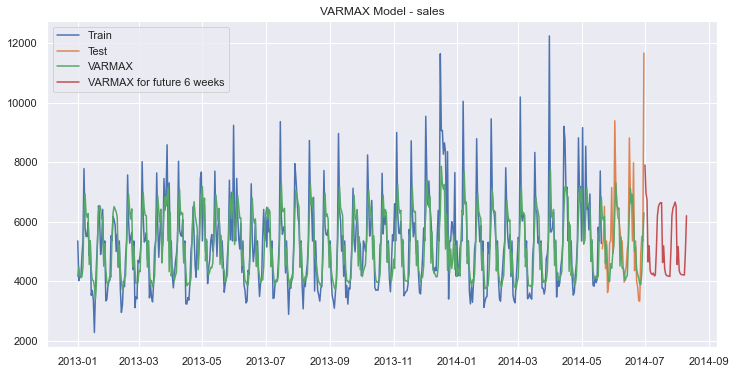

In [1347]:
plt.figure(figsize=(12,6)) 
plt.plot(train['sales'], label='Train')
plt.plot(test['sales'], label='Test')
plt.plot(predictions1['VARMAX_forecast_Sales'][:546], label='VARMAX')
plt.plot(predictions1['VARMAX_forecast_Sales'][546:], label='VARMAX for future 6 weeks')

plt.legend(loc='best')
plt.title('VARMAX Model - sales')
plt.show()

**Model Evalution**

In [1348]:
# Let's calculate the rmse and MAPE
rmse = np.sqrt(mean_squared_error(test['sales'], predictions1['VARMAX_forecast_Sales'][505:546])).round(2)
mape = np.round(np.mean(np.abs(test['sales']-predictions1['VARMAX_forecast_Sales'][505:546])/test['sales'])*100,2)
tempResults = pd.DataFrame({'Method':['VARMAX'], 'RMSE': [rmse],'MAPE': [mape] })

In [1349]:
results = pd.concat([results  , tempResults])
results = results[['Method', 'RMSE', 'MAPE']]
results

,Method,RMSE,MAPE
0,ARIMA,1431.82,14.62
0,VAR,1812.73,19.78
0,VARMAX,1306.76,13.09


**VARMAX is the best model**

-   Find outliers at the 99th percentile and remove them.

-   Standardize the sales and number of customers variables before modelling.

-   Determine if the data is stationary

-   If stationary then apply Vector Autoregression Model.

-   If non-stationary then specify the model in differences

-   Make sales, promo2 and any other variables you think of as dependent variables.

-   check for cointegration using the Johansen test. 

-   Predict sales for the next 6 weeks

-  Is the sales data non-stationary? If so, how do you find it and correct it?

-  Is the data cointegrated? Which variables are cointegrated and how do you find them?

-  What is the impact of the number of customers on sales?

-  What is the impact of promo and promo2 variables on sales? How do you measure it?

-  Forecast sales for the next 6 weeks?
-  Report the accuracy of the model using MAPE

# Conclusion

-   VARMAX is the best model
-   The data is stationary
-   Sales and Customers are cointegrated to each others
-   Sales will get increase as the number of customer will get increase.
-   promo has positive impact on sales
-   promo2 doesn't have any impact on sales
-   Forecasted sale for the next 6 weeks

# **Conclusion**

- The data is stationary
- Sales and Customers are cointegrated to each others
- Sales will get increase as the number of customer will get increase.
- promo has positive impact on sales
- promo2 doesn't have any impact on sales
